<a href="https://colab.research.google.com/github/alexchilton/CAS_Project_2_protein_autoencoders/blob/main/mab_notebook_15_lara.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Libraries

In [1]:
!pip install torch_geometric

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 63.1/63.1 kB 5.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 44.7 MB/s eta 0:00:00


In [28]:
import collections
import copy
import itertools
import json
import logging
# Imports and setup
import os
from collections import defaultdict
from datetime import datetime
from pathlib import Path

import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd
import torch
import torch.nn as nn
import torch.nn.functional as F
from sklearn.decomposition import PCA
from sklearn.model_selection import train_test_split
from torch_geometric.data import Data, DataLoader
from torch_geometric.loader import DataLoader
from torch_geometric.nn import GATv2Conv
from torch_geometric.utils import to_dense_adj, k_hop_subgraph
from tqdm.notebook import tqdm
from google.colab import drive
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA

In [3]:
!pip install biopython

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.2/3.2 MB 82.2 MB/s eta 0:00:00


In [4]:
import warnings
from Bio.PDB.PDBExceptions import PDBConstructionWarning

# Suppress PDB warnings globally
warnings.simplefilter('ignore', PDBConstructionWarning)

In [5]:
drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


In [6]:
# For Colab only_move to function file directory, load and go back to content /drive
%cd /content/drive/MyDrive/CAS_AML/function_files
from preprocessing_v3 import ProteinAnalyzer, process_pdb_directory
from utils_ln import load_aa_info
%cd /content/drive

/content/drive/MyDrive/CAS_AML/function_files
/content/drive


# Configuration

In [7]:
# Configure logging
logging.basicConfig(level=logging.INFO)
logger = logging.getLogger(__name__)

# Set environment variable for MPS fallback
os.environ['PYTORCH_ENABLE_MPS_FALLBACK'] = '1'

# Set plot style
sns.set_theme()

# Device setup
def get_device():
    """Get the best available device with fallbacks"""
    if torch.cuda.is_available():
        return torch.device('cuda')
    elif torch.backends.mps.is_available():
        logger.info("MPS (M1/M2) device found but using CPU for some operations due to compatibility")
        return torch.device('cpu')
    return torch.device('cpu')

def compute_average_edges(data_loader):
    """
    Compute the average number of edges and nodes in the dataset
    """
    total_edges = 0
    total_nodes = 0
    num_graphs = 0

    for batch in data_loader:
        total_edges += batch.edge_index.size(1) // 2  # Divide by 2 for undirected edges
        total_nodes += batch.x.size(0)
        num_graphs += 1

    return {
        'avg_edges': total_edges / num_graphs,
        'avg_nodes': total_nodes / num_graphs,
        'avg_backbone': total_nodes / num_graphs - 1  # One less than nodes
    }

# Paths and constants

In [8]:
# Define the file for a demo protein structure
pdb_file = '/content/drive/MyDrive/CAS_AML/datasets/all_nano_structures_single_domain/1zv5.pdb'

# Define the directory containing the PDB files
pdb_directory = '/content/drive/MyDrive/CAS_AML/datasets/all_nano_structures_single_domain_clean'

# Define the file containing amino acid information
aa_info_file = '/content/drive/MyDrive/CAS_AML/info_files/aa_mass_letter.csv'

# Preprocessed protein dataframes
output_dir = "/content/drive/MyDrive/CAS_AML/outputs/processed_dataframes"

output_model_dir="/content/drive/MyDrive/CAS_AML/models"


# Preprocessing

In [9]:
# Load amino acid information
aa_info = pd.read_csv(aa_info_file)
aa_info['Abbrev.'] = aa_info['Abbrev.'].apply(lambda x: x.upper())
aa_info_dict = aa_info.set_index('Abbrev.').to_dict(orient='index')
#aa_info_dict

In [10]:
# Process PDB directory
dataframes = process_pdb_directory(pdb_directory, aa_info_dict, neighborhood_radius=5.0)


Processing PDBs: 100%|██████████| 1646/1646 [16:51<00:00,  1.63it/s]


In [12]:
dataframes[100]

('/content/drive/MyDrive/CAS_AML/datasets/all_nano_structures_single_domain_clean/7f54.pdb',
               X           Y           Z   Avg_Mass  Avg_Neighbor_Dist  \
 0     93.021004   55.021999  106.252998  133.10384           3.804638   
 1     95.488998   57.438000  107.848999  146.14594           3.809230   
 2     93.927002   60.292000  105.859001  174.20274           4.189766   
 3     91.192001   60.537998  108.473999  132.11904           3.773700   
 4     93.682999   61.657001  111.052002  147.13074           3.779628   
 ...         ...         ...         ...        ...                ...   
 1030  92.575996  111.200996   72.046997  204.22844           3.811892   
 1031  95.822998  111.662003   70.133003   75.06714           3.795591   
 1032  94.365997  114.067001   67.585999  146.18934           3.807918   
 1033  91.271004  116.245003   68.119003  115.13194           3.813211   
 1034  88.293999  115.454002   65.886002  117.14784           3.804542   
 
       Max_Neighb

In [13]:
import os

# Directory to store processed DataFrames
os.makedirs(output_dir, exist_ok=True)

# Save each DataFrame to a pickle file
for pdb_file, df in dataframes:
    pdb_id = os.path.basename(pdb_file).replace('.pdb', '')  # Extract PDB ID from filename
    df.to_pickle(os.path.join(output_dir, f"{pdb_id}.pkl"))

print(f"DataFrames saved in {output_dir} as pickle files")


KeyboardInterrupt: 

# Graph conversion

In [14]:
import numpy as np
import torch
from torch_geometric.data import Data
from sklearn.neighbors import NearestNeighbors

def nanobody_to_graph(df, k=10, include_coordinates=True):
    """
    Convert a nanobody DataFrame into a graph for GTA-based GNNs.

    Parameters:
    - df: DataFrame containing nanobody data.
    - k: Number of nearest neighbors for graph connectivity.
    - include_coordinates: Whether to include 3D coordinates in node features.

    Returns:
    - PyTorch Geometric Data object.
    """
    # Step 1: Node Features
    features_to_include = ['Avg_Mass', 'Avg_Neighbor_Dist', 'Max_Neighbor_Dist', 'Neighbor_Count', 'Small_Molecules_Found']
    node_features = df[features_to_include].values

    # Optionally include coordinates in node features
    if include_coordinates:
        coords = df[['X', 'Y', 'Z']].values
        node_features = np.hstack([node_features, coords])

    # Convert to tensor
    node_features = torch.tensor(node_features, dtype=torch.float)

    # Step 2: KNN-based Edge Construction
    coords = df[['X', 'Y', 'Z']].values
    nbrs = NearestNeighbors(n_neighbors=k, algorithm='ball_tree').fit(coords)
    distances, indices = nbrs.kneighbors(coords)

    edge_index = []
    edge_attr = []
    for i in range(len(indices)):
        for j in range(1, k):  # Skip self-loop (j=0)
            edge_index.append([i, indices[i, j]])
            edge_attr.append([distances[i, j]])

    edge_index = torch.tensor(edge_index, dtype=torch.long).t().contiguous()
    edge_attr = torch.tensor(edge_attr, dtype=torch.float)

    # Step 3: Create Graph Data Object
    data = Data(
        x=node_features,      # Node features
        edge_index=edge_index,  # Edges
        edge_attr=edge_attr,   # Edge features (distances)
    )
    return data


In [15]:
graphs = []  # Define `graphs` outside the loop
for pdb_file, df in tqdm(dataframes, desc="Processing", unit="graph", bar_format="{l_bar}{bar}| {n_fmt}/{total_fmt} [{elapsed}<{remaining}]"):
    graph = nanobody_to_graph(df, k=5, include_coordinates=True)
    graphs.append((pdb_file, graph))


Processing:   0%|          | 0/1646 [00:00<?]

# Graph representation vs reality

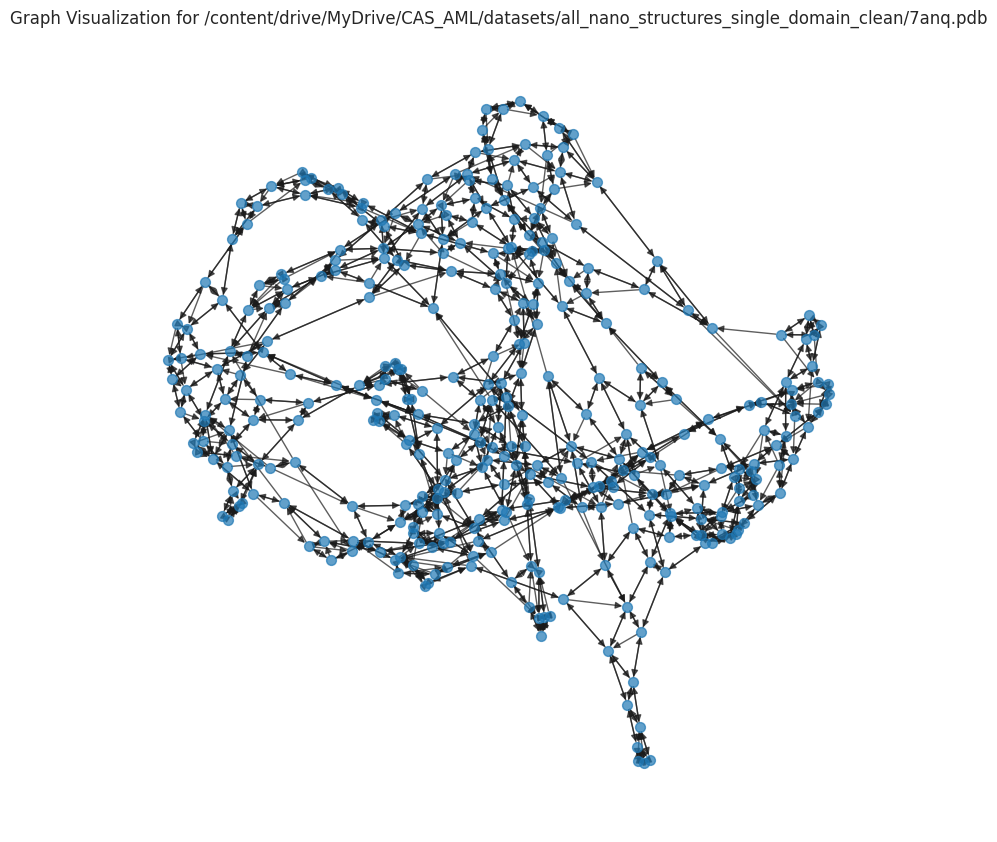

In [16]:
import networkx as nx
from torch_geometric.utils import to_networkx
import matplotlib.pyplot as plt

def visualize_nanobody_graph(data, pdb_file):
    """Visualize the nanobody graph."""
    G = to_networkx(data, edge_attrs=['edge_attr'], node_attrs=['x'])
    pos = nx.spring_layout(G, seed=42)
    plt.figure(figsize=(8, 8))
    nx.draw(G, pos, with_labels=False, node_size=50, alpha=0.7)
    plt.title(f"Graph Visualization for {pdb_file}")
    plt.show()

# Example
pdb_file, data = graphs[10]
visualize_nanobody_graph(data, pdb_file)


In [17]:
import matplotlib as mpl
import matplotlib.pyplot as plt
import networkx as nx
from torch_geometric.utils import to_networkx

# Define amino acid masses and their corresponding colors
AMINO_ACID_DATA = [
    (89.09404, "Alanine", "blue"),
    (121.15404, "Cysteine", "green"),
    (133.10384, "Aspartic acid", "red"),
    (147.13074, "Glutamic acid", "cyan"),
    (165.19184, "Phenylalanine", "magenta"),
    (75.06714, "Glycine", "yellow"),
    (155.15634, "Histidine", "orange"),
    (131.17464, "Isoleucine/Leucine", "purple"),
    (146.18934, "Lysine", "brown"),
    (149.20784, "Methionine", "pink"),
    (132.11904, "Asparagine", "lime"),
    (255.31000, "Pyrrolysine", "gold"),
    (115.13194, "Proline", "silver"),
    (146.14594, "Glutamine", "teal"),
    (174.20274, "Arginine", "coral"),
    (105.09344, "Serine", "navy"),
    (119.12034, "Threonine", "olive"),
    (168.05300, "Selenocysteine", "maroon"),
    (117.14784, "Valine", "black"),
    (204.22844, "Tryptophan", "violet"),
    (181.19124, "Tyrosine", "gray"),
]

# Convert amino acid data to lookup tables
MASS_TO_COLOR = {mass: color for mass, _, color in AMINO_ACID_DATA}
MASS_TO_NAME = {mass: name for mass, name, _ in AMINO_ACID_DATA}

def map_mass_to_color(mass):
    """Find the closest amino acid mass and return its color."""
    closest_mass = min(MASS_TO_COLOR.keys(), key=lambda m: abs(m - mass))
    return MASS_TO_COLOR[closest_mass]

def visualize_nanobody_graph_aminoacids(data, pdb_file):
    """
    Visualize a nanobody graph with amino acid-specific colors.

    Parameters:
    - data: PyTorch Geometric Data object.
    - pdb_file: Name of the nanobody structure file.
    """
    # Convert to NetworkX graph
    G = to_networkx(data, edge_attrs=['edge_attr'], node_attrs=['x'])

    # Use a layout (try 'spring', 'kamada_kawai', or others)
    pos = nx.spring_layout(G, seed=42)

    # Map nodes to amino acid colors using Avg_Mass (x[0])
    node_colors = [
        map_mass_to_color(node[1]['x'][0]) for node in G.nodes(data=True)
    ]

    # Scale node sizes dynamically (e.g., based on Neighbor_Count, x[3])
    node_sizes = [max(10, node[1]['x'][3] * 50) for node in G.nodes(data=True)]  # Assuming Neighbor_Count is x[3]

    # Scale edge widths dynamically based on edge distances (edge_attr)
    edge_weights = [max(0.1, edge[2]['edge_attr'][0]) for edge in G.edges(data=True)]

    # Create the figure and axes explicitly
    fig, ax = plt.subplots(figsize=(10, 10))

    # Draw the graph
    nx.draw(
        G,
        pos,
        ax=ax,  # Explicitly set the axes for the graph
        with_labels=False,
        node_color=node_colors,
        node_size=node_sizes,
        edge_color='gray',  # Static edge color for better node visibility
        width=edge_weights,
        alpha=0.9  # Transparency for better visibility
    )

    # Add a legend for amino acid colors
    legend_patches = [
        mpl.patches.Patch(color=color, label=name)
        for _, name, color in AMINO_ACID_DATA
    ]
    ax.legend(handles=legend_patches, loc='upper left', fontsize=8, title="Amino Acids")

    # Add a title
    ax.set_title(f"Graph Visualization for {pdb_file}", fontsize=14)
    plt.show()


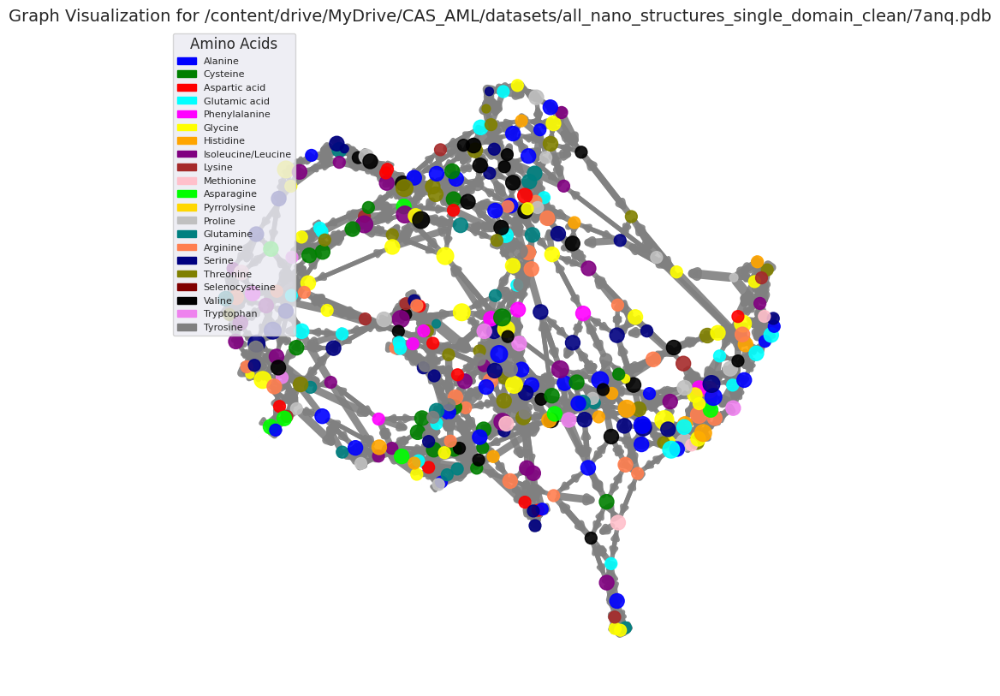

In [18]:
# Example
pdb_file, data = graphs[10]
visualize_nanobody_graph_aminoacids(data, pdb_file)

In [ ]:
# from IPython.display import display
# from PIL import Image
# import matplotlib.pyplot as plt

# # Paths to your images
# image_path_1 = "data/mab_dataset/3sn6.png"
# image_path_2 = "data/mab_dataset/3sn6_plot.png"

# # Open the images using PIL
# image_1 = Image.open(image_path_1)
# image_2 = Image.open(image_path_2)

# # Create a matplotlib figure
# fig, axes = plt.subplots(1, 2, figsize=(15, 8))  # 1 row, 2 columns

# # Display the first image
# axes[0].imshow(image_1)
# axes[0].axis('off')  # Hide axes
# axes[0].set_title("Image 1: Original")

# # Display the second image
# axes[1].imshow(image_2)
# axes[1].axis('off')  # Hide axes
# axes[1].set_title("Image 2: Plot")

# # Show the images
# plt.tight_layout()
# plt.show()


# Dataloader

In [ ]:
# from torch_geometric.loader import DataLoader
# from sklearn.model_selection import train_test_split

# def split_and_batch_graphs(graphs, batch_size=8, train_ratio=0.8, seed=42):
#     """
#     Split the graphs into train and test datasets, and create DataLoaders for batching.

#     Parameters:
#     - graphs (list): List of `torch_geometric.data.Data` graphs.
#     - batch_size (int): Batch size for the DataLoader.
#     - train_ratio (float): Proportion of data to use for training.
#     - seed (int): Random seed for reproducibility.

#     Returns:
#     - train_loader (DataLoader): DataLoader for the training set.
#     - test_loader (DataLoader): DataLoader for the testing set.
#     """
#     # Set random seed for reproducibility
#     torch.manual_seed(seed)

#     # Split into train and test sets
#     train_graphs, test_graphs = train_test_split(graphs, train_size=train_ratio, random_state=seed)

#     # Create DataLoaders
#     train_loader = DataLoader(train_graphs, batch_size=batch_size, shuffle=True)
#     test_loader = DataLoader(test_graphs, batch_size=batch_size, shuffle=False)

#     return train_loader, test_loader


In [ ]:
# # Unpack graphs
# graph_data = [graph for _, graph in graphs]  # Extract only the `Data` objects

# # Split and batch the graphs
# train_loader, test_loader = split_and_batch_graphs(graph_data, batch_size=16, train_ratio=0.8, seed=42)

# # Optional: Keep file names for reference
# pdb_files = [pdb_file for pdb_file, _ in graphs]

# # Example: Iterate through training batches
# for batch in train_loader:
#     print(batch)  # This should now work as expected


# GTA Alex V14

In [64]:
import torch
from torch_geometric.data import Data, DataLoader
from sklearn.model_selection import train_test_split
import torch.nn as nn
import torch.nn.functional as F
from torch_geometric.nn import GATConv, global_mean_pool
from torch_geometric.data import Data, DataLoader
import matplotlib.pyplot as plt

def prepare_graphs_for_vae(graph_tuples, batch_size=16, train_ratio=0.8, shuffle=True):
    """
    Prepare PDB graph data for VAE training with normalization
    """
    # Extract PyG Data objects
    graphs = [g[1] for g in graph_tuples]

    # Calculate normalization statistics across all graphs
    all_features = torch.cat([g.x for g in graphs], dim=0)
    feature_means = all_features.mean(dim=0)
    feature_stds = all_features.std(dim=0)

    # Prevent division by zero
    feature_stds = torch.where(feature_stds == 0, torch.ones_like(feature_stds), feature_stds)

    # Normalize all graphs
    for graph in graphs:
        graph.x = (graph.x - feature_means) / feature_stds

        # Also normalize edge attributes (distances)
        if graph.edge_attr is not None:
            edge_mean = graph.edge_attr.mean()
            edge_std = graph.edge_attr.std()
            if edge_std > 0:
                graph.edge_attr = (graph.edge_attr - edge_mean) / edge_std

    # Rest of your existing function...
    train_graphs, test_graphs = train_test_split(
        graphs,
        train_size=train_ratio,
        shuffle=shuffle,
        random_state=42
    )

    train_loader = DataLoader(
        train_graphs,
        batch_size=batch_size,
        shuffle=shuffle
    )

    test_loader = DataLoader(
        test_graphs,
        batch_size=batch_size,
        shuffle=False
    )

    sample_data = train_graphs[0]
    in_channels = sample_data.x.size(1)

    print(f"Dataset prepared:")
    print(f"Number of training graphs: {len(train_graphs)}")
    print(f"Number of test graphs: {len(test_graphs)}")
    print(f"Number of features per node: {in_channels}")
    print(f"Feature means:", feature_means)
    print(f"Feature stds:", feature_stds)

    # Return normalization parameters for later use (e.g., inference)
    return train_loader, test_loader, in_channels, (feature_means, feature_stds)

def setup_and_train_vae(graph_tuples, batch_size=16, hidden_channels=64, latent_channels=32, num_heads=4, num_epochs=100):
    """
    Set up the VAE and start training with attention-based handling of variable-sized graphs
    """
    # Set up device
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    print(f"Using device: {device}")

    # Prepare data
    train_loader, test_loader, in_channels = prepare_graphs_for_vae(
        graph_tuples,
        batch_size=batch_size
    )

    # Initialize model
    model = ProteinGraphVAE(
        in_channels=in_channels,
        hidden_channels=hidden_channels,
        latent_channels=latent_channels,
        num_heads=num_heads
    ).to(device)

    # Train model
    trained_model, train_losses, test_losses = train_model(
        model=model,
        train_loader=train_loader,
        test_loader=test_loader,
        device=device,
        num_epochs=num_epochs
    )

    return trained_model, train_losses, test_losses, (train_loader, test_loader)

In [65]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch_geometric.nn import GATConv, global_mean_pool

class ProteinGraphVAE(nn.Module):
    def __init__(self, in_channels, hidden_channels, latent_channels=32, num_heads=4, edge_dim=1):
        super(ProteinGraphVAE, self).__init__()

        # Model parameters
        self.in_channels = in_channels
        self.hidden_channels = hidden_channels
        self.latent_channels = latent_channels
        self.edge_dim = edge_dim
        self.training_factor = nn.Parameter(torch.zeros(1))

        # Feature indices
        self.coord_indices = slice(-3, None)
        self.mass_index = 0
        self.distance_indices = slice(1, 3)
        self.count_index = 3
        self.small_mol_index = 4

        # Balanced loss weights
        self.loss_weights = {
            'mass': 1.0,
            'distance': 1.0,
            'count': 0.1,
            'small_mol': 1.0,
            'coord': 1.0,
            'edge': 1.0
        }

        # Encoder with GAT layers (no BatchNorm)
        self.encoder_layers = nn.ModuleList([
            GATConv(in_channels, hidden_channels, heads=4, edge_dim=edge_dim),
            GATConv(hidden_channels * 4, hidden_channels, heads=2, edge_dim=edge_dim),
            GATConv(hidden_channels * 2, hidden_channels, heads=1, edge_dim=edge_dim)
        ])

        # Encoder feedforward (minimal normalization)
        self.encoder_ff = nn.Sequential(
            nn.Linear(hidden_channels, hidden_channels * 2),
            nn.ReLU(),
            nn.Dropout(0.2),
            nn.Linear(hidden_channels * 2, hidden_channels),
            nn.ReLU()
        )

        # Direct latent projections
        self.fc_mu = nn.Linear(hidden_channels, latent_channels)
        self.fc_logvar = nn.Linear(hidden_channels, latent_channels)

        # Decoder (keeping some BatchNorm for stability)
        self.shared_decoder = nn.Sequential(
            nn.Linear(latent_channels, hidden_channels),
            nn.ReLU(),
            nn.BatchNorm1d(hidden_channels),
            nn.Dropout(0.2),
            nn.Linear(hidden_channels, hidden_channels * 2),
            nn.ReLU(),
            nn.BatchNorm1d(hidden_channels * 2),
            nn.Linear(hidden_channels * 2, hidden_channels)
        )

        # Feature-specific heads (simplified)
        self.coord_head = nn.Sequential(
            nn.Linear(hidden_channels, hidden_channels),
            nn.ReLU(),
            nn.Linear(hidden_channels, 3),
            nn.Tanh()
        )

        self.mass_head = nn.Sequential(
            nn.Linear(hidden_channels, hidden_channels // 2),
            nn.ReLU(),
            nn.Linear(hidden_channels // 2, 1),
            nn.Softplus()
        )

        self.distance_head = nn.Sequential(
            nn.Linear(hidden_channels, hidden_channels),
            nn.ReLU(),
            nn.Linear(hidden_channels, 2),
            nn.Softplus()
        )

        self.count_head = nn.Sequential(
            nn.Linear(hidden_channels, hidden_channels // 2),
            nn.ReLU(),
            nn.Linear(hidden_channels // 2, 1),
            nn.Softplus()
        )

        self.small_mol_head = nn.Sequential(
            nn.Linear(hidden_channels, hidden_channels // 2),
            nn.ReLU(),
            nn.Linear(hidden_channels // 2, 1)
        )

        self.edge_decoder = nn.Sequential(
            nn.Linear(2 * hidden_channels, hidden_channels),
            nn.ReLU(),
            nn.Dropout(0.2),
            nn.Linear(hidden_channels, edge_dim),
            nn.Softplus()
        )

        # Initialize weights for better latent space spread
        self.init_weights()

    def init_weights(self):
        # Initialize mu layer with larger variance
        nn.init.xavier_normal_(self.fc_mu.weight, gain=2.0)
        nn.init.zeros_(self.fc_mu.bias)

        # Initialize logvar layer to start with larger variance
        nn.init.xavier_normal_(self.fc_logvar.weight, gain=2.0)
        nn.init.constant_(self.fc_logvar.bias, 1.0)  # Start with positive variance

    def encode(self, x, edge_index, edge_attr, batch):
        # Multi-layer graph convolutions without BatchNorm
        for conv in self.encoder_layers:
            x = conv(x, edge_index, edge_attr=edge_attr)
            x = F.relu(x)
            x = F.dropout(x, p=0.1, training=self.training)

        # Feature processing
        x = self.encoder_ff(x)

        # Global pooling
        x = global_mean_pool(x, batch)

        # Direct projection to latent space
        mu = self.fc_mu(x)
        logvar = self.fc_logvar(x)

        return mu, logvar

    def reparameterize(self, mu, logvar):
        if self.training:
            std = torch.exp(0.5 * logvar)
            eps = torch.randn_like(std)
            return mu + eps * std
        return mu

    def decode(self, z, num_nodes, edge_index):
        batch_size = z.size(0)

        # Add position-specific noise with learned scaling
        z = z.unsqueeze(1).expand(-1, num_nodes, -1)
        noise_scale = torch.sigmoid(self.training_factor) * 0.1
        position_noise = torch.randn_like(z) * noise_scale
        z = z + position_noise
        z = z.reshape(-1, self.latent_channels)

        # Shared decoding
        h = self.shared_decoder(z)

        # Feature-specific decoding
        coords = self.coord_head(h) * 10  # Scale coordinates appropriately
        mass = self.mass_head(h)
        distances = self.distance_head(h)
        counts = self.count_head(h)
        small_mols = self.small_mol_head(h)

        # Edge decoding
        row, col = edge_index
        edge_features = torch.cat([h[row], h[col]], dim=1)
        decoded_edges = self.edge_decoder(edge_features)

        # Combine features
        features = torch.cat([mass, distances, counts, small_mols, coords], dim=1)
        return features.view(batch_size, num_nodes, -1), decoded_edges

    def feature_specific_loss(self, recon, target, edge_recon, edge_target):
        losses = {}
        EPS = 1e-6

        # Calculate losses without additional normalization
        mass_pred = F.softplus(recon[..., self.mass_index])
        mass_target = target[..., self.mass_index]
        losses['mass'] = F.mse_loss(mass_pred, mass_target) * self.loss_weights['mass']

        dist_pred = F.softplus(recon[..., self.distance_indices])
        dist_target = target[..., self.distance_indices]
        losses['distance'] = F.mse_loss(dist_pred, dist_target) * self.loss_weights['distance']

        count_pred = F.softplus(recon[..., self.count_index])
        count_target = target[..., self.count_index]
        losses['count'] = F.mse_loss(count_pred, count_target) * self.loss_weights['count']

        small_mol_pred = recon[..., self.small_mol_index]
        small_mol_target = target[..., self.small_mol_index].clamp(0, 1)
        losses['small_mol'] = F.binary_cross_entropy_with_logits(
            small_mol_pred, small_mol_target, reduction='mean'
        ) * self.loss_weights['small_mol']

        coord_pred = recon[..., self.coord_indices]
        coord_target = target[..., self.coord_indices]
        losses['coord'] = F.mse_loss(coord_pred, coord_target) * self.loss_weights['coord']

        edge_pred = F.softplus(edge_recon)
        edge_target_pos = F.softplus(edge_target)
        losses['edge'] = F.mse_loss(edge_pred, edge_target_pos) * self.loss_weights['edge']

        total_loss = sum(loss for loss in losses.values() if torch.isfinite(loss))

        return total_loss, losses

    def forward(self, x, edge_index, edge_attr, batch):
        mu, logvar = self.encode(x, edge_index, edge_attr, batch)
        z = self.reparameterize(mu, logvar)

        unique, counts = torch.unique(batch, return_counts=True)
        max_nodes = counts.max().item()

        recon, edge_recon = self.decode(z, max_nodes, edge_index)
        return recon, edge_recon, mu, logvar

In [66]:
import torch
import torch.nn.functional as F
import matplotlib.pyplot as plt
from tqdm import tqdm
import time

def kl_annealing_factor(epoch, warmup_epochs=10, min_weight=0.0001, max_weight=1.0):
    """Compute KL annealing factor that gradually increases from min_weight to max_weight"""
    if epoch < warmup_epochs:
        return min_weight + (max_weight - min_weight) * (epoch / warmup_epochs)
    return max_weight

def compute_orthogonal_regularization(mu, lambda_ortho=0.1):
    """Compute orthogonality regularization for the latent space"""
    batch_size = mu.size(0)
    mu_normalized = F.normalize(mu, p=2, dim=1)  # Normalize each embedding
    correlation = torch.mm(mu_normalized.t(), mu_normalized) / batch_size
    identity = torch.eye(correlation.size(0), device=correlation.device)
    ortho_loss = lambda_ortho * torch.sum((correlation - identity) ** 2)
    return ortho_loss

def train_model(model, train_loader, test_loader, device, num_epochs=100,
                min_beta=0.0001, max_beta=0.01, warmup_epochs=10, lambda_ortho=0.1):
    """
    Train VAE model with KL annealing and orthogonal regularization
    """
    model = model.to(device)
    optimizer = torch.optim.Adam(model.parameters(), lr=0.001, weight_decay=1e-5)
    max_grad_norm = 1.0

    print(f"Starting training for {num_epochs} epochs...")
    print(f"Training on device: {device}")
    print(f"Number of training batches: {len(train_loader)}")
    print(f"Number of validation batches: {len(test_loader)}")
    print(f"KL annealing: {min_beta} -> {max_beta} over {warmup_epochs} epochs")
    print(f"Orthogonal regularization strength: {lambda_ortho}")

    history = {
        'train': {
            'total_loss': [], 'recon_loss': [], 'kl_loss': [], 'ortho_loss': [],
            'mass_loss': [], 'distance_loss': [], 'count_loss': [],
            'small_mol_loss': [], 'coord_loss': [], 'edge_loss': [],
            'beta': []  # Track KL weight
        },
        'test': {
            'total_loss': [], 'recon_loss': [], 'kl_loss': [], 'ortho_loss': [],
            'mass_loss': [], 'distance_loss': [], 'count_loss': [],
            'small_mol_loss': [], 'coord_loss': [], 'edge_loss': []
        }
    }

    for epoch in range(num_epochs):
        epoch_start_time = time.time()
        model.train()
        epoch_losses = {k: 0.0 for k in history['train'].keys()}

        # Get current KL weight from annealing schedule
        current_beta = kl_annealing_factor(epoch, warmup_epochs, min_beta, max_beta)
        epoch_losses['beta'] = current_beta

        # Progress bar for training
        pbar = tqdm(train_loader, desc=f'Epoch {epoch+1}/{num_epochs} [Train]')
        batch_count = 0

        for batch in pbar:
            try:
                batch = batch.to(device)
                optimizer.zero_grad()

                # Debug info for first batch
                if batch_count == 0 and epoch == 0:
                    print(f"\nBatch shapes:")
                    print(f"Input x shape: {batch.x.shape}")
                    print(f"Edge index shape: {batch.edge_index.shape}")
                    print(f"Edge attr shape: {batch.edge_attr.shape}")

                # Forward pass
                recon_batch, edge_recon, mu, logvar = model(batch.x, batch.edge_index,
                                                            batch.edge_attr, batch.batch)

                if batch_count == 0 and epoch == 0:
                    print(f"Reconstruction shape: {recon_batch.shape}")
                    print(f"Edge reconstruction shape: {edge_recon.shape}")

                # Reshape original data
                _, counts = torch.unique(batch.batch, return_counts=True)
                max_nodes = counts.max()
                batch_size = len(counts)
                padded_x = torch.zeros(batch_size, max_nodes, batch.x.size(1), device=device)

                start_idx = 0
                for i, count in enumerate(counts):
                    padded_x[i, :count] = batch.x[start_idx:start_idx + count]
                    start_idx += count

                # Calculate losses
                recon_loss, feature_losses = model.feature_specific_loss(
                    recon_batch, padded_x, edge_recon, batch.edge_attr)

                kl_loss = -0.5 * torch.mean(1 + logvar - mu.pow(2) - logvar.exp())

                # Add orthogonality regularization
                ortho_loss = compute_orthogonal_regularization(mu, lambda_ortho)

                # Combine losses with annealed KL weight
                loss = recon_loss + current_beta * kl_loss + ortho_loss

                # Detailed diagnostics every 10 batches
                if batch_count % 10 == 0:
                    with torch.no_grad():
                        print("\nDetailed loss diagnostics:")
                        print(f"Raw recon_loss: {recon_loss.item():.4f}")
                        print(f"Raw KL loss: {kl_loss.item():.4f}")
                        print(f"Ortho loss: {ortho_loss.item():.4f}")
                        print(f"Current beta: {current_beta:.4f}")
                        print(f"mu mean: {mu.mean().item():.4f}, std: {mu.std().item():.4f}")
                        print(f"logvar mean: {logvar.mean().item():.4f}, std: {logvar.std().item():.4f}")
                        for k, v in feature_losses.items():
                            print(f"{k}: {v.item():.4f}")

                # Backward pass with gradient clipping
                loss.backward()
                torch.nn.utils.clip_grad_norm_(model.parameters(), max_grad_norm)
                optimizer.step()

                # Update progress bar and losses
                batch_count += 1
                epoch_losses['total_loss'] += loss.item()
                epoch_losses['recon_loss'] += recon_loss.item()
                epoch_losses['kl_loss'] += kl_loss.item()
                epoch_losses['ortho_loss'] += ortho_loss.item()
                for k, v in feature_losses.items():
                    epoch_losses[f'{k}_loss'] += v.item()

                # Update progress bar description
                pbar.set_postfix({
                    'loss': f'{loss.item():.4f}',
                    'recon': f'{recon_loss.item():.4f}',
                    'kl': f'{kl_loss.item():.4f}',
                    'ortho': f'{ortho_loss.item():.4f}'
                })

            except Exception as e:
                print(f"\nError in batch {batch_count}:")
                print(str(e))
                print("Batch details:")
                print(f"Batch size: {batch.num_graphs}")
                print(f"Number of nodes: {batch.num_nodes}")
                print(f"Number of edges: {batch.num_edges}")
                continue

        # Average losses
        num_batches = len(train_loader)
        for k in epoch_losses:
            if k != 'beta':  # Don't average the beta value
                epoch_losses[k] = epoch_losses[k] / num_batches
            history['train'][k].append(epoch_losses[k])

        # Validation phase
        model.eval()
        test_losses = {k: 0.0 for k in history['test'].keys()}

        print("\nStarting validation...")
        with torch.no_grad():
            for batch in tqdm(test_loader, desc=f'Epoch {epoch+1}/{num_epochs} [Valid]'):
                batch = batch.to(device)
                recon_batch, edge_recon, mu, logvar = model(batch.x, batch.edge_index,
                                                            batch.edge_attr, batch.batch)

                # Reshape original data
                _, counts = torch.unique(batch.batch, return_counts=True)
                max_nodes = counts.max()
                batch_size = len(counts)
                padded_x = torch.zeros(batch_size, max_nodes, batch.x.size(1), device=device)

                start_idx = 0
                for i, count in enumerate(counts):
                    padded_x[i, :count] = batch.x[start_idx:start_idx + count]
                    start_idx += count

                recon_loss, feature_losses = model.feature_specific_loss(
                    recon_batch, padded_x, edge_recon, batch.edge_attr)
                kl_loss = -0.5 * torch.mean(1 + logvar - mu.pow(2) - logvar.exp())
                ortho_loss = compute_orthogonal_regularization(mu, lambda_ortho)
                loss = recon_loss + current_beta * kl_loss + ortho_loss

                test_losses['total_loss'] += loss.item()
                test_losses['recon_loss'] += recon_loss.item()
                test_losses['kl_loss'] += kl_loss.item()
                test_losses['ortho_loss'] += ortho_loss.item()
                for k, v in feature_losses.items():
                    test_losses[f'{k}_loss'] += v.item()

        # Average test losses
        for k in test_losses:
            test_losses[k] /= len(test_loader)
            history['test'][k].append(test_losses[k])

        epoch_time = time.time() - epoch_start_time

        # Print epoch summary
        print(f'\nEpoch [{epoch+1}/{num_epochs}] - Time: {epoch_time:.2f}s')
        print(f'Train - Total: {epoch_losses["total_loss"]:.4f}, '
              f'Recon: {epoch_losses["recon_loss"]:.4f}, '
              f'KL: {epoch_losses["kl_loss"]:.4f}, '
              f'Ortho: {epoch_losses["ortho_loss"]:.4f}, '
              f'Beta: {current_beta:.4f}')
        print('Feature Losses:')
        for k in ['mass_loss', 'distance_loss', 'count_loss',
                  'small_mol_loss', 'coord_loss', 'edge_loss']:
            print(f'  {k}: {epoch_losses[k]:.4f}')

        # Plot training progress
        if (epoch + 1) % 1 == 0:  # Plot every epoch
            plt.figure(figsize=(20, 10))

            # Plot 1: Total, Reconstruction, KL, and Ortho losses
            plt.subplot(2, 2, 1)
            plt.plot(history['train']['total_loss'], label='Total Loss')
            plt.plot(history['train']['recon_loss'], label='Reconstruction Loss')
            plt.plot(history['train']['kl_loss'], label='KL Loss')
            plt.plot(history['train']['ortho_loss'], label='Ortho Loss')
            plt.plot(history['train']['beta'], label='Beta (KL weight)')
            plt.xlabel('Epoch')
            plt.ylabel('Loss')
            plt.title('Training Losses')
            plt.legend()
            plt.grid(True)

            # Plot 2: Feature-specific losses
            plt.subplot(2, 2, 2)
            for k in ['mass_loss', 'distance_loss', 'count_loss',
                      'small_mol_loss', 'coord_loss', 'edge_loss']:
                plt.plot(history['train'][k], label=k.replace('_loss', ''))
            plt.xlabel('Epoch')
            plt.ylabel('Loss')
            plt.title('Feature-specific Losses')
            plt.legend()
            plt.grid(True)

            # Plot 3: Feature-specific losses (log scale)
            plt.subplot(2, 2, 3)
            for k in ['mass_loss', 'distance_loss', 'count_loss',
                      'small_mol_loss', 'coord_loss', 'edge_loss']:
                values = [max(1e-10, abs(x)) for x in history['train'][k]]
                plt.semilogy(values, label=k.replace('_loss', ''))
            plt.xlabel('Epoch')
            plt.ylabel('Loss (log scale)')
            plt.title('Feature-specific Losses (Log Scale)')
            plt.legend()
            plt.grid(True)

            # Plot 4: Training vs Validation losses
            plt.subplot(2, 2, 4)
            plt.plot(history['train']['total_loss'], label='Train Loss')
            plt.plot(history['test']['total_loss'], label='Val Loss')
            plt.xlabel('Epoch')
            plt.ylabel('Loss')
            plt.title('Training vs Validation Loss')
            plt.legend()
            plt.grid(True)

            plt.tight_layout()
            plt.show()

    print("\nTraining completed!")
    return model, history

## Dataloader and data augmentation

In [67]:
# Adjust batch size for better gradient estimates
train_loader, test_loader, in_channels, norm_params = prepare_graphs_for_vae(
    graphs,
    batch_size=16,  # Increased batch size
    train_ratio=0.8,
    shuffle=True
)

Dataset prepared:
Number of training graphs: 1316
Number of test graphs: 330
Number of features per node: 8
Feature means: tensor([ 2.7947e-10,  5.5196e-09,  1.1144e-08,  1.3493e-09, -1.1814e-08,
         1.1422e-09, -1.1656e-08, -2.0753e-09])
Feature stds: tensor([1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000])


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


In [68]:
import torch
from torch_geometric.data import DataLoader

def augment_graph(graph, noise_level=0.01):
    """
    Augments a PyTorch Geometric graph by adding small random noise to node features
    and edge attributes.

    Parameters:
    - graph: PyG Data object to augment.
    - noise_level: Magnitude of noise to add to node features and edge attributes.

    Returns:
    - Augmented PyG Data object.
    """
    augmented_graph = graph.clone()

    # Add random noise to node features
    if graph.x is not None:
        augmented_graph.x += torch.randn_like(graph.x) * noise_level

    # Add random noise to edge attributes (e.g., distances)
    if graph.edge_attr is not None:
        augmented_graph.edge_attr += torch.randn_like(graph.edge_attr) * noise_level

    return augmented_graph

# Augment graphs in the training dataset
augmented_train_dataset = [augment_graph(g) for g in train_loader.dataset]

# Create a new DataLoader with augmented data
augmented_train_loader = DataLoader(augmented_train_dataset, batch_size=32, shuffle=True)


## Model instatiation

In [69]:
# First, instantiate the model
model = ProteinGraphVAE(
    in_channels=8,
    hidden_channels=64,
    latent_channels=16,
    num_heads=4,
    edge_dim=1
)

# Print model structure and parameter count
print("Model structure:")
print(model)

print("\nParameter count by layer:")
total_params = 0
for name, param in model.named_parameters():
    if param.requires_grad:
        print(f"{name}: {param.numel()} parameters")
        total_params += param.numel()
print(f"\nTotal trainable parameters: {total_params}")

Model structure:
ProteinGraphVAE(
  (encoder_layers): ModuleList(
    (0): GATConv(8, 64, heads=4)
    (1): GATConv(256, 64, heads=2)
    (2): GATConv(128, 64, heads=1)
  )
  (encoder_ff): Sequential(
    (0): Linear(in_features=64, out_features=128, bias=True)
    (1): ReLU()
    (2): Dropout(p=0.2, inplace=False)
    (3): Linear(in_features=128, out_features=64, bias=True)
    (4): ReLU()
  )
  (fc_mu): Linear(in_features=64, out_features=16, bias=True)
  (fc_logvar): Linear(in_features=64, out_features=16, bias=True)
  (shared_decoder): Sequential(
    (0): Linear(in_features=16, out_features=64, bias=True)
    (1): ReLU()
    (2): BatchNorm1d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (3): Dropout(p=0.2, inplace=False)
    (4): Linear(in_features=64, out_features=128, bias=True)
    (5): ReLU()
    (6): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): Linear(in_features=128, out_features=64, bias=True)
  )
  (coo

In [70]:
device=get_device()

In [71]:
def visualize_latent_space_with_node_count_filtered(model, data_loader, device='cuda', method='tsne', perplexity=30, max_nodes=5000):
    """
    Visualize the latent space using t-SNE or PCA, filtering graphs with a maximum number of nodes.

    Parameters:
    - model: Trained ProteinGraphVAE model.
    - data_loader: PyTorch Geometric DataLoader containing graphs.
    - device: 'cuda' or 'cpu'.
    - method: 'tsne' or 'pca' for dimensionality reduction.
    - perplexity: t-SNE perplexity (only for t-SNE).
    - max_nodes: Maximum number of nodes for graphs to be included in visualization.

    Returns:
    - None (displays the plot).
    """
    model.eval()
    model = model.to(device)

    latent_vectors = []
    node_counts = []

    with torch.no_grad():
        for batch in data_loader:
            batch = batch.to(device)

            # Encode to latent space
            mu, _ = model.encode(batch.x, batch.edge_index, batch.edge_attr, batch.batch)

            if mu.size(0) == batch.batch.max().item() + 1:
                # mu is already graph-level
                latent_vectors.append(mu.cpu().numpy())
                node_counts.extend([g.x.size(0) for g in batch.to_data_list()])  # Number of nodes per graph
            else:
                # mu is node-level, pool to graph-level
                pooled_mu = global_mean_pool(mu, batch.batch)  # Shape: [num_graphs, latent_dim]
                latent_vectors.append(pooled_mu.cpu().numpy())
                node_counts.extend([g.x.size(0) for g in batch.to_data_list()])  # Number of nodes per graph

    # Concatenate results
    latent_vectors = np.concatenate(latent_vectors, axis=0)
    node_counts = np.array(node_counts)

    # Filter graphs based on the number of nodes
    mask = node_counts <= max_nodes
    filtered_latent_vectors = latent_vectors[mask]
    filtered_node_counts = node_counts[mask]

    # Dimensionality reduction
    if method == 'tsne':
        reducer = TSNE(n_components=2, perplexity=perplexity, random_state=42)
    elif method == 'pca':
        reducer = PCA(n_components=2)
    else:
        raise ValueError("Method must be 'tsne' or 'pca'.")

    reduced_latent = reducer.fit_transform(filtered_latent_vectors)
    print(f"Filtered node counts: {filtered_node_counts.min()} - {filtered_node_counts.max()}")

    # Plotting
    plt.figure(figsize=(8, 8))
    scatter = plt.scatter(
        reduced_latent[:, 0],
        reduced_latent[:, 1],
        c=filtered_node_counts,  # Use filtered node counts as labels
        cmap='viridis',
        alpha=0.7
    )
    plt.colorbar(scatter, label='Node Counts')
    plt.title(f'Latent Space Visualization ({method.upper()}) - Filtered by Nodes ≤ {max_nodes}')
    plt.xlabel('Dimension 1')
    plt.ylabel('Dimension 2')
    plt.grid(True)
    plt.show()


In [72]:
# def visualize_latent_space(model, data_loader, device='cuda', method='tsne', perplexity=30):
#     """
#     Visualize the latent space using t-SNE or PCA.

#     Parameters:
#     - model: Trained ProteinGraphVAE model.
#     - data_loader: PyTorch Geometric DataLoader containing graphs.
#     - device: 'cuda' or 'cpu'.
#     - method: 'tsne' or 'pca' for dimensionality reduction.
#     - perplexity: t-SNE perplexity (only for t-SNE).

#     Returns:
#     - None (displays the plot).
#     """
#     model.eval()
#     model = model.to(device)

#     latent_vectors = []
#     graph_labels = []  # Collect one label per graph

#     with torch.no_grad():
#         for batch in data_loader:
#             batch = batch.to(device)

#             # Encode to latent space
#             mu, _ = model.encode(batch.x, batch.edge_index, batch.edge_attr, batch.batch)

#             if mu.size(0) == batch.batch.max().item() + 1:
#                 # mu is already graph-level
#                 latent_vectors.append(mu.cpu().numpy())
#                 graph_labels.extend(range(mu.size(0)))
#             else:
#                 # mu is node-level, pool to graph-level
#                 pooled_mu = global_mean_pool(mu, batch.batch)  # Shape: [num_graphs, latent_dim]
#                 latent_vectors.append(pooled_mu.cpu().numpy())
#                 graph_labels.extend(batch.batch.unique().cpu().numpy())  # Graph-level labels

#     # Concatenate results
#     latent_vectors = np.concatenate(latent_vectors, axis=0)
#     graph_labels = np.array(graph_labels[:len(latent_vectors)])  # Ensure labels match latent vectors

#     # Dimensionality reduction
#     if method == 'tsne':
#         reducer = TSNE(n_components=2, perplexity=perplexity, random_state=42)
#     elif method == 'pca':
#         reducer = PCA(n_components=2)
#     else:
#         raise ValueError("Method must be 'tsne' or 'pca'.")

#     reduced_latent = reducer.fit_transform(latent_vectors)

#     # Plotting
#     plt.figure(figsize=(8, 8))
#     scatter = plt.scatter(
#         reduced_latent[:, 0],
#         reduced_latent[:, 1],
#         c=graph_labels[:reduced_latent.shape[0]],  # Use graph-level labels
#         cmap='viridis',
#         alpha=0.7
#     )
#     plt.colorbar(scatter, label='Graph Labels')
#     plt.title(f'Latent Space Visualization ({method.upper()})')
#     plt.xlabel('Dimension 1')
#     plt.ylabel('Dimension 2')
#     plt.grid(True)
#     plt.show()

## Latent space and generation before trainng

Filtered node counts: 102 - 4743


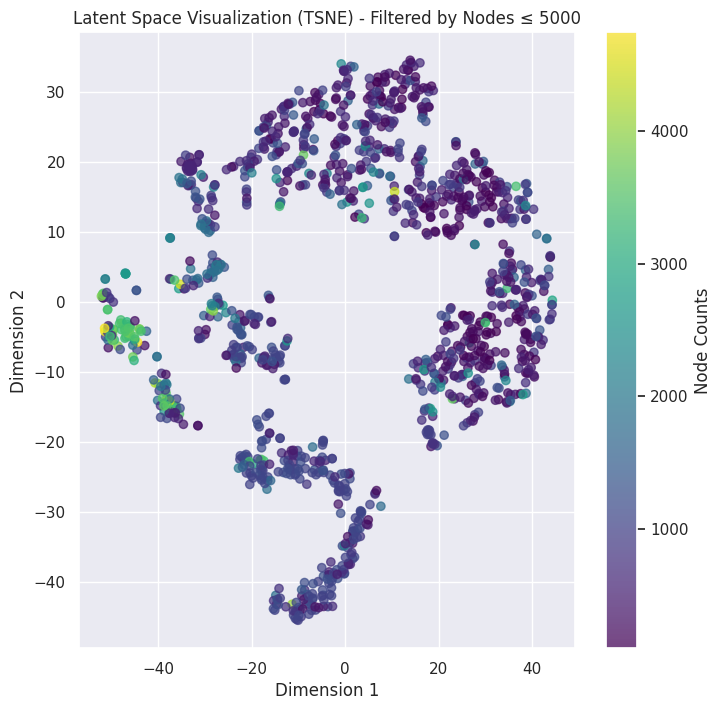

In [75]:
# Assuming `train_loader` is your DataLoader and `model` is your ProteinGraphVAE instance
visualize_latent_space_with_node_count_filtered(
    model=model,
    data_loader=augmented_train_loader,
    device=device,
    method='tsne',
    perplexity=30,
    max_nodes=5000
)

Filtered node counts: 102 - 4743


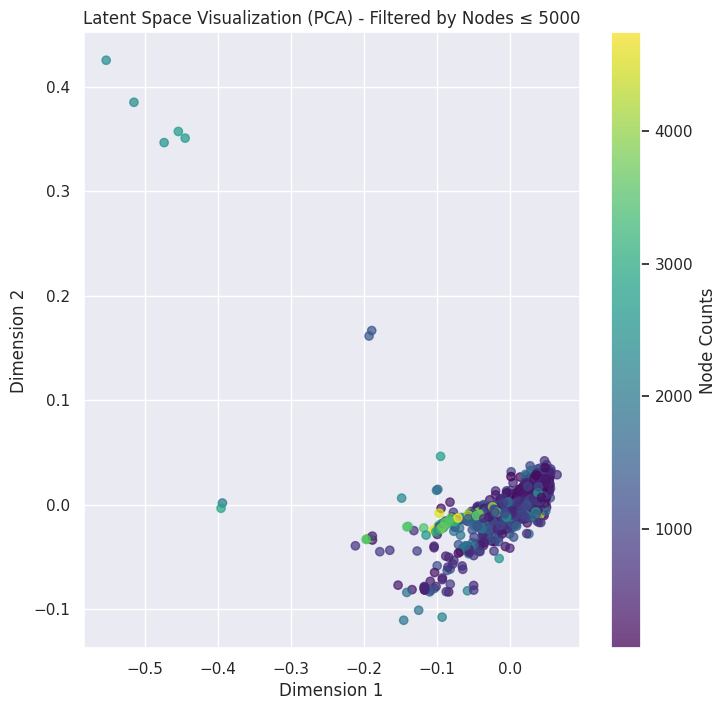

In [76]:
visualize_latent_space_with_node_count_filtered(
    model=model,
    data_loader=augmented_train_loader,
    device=device,
    method='pca',
    max_nodes=5000
)

In [77]:
def sample_and_decode(model, num_samples=5, device='cpu'):
    """
    Sample random latent vectors and decode them to check for diversity in outputs.

    Args:
        model: Trained ProteinGraphVAE model.
        num_samples: Number of samples to generate.
        device: torch device.

    Returns:
        List of decoded node features.
    """
    model.eval()
    decoded_samples = []

    with torch.no_grad():
        for _ in range(num_samples):
            z = torch.randn(1, model.latent_channels, device=device)
            node_counts = torch.tensor([500], device=device)  # Adjust node count as needed
            edge_index = torch.zeros((2, 0), dtype=torch.long, device=device)  # Dummy edge_index
            node_features, edge_attr = model.decode(z, node_counts, edge_index)
            decoded_samples.append(node_features.cpu().numpy())

    return decoded_samples



In [78]:
# Example usage
decoded_samples = sample_and_decode(model, num_samples=5, device=device)
for i, sample in enumerate(decoded_samples):
    print(f"Sample {i+1}:")
    print(sample)

Sample 1:
[[[ 0.7240552   0.64529234  0.6394588  ...  0.8718809  -0.4170152
   -0.7915679 ]
  [ 0.7229574   0.64586455  0.64022833 ...  0.86750424 -0.40763077
   -0.80512834]
  [ 0.72319686  0.64562094  0.6398709  ...  0.87262183 -0.380737
   -0.7958621 ]
  ...
  [ 0.7228036   0.64593315  0.6399021  ...  0.87210345 -0.3952356
   -0.81518614]
  [ 0.7230557   0.64609593  0.6402404  ...  0.8656109  -0.40125328
   -0.80767393]
  [ 0.7230928   0.6457911   0.6397987  ...  0.87958807 -0.40624785
   -0.80844533]]]
Sample 2:
[[[ 0.7388967   0.65021837  0.6510855  ...  0.5664859  -0.5234983
   -0.6167143 ]
  [ 0.7391462   0.64969397  0.6507124  ...  0.5698616  -0.54117805
   -0.61061907]
  [ 0.73811924  0.6499846   0.65104616 ...  0.5497684  -0.5284119
   -0.6223918 ]
  ...
  [ 0.73811835  0.6493944   0.65109575 ...  0.54934406 -0.52329594
   -0.5964874 ]
  [ 0.739416    0.64942867  0.6516462  ...  0.5547297  -0.521525
   -0.59820306]
  [ 0.7387361   0.6501917   0.6509202  ...  0.57832134 -0.538

In [79]:
import torch
import torch.nn.functional as F


import torch

import torch

def generate_protein(model, n_nodes=500, device='cpu', feature_stats=None):
    """
    Generate a new protein structure from random latent vector

    Args:
        model: Trained ProteinGraphVAE model
        n_nodes: Number of nodes to generate
        device: torch device
        feature_stats: Tuple of (means, stds) used during training for normalization
    """
    model.eval()
    z = torch.randn(1, model.latent_channels, device=device)
    node_counts = torch.tensor([n_nodes], device=device)

    # Generate the edge index using a simple approach
    edge_probability = 0.1
    num_edges = int(n_nodes * (n_nodes - 1) * edge_probability / 2)
    row = torch.randint(0, n_nodes, (num_edges,), device=device)
    col = torch.randint(0, n_nodes, (num_edges,), device=device)
    edge_index = torch.stack([row, col], dim=0)

    with torch.no_grad():
        node_features, edge_attr = model.decode(z, node_counts, edge_index)

        # Denormalize if stats provided
        if feature_stats is not None:
            means, stds = feature_stats
            node_features = node_features * stds + means

    return node_features, edge_index, edge_attr

def plot_protein_structure(node_features, edge_index, title="Protein Structure"):
    coords = node_features[:, :3].cpu().numpy()
    edge_index_np = edge_index.cpu().numpy()

    fig = plt.figure(figsize=(12, 8))
    ax = fig.add_subplot(111, projection='3d')

    # Plot nodes
    ax.scatter(coords[:, 0], coords[:, 1], coords[:, 2], s=50, c='blue')

    # Plot edges
    edges_x = []
    edges_y = []
    edges_z = []
    for i in range(edge_index_np.shape[1]):
        start_idx = edge_index_np[0, i]
        end_idx = edge_index_np[1, i]

        # Check if the indices are within the range of the node_features tensor
        if start_idx < coords.shape[0] and end_idx < coords.shape[0]:
            edges_x.extend([coords[start_idx, 0], coords[end_idx, 0], None])
            edges_y.extend([coords[start_idx, 1], coords[end_idx, 1], None])
            edges_z.extend([coords[start_idx, 2], coords[end_idx, 2], None])

    ax.plot(edges_x, edges_y, edges_z, c='gray', linewidth=1)

    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_zlabel('Z')
    ax.set_title(title)
    plt.show()

def print_node_statistics(node_features):
    """
    Print statistics about the generated nodes
    """
    print("\nNode Feature Statistics:")
    print(f"Number of nodes: {node_features.shape[0]}")

    # Print statistics for each feature
    feature_names = ['Mass', 'Avg Neighbor Dist', 'Max Neighbor Dist',
                     'Neighbor Count', 'Small Molecules', 'X', 'Y', 'Z']

    for i, name in enumerate(feature_names):
        if i == 1:  # Distance features are 2D
            values = node_features[:, 1:3]
            mean = values.mean(dim=0)
            std = values.std(dim=0)
            print(f"\n{name}:")
            print(f"Mean: {mean.tolist()}")
            print(f"Std: {std.tolist()}")
        elif i < 5:  # Other scalar features
            values = node_features[:, i]
            print(f"\n{name}:")
            print(f"Mean: {values.mean():.3f}")
            print(f"Std: {values.std():.3f}")
            print(f"Min: {values.min():.3f}")
            print(f"Max: {values.max():.3f}")

    # Print coordinate statistics
    coords = node_features[:, 5:8]
    print("\nCoordinate Statistics:")
    print(f"Center of mass: {coords.mean(dim=0).tolist()}")
    print(f"Spatial extent: {coords.std(dim=0).tolist()}")

# Usage example:
def generate_and_visualize_protein(model, n_nodes=500, device='cpu'):
    """
    Generate and visualize a new protein structure
    """
    # Generate protein
    node_features, edge_index, edge_attr = generate_protein(model, n_nodes, device)

    # Print statistics
    print_node_statistics(node_features)

    # Plot structure
    plot_protein_structure(node_features, edge_index)

    return node_features, edge_index, edge_attr



Node Feature Statistics:
Number of nodes: 1

Mass:
Mean: 0.235
Std: 0.681
Min: -1.015
Max: 0.819

Avg Neighbor Dist:
Mean: [[0.7444932460784912, 0.6393994092941284, 0.6285848617553711, 0.6350597143173218, -0.12820492684841156, 0.8096254467964172, -0.4742860496044159, -1.0184791088104248], [0.7444537878036499, 0.6400490999221802, 0.6281993389129639, 0.6354792714118958, -0.12870536744594574, 0.8083507418632507, -0.4681594669818878, -1.0109461545944214]]
Std: [[nan, nan, nan, nan, nan, nan, nan, nan], [nan, nan, nan, nan, nan, nan, nan, nan]]

Max Neighbor Dist:
Mean: 0.231
Std: 0.681
Min: -1.011
Max: 0.808

Neighbor Count:
Mean: 0.233
Std: 0.675
Min: -1.005
Max: 0.795

Small Molecules:
Mean: 0.234
Std: 0.685
Min: -1.020
Max: 0.828

Coordinate Statistics:
Center of mass: [[0.7444811463356018, 0.6402358412742615, 0.6280542016029358, 0.6365523934364319, -0.12827546894550323, 0.8128918409347534, -0.4599043130874634, -1.010532259941101], [0.7430548667907715, 0.6404359340667725, 0.62782311439

<ipython-input-79-c2524332f4c0>:87: UserWarning: std(): degrees of freedom is <= 0. Correction should be strictly less than the reduction factor (input numel divided by output numel). (Triggered internally at ../aten/src/ATen/native/ReduceOps.cpp:1823.)
  std = values.std(dim=0)
<ipython-input-79-c2524332f4c0>:103: UserWarning: std(): degrees of freedom is <= 0. Correction should be strictly less than the reduction factor (input numel divided by output numel). (Triggered internally at ../aten/src/ATen/native/ReduceOps.cpp:1823.)
  print(f"Spatial extent: {coords.std(dim=0).tolist()}")


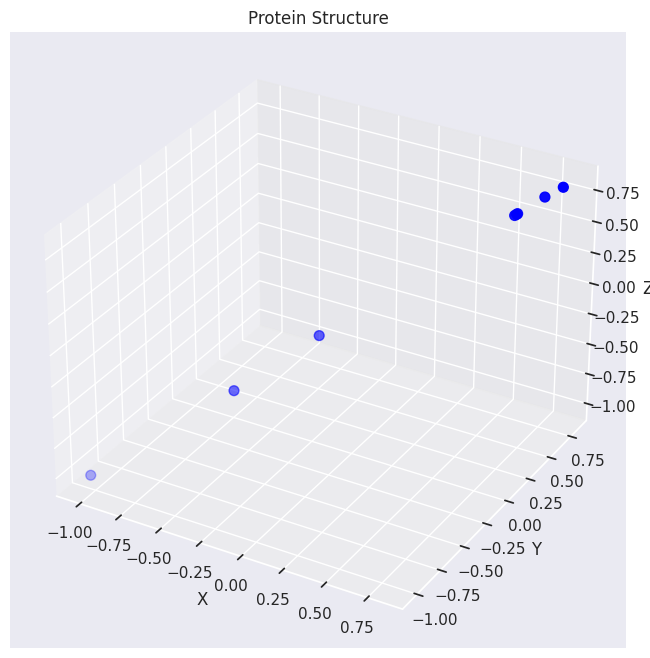


Node Feature Statistics:
Number of nodes: 1

Mass:
Mean: 0.235
Std: 0.681
Min: -1.015
Max: 0.819

Avg Neighbor Dist:
Mean: [[0.7444932460784912, 0.6393994092941284, 0.6285848617553711, 0.6350597143173218, -0.12820492684841156, 0.8096254467964172, -0.4742860496044159, -1.0184791088104248], [0.7444537878036499, 0.6400490999221802, 0.6281993389129639, 0.6354792714118958, -0.12870536744594574, 0.8083507418632507, -0.4681594669818878, -1.0109461545944214]]
Std: [[nan, nan, nan, nan, nan, nan, nan, nan], [nan, nan, nan, nan, nan, nan, nan, nan]]

Max Neighbor Dist:
Mean: 0.231
Std: 0.681
Min: -1.011
Max: 0.808

Neighbor Count:
Mean: 0.233
Std: 0.675
Min: -1.005
Max: 0.795

Small Molecules:
Mean: 0.234
Std: 0.685
Min: -1.020
Max: 0.828

Coordinate Statistics:
Center of mass: [[0.7444811463356018, 0.6402358412742615, 0.6280542016029358, 0.6365523934364319, -0.12827546894550323, 0.8128918409347534, -0.4599043130874634, -1.010532259941101], [0.7430548667907715, 0.6404359340667725, 0.62782311439

In [80]:
# Assuming you have a trained model
model = model.to(device)

# Generate and visualize a protein
node_features, edge_index, edge_attr = generate_and_visualize_protein(
    model,
    n_nodes=500,  # Adjust this number as needed
    device=device
)
print_node_statistics(node_features)

In [81]:
print_node_statistics(node_features)


Node Feature Statistics:
Number of nodes: 1

Mass:
Mean: 0.235
Std: 0.681
Min: -1.015
Max: 0.819

Avg Neighbor Dist:
Mean: [[0.7444932460784912, 0.6393994092941284, 0.6285848617553711, 0.6350597143173218, -0.12820492684841156, 0.8096254467964172, -0.4742860496044159, -1.0184791088104248], [0.7444537878036499, 0.6400490999221802, 0.6281993389129639, 0.6354792714118958, -0.12870536744594574, 0.8083507418632507, -0.4681594669818878, -1.0109461545944214]]
Std: [[nan, nan, nan, nan, nan, nan, nan, nan], [nan, nan, nan, nan, nan, nan, nan, nan]]

Max Neighbor Dist:
Mean: 0.231
Std: 0.681
Min: -1.011
Max: 0.808

Neighbor Count:
Mean: 0.233
Std: 0.675
Min: -1.005
Max: 0.795

Small Molecules:
Mean: 0.234
Std: 0.685
Min: -1.020
Max: 0.828

Coordinate Statistics:
Center of mass: [[0.7444811463356018, 0.6402358412742615, 0.6280542016029358, 0.6365523934364319, -0.12827546894550323, 0.8128918409347534, -0.4599043130874634, -1.010532259941101], [0.7430548667907715, 0.6404359340667725, 0.62782311439

<ipython-input-79-c2524332f4c0>:87: UserWarning: std(): degrees of freedom is <= 0. Correction should be strictly less than the reduction factor (input numel divided by output numel). (Triggered internally at ../aten/src/ATen/native/ReduceOps.cpp:1823.)
  std = values.std(dim=0)
<ipython-input-79-c2524332f4c0>:103: UserWarning: std(): degrees of freedom is <= 0. Correction should be strictly less than the reduction factor (input numel divided by output numel). (Triggered internally at ../aten/src/ATen/native/ReduceOps.cpp:1823.)
  print(f"Spatial extent: {coords.std(dim=0).tolist()}")


## Training

/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


Dataset prepared:
Number of training graphs: 1316
Number of test graphs: 330
Number of features per node: 8
Feature means: tensor([ 2.7947e-10,  5.3798e-09,  1.4218e-08,  1.3493e-09, -1.0347e-08,
         1.1422e-09, -7.0447e-09, -2.0753e-09])
Feature stds: tensor([1., 1., 1., 1., 1., 1., 1., 1.])
Starting training for 100 epochs...
Training on device: cuda
Number of training batches: 42
Number of validation batches: 21
KL annealing: 1e-05 -> 0.005 over 25 epochs
Orthogonal regularization strength: 0.1


Epoch 1/100 [Train]:   5%|▍         | 2/42 [00:00<00:02, 18.84it/s, loss=2.1205, recon=0.6254, kl=0.4137, ortho=1.4950]


Batch shapes:
Input x shape: torch.Size([24002, 8])
Edge index shape: torch.Size([2, 96008])
Edge attr shape: torch.Size([96008, 1])
Reconstruction shape: torch.Size([32, 3924, 8])
Edge reconstruction shape: torch.Size([96008, 1])

Detailed loss diagnostics:
Raw recon_loss: 0.7462
Raw KL loss: 0.4127
Ortho loss: 1.4981
Current beta: 0.0000
mu mean: 0.0121, std: 0.1382
logvar mean: 1.0332, std: 0.1455
mass: 0.1484
distance: 0.1458
count: 0.0648
small_mol: 0.0686
coord: 0.2254
edge: 0.0932


Epoch 1/100 [Train]:  31%|███       | 13/42 [00:00<00:01, 19.47it/s, loss=1.9310, recon=0.4989, kl=0.4560, ortho=1.4322]


Detailed loss diagnostics:
Raw recon_loss: 0.5206
Raw KL loss: 0.4223
Ortho loss: 1.4337
Current beta: 0.0000
mu mean: -0.0095, std: 0.1362
logvar mean: 1.0335, std: 0.1856
mass: 0.1351
distance: 0.1239
count: 0.0552
small_mol: 0.0635
coord: 0.0598
edge: 0.0832


Epoch 1/100 [Train]:  52%|█████▏    | 22/42 [00:01<00:01, 18.28it/s, loss=1.9199, recon=0.4933, kl=0.4345, ortho=1.4266]


Detailed loss diagnostics:
Raw recon_loss: 0.5004
Raw KL loss: 0.4424
Ortho loss: 1.4273
Current beta: 0.0000
mu mean: -0.0654, std: 0.1896
logvar mean: 1.0184, std: 0.2514
mass: 0.1386
distance: 0.1234
count: 0.0524
small_mol: 0.0597
coord: 0.0498
edge: 0.0765


Epoch 1/100 [Train]:  76%|███████▌  | 32/42 [00:01<00:00, 19.62it/s, loss=1.8393, recon=0.4157, kl=0.4352, ortho=1.4236]


Detailed loss diagnostics:
Raw recon_loss: 0.4597
Raw KL loss: 0.4454
Ortho loss: 1.4236
Current beta: 0.0000
mu mean: -0.0396, std: 0.2132
logvar mean: 1.0112, std: 0.2684
mass: 0.1281
distance: 0.1107
count: 0.0472
small_mol: 0.0549
coord: 0.0477
edge: 0.0712


Epoch 1/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.33it/s, loss=2.0958, recon=0.6448, kl=0.6355, ortho=1.4510]



Detailed loss diagnostics:
Raw recon_loss: 0.4187
Raw KL loss: 0.4417
Ortho loss: 1.4205
Current beta: 0.0000
mu mean: -0.0250, std: 0.2092
logvar mean: 1.0095, std: 0.2691
mass: 0.1152
distance: 0.1017
count: 0.0430
small_mol: 0.0495
coord: 0.0399
edge: 0.0694

Starting validation...


Epoch 1/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 64.94it/s]



Epoch [1/100] - Time: 2.50s
Train - Total: 1.9557, Recon: 0.5189, KL: 0.4496, Ortho: 1.4368, Beta: 0.0000
Feature Losses:
  mass_loss: 0.1334
  distance_loss: 0.1232
  count_loss: 0.0605
  small_mol_loss: 0.0589
  coord_loss: 0.0656
  edge_loss: 0.0772


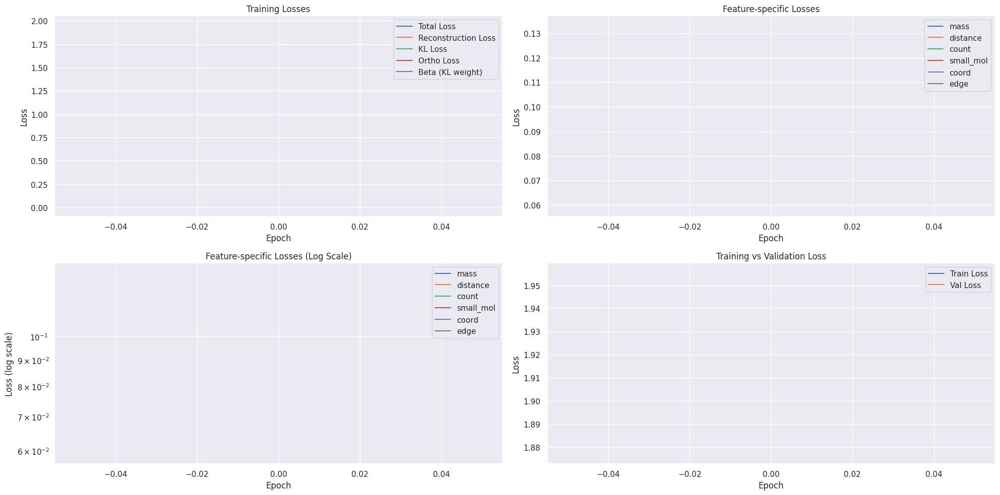

Epoch 2/100 [Train]:  10%|▉         | 4/42 [00:00<00:01, 19.17it/s, loss=1.8045, recon=0.3808, kl=0.5105, ortho=1.4236]


Detailed loss diagnostics:
Raw recon_loss: 0.4504
Raw KL loss: 0.6766
Ortho loss: 1.4220
Current beta: 0.0002
mu mean: -0.0233, std: 0.3895
logvar mean: 1.0102, std: 0.4871
mass: 0.1144
distance: 0.0987
count: 0.0421
small_mol: 0.0486
coord: 0.0773
edge: 0.0694


Epoch 2/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 20.21it/s, loss=1.7670, recon=0.3457, kl=0.4314, ortho=1.4212]


Detailed loss diagnostics:
Raw recon_loss: 0.3592
Raw KL loss: 0.4448
Ortho loss: 1.4190
Current beta: 0.0002
mu mean: -0.0384, std: 0.1608
logvar mean: 1.0331, std: 0.2401
mass: 0.0904
distance: 0.0803
count: 0.0372
small_mol: 0.0407
coord: 0.0426
edge: 0.0679


Epoch 2/100 [Train]:  55%|█████▍    | 23/42 [00:01<00:01, 18.85it/s, loss=1.7714, recon=0.3511, kl=0.4754, ortho=1.4201]


Detailed loss diagnostics:
Raw recon_loss: 0.3569
Raw KL loss: 0.4453
Ortho loss: 1.4296
Current beta: 0.0002
mu mean: -0.0008, std: 0.1633
logvar mean: 1.0320, std: 0.2462
mass: 0.0964
distance: 0.0839
count: 0.0334
small_mol: 0.0393
coord: 0.0362
edge: 0.0678


Epoch 2/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 19.85it/s, loss=1.7316, recon=0.3130, kl=0.5523, ortho=1.4185]


Detailed loss diagnostics:
Raw recon_loss: 0.2909
Raw KL loss: 0.4698
Ortho loss: 1.4204
Current beta: 0.0002
mu mean: -0.0526, std: 0.1764
logvar mean: 1.0073, std: 0.3397
mass: 0.0724
distance: 0.0657
count: 0.0296
small_mol: 0.0244
coord: 0.0321
edge: 0.0667


Epoch 2/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.26it/s, loss=1.7830, recon=0.3524, kl=0.5332, ortho=1.4304]



Detailed loss diagnostics:
Raw recon_loss: 0.2635
Raw KL loss: 0.6196
Ortho loss: 1.4216
Current beta: 0.0002
mu mean: -0.0360, std: 0.2877
logvar mean: 0.9734, std: 0.5253
mass: 0.0653
distance: 0.0616
count: 0.0275
small_mol: 0.0184
coord: 0.0227
edge: 0.0679

Starting validation...


Epoch 2/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 65.93it/s]



Epoch [2/100] - Time: 2.51s
Train - Total: 1.7786, Recon: 0.3572, KL: 0.4841, Ortho: 1.4213, Beta: 0.0002
Feature Losses:
  mass_loss: 0.0903
  distance_loss: 0.0829
  count_loss: 0.0445
  small_mol_loss: 0.0356
  coord_loss: 0.0358
  edge_loss: 0.0681


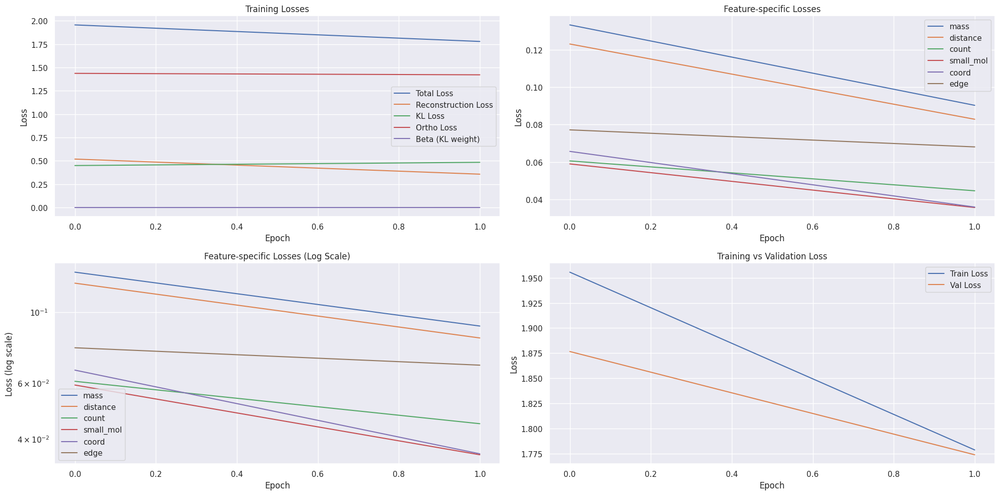

Epoch 3/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 18.02it/s, loss=1.6922, recon=0.2705, kl=0.5148, ortho=1.4215]


Detailed loss diagnostics:
Raw recon_loss: 0.3307
Raw KL loss: 0.5654
Ortho loss: 1.4188
Current beta: 0.0004
mu mean: -0.0574, std: 0.2313
logvar mean: 0.9896, std: 0.4735
mass: 0.0850
distance: 0.0775
count: 0.0287
small_mol: 0.0250
coord: 0.0479
edge: 0.0666


Epoch 3/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 19.26it/s, loss=1.8011, recon=0.3812, kl=0.5210, ortho=1.4197]


Detailed loss diagnostics:
Raw recon_loss: 0.2777
Raw KL loss: 0.5979
Ortho loss: 1.4193
Current beta: 0.0004
mu mean: -0.0424, std: 0.2499
logvar mean: 0.9753, std: 0.5135
mass: 0.0678
distance: 0.0661
count: 0.0267
small_mol: 0.0216
coord: 0.0275
edge: 0.0681


Epoch 3/100 [Train]:  57%|█████▋    | 24/42 [00:01<00:00, 20.06it/s, loss=1.7518, recon=0.3328, kl=0.4980, ortho=1.4188]


Detailed loss diagnostics:
Raw recon_loss: 0.4668
Raw KL loss: 0.6011
Ortho loss: 1.4182
Current beta: 0.0004
mu mean: -0.0677, std: 0.2804
logvar mean: 0.9509, std: 0.5444
mass: 0.0908
distance: 0.0966
count: 0.1543
small_mol: 0.0270
coord: 0.0291
edge: 0.0689


Epoch 3/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 19.93it/s, loss=1.7088, recon=0.2900, kl=0.6918, ortho=1.4186]


Detailed loss diagnostics:
Raw recon_loss: 0.4254
Raw KL loss: 0.6189
Ortho loss: 1.4226
Current beta: 0.0004
mu mean: -0.0655, std: 0.2627
logvar mean: 0.9713, std: 0.5206
mass: 0.0807
distance: 0.0939
count: 0.1413
small_mol: 0.0163
coord: 0.0210
edge: 0.0722


Epoch 3/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.35it/s, loss=1.8600, recon=0.4257, kl=0.4947, ortho=1.4341]



Detailed loss diagnostics:
Raw recon_loss: 0.3245
Raw KL loss: 0.9303
Ortho loss: 1.4180
Current beta: 0.0004
mu mean: -0.0612, std: 0.3078
logvar mean: 0.9429, std: 0.5883
mass: 0.0807
distance: 0.0766
count: 0.0272
small_mol: 0.0373
coord: 0.0354
edge: 0.0673

Starting validation...


Epoch 3/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 64.64it/s]



Epoch [3/100] - Time: 2.50s
Train - Total: 1.7321, Recon: 0.3117, KL: 0.8042, Ortho: 1.4201, Beta: 0.0004
Feature Losses:
  mass_loss: 0.0758
  distance_loss: 0.0739
  count_loss: 0.0377
  small_mol_loss: 0.0265
  coord_loss: 0.0300
  edge_loss: 0.0678


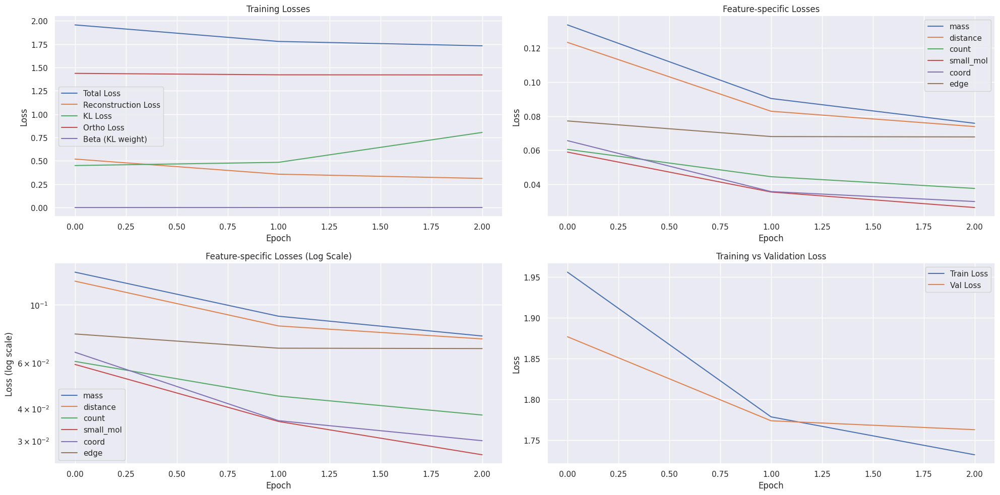

Epoch 4/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 18.29it/s, loss=1.7309, recon=0.3104, kl=0.5019, ortho=1.4202]


Detailed loss diagnostics:
Raw recon_loss: 0.2568
Raw KL loss: 0.6678
Ortho loss: 1.4169
Current beta: 0.0006
mu mean: -0.0754, std: 0.2696
logvar mean: 0.9482, std: 0.5609
mass: 0.0635
distance: 0.0621
count: 0.0259
small_mol: 0.0216
coord: 0.0175
edge: 0.0663


Epoch 4/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 20.15it/s, loss=1.7178, recon=0.2992, kl=0.4850, ortho=1.4183]


Detailed loss diagnostics:
Raw recon_loss: 0.3375
Raw KL loss: 0.4523
Ortho loss: 1.4205
Current beta: 0.0006
mu mean: -0.0298, std: 0.2584
logvar mean: 0.9363, std: 0.3975
mass: 0.0902
distance: 0.0882
count: 0.0278
small_mol: 0.0414
coord: 0.0230
edge: 0.0669


Epoch 4/100 [Train]:  57%|█████▋    | 24/42 [00:01<00:00, 19.36it/s, loss=1.6893, recon=0.2718, kl=0.4232, ortho=1.4172]


Detailed loss diagnostics:
Raw recon_loss: 0.2748
Raw KL loss: 0.4602
Ortho loss: 1.4216
Current beta: 0.0006
mu mean: -0.0160, std: 0.2289
logvar mean: 0.9528, std: 0.3816
mass: 0.0721
distance: 0.0670
count: 0.0262
small_mol: 0.0221
coord: 0.0205
edge: 0.0670


Epoch 4/100 [Train]:  76%|███████▌  | 32/42 [00:01<00:00, 20.30it/s, loss=1.8646, recon=0.4478, kl=0.5542, ortho=1.4165]


Detailed loss diagnostics:
Raw recon_loss: 0.2718
Raw KL loss: 0.5137
Ortho loss: 1.4166
Current beta: 0.0006
mu mean: -0.0351, std: 0.2510
logvar mean: 0.9465, std: 0.4527
mass: 0.0708
distance: 0.0668
count: 0.0261
small_mol: 0.0198
coord: 0.0210
edge: 0.0673


Epoch 4/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.67it/s, loss=1.8795, recon=0.4054, kl=0.4049, ortho=1.4738]



Detailed loss diagnostics:
Raw recon_loss: 0.3227
Raw KL loss: 15.4865
Ortho loss: 1.4188
Current beta: 0.0006
mu mean: -0.0554, std: 0.4501
logvar mean: 0.9403, std: 0.8208
mass: 0.0774
distance: 0.0706
count: 0.0264
small_mol: 0.0230
coord: 0.0578
edge: 0.0675

Starting validation...


Epoch 4/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 65.38it/s]



Epoch [4/100] - Time: 2.46s
Train - Total: 1.7388, Recon: 0.3181, KL: 1.4253, Ortho: 1.4199, Beta: 0.0006
Feature Losses:
  mass_loss: 0.0769
  distance_loss: 0.0759
  count_loss: 0.0412
  small_mol_loss: 0.0255
  coord_loss: 0.0308
  edge_loss: 0.0678


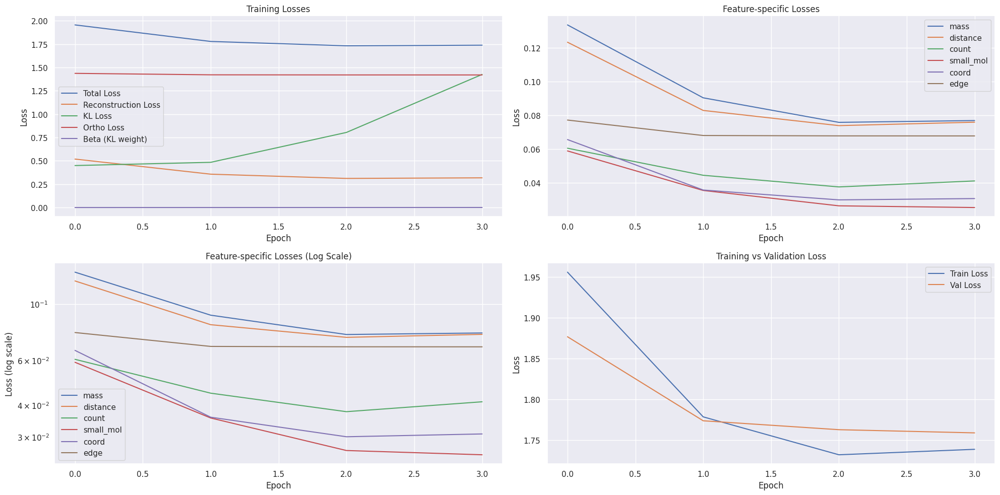

Epoch 5/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 17.72it/s, loss=1.7441, recon=0.3247, kl=0.4601, ortho=1.4190]


Detailed loss diagnostics:
Raw recon_loss: 0.3194
Raw KL loss: 0.5641
Ortho loss: 1.4176
Current beta: 0.0008
mu mean: -0.0566, std: 0.2532
logvar mean: 0.9443, std: 0.5023
mass: 0.0765
distance: 0.0841
count: 0.0342
small_mol: 0.0282
coord: 0.0268
edge: 0.0696


Epoch 5/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 19.28it/s, loss=1.6732, recon=0.2569, kl=0.4719, ortho=1.4159]


Detailed loss diagnostics:
Raw recon_loss: 0.2988
Raw KL loss: 0.5542
Ortho loss: 1.4177
Current beta: 0.0008
mu mean: -0.0364, std: 0.3483
logvar mean: 0.8961, std: 0.5494
mass: 0.0765
distance: 0.0757
count: 0.0266
small_mol: 0.0221
coord: 0.0324
edge: 0.0656


Epoch 5/100 [Train]:  55%|█████▍    | 23/42 [00:01<00:00, 19.03it/s, loss=1.6593, recon=0.2448, kl=0.6878, ortho=1.4140]


Detailed loss diagnostics:
Raw recon_loss: 0.2727
Raw KL loss: 0.5779
Ortho loss: 1.4184
Current beta: 0.0008
mu mean: -0.0500, std: 0.3496
logvar mean: 0.9137, std: 0.5503
mass: 0.0699
distance: 0.0673
count: 0.0258
small_mol: 0.0227
coord: 0.0199
edge: 0.0670


Epoch 5/100 [Train]:  79%|███████▊  | 33/42 [00:01<00:00, 19.67it/s, loss=1.6707, recon=0.2539, kl=1.4389, ortho=1.4156]


Detailed loss diagnostics:
Raw recon_loss: 0.2810
Raw KL loss: 1.9885
Ortho loss: 1.4193
Current beta: 0.0008
mu mean: -0.0405, std: 0.7725
logvar mean: 0.8023, std: 1.0412
mass: 0.0698
distance: 0.0707
count: 0.0260
small_mol: 0.0307
coord: 0.0170
edge: 0.0668


Epoch 5/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.26it/s, loss=1.8049, recon=0.3505, kl=0.4002, ortho=1.4540]



Detailed loss diagnostics:
Raw recon_loss: 0.2972
Raw KL loss: 0.4837
Ortho loss: 1.4152
Current beta: 0.0008
mu mean: -0.0307, std: 0.3267
logvar mean: 0.8983, std: 0.4688
mass: 0.0739
distance: 0.0702
count: 0.0260
small_mol: 0.0342
coord: 0.0259
edge: 0.0671

Starting validation...


Epoch 5/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 65.12it/s]



Epoch [5/100] - Time: 2.51s
Train - Total: 1.7280, Recon: 0.3080, KL: 3.1059, Ortho: 1.4175, Beta: 0.0008
Feature Losses:
  mass_loss: 0.0753
  distance_loss: 0.0752
  count_loss: 0.0401
  small_mol_loss: 0.0234
  coord_loss: 0.0264
  edge_loss: 0.0676


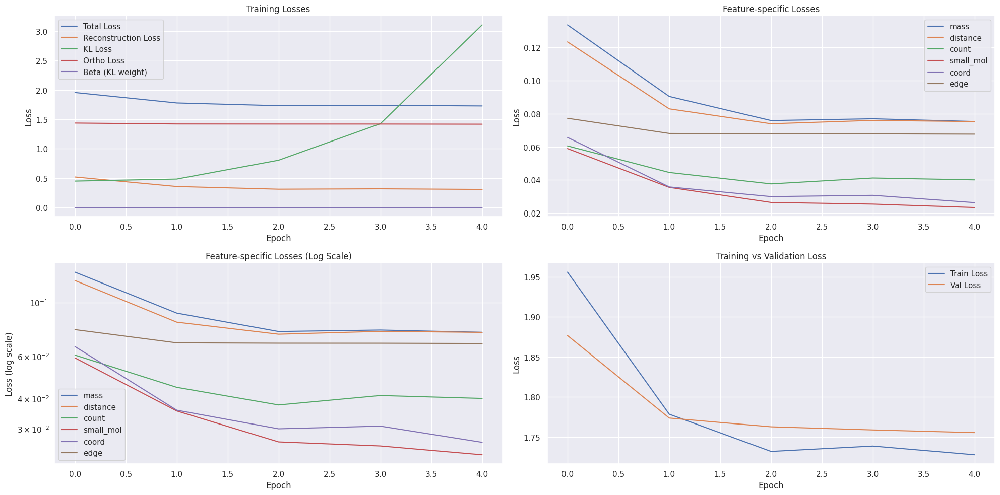

Epoch 6/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 18.35it/s, loss=1.6669, recon=0.2521, kl=0.4087, ortho=1.4144]


Detailed loss diagnostics:
Raw recon_loss: 0.2897
Raw KL loss: 0.4047
Ortho loss: 1.4159
Current beta: 0.0010
mu mean: -0.0075, std: 0.2235
logvar mean: 0.9276, std: 0.3430
mass: 0.0740
distance: 0.0721
count: 0.0262
small_mol: 0.0257
coord: 0.0251
edge: 0.0667


Epoch 6/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 20.15it/s, loss=1.7312, recon=0.3157, kl=0.4093, ortho=1.4151]


Detailed loss diagnostics:
Raw recon_loss: 0.3373
Raw KL loss: 0.4673
Ortho loss: 1.4150
Current beta: 0.0010
mu mean: -0.0069, std: 0.3258
logvar mean: 0.9095, std: 0.3905
mass: 0.0786
distance: 0.0741
count: 0.0264
small_mol: 0.0290
coord: 0.0621
edge: 0.0671


Epoch 6/100 [Train]:  55%|█████▍    | 23/42 [00:01<00:00, 19.77it/s, loss=1.7243, recon=0.3106, kl=0.5017, ortho=1.4132]


Detailed loss diagnostics:
Raw recon_loss: 0.2539
Raw KL loss: 0.4458
Ortho loss: 1.4143
Current beta: 0.0010
mu mean: -0.0237, std: 0.3939
logvar mean: 0.8964, std: 0.3734
mass: 0.0617
distance: 0.0604
count: 0.0252
small_mol: 0.0195
coord: 0.0208
edge: 0.0662


Epoch 6/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 19.63it/s, loss=1.6713, recon=0.2560, kl=0.4640, ortho=1.4149]


Detailed loss diagnostics:
Raw recon_loss: 0.2887
Raw KL loss: 0.5076
Ortho loss: 1.4170
Current beta: 0.0010
mu mean: -0.0482, std: 0.5094
logvar mean: 0.8605, std: 0.4483
mass: 0.0730
distance: 0.0723
count: 0.0261
small_mol: 0.0245
coord: 0.0256
edge: 0.0672


Epoch 6/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.69it/s, loss=1.8152, recon=0.3865, kl=0.3591, ortho=1.4284]



Detailed loss diagnostics:
Raw recon_loss: 0.2964
Raw KL loss: 0.4296
Ortho loss: 1.4149
Current beta: 0.0010
mu mean: -0.0332, std: 0.4109
logvar mean: 0.8723, std: 0.3778
mass: 0.0806
distance: 0.0794
count: 0.0265
small_mol: 0.0217
coord: 0.0198
edge: 0.0684

Starting validation...


Epoch 6/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 64.16it/s]



Epoch [6/100] - Time: 2.47s
Train - Total: 1.7279, Recon: 0.3121, KL: 0.4570, Ortho: 1.4154, Beta: 0.0010
Feature Losses:
  mass_loss: 0.0753
  distance_loss: 0.0754
  count_loss: 0.0404
  small_mol_loss: 0.0245
  coord_loss: 0.0288
  edge_loss: 0.0676


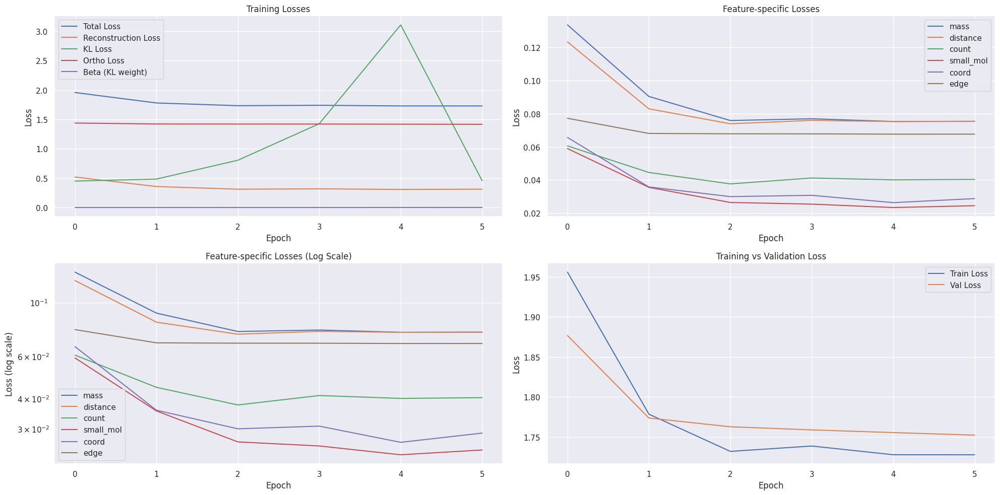

Epoch 7/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 17.97it/s, loss=1.6592, recon=0.2437, kl=0.5597, ortho=1.4148]


Detailed loss diagnostics:
Raw recon_loss: 0.3054
Raw KL loss: 0.5198
Ortho loss: 1.4126
Current beta: 0.0012
mu mean: -0.0297, std: 0.4747
logvar mean: 0.8697, std: 0.4708
mass: 0.0780
distance: 0.0753
count: 0.0265
small_mol: 0.0204
coord: 0.0383
edge: 0.0669


Epoch 7/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 20.13it/s, loss=1.6947, recon=0.2801, kl=0.4772, ortho=1.4141]


Detailed loss diagnostics:
Raw recon_loss: 0.2866
Raw KL loss: 0.6431
Ortho loss: 1.4138
Current beta: 0.0012
mu mean: -0.0220, std: 0.6653
logvar mean: 0.8386, std: 0.5843
mass: 0.0743
distance: 0.0719
count: 0.0261
small_mol: 0.0216
coord: 0.0254
edge: 0.0673


Epoch 7/100 [Train]:  55%|█████▍    | 23/42 [00:01<00:00, 19.83it/s, loss=1.7324, recon=0.3183, kl=0.6388, ortho=1.4134]


Detailed loss diagnostics:
Raw recon_loss: 0.2603
Raw KL loss: 0.9667
Ortho loss: 1.4143
Current beta: 0.0012
mu mean: -0.0732, std: 0.8250
logvar mean: 0.7470, std: 0.7933
mass: 0.0643
distance: 0.0632
count: 0.0254
small_mol: 0.0156
coord: 0.0253
edge: 0.0665


Epoch 7/100 [Train]:  79%|███████▊  | 33/42 [00:01<00:00, 19.79it/s, loss=1.7129, recon=0.2997, kl=0.4724, ortho=1.4126]


Detailed loss diagnostics:
Raw recon_loss: 0.3025
Raw KL loss: 0.7344
Ortho loss: 1.4147
Current beta: 0.0012
mu mean: -0.0842, std: 0.6999
logvar mean: 0.7317, std: 0.7228
mass: 0.0804
distance: 0.0780
count: 0.0266
small_mol: 0.0228
coord: 0.0278
edge: 0.0668


Epoch 7/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.78it/s, loss=1.8225, recon=0.3934, kl=0.3329, ortho=1.4287]



Detailed loss diagnostics:
Raw recon_loss: 0.2950
Raw KL loss: 0.9863
Ortho loss: 1.4147
Current beta: 0.0012
mu mean: -0.0180, std: 1.0301
logvar mean: 0.6710, std: 0.8552
mass: 0.0758
distance: 0.0732
count: 0.0262
small_mol: 0.0300
coord: 0.0225
edge: 0.0673

Starting validation...


Epoch 7/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 65.66it/s]



Epoch [7/100] - Time: 2.45s
Train - Total: 1.7147, Recon: 0.2995, KL: 0.6771, Ortho: 1.4144, Beta: 0.0012
Feature Losses:
  mass_loss: 0.0740
  distance_loss: 0.0735
  count_loss: 0.0351
  small_mol_loss: 0.0235
  coord_loss: 0.0258
  edge_loss: 0.0676


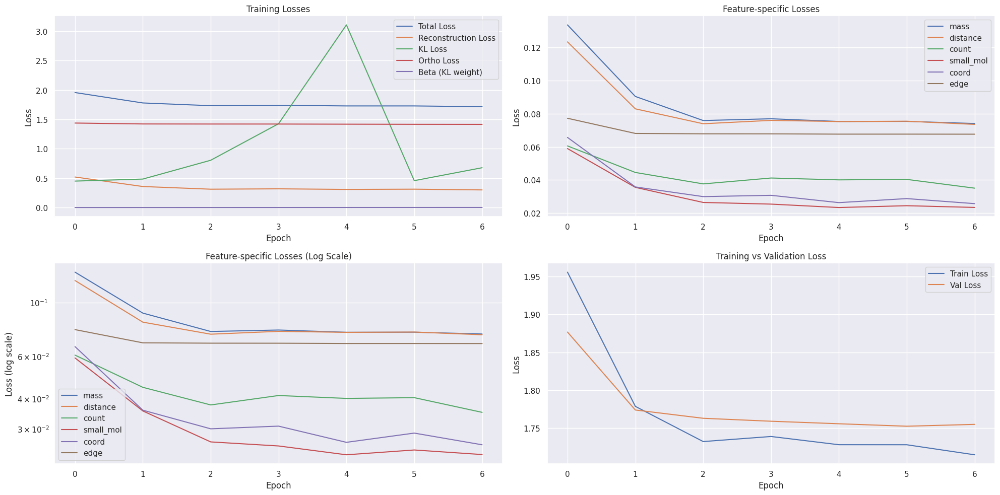

Epoch 8/100 [Train]:  10%|▉         | 4/42 [00:00<00:01, 19.04it/s, loss=1.7043, recon=0.2905, kl=0.6283, ortho=1.4128]


Detailed loss diagnostics:
Raw recon_loss: 0.2775
Raw KL loss: 0.7191
Ortho loss: 1.4150
Current beta: 0.0014
mu mean: -0.0271, std: 0.6422
logvar mean: 0.7618, std: 0.6772
mass: 0.0771
distance: 0.0743
count: 0.0263
small_mol: 0.0172
coord: 0.0158
edge: 0.0669


Epoch 8/100 [Train]:  31%|███       | 13/42 [00:00<00:01, 18.88it/s, loss=1.6819, recon=0.2675, kl=0.4697, ortho=1.4137]


Detailed loss diagnostics:
Raw recon_loss: 0.2808
Raw KL loss: 0.4429
Ortho loss: 1.4122
Current beta: 0.0014
mu mean: -0.0170, std: 0.5610
logvar mean: 0.7566, std: 0.5013
mass: 0.0731
distance: 0.0690
count: 0.0260
small_mol: 0.0177
coord: 0.0273
edge: 0.0677


Epoch 8/100 [Train]:  52%|█████▏    | 22/42 [00:01<00:01, 18.88it/s, loss=1.7251, recon=0.3107, kl=0.3382, ortho=1.4139]


Detailed loss diagnostics:
Raw recon_loss: 0.2567
Raw KL loss: 0.5144
Ortho loss: 1.4149
Current beta: 0.0014
mu mean: -0.0001, std: 0.6707
logvar mean: 0.7421, std: 0.5570
mass: 0.0628
distance: 0.0608
count: 0.0252
small_mol: 0.0167
coord: 0.0247
edge: 0.0665


Epoch 8/100 [Train]:  79%|███████▊  | 33/42 [00:01<00:00, 19.14it/s, loss=1.6765, recon=0.2627, kl=0.3562, ortho=1.4133]


Detailed loss diagnostics:
Raw recon_loss: 0.2765
Raw KL loss: 0.2983
Ortho loss: 1.4138
Current beta: 0.0014
mu mean: -0.0290, std: 0.2246
logvar mean: 0.7958, std: 0.3279
mass: 0.0664
distance: 0.0732
count: 0.0316
small_mol: 0.0156
coord: 0.0207
edge: 0.0690


Epoch 8/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 18.93it/s, loss=3.2897, recon=1.8585, kl=0.2568, ortho=1.4308]



Detailed loss diagnostics:
Raw recon_loss: 0.2963
Raw KL loss: 0.3845
Ortho loss: 1.4133
Current beta: 0.0014
mu mean: 0.0103, std: 0.5209
logvar mean: 0.7002, std: 0.4868
mass: 0.0749
distance: 0.0766
count: 0.0261
small_mol: 0.0323
coord: 0.0192
edge: 0.0672

Starting validation...


Epoch 8/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 64.89it/s]



Epoch [8/100] - Time: 2.55s
Train - Total: 1.7472, Recon: 0.3315, KL: 1.0664, Ortho: 1.4142, Beta: 0.0014
Feature Losses:
  mass_loss: 0.0734
  distance_loss: 0.0791
  count_loss: 0.0630
  small_mol_loss: 0.0220
  coord_loss: 0.0259
  edge_loss: 0.0680


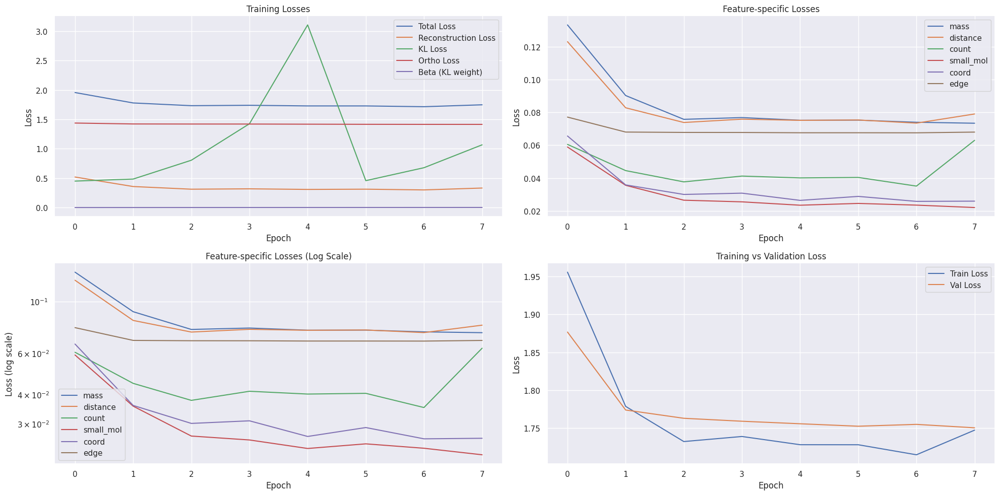

Epoch 9/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 18.66it/s, loss=1.6895, recon=0.2735, kl=0.5608, ortho=1.4151]


Detailed loss diagnostics:
Raw recon_loss: 0.2971
Raw KL loss: 0.3675
Ortho loss: 1.4148
Current beta: 0.0016
mu mean: -0.0677, std: 0.3818
logvar mean: 0.7550, std: 0.4358
mass: 0.0727
distance: 0.0711
count: 0.0260
small_mol: 0.0214
coord: 0.0381
edge: 0.0678


Epoch 9/100 [Train]:  29%|██▊       | 12/42 [00:00<00:01, 16.96it/s, loss=1.6683, recon=0.2517, kl=0.8029, ortho=1.4154]


Detailed loss diagnostics:
Raw recon_loss: 0.4718
Raw KL loss: 0.7063
Ortho loss: 1.4141
Current beta: 0.0016
mu mean: -0.0276, std: 0.8546
logvar mean: 0.5908, std: 0.7500
mass: 0.0802
distance: 0.0935
count: 0.1615
small_mol: 0.0275
coord: 0.0402
edge: 0.0688


Epoch 9/100 [Train]:  57%|█████▋    | 24/42 [00:01<00:00, 19.36it/s, loss=1.7126, recon=0.2987, kl=0.4332, ortho=1.4132]


Detailed loss diagnostics:
Raw recon_loss: 0.2717
Raw KL loss: 0.4644
Ortho loss: 1.4128
Current beta: 0.0016
mu mean: -0.0403, std: 0.5346
logvar mean: 0.6946, std: 0.5534
mass: 0.0684
distance: 0.0681
count: 0.0254
small_mol: 0.0158
coord: 0.0261
edge: 0.0679


Epoch 9/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 18.89it/s, loss=1.6666, recon=0.2519, kl=0.4903, ortho=1.4140]


Detailed loss diagnostics:
Raw recon_loss: 0.3126
Raw KL loss: 0.7971
Ortho loss: 1.4134
Current beta: 0.0016
mu mean: -0.1017, std: 0.9623
logvar mean: 0.4872, std: 0.8784
mass: 0.0834
distance: 0.0814
count: 0.0268
small_mol: 0.0238
coord: 0.0309
edge: 0.0663


Epoch 9/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 18.28it/s, loss=1.7945, recon=0.3560, kl=0.4967, ortho=1.4377]



Detailed loss diagnostics:
Raw recon_loss: 0.3002
Raw KL loss: 0.8930
Ortho loss: 1.4142
Current beta: 0.0016
mu mean: -0.0589, std: 1.0859
logvar mean: 0.3802, std: 0.9948
mass: 0.0791
distance: 0.0764
count: 0.0265
small_mol: 0.0263
coord: 0.0254
edge: 0.0665

Starting validation...


Epoch 9/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 62.80it/s]



Epoch [9/100] - Time: 2.64s
Train - Total: 1.7143, Recon: 0.2985, KL: 0.6297, Ortho: 1.4148, Beta: 0.0016
Feature Losses:
  mass_loss: 0.0748
  distance_loss: 0.0743
  count_loss: 0.0365
  small_mol_loss: 0.0222
  coord_loss: 0.0231
  edge_loss: 0.0676


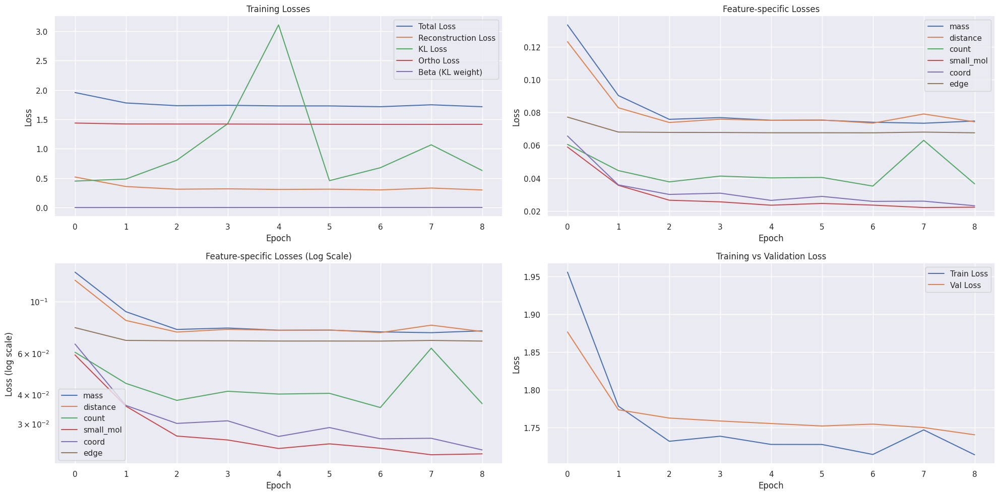

Epoch 10/100 [Train]:  10%|▉         | 4/42 [00:00<00:01, 19.40it/s, loss=1.6750, recon=0.2613, kl=0.7567, ortho=1.4124]


Detailed loss diagnostics:
Raw recon_loss: 0.4420
Raw KL loss: 0.7575
Ortho loss: 1.4154
Current beta: 0.0018
mu mean: -0.1333, std: 0.9139
logvar mean: 0.4286, std: 0.8619
mass: 0.0683
distance: 0.0971
count: 0.1616
small_mol: 0.0176
coord: 0.0227
edge: 0.0745


Epoch 10/100 [Train]:  31%|███       | 13/42 [00:00<00:01, 19.44it/s, loss=1.7610, recon=0.3438, kl=0.7169, ortho=1.4159]


Detailed loss diagnostics:
Raw recon_loss: 0.2652
Raw KL loss: 0.5829
Ortho loss: 1.4135
Current beta: 0.0018
mu mean: -0.0023, std: 0.8213
logvar mean: 0.4167, std: 0.8614
mass: 0.0646
distance: 0.0633
count: 0.0253
small_mol: 0.0170
coord: 0.0278
edge: 0.0671


Epoch 10/100 [Train]:  55%|█████▍    | 23/42 [00:01<00:01, 18.84it/s, loss=1.8228, recon=0.4100, kl=0.6444, ortho=1.4116]


Detailed loss diagnostics:
Raw recon_loss: 0.3244
Raw KL loss: 0.6023
Ortho loss: 1.4127
Current beta: 0.0018
mu mean: -0.0734, std: 0.8348
logvar mean: 0.3732, std: 0.8568
mass: 0.0926
distance: 0.0880
count: 0.0275
small_mol: 0.0228
coord: 0.0267
edge: 0.0667


Epoch 10/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 19.18it/s, loss=1.7269, recon=0.3113, kl=1.0452, ortho=1.4137]


Detailed loss diagnostics:
Raw recon_loss: 0.3074
Raw KL loss: 0.7583
Ortho loss: 1.4153
Current beta: 0.0018
mu mean: -0.0089, std: 1.0064
logvar mean: 0.1800, std: 1.0808
mass: 0.0787
distance: 0.0778
count: 0.0265
small_mol: 0.0381
coord: 0.0194
edge: 0.0669


Epoch 10/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.14it/s, loss=1.8465, recon=0.4154, kl=1.0789, ortho=1.4292]



Detailed loss diagnostics:
Raw recon_loss: 0.2539
Raw KL loss: 0.8946
Ortho loss: 1.4146
Current beta: 0.0018
mu mean: -0.1269, std: 1.1020
logvar mean: 0.0924, std: 1.2120
mass: 0.0658
distance: 0.0654
count: 0.0255
small_mol: 0.0189
coord: 0.0126
edge: 0.0657

Starting validation...


Epoch 10/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 65.49it/s]



Epoch [10/100] - Time: 2.52s
Train - Total: 1.7124, Recon: 0.2976, KL: 0.7090, Ortho: 1.4136, Beta: 0.0018
Feature Losses:
  mass_loss: 0.0757
  distance_loss: 0.0750
  count_loss: 0.0355
  small_mol_loss: 0.0223
  coord_loss: 0.0214
  edge_loss: 0.0676


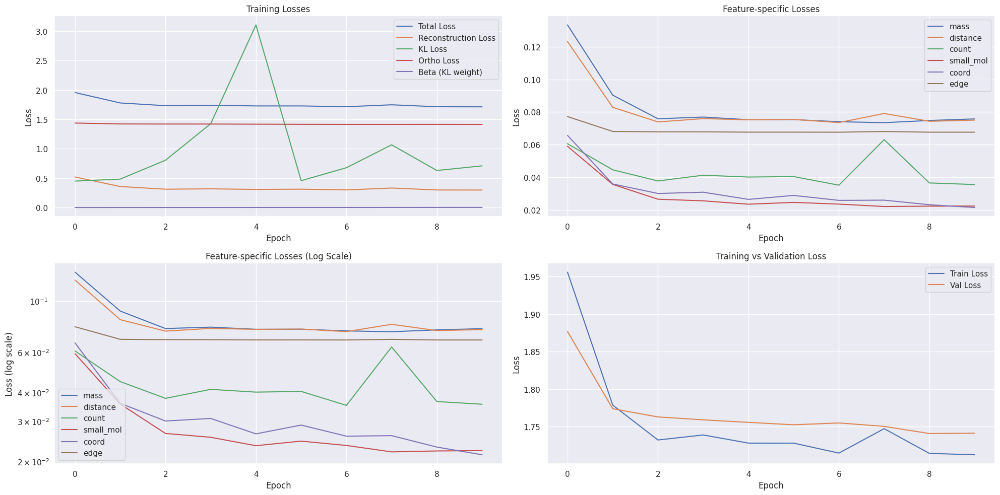

Epoch 11/100 [Train]:   7%|▋         | 3/42 [00:00<00:01, 20.87it/s, loss=1.7158, recon=0.3006, kl=0.7382, ortho=1.4137]


Detailed loss diagnostics:
Raw recon_loss: 0.2776
Raw KL loss: 0.7098
Ortho loss: 1.4132
Current beta: 0.0020
mu mean: -0.1041, std: 0.9489
logvar mean: 0.1719, std: 1.0701
mass: 0.0719
distance: 0.0695
count: 0.0259
small_mol: 0.0205
coord: 0.0236
edge: 0.0662


Epoch 11/100 [Train]:  29%|██▊       | 12/42 [00:00<00:01, 19.97it/s, loss=1.6865, recon=0.2724, kl=0.4073, ortho=1.4132]


Detailed loss diagnostics:
Raw recon_loss: 0.3027
Raw KL loss: 0.3390
Ortho loss: 1.4144
Current beta: 0.0020
mu mean: -0.0157, std: 0.5629
logvar mean: 0.2734, std: 0.7475
mass: 0.0852
distance: 0.0795
count: 0.0267
small_mol: 0.0214
coord: 0.0223
edge: 0.0676


Epoch 11/100 [Train]:  57%|█████▋    | 24/42 [00:01<00:00, 19.77it/s, loss=1.6852, recon=0.2706, kl=0.4870, ortho=1.4136]


Detailed loss diagnostics:
Raw recon_loss: 0.3001
Raw KL loss: 0.3034
Ortho loss: 1.4132
Current beta: 0.0020
mu mean: -0.0496, std: 0.4583
logvar mean: 0.3353, std: 0.6955
mass: 0.0777
distance: 0.0761
count: 0.0263
small_mol: 0.0191
coord: 0.0341
edge: 0.0668


Epoch 11/100 [Train]:  79%|███████▊  | 33/42 [00:01<00:00, 18.72it/s, loss=1.6929, recon=0.2789, kl=0.4626, ortho=1.4131]


Detailed loss diagnostics:
Raw recon_loss: 0.3218
Raw KL loss: 0.8934
Ortho loss: 1.4167
Current beta: 0.0020
mu mean: -0.1861, std: 1.0919
logvar mean: -0.0983, std: 1.2704
mass: 0.0668
distance: 0.0762
count: 0.0752
small_mol: 0.0139
coord: 0.0210
edge: 0.0688


Epoch 11/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.72it/s, loss=1.9264, recon=0.4976, kl=0.1828, ortho=1.4284]



Detailed loss diagnostics:
Raw recon_loss: 0.2653
Raw KL loss: 0.4884
Ortho loss: 1.4156
Current beta: 0.0020
mu mean: -0.0935, std: 0.7209
logvar mean: 0.1772, std: 1.0193
mass: 0.0726
distance: 0.0741
count: 0.0260
small_mol: 0.0095
coord: 0.0164
edge: 0.0667

Starting validation...


Epoch 11/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 63.80it/s]



Epoch [11/100] - Time: 2.47s
Train - Total: 1.7122, Recon: 0.2968, KL: 0.6087, Ortho: 1.4142, Beta: 0.0020
Feature Losses:
  mass_loss: 0.0745
  distance_loss: 0.0736
  count_loss: 0.0373
  small_mol_loss: 0.0226
  coord_loss: 0.0212
  edge_loss: 0.0677


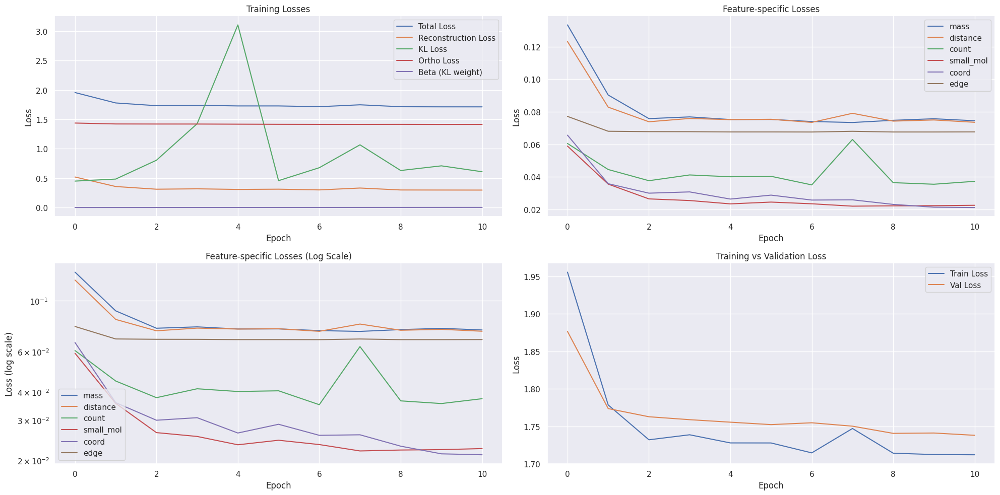

Epoch 12/100 [Train]:   5%|▍         | 2/42 [00:00<00:02, 16.19it/s, loss=1.6984, recon=0.2833, kl=0.5108, ortho=1.4140]


Detailed loss diagnostics:
Raw recon_loss: 0.2612
Raw KL loss: 0.6496
Ortho loss: 1.4135
Current beta: 0.0022
mu mean: -0.0300, std: 0.8893
logvar mean: -0.0678, std: 1.1754
mass: 0.0642
distance: 0.0633
count: 0.0253
small_mol: 0.0140
coord: 0.0261
edge: 0.0684


Epoch 12/100 [Train]:  31%|███       | 13/42 [00:00<00:01, 18.81it/s, loss=1.6683, recon=0.2550, kl=0.5013, ortho=1.4122]


Detailed loss diagnostics:
Raw recon_loss: 0.2786
Raw KL loss: 0.8929
Ortho loss: 1.4116
Current beta: 0.0022
mu mean: -0.0337, std: 1.0921
logvar mean: -0.2854, std: 1.4542
mass: 0.0741
distance: 0.0716
count: 0.0261
small_mol: 0.0250
coord: 0.0156
edge: 0.0662


Epoch 12/100 [Train]:  52%|█████▏    | 22/42 [00:01<00:01, 19.74it/s, loss=1.6983, recon=0.2841, kl=0.6498, ortho=1.4128]


Detailed loss diagnostics:
Raw recon_loss: 0.2469
Raw KL loss: 0.5003
Ortho loss: 1.4123
Current beta: 0.0022
mu mean: -0.0909, std: 0.7575
logvar mean: -0.0665, std: 1.0256
mass: 0.0641
distance: 0.0627
count: 0.0253
small_mol: 0.0138
coord: 0.0146
edge: 0.0663


Epoch 12/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 19.29it/s, loss=1.6549, recon=0.2415, kl=0.4744, ortho=1.4124]


Detailed loss diagnostics:
Raw recon_loss: 0.4169
Raw KL loss: 0.4363
Ortho loss: 1.4112
Current beta: 0.0022
mu mean: -0.0105, std: 0.7028
logvar mean: -0.0556, std: 1.1052
mass: 0.0777
distance: 0.0968
count: 0.1328
small_mol: 0.0171
coord: 0.0217
edge: 0.0706


Epoch 12/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.48it/s, loss=1.7592, recon=0.3310, kl=0.6468, ortho=1.4268]



Detailed loss diagnostics:
Raw recon_loss: 0.2418
Raw KL loss: 0.7544
Ortho loss: 1.4130
Current beta: 0.0022
mu mean: -0.0723, std: 0.9890
logvar mean: -0.4011, std: 1.3549
mass: 0.0632
distance: 0.0629
count: 0.0252
small_mol: 0.0139
coord: 0.0105
edge: 0.0660

Starting validation...


Epoch 12/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 62.87it/s]



Epoch [12/100] - Time: 2.50s
Train - Total: 1.7087, Recon: 0.2938, KL: 0.6295, Ortho: 1.4135, Beta: 0.0022
Feature Losses:
  mass_loss: 0.0732
  distance_loss: 0.0737
  count_loss: 0.0383
  small_mol_loss: 0.0210
  coord_loss: 0.0200
  edge_loss: 0.0676


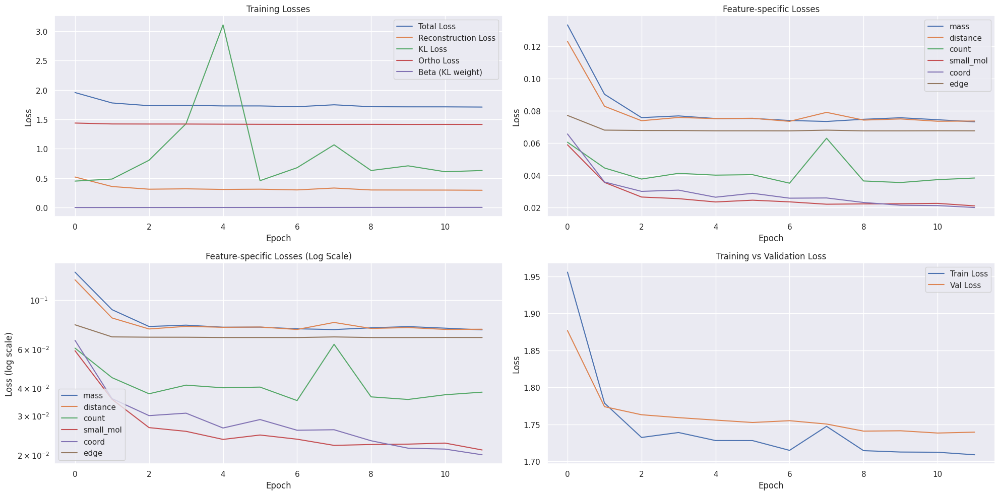

Epoch 13/100 [Train]:  10%|▉         | 4/42 [00:00<00:01, 19.08it/s, loss=1.7026, recon=0.2860, kl=0.8047, ortho=1.4147]


Detailed loss diagnostics:
Raw recon_loss: 0.2994
Raw KL loss: 1.1170
Ortho loss: 1.4151
Current beta: 0.0024
mu mean: -0.1898, std: 1.2323
logvar mean: -0.6900, std: 1.5131
mass: 0.0740
distance: 0.0730
count: 0.0261
small_mol: 0.0260
coord: 0.0334
edge: 0.0668


Epoch 13/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 19.37it/s, loss=1.7421, recon=0.3271, kl=0.3648, ortho=1.4142]


Detailed loss diagnostics:
Raw recon_loss: 0.2989
Raw KL loss: 0.9879
Ortho loss: 1.4132
Current beta: 0.0024
mu mean: -0.1031, std: 1.1699
logvar mean: -0.5615, std: 1.4498
mass: 0.0763
distance: 0.0740
count: 0.0262
small_mol: 0.0228
coord: 0.0324
edge: 0.0671


Epoch 13/100 [Train]:  52%|█████▏    | 22/42 [00:01<00:00, 20.03it/s, loss=1.7091, recon=0.2953, kl=0.6368, ortho=1.4123]


Detailed loss diagnostics:
Raw recon_loss: 0.2783
Raw KL loss: 0.8488
Ortho loss: 1.4128
Current beta: 0.0024
mu mean: 0.0066, std: 1.0686
logvar mean: -0.3965, std: 1.4701
mass: 0.0735
distance: 0.0700
count: 0.0259
small_mol: 0.0252
coord: 0.0163
edge: 0.0675


Epoch 13/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 20.40it/s, loss=1.6856, recon=0.2708, kl=0.5530, ortho=1.4135]


Detailed loss diagnostics:
Raw recon_loss: 0.2878
Raw KL loss: 0.9923
Ortho loss: 1.4152
Current beta: 0.0024
mu mean: -0.0653, std: 1.1375
logvar mean: -0.8170, std: 1.4561
mass: 0.0754
distance: 0.0742
count: 0.0263
small_mol: 0.0323
coord: 0.0127
edge: 0.0669


Epoch 13/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.55it/s, loss=1.7457, recon=0.3161, kl=1.0958, ortho=1.4270]



Detailed loss diagnostics:
Raw recon_loss: 0.2694
Raw KL loss: 0.4533
Ortho loss: 1.4134
Current beta: 0.0024
mu mean: -0.1061, std: 0.7108
logvar mean: -0.2869, std: 1.0676
mass: 0.0741
distance: 0.0726
count: 0.0261
small_mol: 0.0193
coord: 0.0108
edge: 0.0664

Starting validation...


Epoch 13/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 65.49it/s]



Epoch [13/100] - Time: 2.48s
Train - Total: 1.7055, Recon: 0.2908, KL: 0.6218, Ortho: 1.4132, Beta: 0.0024
Feature Losses:
  mass_loss: 0.0735
  distance_loss: 0.0735
  count_loss: 0.0372
  small_mol_loss: 0.0198
  coord_loss: 0.0192
  edge_loss: 0.0676


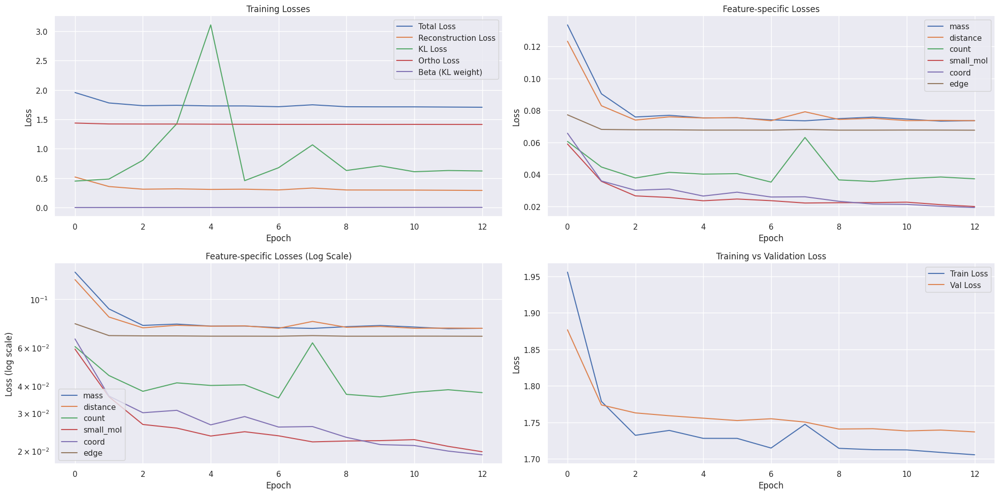

Epoch 14/100 [Train]:   5%|▍         | 2/42 [00:00<00:02, 17.01it/s, loss=1.7112, recon=0.2992, kl=0.3314, ortho=1.4112]


Detailed loss diagnostics:
Raw recon_loss: 0.2598
Raw KL loss: 0.4668
Ortho loss: 1.4121
Current beta: 0.0026
mu mean: -0.0846, std: 0.7243
logvar mean: -0.3267, std: 1.1583
mass: 0.0701
distance: 0.0696
count: 0.0257
small_mol: 0.0152
coord: 0.0115
edge: 0.0678


Epoch 14/100 [Train]:  31%|███       | 13/42 [00:00<00:01, 19.35it/s, loss=1.6844, recon=0.2702, kl=0.5635, ortho=1.4128]


Detailed loss diagnostics:
Raw recon_loss: 0.3054
Raw KL loss: 0.4768
Ortho loss: 1.4110
Current beta: 0.0026
mu mean: -0.0229, std: 0.7439
logvar mean: -0.3970, std: 1.0512
mass: 0.0809
distance: 0.0774
count: 0.0264
small_mol: 0.0304
coord: 0.0215
edge: 0.0687


Epoch 14/100 [Train]:  52%|█████▏    | 22/42 [00:01<00:00, 20.79it/s, loss=1.6931, recon=0.2790, kl=0.8635, ortho=1.4119]


Detailed loss diagnostics:
Raw recon_loss: 0.4177
Raw KL loss: 0.2125
Ortho loss: 1.4109
Current beta: 0.0026
mu mean: -0.0598, std: 0.4143
logvar mean: -0.1396, std: 0.7398
mass: 0.0774
distance: 0.0955
count: 0.1268
small_mol: 0.0212
coord: 0.0277
edge: 0.0692


Epoch 14/100 [Train]:  79%|███████▊  | 33/42 [00:01<00:00, 18.93it/s, loss=1.7014, recon=0.2883, kl=0.3233, ortho=1.4122]


Detailed loss diagnostics:
Raw recon_loss: 0.4991
Raw KL loss: 0.4163
Ortho loss: 1.4138
Current beta: 0.0026
mu mean: -0.0177, std: 0.6583
logvar mean: -0.4412, std: 1.0075
mass: 0.0998
distance: 0.1081
count: 0.1703
small_mol: 0.0293
coord: 0.0207
edge: 0.0710


Epoch 14/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.78it/s, loss=1.7803, recon=0.3449, kl=0.3532, ortho=1.4345]



Detailed loss diagnostics:
Raw recon_loss: 0.2648
Raw KL loss: 0.6052
Ortho loss: 1.4120
Current beta: 0.0026
mu mean: -0.0657, std: 0.8115
logvar mean: -0.6559, std: 1.2665
mass: 0.0664
distance: 0.0648
count: 0.0255
small_mol: 0.0136
coord: 0.0268
edge: 0.0678

Starting validation...


Epoch 14/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 64.56it/s]



Epoch [14/100] - Time: 2.46s
Train - Total: 1.7124, Recon: 0.2979, KL: 0.5129, Ortho: 1.4132, Beta: 0.0026
Feature Losses:
  mass_loss: 0.0748
  distance_loss: 0.0753
  count_loss: 0.0403
  small_mol_loss: 0.0202
  coord_loss: 0.0197
  edge_loss: 0.0677


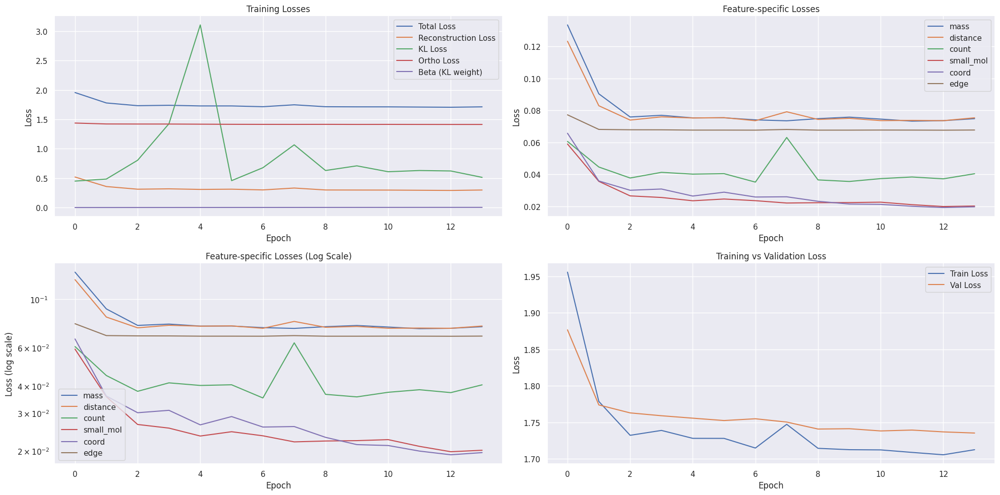

Epoch 15/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 18.20it/s, loss=1.6929, recon=0.2792, kl=0.3592, ortho=1.4127]


Detailed loss diagnostics:
Raw recon_loss: 0.2411
Raw KL loss: 0.7112
Ortho loss: 1.4136
Current beta: 0.0028
mu mean: -0.1019, std: 0.9417
logvar mean: -0.6920, std: 1.2742
mass: 0.0610
distance: 0.0599
count: 0.0250
small_mol: 0.0155
coord: 0.0132
edge: 0.0665


Epoch 15/100 [Train]:  31%|███       | 13/42 [00:00<00:01, 18.40it/s, loss=1.6864, recon=0.2731, kl=0.4572, ortho=1.4120]


Detailed loss diagnostics:
Raw recon_loss: 0.2750
Raw KL loss: 0.5459
Ortho loss: 1.4136
Current beta: 0.0028
mu mean: -0.0202, std: 0.8110
logvar mean: -0.5568, std: 1.1084
mass: 0.0724
distance: 0.0695
count: 0.0258
small_mol: 0.0258
coord: 0.0140
edge: 0.0675


Epoch 15/100 [Train]:  55%|█████▍    | 23/42 [00:01<00:01, 18.64it/s, loss=1.6771, recon=0.2607, kl=0.5660, ortho=1.4148]


Detailed loss diagnostics:
Raw recon_loss: 0.2759
Raw KL loss: 0.4005
Ortho loss: 1.4113
Current beta: 0.0028
mu mean: -0.0473, std: 0.6662
logvar mean: -0.4504, std: 0.9709
mass: 0.0756
distance: 0.0716
count: 0.0258
small_mol: 0.0185
coord: 0.0157
edge: 0.0687


Epoch 15/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 19.22it/s, loss=1.6670, recon=0.2518, kl=1.0483, ortho=1.4123]


Detailed loss diagnostics:
Raw recon_loss: 0.3272
Raw KL loss: 0.4435
Ortho loss: 1.4109
Current beta: 0.0028
mu mean: -0.0504, std: 0.6759
logvar mean: -0.6234, std: 1.0249
mass: 0.0693
distance: 0.0724
count: 0.0726
small_mol: 0.0174
coord: 0.0243
edge: 0.0713


Epoch 15/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 18.91it/s, loss=1.7256, recon=0.2919, kl=1.2450, ortho=1.4302]



Detailed loss diagnostics:
Raw recon_loss: 0.2814
Raw KL loss: 0.5901
Ortho loss: 1.4125
Current beta: 0.0028
mu mean: -0.1027, std: 0.8195
logvar mean: -0.7160, std: 1.1629
mass: 0.0781
distance: 0.0732
count: 0.0262
small_mol: 0.0180
coord: 0.0197
edge: 0.0662

Starting validation...


Epoch 15/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 64.58it/s]



Epoch [15/100] - Time: 2.55s
Train - Total: 1.7006, Recon: 0.2865, KL: 0.5337, Ortho: 1.4126, Beta: 0.0028
Feature Losses:
  mass_loss: 0.0730
  distance_loss: 0.0732
  count_loss: 0.0366
  small_mol_loss: 0.0184
  coord_loss: 0.0179
  edge_loss: 0.0675


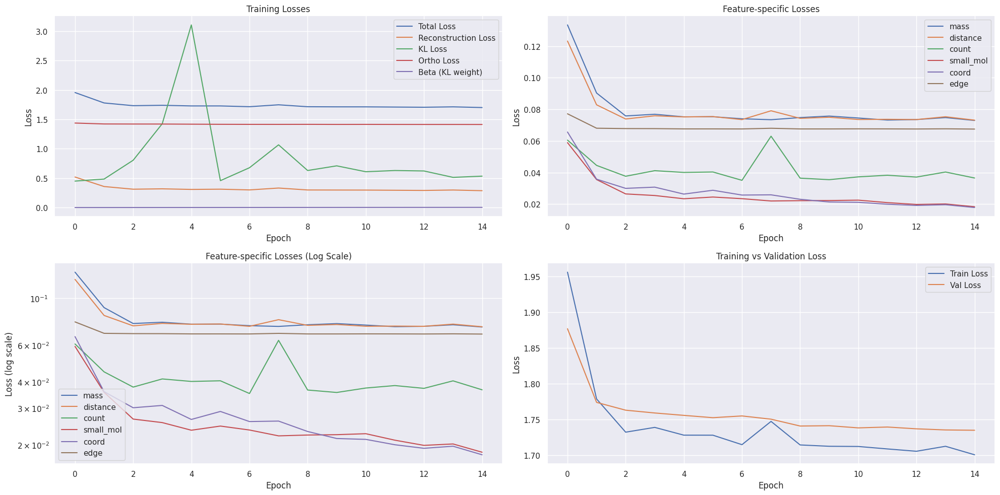

Epoch 16/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 18.73it/s, loss=1.6951, recon=0.2804, kl=0.3994, ortho=1.4136]


Detailed loss diagnostics:
Raw recon_loss: 0.2541
Raw KL loss: 0.5966
Ortho loss: 1.4128
Current beta: 0.0030
mu mean: -0.0130, std: 0.8177
logvar mean: -0.8064, std: 1.1619
mass: 0.0629
distance: 0.0606
count: 0.0251
small_mol: 0.0143
coord: 0.0233
edge: 0.0678


Epoch 16/100 [Train]:  31%|███       | 13/42 [00:00<00:01, 19.87it/s, loss=1.6764, recon=0.2623, kl=0.5255, ortho=1.4126]


Detailed loss diagnostics:
Raw recon_loss: 0.2671
Raw KL loss: 0.4681
Ortho loss: 1.4135
Current beta: 0.0030
mu mean: -0.0074, std: 0.6462
logvar mean: -0.8825, std: 1.0935
mass: 0.0748
distance: 0.0714
count: 0.0259
small_mol: 0.0106
coord: 0.0157
edge: 0.0687


Epoch 16/100 [Train]:  57%|█████▋    | 24/42 [00:01<00:00, 19.44it/s, loss=1.6519, recon=0.2396, kl=0.4615, ortho=1.4109]


Detailed loss diagnostics:
Raw recon_loss: 0.2722
Raw KL loss: 0.4734
Ortho loss: 1.4112
Current beta: 0.0030
mu mean: -0.0842, std: 0.6611
logvar mean: -0.7863, std: 1.1691
mass: 0.0704
distance: 0.0714
count: 0.0258
small_mol: 0.0187
coord: 0.0194
edge: 0.0665


Epoch 16/100 [Train]:  79%|███████▊  | 33/42 [00:01<00:00, 19.09it/s, loss=1.6850, recon=0.2717, kl=0.3637, ortho=1.4122]


Detailed loss diagnostics:
Raw recon_loss: 0.2788
Raw KL loss: 0.6518
Ortho loss: 1.4115
Current beta: 0.0030
mu mean: -0.0427, std: 0.8234
logvar mean: -1.0076, std: 1.2551
mass: 0.0698
distance: 0.0706
count: 0.0258
small_mol: 0.0186
coord: 0.0268
edge: 0.0672


Epoch 16/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.21it/s, loss=1.7776, recon=0.3352, kl=0.7463, ortho=1.4402]



Detailed loss diagnostics:
Raw recon_loss: 0.2751
Raw KL loss: 0.6906
Ortho loss: 1.4120
Current beta: 0.0030
mu mean: -0.0353, std: 0.8366
logvar mean: -1.1712, std: 1.1712
mass: 0.0740
distance: 0.0740
count: 0.0261
small_mol: 0.0188
coord: 0.0151
edge: 0.0671

Starting validation...


Epoch 16/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 63.67it/s]



Epoch [16/100] - Time: 2.53s
Train - Total: 1.7051, Recon: 0.2908, KL: 0.5291, Ortho: 1.4128, Beta: 0.0030
Feature Losses:
  mass_loss: 0.0742
  distance_loss: 0.0734
  count_loss: 0.0371
  small_mol_loss: 0.0193
  coord_loss: 0.0192
  edge_loss: 0.0676


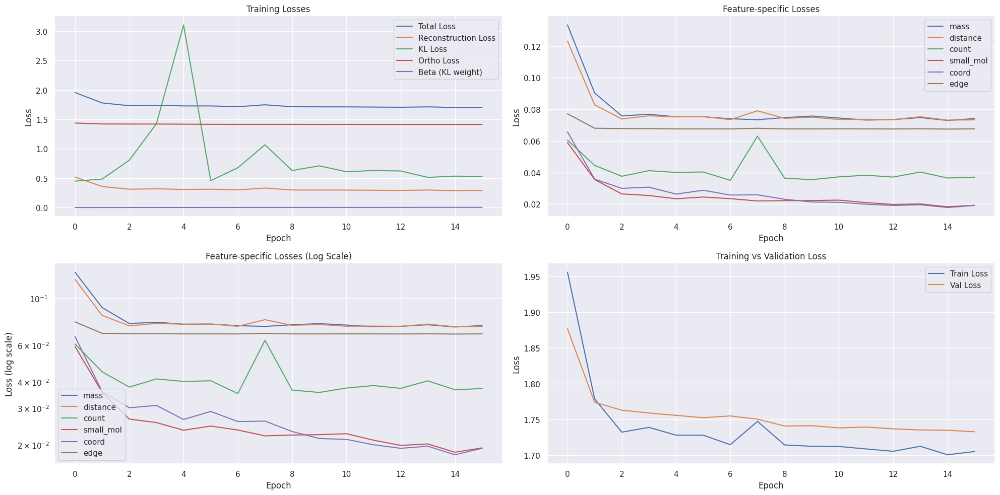

Epoch 17/100 [Train]:   5%|▍         | 2/42 [00:00<00:02, 18.34it/s, loss=1.6837, recon=0.2717, kl=0.3963, ortho=1.4108]


Detailed loss diagnostics:
Raw recon_loss: 0.4534
Raw KL loss: 0.4062
Ortho loss: 1.4126
Current beta: 0.0032
mu mean: -0.0248, std: 0.5853
logvar mean: -0.8203, std: 0.9857
mass: 0.0785
distance: 0.1013
count: 0.1609
small_mol: 0.0206
coord: 0.0191
edge: 0.0729


Epoch 17/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 20.17it/s, loss=1.6789, recon=0.2654, kl=0.4426, ortho=1.4120]


Detailed loss diagnostics:
Raw recon_loss: 0.2460
Raw KL loss: 0.7022
Ortho loss: 1.4128
Current beta: 0.0032
mu mean: -0.0330, std: 0.8755
logvar mean: -1.0510, std: 1.2104
mass: 0.0620
distance: 0.0622
count: 0.0251
small_mol: 0.0155
coord: 0.0146
edge: 0.0665


Epoch 17/100 [Train]:  55%|█████▍    | 23/42 [00:01<00:00, 19.43it/s, loss=1.7125, recon=0.2993, kl=0.4690, ortho=1.4117]


Detailed loss diagnostics:
Raw recon_loss: 0.2356
Raw KL loss: 0.3352
Ortho loss: 1.4112
Current beta: 0.0032
mu mean: -0.0079, std: 0.4693
logvar mean: -0.8306, std: 0.9119
mass: 0.0608
distance: 0.0595
count: 0.0250
small_mol: 0.0103
coord: 0.0129
edge: 0.0671


Epoch 17/100 [Train]:  76%|███████▌  | 32/42 [00:01<00:00, 19.02it/s, loss=1.6838, recon=0.2705, kl=0.5202, ortho=1.4116]


Detailed loss diagnostics:
Raw recon_loss: 0.2609
Raw KL loss: 0.5987
Ortho loss: 1.4137
Current beta: 0.0032
mu mean: -0.1109, std: 0.7744
logvar mean: -0.9479, std: 1.1859
mass: 0.0681
distance: 0.0681
count: 0.0257
small_mol: 0.0143
coord: 0.0177
edge: 0.0669


Epoch 17/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.72it/s, loss=1.8448, recon=0.4135, kl=0.2693, ortho=1.4304]



Detailed loss diagnostics:
Raw recon_loss: 0.2616
Raw KL loss: 0.4439
Ortho loss: 1.4108
Current beta: 0.0032
mu mean: -0.0252, std: 0.6121
logvar mean: -0.9085, std: 0.9819
mass: 0.0705
distance: 0.0684
count: 0.0258
small_mol: 0.0149
coord: 0.0148
edge: 0.0674

Starting validation...


Epoch 17/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 64.96it/s]



Epoch [17/100] - Time: 2.46s
Train - Total: 1.7122, Recon: 0.2981, KL: 0.5365, Ortho: 1.4124, Beta: 0.0032
Feature Losses:
  mass_loss: 0.0747
  distance_loss: 0.0755
  count_loss: 0.0408
  small_mol_loss: 0.0196
  coord_loss: 0.0198
  edge_loss: 0.0676


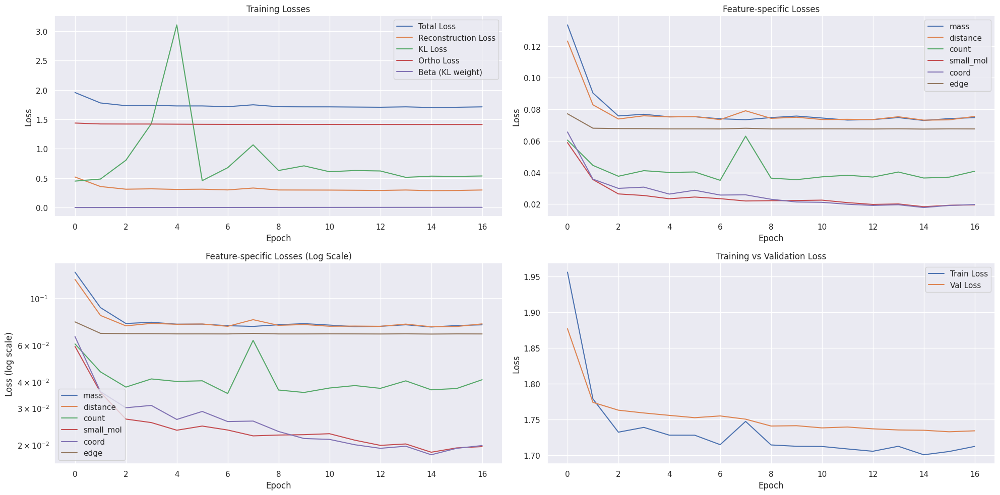

Epoch 18/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 17.82it/s, loss=1.7322, recon=0.3174, kl=0.6504, ortho=1.4126]


Detailed loss diagnostics:
Raw recon_loss: 0.2648
Raw KL loss: 0.3832
Ortho loss: 1.4125
Current beta: 0.0034
mu mean: -0.0669, std: 0.5067
logvar mean: -0.8356, std: 1.0165
mass: 0.0735
distance: 0.0718
count: 0.0260
small_mol: 0.0091
coord: 0.0177
edge: 0.0667


Epoch 18/100 [Train]:  31%|███       | 13/42 [00:00<00:01, 18.64it/s, loss=1.7075, recon=0.2933, kl=0.5553, ortho=1.4123]


Detailed loss diagnostics:
Raw recon_loss: 0.2571
Raw KL loss: 0.8148
Ortho loss: 1.4132
Current beta: 0.0034
mu mean: -0.0524, std: 0.9474
logvar mean: -1.2019, std: 1.2187
mass: 0.0664
distance: 0.0667
count: 0.0256
small_mol: 0.0170
coord: 0.0147
edge: 0.0668


Epoch 18/100 [Train]:  57%|█████▋    | 24/42 [00:01<00:00, 19.86it/s, loss=1.7080, recon=0.2916, kl=0.8115, ortho=1.4136]


Detailed loss diagnostics:
Raw recon_loss: 0.2544
Raw KL loss: 0.2901
Ortho loss: 1.4121
Current beta: 0.0034
mu mean: -0.0539, std: 0.4798
logvar mean: -0.6139, std: 0.8232
mass: 0.0692
distance: 0.0658
count: 0.0256
small_mol: 0.0145
coord: 0.0121
edge: 0.0672


Epoch 18/100 [Train]:  76%|███████▌  | 32/42 [00:01<00:00, 18.56it/s, loss=1.6553, recon=0.2430, kl=0.2948, ortho=1.4112]


Detailed loss diagnostics:
Raw recon_loss: 0.2894
Raw KL loss: 0.7210
Ortho loss: 1.4127
Current beta: 0.0034
mu mean: -0.0178, std: 0.8821
logvar mean: -1.1007, std: 1.2182
mass: 0.0779
distance: 0.0773
count: 0.0265
small_mol: 0.0255
coord: 0.0150
edge: 0.0672


Epoch 18/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.05it/s, loss=1.7940, recon=0.3665, kl=0.2754, ortho=1.4266]



Detailed loss diagnostics:
Raw recon_loss: 0.2616
Raw KL loss: 0.4103
Ortho loss: 1.4126
Current beta: 0.0034
mu mean: -0.0052, std: 0.5590
logvar mean: -0.9191, std: 0.9649
mass: 0.0693
distance: 0.0670
count: 0.0256
small_mol: 0.0172
coord: 0.0153
edge: 0.0671

Starting validation...


Epoch 18/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 65.10it/s]



Epoch [18/100] - Time: 2.54s
Train - Total: 1.7002, Recon: 0.2856, KL: 0.5264, Ortho: 1.4128, Beta: 0.0034
Feature Losses:
  mass_loss: 0.0732
  distance_loss: 0.0728
  count_loss: 0.0351
  small_mol_loss: 0.0185
  coord_loss: 0.0183
  edge_loss: 0.0676


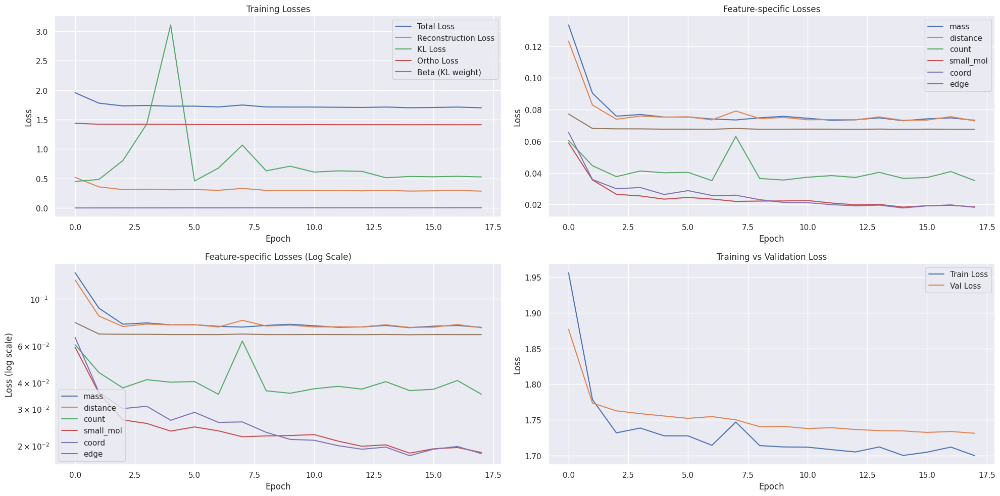

Epoch 19/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 18.27it/s, loss=1.6699, recon=0.2540, kl=0.7070, ortho=1.4133]


Detailed loss diagnostics:
Raw recon_loss: 0.2657
Raw KL loss: 0.5803
Ortho loss: 1.4106
Current beta: 0.0036
mu mean: -0.0315, std: 0.7689
logvar mean: -0.9982, std: 1.0658
mass: 0.0687
distance: 0.0670
count: 0.0256
small_mol: 0.0227
coord: 0.0140
edge: 0.0677


Epoch 19/100 [Train]:  31%|███       | 13/42 [00:00<00:01, 19.52it/s, loss=1.6520, recon=0.2363, kl=0.4155, ortho=1.4142]


Detailed loss diagnostics:
Raw recon_loss: 0.2941
Raw KL loss: 0.5242
Ortho loss: 1.4111
Current beta: 0.0036
mu mean: -0.0230, std: 0.6972
logvar mean: -0.9795, std: 1.1917
mass: 0.0794
distance: 0.0728
count: 0.0262
small_mol: 0.0236
coord: 0.0242
edge: 0.0679


Epoch 19/100 [Train]:  57%|█████▋    | 24/42 [00:01<00:00, 19.25it/s, loss=1.6778, recon=0.2639, kl=0.8997, ortho=1.4106]


Detailed loss diagnostics:
Raw recon_loss: 0.2817
Raw KL loss: 0.4803
Ortho loss: 1.4118
Current beta: 0.0036
mu mean: 0.0179, std: 0.6690
logvar mean: -0.9321, std: 0.9992
mass: 0.0750
distance: 0.0728
count: 0.0261
small_mol: 0.0209
coord: 0.0201
edge: 0.0668


Epoch 19/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 19.62it/s, loss=1.7343, recon=0.3195, kl=0.6392, ortho=1.4125]


Detailed loss diagnostics:
Raw recon_loss: 0.2862
Raw KL loss: 0.4902
Ortho loss: 1.4119
Current beta: 0.0036
mu mean: -0.0528, std: 0.6937
logvar mean: -0.9548, std: 0.9341
mass: 0.0789
distance: 0.0758
count: 0.0263
small_mol: 0.0211
coord: 0.0168
edge: 0.0673


Epoch 19/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.24it/s, loss=1.7849, recon=0.3526, kl=0.2057, ortho=1.4316]



Detailed loss diagnostics:
Raw recon_loss: 0.2802
Raw KL loss: 0.8490
Ortho loss: 1.4129
Current beta: 0.0036
mu mean: -0.0128, std: 0.9340
logvar mean: -1.4315, std: 1.1673
mass: 0.0706
distance: 0.0708
count: 0.0258
small_mol: 0.0240
coord: 0.0208
edge: 0.0682

Starting validation...


Epoch 19/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 64.01it/s]



Epoch [19/100] - Time: 2.52s
Train - Total: 1.7117, Recon: 0.2972, KL: 0.5210, Ortho: 1.4126, Beta: 0.0036
Feature Losses:
  mass_loss: 0.0755
  distance_loss: 0.0758
  count_loss: 0.0401
  small_mol_loss: 0.0194
  coord_loss: 0.0188
  edge_loss: 0.0676


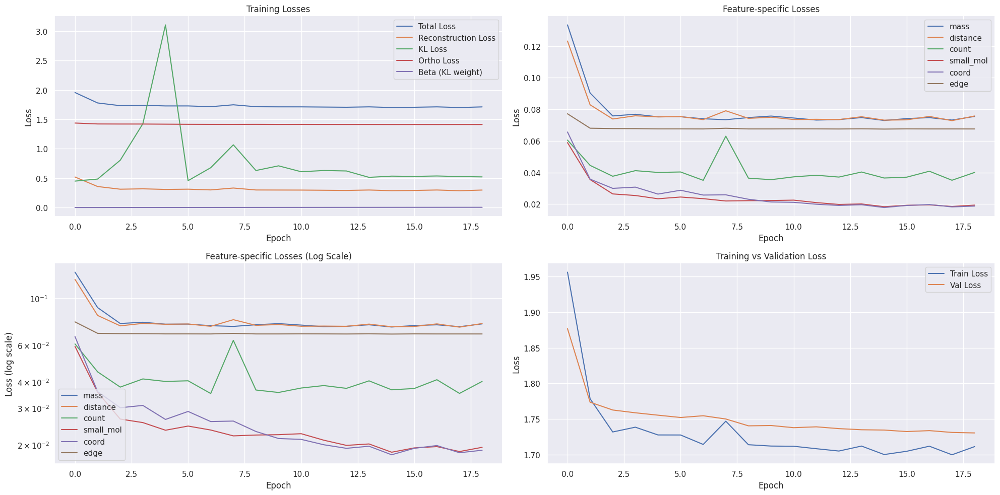

Epoch 20/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 18.71it/s, loss=1.6690, recon=0.2548, kl=0.5692, ortho=1.4120]


Detailed loss diagnostics:
Raw recon_loss: 0.2508
Raw KL loss: 0.6942
Ortho loss: 1.4138
Current beta: 0.0038
mu mean: 0.0339, std: 0.8072
logvar mean: -1.2927, std: 1.1096
mass: 0.0646
distance: 0.0632
count: 0.0253
small_mol: 0.0179
coord: 0.0130
edge: 0.0668


Epoch 20/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 18.08it/s, loss=1.6462, recon=0.2332, kl=0.4553, ortho=1.4114]


Detailed loss diagnostics:
Raw recon_loss: 0.4639
Raw KL loss: 0.5074
Ortho loss: 1.4103
Current beta: 0.0038
mu mean: -0.0089, std: 0.6488
logvar mean: -1.0537, std: 1.0627
mass: 0.0867
distance: 0.1071
count: 0.1485
small_mol: 0.0240
coord: 0.0252
edge: 0.0726


Epoch 20/100 [Train]:  52%|█████▏    | 22/42 [00:01<00:01, 18.56it/s, loss=1.7102, recon=0.2971, kl=0.4905, ortho=1.4112]


Detailed loss diagnostics:
Raw recon_loss: 0.2738
Raw KL loss: 0.5142
Ortho loss: 1.4109
Current beta: 0.0038
mu mean: 0.0070, std: 0.6617
logvar mean: -1.0546, std: 1.0599
mass: 0.0744
distance: 0.0716
count: 0.0261
small_mol: 0.0181
coord: 0.0169
edge: 0.0668


Epoch 20/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 19.92it/s, loss=1.6577, recon=0.2413, kl=0.6335, ortho=1.4140]


Detailed loss diagnostics:
Raw recon_loss: 0.3104
Raw KL loss: 0.8365
Ortho loss: 1.4117
Current beta: 0.0038
mu mean: -0.0535, std: 0.9723
logvar mean: -1.2359, std: 1.4760
mass: 0.0821
distance: 0.0798
count: 0.0266
small_mol: 0.0249
coord: 0.0295
edge: 0.0674


Epoch 20/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.12it/s, loss=1.7564, recon=0.3186, kl=0.3934, ortho=1.4363]



Detailed loss diagnostics:
Raw recon_loss: 0.2442
Raw KL loss: 0.4390
Ortho loss: 1.4112
Current beta: 0.0038
mu mean: -0.0164, std: 0.5826
logvar mean: -0.9767, std: 1.0067
mass: 0.0614
distance: 0.0600
count: 0.0250
small_mol: 0.0114
coord: 0.0187
edge: 0.0677

Starting validation...


Epoch 20/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 62.41it/s]



Epoch [20/100] - Time: 2.54s
Train - Total: 1.7057, Recon: 0.2912, KL: 0.5447, Ortho: 1.4124, Beta: 0.0038
Feature Losses:
  mass_loss: 0.0732
  distance_loss: 0.0738
  count_loss: 0.0404
  small_mol_loss: 0.0184
  coord_loss: 0.0178
  edge_loss: 0.0676


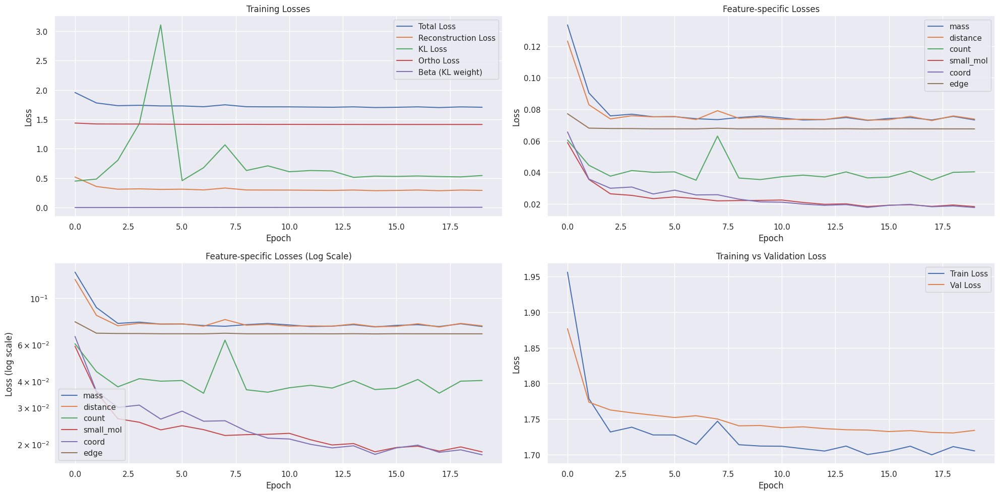

Epoch 21/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 18.47it/s, loss=1.7230, recon=0.3073, kl=0.5612, ortho=1.4134]


Detailed loss diagnostics:
Raw recon_loss: 0.2933
Raw KL loss: 0.4411
Ortho loss: 1.4108
Current beta: 0.0040
mu mean: -0.0365, std: 0.6450
logvar mean: -0.8941, std: 0.9013
mass: 0.0784
distance: 0.0731
count: 0.0262
small_mol: 0.0255
coord: 0.0236
edge: 0.0664


Epoch 21/100 [Train]:  31%|███       | 13/42 [00:00<00:01, 18.69it/s, loss=1.8260, recon=0.4115, kl=0.4287, ortho=1.4129]


Detailed loss diagnostics:
Raw recon_loss: 0.2593
Raw KL loss: 0.3519
Ortho loss: 1.4112
Current beta: 0.0040
mu mean: 0.0042, std: 0.5148
logvar mean: -0.8675, std: 0.8596
mass: 0.0702
distance: 0.0656
count: 0.0256
small_mol: 0.0164
coord: 0.0141
edge: 0.0673


Epoch 21/100 [Train]:  57%|█████▋    | 24/42 [00:01<00:00, 19.93it/s, loss=1.6563, recon=0.2398, kl=0.5292, ortho=1.4144]


Detailed loss diagnostics:
Raw recon_loss: 0.4171
Raw KL loss: 0.4107
Ortho loss: 1.4115
Current beta: 0.0040
mu mean: -0.0237, std: 0.5668
logvar mean: -0.9084, std: 1.0221
mass: 0.0761
distance: 0.0881
count: 0.1591
small_mol: 0.0129
coord: 0.0118
edge: 0.0690


Epoch 21/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 19.05it/s, loss=1.8373, recon=0.4243, kl=0.4705, ortho=1.4111]


Detailed loss diagnostics:
Raw recon_loss: 0.2829
Raw KL loss: 0.3480
Ortho loss: 1.4101
Current beta: 0.0040
mu mean: -0.0453, std: 0.5476
logvar mean: -0.7667, std: 0.8235
mass: 0.0781
distance: 0.0748
count: 0.0262
small_mol: 0.0157
coord: 0.0207
edge: 0.0674


Epoch 21/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.37it/s, loss=1.8563, recon=0.4263, kl=0.4407, ortho=1.4283]



Detailed loss diagnostics:
Raw recon_loss: 0.2930
Raw KL loss: 0.5669
Ortho loss: 1.4105
Current beta: 0.0040
mu mean: -0.0610, std: 0.7647
logvar mean: -1.0277, std: 0.9643
mass: 0.0792
distance: 0.0790
count: 0.0265
small_mol: 0.0221
coord: 0.0190
edge: 0.0671

Starting validation...


Epoch 21/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 66.08it/s]



Epoch [21/100] - Time: 2.49s
Train - Total: 1.7093, Recon: 0.2949, KL: 0.4863, Ortho: 1.4125, Beta: 0.0040
Feature Losses:
  mass_loss: 0.0739
  distance_loss: 0.0751
  count_loss: 0.0399
  small_mol_loss: 0.0204
  coord_loss: 0.0179
  edge_loss: 0.0676


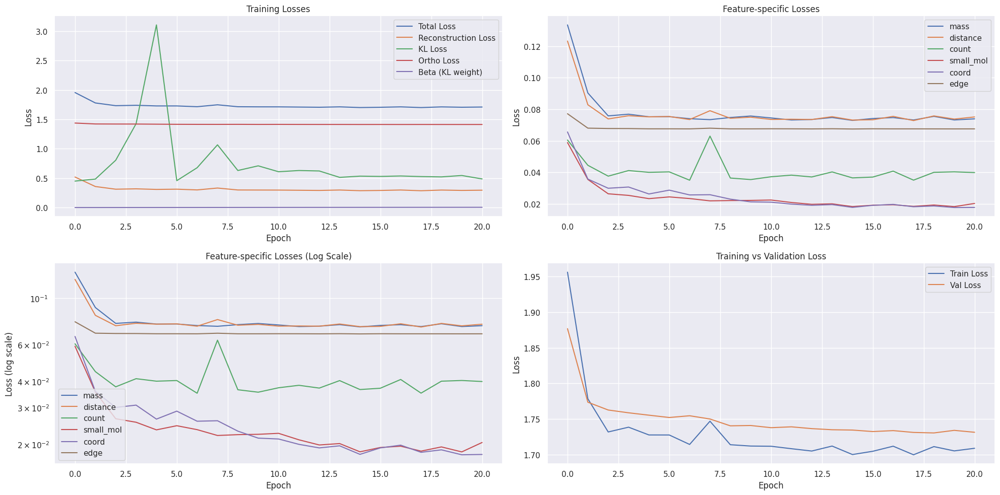

Epoch 22/100 [Train]:   5%|▍         | 2/42 [00:00<00:02, 18.43it/s, loss=1.6960, recon=0.2799, kl=0.7377, ortho=1.4130]


Detailed loss diagnostics:
Raw recon_loss: 0.2673
Raw KL loss: 0.7406
Ortho loss: 1.4124
Current beta: 0.0042
mu mean: -0.0893, std: 0.9121
logvar mean: -1.1081, std: 1.3886
mass: 0.0663
distance: 0.0714
count: 0.0309
small_mol: 0.0097
coord: 0.0205
edge: 0.0685


Epoch 22/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 19.40it/s, loss=1.7009, recon=0.2860, kl=0.5928, ortho=1.4125]


Detailed loss diagnostics:
Raw recon_loss: 0.2717
Raw KL loss: 0.6833
Ortho loss: 1.4120
Current beta: 0.0042
mu mean: -0.0669, std: 0.7723
logvar mean: -1.3911, std: 1.0654
mass: 0.0730
distance: 0.0708
count: 0.0259
small_mol: 0.0160
coord: 0.0184
edge: 0.0676


Epoch 22/100 [Train]:  57%|█████▋    | 24/42 [00:01<00:00, 18.47it/s, loss=1.6943, recon=0.2782, kl=0.6996, ortho=1.4132]


Detailed loss diagnostics:
Raw recon_loss: 0.2901
Raw KL loss: 0.5099
Ortho loss: 1.4112
Current beta: 0.0042
mu mean: -0.0027, std: 0.6982
logvar mean: -1.0440, std: 0.9412
mass: 0.0618
distance: 0.0672
count: 0.0658
small_mol: 0.0151
coord: 0.0096
edge: 0.0706


Epoch 22/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 19.03it/s, loss=1.6640, recon=0.2512, kl=0.5996, ortho=1.4103]


Detailed loss diagnostics:
Raw recon_loss: 0.2940
Raw KL loss: 0.6196
Ortho loss: 1.4121
Current beta: 0.0042
mu mean: -0.0273, std: 0.8325
logvar mean: -1.0079, std: 1.1826
mass: 0.0773
distance: 0.0769
count: 0.0262
small_mol: 0.0258
coord: 0.0210
edge: 0.0668


Epoch 22/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.20it/s, loss=1.7948, recon=0.3638, kl=0.8351, ortho=1.4275]



Detailed loss diagnostics:
Raw recon_loss: 0.2830
Raw KL loss: 0.3132
Ortho loss: 1.4122
Current beta: 0.0042
mu mean: -0.0474, std: 0.5526
logvar mean: -0.6639, std: 0.7616
mass: 0.0801
distance: 0.0754
count: 0.0263
small_mol: 0.0194
coord: 0.0147
edge: 0.0670

Starting validation...


Epoch 22/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 64.65it/s]



Epoch [22/100] - Time: 2.52s
Train - Total: 1.7029, Recon: 0.2880, KL: 0.5818, Ortho: 1.4125, Beta: 0.0042
Feature Losses:
  mass_loss: 0.0739
  distance_loss: 0.0736
  count_loss: 0.0362
  small_mol_loss: 0.0186
  coord_loss: 0.0182
  edge_loss: 0.0676


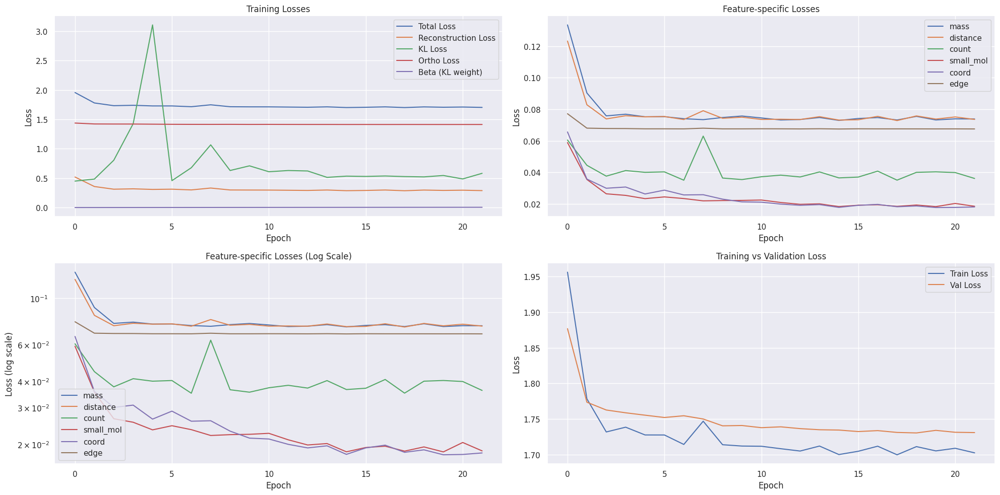

Epoch 23/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 17.77it/s, loss=1.7000, recon=0.2843, kl=0.3629, ortho=1.4141]


Detailed loss diagnostics:
Raw recon_loss: 0.2645
Raw KL loss: 0.5561
Ortho loss: 1.4125
Current beta: 0.0044
mu mean: -0.0453, std: 0.8062
logvar mean: -0.8773, std: 0.9379
mass: 0.0720
distance: 0.0739
count: 0.0261
small_mol: 0.0145
coord: 0.0110
edge: 0.0670


Epoch 23/100 [Train]:  31%|███       | 13/42 [00:00<00:01, 19.16it/s, loss=1.6909, recon=0.2779, kl=0.4929, ortho=1.4109]


Detailed loss diagnostics:
Raw recon_loss: 0.2818
Raw KL loss: 0.4555
Ortho loss: 1.4121
Current beta: 0.0044
mu mean: -0.0225, std: 0.6975
logvar mean: -0.8691, std: 0.8771
mass: 0.0757
distance: 0.0765
count: 0.0263
small_mol: 0.0194
coord: 0.0173
edge: 0.0667


Epoch 23/100 [Train]:  57%|█████▋    | 24/42 [00:01<00:00, 19.24it/s, loss=1.6640, recon=0.2505, kl=0.3336, ortho=1.4120]


Detailed loss diagnostics:
Raw recon_loss: 0.3049
Raw KL loss: 0.4245
Ortho loss: 1.4126
Current beta: 0.0044
mu mean: -0.0201, std: 0.6620
logvar mean: -0.8369, std: 0.8427
mass: 0.0822
distance: 0.0804
count: 0.0267
small_mol: 0.0264
coord: 0.0225
edge: 0.0667


Epoch 23/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 19.91it/s, loss=1.6659, recon=0.2519, kl=0.5923, ortho=1.4114]


Detailed loss diagnostics:
Raw recon_loss: 0.2915
Raw KL loss: 0.5695
Ortho loss: 1.4112
Current beta: 0.0044
mu mean: -0.0130, std: 0.8020
logvar mean: -0.9739, std: 0.9370
mass: 0.0746
distance: 0.0790
count: 0.0337
small_mol: 0.0199
coord: 0.0148
edge: 0.0695


Epoch 23/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.41it/s, loss=1.7198, recon=0.2922, kl=0.3164, ortho=1.4262]



Detailed loss diagnostics:
Raw recon_loss: 0.3047
Raw KL loss: 0.5871
Ortho loss: 1.4109
Current beta: 0.0044
mu mean: -0.0213, std: 0.8164
logvar mean: -0.9757, std: 1.0870
mass: 0.0794
distance: 0.0740
count: 0.0262
small_mol: 0.0250
coord: 0.0334
edge: 0.0667

Starting validation...


Epoch 23/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 61.73it/s]



Epoch [23/100] - Time: 2.51s
Train - Total: 1.7058, Recon: 0.2913, KL: 0.4889, Ortho: 1.4124, Beta: 0.0044
Feature Losses:
  mass_loss: 0.0741
  distance_loss: 0.0741
  count_loss: 0.0389
  small_mol_loss: 0.0188
  coord_loss: 0.0178
  edge_loss: 0.0676


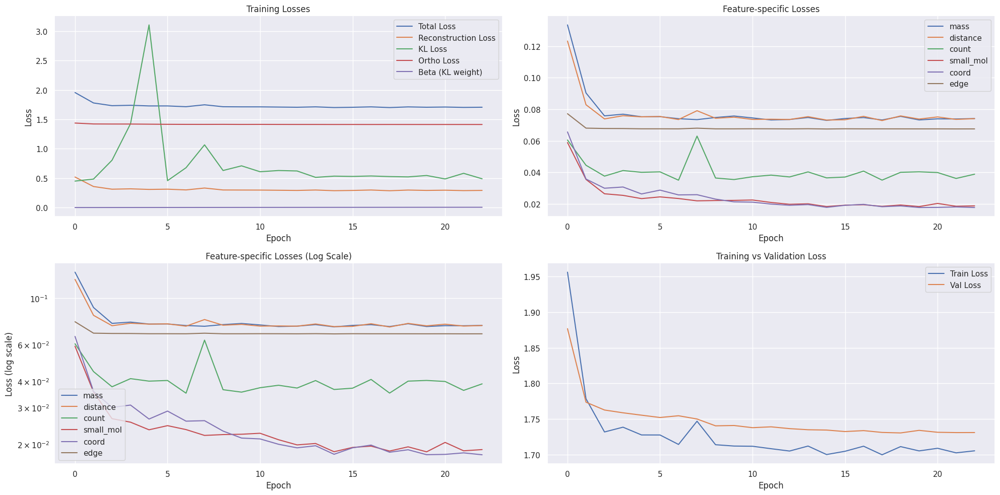

Epoch 24/100 [Train]:   5%|▍         | 2/42 [00:00<00:02, 15.93it/s, loss=1.7139, recon=0.2986, kl=0.5712, ortho=1.4126]


Detailed loss diagnostics:
Raw recon_loss: 0.2693
Raw KL loss: 0.4342
Ortho loss: 1.4118
Current beta: 0.0046
mu mean: -0.0126, std: 0.6609
logvar mean: -0.8126, std: 0.9044
mass: 0.0752
distance: 0.0738
count: 0.0262
small_mol: 0.0153
coord: 0.0125
edge: 0.0664


Epoch 24/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 17.38it/s, loss=1.6781, recon=0.2656, kl=0.3972, ortho=1.4107]


Detailed loss diagnostics:
Raw recon_loss: 0.3025
Raw KL loss: 0.6463
Ortho loss: 1.4154
Current beta: 0.0046
mu mean: -0.0733, std: 0.8831
logvar mean: -0.9547, std: 1.1005
mass: 0.0770
distance: 0.0724
count: 0.0261
small_mol: 0.0287
coord: 0.0315
edge: 0.0668


Epoch 24/100 [Train]:  57%|█████▋    | 24/42 [00:01<00:00, 19.03it/s, loss=1.6759, recon=0.2626, kl=0.3675, ortho=1.4116]


Detailed loss diagnostics:
Raw recon_loss: 0.3789
Raw KL loss: 0.3217
Ortho loss: 1.4125
Current beta: 0.0046
mu mean: 0.0194, std: 0.5376
logvar mean: -0.7587, std: 0.7705
mass: 0.0942
distance: 0.1120
count: 0.0489
small_mol: 0.0260
coord: 0.0258
edge: 0.0720


Epoch 24/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 19.34it/s, loss=1.6915, recon=0.2784, kl=0.4436, ortho=1.4111]


Detailed loss diagnostics:
Raw recon_loss: 0.2787
Raw KL loss: 0.3513
Ortho loss: 1.4123
Current beta: 0.0046
mu mean: -0.0547, std: 0.5736
logvar mean: -0.7720, std: 0.7953
mass: 0.0775
distance: 0.0749
count: 0.0263
small_mol: 0.0194
coord: 0.0141
edge: 0.0665


Epoch 24/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 18.80it/s, loss=1.8654, recon=0.4308, kl=0.4374, ortho=1.4325]



Detailed loss diagnostics:
Raw recon_loss: 0.2983
Raw KL loss: 0.4609
Ortho loss: 1.4121
Current beta: 0.0046
mu mean: -0.0641, std: 0.6945
logvar mean: -0.8744, std: 0.8965
mass: 0.0897
distance: 0.0770
count: 0.0265
small_mol: 0.0182
coord: 0.0195
edge: 0.0674

Starting validation...


Epoch 24/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 65.17it/s]



Epoch [24/100] - Time: 2.57s
Train - Total: 1.7052, Recon: 0.2906, KL: 0.4752, Ortho: 1.4125, Beta: 0.0046
Feature Losses:
  mass_loss: 0.0747
  distance_loss: 0.0744
  count_loss: 0.0353
  small_mol_loss: 0.0208
  coord_loss: 0.0178
  edge_loss: 0.0676


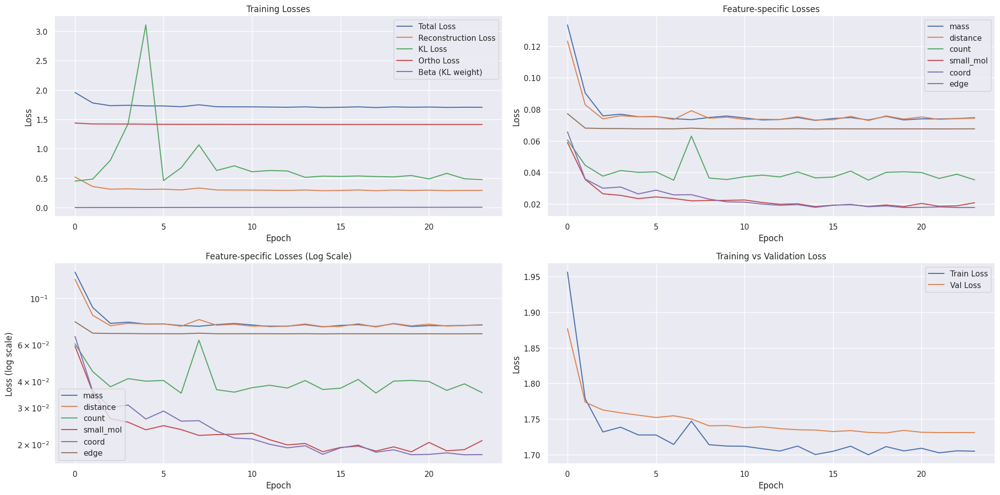

Epoch 25/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 17.12it/s, loss=1.6732, recon=0.2546, kl=0.7276, ortho=1.4152]


Detailed loss diagnostics:
Raw recon_loss: 0.2727
Raw KL loss: 0.5206
Ortho loss: 1.4110
Current beta: 0.0048
mu mean: -0.0314, std: 0.7227
logvar mean: -0.9907, std: 0.9704
mass: 0.0773
distance: 0.0736
count: 0.0262
small_mol: 0.0128
coord: 0.0163
edge: 0.0666


Epoch 25/100 [Train]:  31%|███       | 13/42 [00:00<00:01, 18.74it/s, loss=1.6524, recon=0.2380, kl=0.6084, ortho=1.4115]


Detailed loss diagnostics:
Raw recon_loss: 0.2566
Raw KL loss: 0.6464
Ortho loss: 1.4119
Current beta: 0.0048
mu mean: -0.0292, std: 0.7598
logvar mean: -1.3125, std: 1.0491
mass: 0.0682
distance: 0.0649
count: 0.0255
small_mol: 0.0137
coord: 0.0166
edge: 0.0677


Epoch 25/100 [Train]:  55%|█████▍    | 23/42 [00:01<00:01, 18.55it/s, loss=1.7140, recon=0.2991, kl=0.4080, ortho=1.4129]


Detailed loss diagnostics:
Raw recon_loss: 0.2595
Raw KL loss: 0.6253
Ortho loss: 1.4119
Current beta: 0.0048
mu mean: -0.0826, std: 0.8325
logvar mean: -1.0123, std: 1.0961
mass: 0.0672
distance: 0.0669
count: 0.0256
small_mol: 0.0096
coord: 0.0231
edge: 0.0670


Epoch 25/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 19.53it/s, loss=1.6652, recon=0.2517, kl=0.4023, ortho=1.4115]


Detailed loss diagnostics:
Raw recon_loss: 0.2679
Raw KL loss: 0.3111
Ortho loss: 1.4108
Current beta: 0.0048
mu mean: -0.0011, std: 0.5372
logvar mean: -0.7164, std: 0.7624
mass: 0.0727
distance: 0.0713
count: 0.0259
small_mol: 0.0163
coord: 0.0146
edge: 0.0671


Epoch 25/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.01it/s, loss=3.1021, recon=1.6692, kl=0.5962, ortho=1.4300]



Detailed loss diagnostics:
Raw recon_loss: 0.4235
Raw KL loss: 0.4299
Ortho loss: 1.4115
Current beta: 0.0048
mu mean: 0.0076, std: 0.6819
logvar mean: -0.8367, std: 0.8343
mass: 0.0799
distance: 0.0987
count: 0.1300
small_mol: 0.0264
coord: 0.0167
edge: 0.0718

Starting validation...


Epoch 25/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 66.11it/s]



Epoch [25/100] - Time: 2.53s
Train - Total: 1.7348, Recon: 0.3194, KL: 0.5448, Ortho: 1.4128, Beta: 0.0048
Feature Losses:
  mass_loss: 0.0748
  distance_loss: 0.0786
  count_loss: 0.0606
  small_mol_loss: 0.0189
  coord_loss: 0.0183
  edge_loss: 0.0682


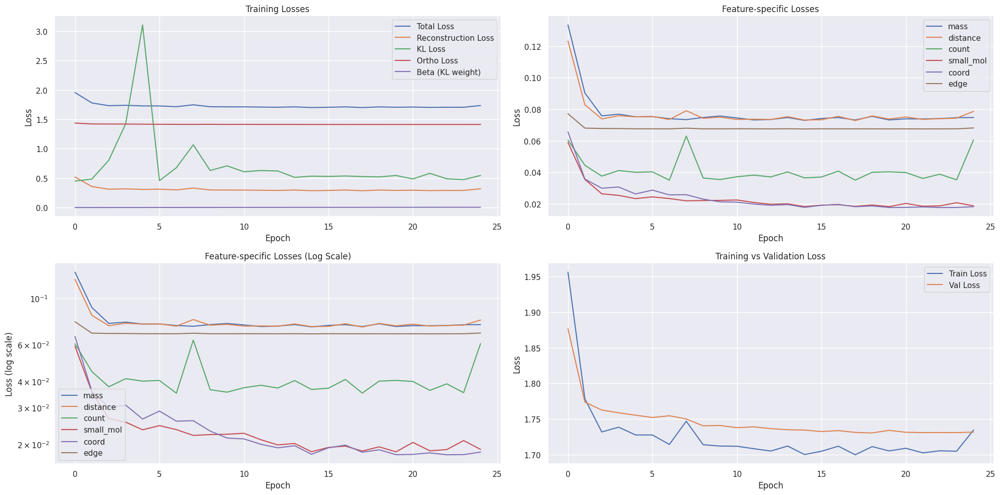

Epoch 26/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 18.98it/s, loss=1.6546, recon=0.2409, kl=0.4571, ortho=1.4114]


Detailed loss diagnostics:
Raw recon_loss: 0.2511
Raw KL loss: 0.2615
Ortho loss: 1.4119
Current beta: 0.0050
mu mean: -0.0324, std: 0.4788
logvar mean: -0.6213, std: 0.7272
mass: 0.0685
distance: 0.0669
count: 0.0255
small_mol: 0.0104
coord: 0.0131
edge: 0.0668


Epoch 26/100 [Train]:  31%|███       | 13/42 [00:00<00:01, 20.20it/s, loss=1.8286, recon=0.4144, kl=0.6090, ortho=1.4112]


Detailed loss diagnostics:
Raw recon_loss: 0.2628
Raw KL loss: 0.5310
Ortho loss: 1.4103
Current beta: 0.0050
mu mean: 0.0276, std: 0.7460
logvar mean: -0.9828, std: 0.9379
mass: 0.0696
distance: 0.0652
count: 0.0256
small_mol: 0.0177
coord: 0.0164
edge: 0.0684


Epoch 26/100 [Train]:  57%|█████▋    | 24/42 [00:01<00:00, 20.21it/s, loss=1.7164, recon=0.3029, kl=0.4604, ortho=1.4112]


Detailed loss diagnostics:
Raw recon_loss: 0.2669
Raw KL loss: 0.3445
Ortho loss: 1.4115
Current beta: 0.0050
mu mean: 0.0337, std: 0.5572
logvar mean: -0.7983, std: 0.7810
mass: 0.0720
distance: 0.0700
count: 0.0257
small_mol: 0.0183
coord: 0.0138
edge: 0.0670


Epoch 26/100 [Train]:  79%|███████▊  | 33/42 [00:01<00:00, 20.66it/s, loss=1.6801, recon=0.2648, kl=0.5669, ortho=1.4125]


Detailed loss diagnostics:
Raw recon_loss: 0.2672
Raw KL loss: 0.5377
Ortho loss: 1.4107
Current beta: 0.0050
mu mean: -0.0217, std: 0.7607
logvar mean: -0.9337, std: 1.1355
mass: 0.0712
distance: 0.0706
count: 0.0258
small_mol: 0.0148
coord: 0.0185
edge: 0.0663


Epoch 26/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.96it/s, loss=1.8213, recon=0.3934, kl=0.2166, ortho=1.4268]



Detailed loss diagnostics:
Raw recon_loss: 0.3141
Raw KL loss: 0.4481
Ortho loss: 1.4124
Current beta: 0.0050
mu mean: -0.0323, std: 0.6520
logvar mean: -0.9032, std: 0.9639
mass: 0.0660
distance: 0.0737
count: 0.0689
small_mol: 0.0107
coord: 0.0235
edge: 0.0713

Starting validation...


Epoch 26/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 66.43it/s]



Epoch [26/100] - Time: 2.43s
Train - Total: 1.7026, Recon: 0.2883, KL: 0.4542, Ortho: 1.4121, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0740
  distance_loss: 0.0737
  count_loss: 0.0368
  small_mol_loss: 0.0182
  coord_loss: 0.0179
  edge_loss: 0.0676


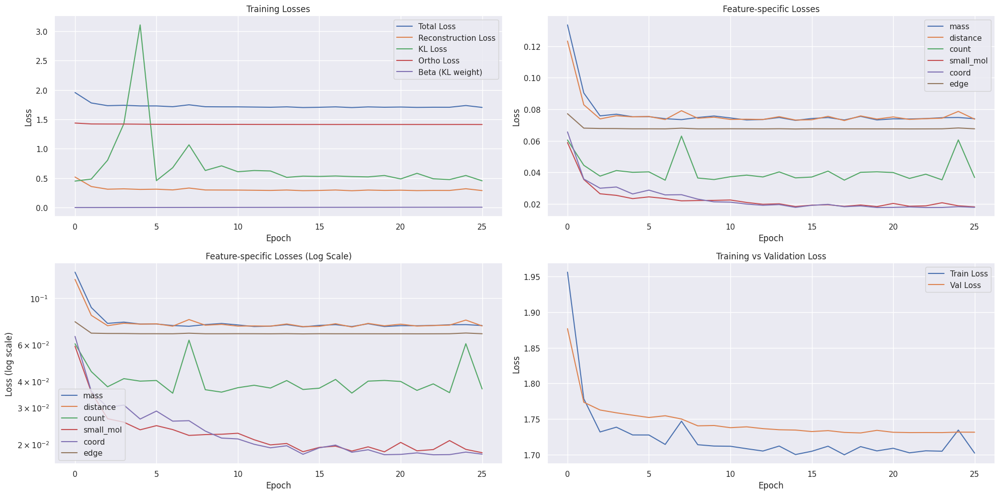

Epoch 27/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 18.35it/s, loss=1.7003, recon=0.2838, kl=0.4959, ortho=1.4140]


Detailed loss diagnostics:
Raw recon_loss: 0.2902
Raw KL loss: 0.4503
Ortho loss: 1.4126
Current beta: 0.0050
mu mean: -0.0062, std: 0.6765
logvar mean: -0.8984, std: 0.8821
mass: 0.0781
distance: 0.0771
count: 0.0263
small_mol: 0.0250
coord: 0.0163
edge: 0.0675


Epoch 27/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 19.44it/s, loss=1.7090, recon=0.2947, kl=0.5342, ortho=1.4116]


Detailed loss diagnostics:
Raw recon_loss: 0.2997
Raw KL loss: 0.3774
Ortho loss: 1.4111
Current beta: 0.0050
mu mean: -0.0380, std: 0.6238
logvar mean: -0.7703, std: 0.7949
mass: 0.0829
distance: 0.0812
count: 0.0268
small_mol: 0.0225
coord: 0.0198
edge: 0.0665


Epoch 27/100 [Train]:  52%|█████▏    | 22/42 [00:01<00:01, 19.55it/s, loss=1.6909, recon=0.2780, kl=0.4159, ortho=1.4109]


Detailed loss diagnostics:
Raw recon_loss: 0.2836
Raw KL loss: 0.5443
Ortho loss: 1.4120
Current beta: 0.0050
mu mean: -0.0284, std: 0.8098
logvar mean: -0.8717, std: 0.9248
mass: 0.0812
distance: 0.0713
count: 0.0259
small_mol: 0.0213
coord: 0.0175
edge: 0.0663


Epoch 27/100 [Train]:  79%|███████▊  | 33/42 [00:01<00:00, 18.40it/s, loss=1.6738, recon=0.2609, kl=0.4426, ortho=1.4107]


Detailed loss diagnostics:
Raw recon_loss: 0.2719
Raw KL loss: 0.3103
Ortho loss: 1.4102
Current beta: 0.0050
mu mean: -0.0051, std: 0.5502
logvar mean: -0.7008, std: 0.7321
mass: 0.0769
distance: 0.0713
count: 0.0260
small_mol: 0.0191
coord: 0.0116
edge: 0.0670


Epoch 27/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 18.85it/s, loss=1.9515, recon=0.5060, kl=0.5812, ortho=1.4426]



Detailed loss diagnostics:
Raw recon_loss: 0.2699
Raw KL loss: 0.5848
Ortho loss: 1.4105
Current beta: 0.0050
mu mean: 0.0187, std: 0.8058
logvar mean: -0.9947, std: 1.1283
mass: 0.0732
distance: 0.0659
count: 0.0256
small_mol: 0.0140
coord: 0.0240
edge: 0.0671

Starting validation...


Epoch 27/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 66.64it/s]



Epoch [27/100] - Time: 2.55s
Train - Total: 1.7067, Recon: 0.2922, KL: 0.4600, Ortho: 1.4121, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0741
  distance_loss: 0.0740
  count_loss: 0.0374
  small_mol_loss: 0.0215
  coord_loss: 0.0176
  edge_loss: 0.0676


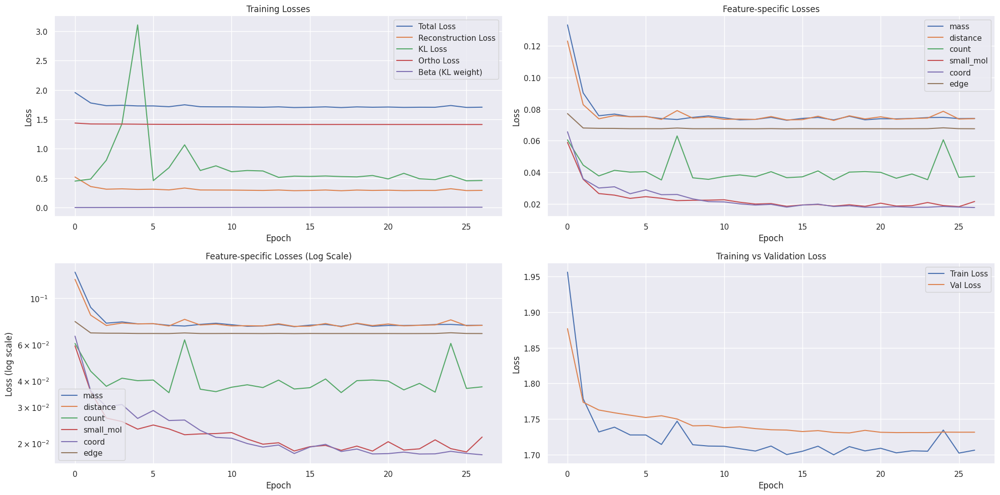

Epoch 28/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 17.89it/s, loss=1.6757, recon=0.2608, kl=0.6822, ortho=1.4115]


Detailed loss diagnostics:
Raw recon_loss: 0.2847
Raw KL loss: 0.6006
Ortho loss: 1.4123
Current beta: 0.0050
mu mean: 0.0761, std: 0.8103
logvar mean: -1.0590, std: 0.9506
mass: 0.0603
distance: 0.0681
count: 0.0634
small_mol: 0.0158
coord: 0.0071
edge: 0.0701


Epoch 28/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 19.90it/s, loss=1.8610, recon=0.4472, kl=0.3916, ortho=1.4119]


Detailed loss diagnostics:
Raw recon_loss: 0.2790
Raw KL loss: 0.3422
Ortho loss: 1.4120
Current beta: 0.0050
mu mean: -0.0062, std: 0.5673
logvar mean: -0.7707, std: 0.8231
mass: 0.0760
distance: 0.0692
count: 0.0259
small_mol: 0.0196
coord: 0.0208
edge: 0.0674


Epoch 28/100 [Train]:  55%|█████▍    | 23/42 [00:01<00:00, 19.32it/s, loss=1.7070, recon=0.2933, kl=0.3090, ortho=1.4122]


Detailed loss diagnostics:
Raw recon_loss: 0.4264
Raw KL loss: 0.5269
Ortho loss: 1.4109
Current beta: 0.0050
mu mean: -0.0173, std: 0.7432
logvar mean: -0.9516, std: 1.1418
mass: 0.0826
distance: 0.0958
count: 0.1291
small_mol: 0.0237
coord: 0.0250
edge: 0.0702


Epoch 28/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 20.32it/s, loss=1.7002, recon=0.2872, kl=0.4206, ortho=1.4110]


Detailed loss diagnostics:
Raw recon_loss: 0.2910
Raw KL loss: 0.3701
Ortho loss: 1.4120
Current beta: 0.0050
mu mean: 0.0254, std: 0.5664
logvar mean: -0.8819, std: 0.8411
mass: 0.0734
distance: 0.0809
count: 0.0342
small_mol: 0.0201
coord: 0.0141
edge: 0.0683


Epoch 28/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.64it/s, loss=1.9749, recon=0.5383, kl=0.5404, ortho=1.4339]



Detailed loss diagnostics:
Raw recon_loss: 0.2626
Raw KL loss: 0.4342
Ortho loss: 1.4110
Current beta: 0.0050
mu mean: -0.0127, std: 0.6437
logvar mean: -0.9232, std: 0.8909
mass: 0.0708
distance: 0.0684
count: 0.0257
small_mol: 0.0143
coord: 0.0149
edge: 0.0685

Starting validation...


Epoch 28/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 64.89it/s]



Epoch [28/100] - Time: 2.47s
Train - Total: 1.7068, Recon: 0.2927, KL: 0.4294, Ortho: 1.4119, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0746
  distance_loss: 0.0743
  count_loss: 0.0376
  small_mol_loss: 0.0199
  coord_loss: 0.0188
  edge_loss: 0.0676


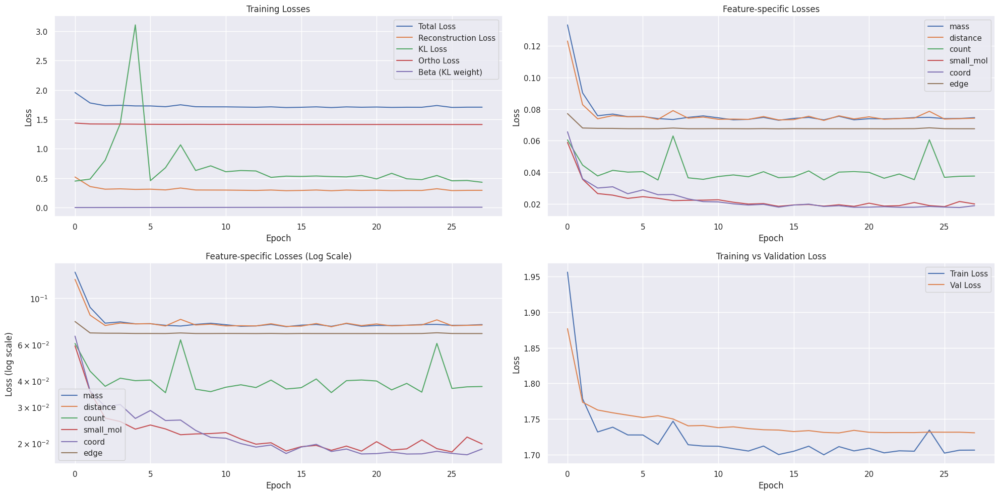

Epoch 29/100 [Train]:  10%|▉         | 4/42 [00:00<00:01, 19.09it/s, loss=1.7472, recon=0.3339, kl=0.3776, ortho=1.4114]


Detailed loss diagnostics:
Raw recon_loss: 0.2853
Raw KL loss: 0.3613
Ortho loss: 1.4133
Current beta: 0.0050
mu mean: 0.0311, std: 0.5884
logvar mean: -0.8187, std: 0.7915
mass: 0.0733
distance: 0.0738
count: 0.0260
small_mol: 0.0305
coord: 0.0143
edge: 0.0673


Epoch 29/100 [Train]:  31%|███       | 13/42 [00:00<00:01, 18.27it/s, loss=1.7044, recon=0.2900, kl=0.5171, ortho=1.4118]


Detailed loss diagnostics:
Raw recon_loss: 0.2426
Raw KL loss: 0.8111
Ortho loss: 1.4133
Current beta: 0.0050
mu mean: 0.0527, std: 1.0051
logvar mean: -1.1471, std: 1.0497
mass: 0.0604
distance: 0.0597
count: 0.0250
small_mol: 0.0178
coord: 0.0139
edge: 0.0659


Epoch 29/100 [Train]:  55%|█████▍    | 23/42 [00:01<00:01, 18.83it/s, loss=1.6985, recon=0.2851, kl=0.4676, ortho=1.4110]


Detailed loss diagnostics:
Raw recon_loss: 0.2697
Raw KL loss: 0.4278
Ortho loss: 1.4113
Current beta: 0.0050
mu mean: -0.0001, std: 0.6654
logvar mean: -0.8417, std: 0.8670
mass: 0.0727
distance: 0.0720
count: 0.0260
small_mol: 0.0187
coord: 0.0131
edge: 0.0672


Epoch 29/100 [Train]:  79%|███████▊  | 33/42 [00:01<00:00, 19.83it/s, loss=1.7428, recon=0.3281, kl=0.7005, ortho=1.4111]


Detailed loss diagnostics:
Raw recon_loss: 0.2775
Raw KL loss: 0.3684
Ortho loss: 1.4115
Current beta: 0.0050
mu mean: -0.0362, std: 0.5429
logvar mean: -0.8763, std: 0.9220
mass: 0.0778
distance: 0.0755
count: 0.0262
small_mol: 0.0155
coord: 0.0150
edge: 0.0675


Epoch 29/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.61it/s, loss=1.8053, recon=0.3471, kl=0.3069, ortho=1.4567]



Detailed loss diagnostics:
Raw recon_loss: 0.2773
Raw KL loss: 0.4014
Ortho loss: 1.4105
Current beta: 0.0050
mu mean: -0.0582, std: 0.6130
logvar mean: -0.8635, std: 0.8886
mass: 0.0770
distance: 0.0767
count: 0.0261
small_mol: 0.0167
coord: 0.0127
edge: 0.0681

Starting validation...


Epoch 29/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 65.31it/s]



Epoch [29/100] - Time: 2.47s
Train - Total: 1.7056, Recon: 0.2903, KL: 0.5000, Ortho: 1.4128, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0742
  distance_loss: 0.0740
  count_loss: 0.0375
  small_mol_loss: 0.0184
  coord_loss: 0.0187
  edge_loss: 0.0675


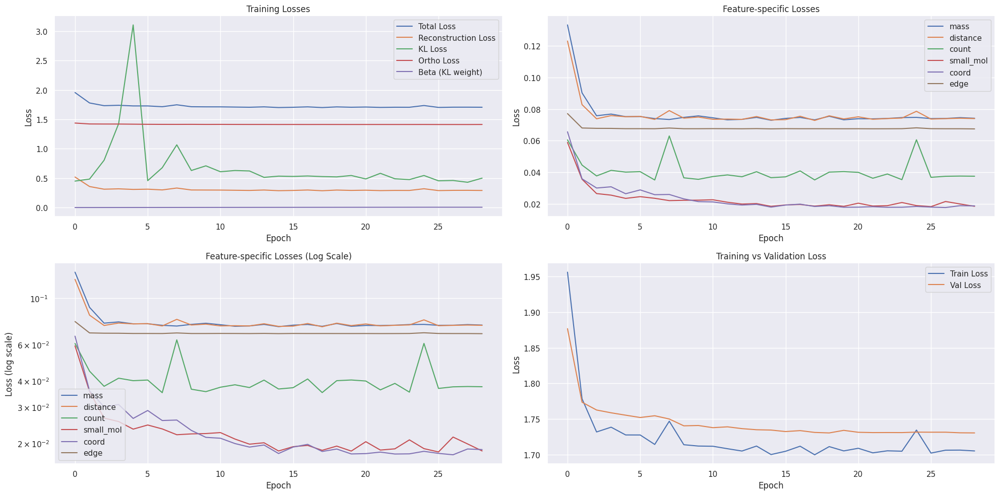

Epoch 30/100 [Train]:   5%|▍         | 2/42 [00:00<00:02, 17.84it/s, loss=1.7387, recon=0.3247, kl=0.4253, ortho=1.4119]


Detailed loss diagnostics:
Raw recon_loss: 0.2533
Raw KL loss: 0.4348
Ortho loss: 1.4104
Current beta: 0.0050
mu mean: -0.0272, std: 0.6465
logvar mean: -0.9013, std: 0.9178
mass: 0.0672
distance: 0.0659
count: 0.0255
small_mol: 0.0154
coord: 0.0126
edge: 0.0667


Epoch 30/100 [Train]:  31%|███       | 13/42 [00:00<00:01, 18.46it/s, loss=1.7036, recon=0.2905, kl=0.3801, ortho=1.4112]


Detailed loss diagnostics:
Raw recon_loss: 0.2371
Raw KL loss: 0.4859
Ortho loss: 1.4131
Current beta: 0.0050
mu mean: -0.0479, std: 0.7153
logvar mean: -0.8810, std: 0.9730
mass: 0.0627
distance: 0.0628
count: 0.0252
small_mol: 0.0072
coord: 0.0131
edge: 0.0661


Epoch 30/100 [Train]:  55%|█████▍    | 23/42 [00:01<00:01, 18.55it/s, loss=1.6494, recon=0.2360, kl=0.4053, ortho=1.4114]


Detailed loss diagnostics:
Raw recon_loss: 0.2718
Raw KL loss: 0.5550
Ortho loss: 1.4126
Current beta: 0.0050
mu mean: 0.0365, std: 0.7709
logvar mean: -1.0317, std: 0.9476
mass: 0.0715
distance: 0.0685
count: 0.0258
small_mol: 0.0218
coord: 0.0166
edge: 0.0675


Epoch 30/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 19.32it/s, loss=1.6656, recon=0.2508, kl=0.4745, ortho=1.4124]


Detailed loss diagnostics:
Raw recon_loss: 0.2772
Raw KL loss: 0.4316
Ortho loss: 1.4113
Current beta: 0.0050
mu mean: 0.0325, std: 0.6847
logvar mean: -0.8227, std: 0.8551
mass: 0.0732
distance: 0.0710
count: 0.0260
small_mol: 0.0257
coord: 0.0147
edge: 0.0665


Epoch 30/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 18.95it/s, loss=1.7664, recon=0.3264, kl=0.6164, ortho=1.4369]



Detailed loss diagnostics:
Raw recon_loss: 0.2720
Raw KL loss: 0.3344
Ortho loss: 1.4138
Current beta: 0.0050
mu mean: -0.0175, std: 0.5520
logvar mean: -0.7509, std: 0.8196
mass: 0.0724
distance: 0.0775
count: 0.0331
small_mol: 0.0101
coord: 0.0118
edge: 0.0671

Starting validation...


Epoch 30/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 65.21it/s]



Epoch [30/100] - Time: 2.55s
Train - Total: 1.7013, Recon: 0.2868, KL: 0.4354, Ortho: 1.4123, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0725
  distance_loss: 0.0733
  count_loss: 0.0395
  small_mol_loss: 0.0170
  coord_loss: 0.0168
  edge_loss: 0.0676


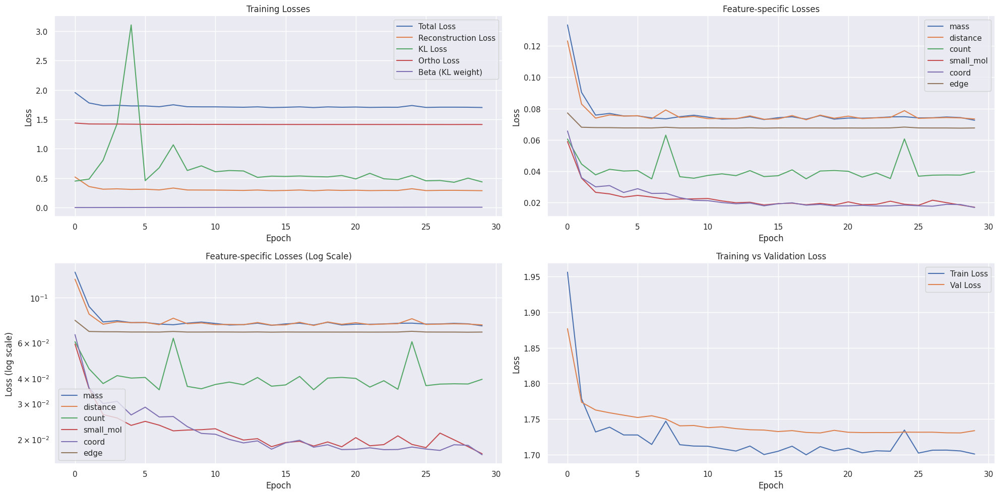

Epoch 31/100 [Train]:   5%|▍         | 2/42 [00:00<00:02, 17.85it/s, loss=1.7205, recon=0.3074, kl=0.4956, ortho=1.4107]


Detailed loss diagnostics:
Raw recon_loss: 0.2772
Raw KL loss: 0.3105
Ortho loss: 1.4121
Current beta: 0.0050
mu mean: 0.0317, std: 0.5003
logvar mean: -0.7908, std: 0.8327
mass: 0.0772
distance: 0.0723
count: 0.0261
small_mol: 0.0129
coord: 0.0213
edge: 0.0673


Epoch 31/100 [Train]:  31%|███       | 13/42 [00:00<00:01, 18.46it/s, loss=1.8083, recon=0.3954, kl=0.4122, ortho=1.4108]


Detailed loss diagnostics:
Raw recon_loss: 0.2583
Raw KL loss: 0.4276
Ortho loss: 1.4103
Current beta: 0.0050
mu mean: 0.0357, std: 0.6508
logvar mean: -0.8702, std: 0.9175
mass: 0.0654
distance: 0.0637
count: 0.0254
small_mol: 0.0139
coord: 0.0230
edge: 0.0670


Epoch 31/100 [Train]:  52%|█████▏    | 22/42 [00:01<00:01, 19.35it/s, loss=1.6951, recon=0.2821, kl=0.5506, ortho=1.4103]


Detailed loss diagnostics:
Raw recon_loss: 0.2660
Raw KL loss: 0.4600
Ortho loss: 1.4135
Current beta: 0.0050
mu mean: -0.0647, std: 0.7231
logvar mean: -0.8126, std: 0.8740
mass: 0.0704
distance: 0.0693
count: 0.0258
small_mol: 0.0170
coord: 0.0155
edge: 0.0679


Epoch 31/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 18.87it/s, loss=1.6461, recon=0.2347, kl=0.3891, ortho=1.4094]


Detailed loss diagnostics:
Raw recon_loss: 0.2300
Raw KL loss: 0.4542
Ortho loss: 1.4131
Current beta: 0.0050
mu mean: 0.0168, std: 0.6585
logvar mean: -0.9725, std: 0.9035
mass: 0.0592
distance: 0.0584
count: 0.0249
small_mol: 0.0146
coord: 0.0076
edge: 0.0653


Epoch 31/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 18.97it/s, loss=1.7366, recon=0.3083, kl=0.3274, ortho=1.4266]



Detailed loss diagnostics:
Raw recon_loss: 0.2986
Raw KL loss: 0.3326
Ortho loss: 1.4111
Current beta: 0.0050
mu mean: 0.0121, std: 0.5498
logvar mean: -0.7938, std: 0.8076
mass: 0.0809
distance: 0.0784
count: 0.0266
small_mol: 0.0280
coord: 0.0173
edge: 0.0674

Starting validation...


Epoch 31/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 62.61it/s]



Epoch [31/100] - Time: 2.56s
Train - Total: 1.7019, Recon: 0.2883, KL: 0.4230, Ortho: 1.4115, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0740
  distance_loss: 0.0739
  count_loss: 0.0371
  small_mol_loss: 0.0180
  coord_loss: 0.0178
  edge_loss: 0.0676


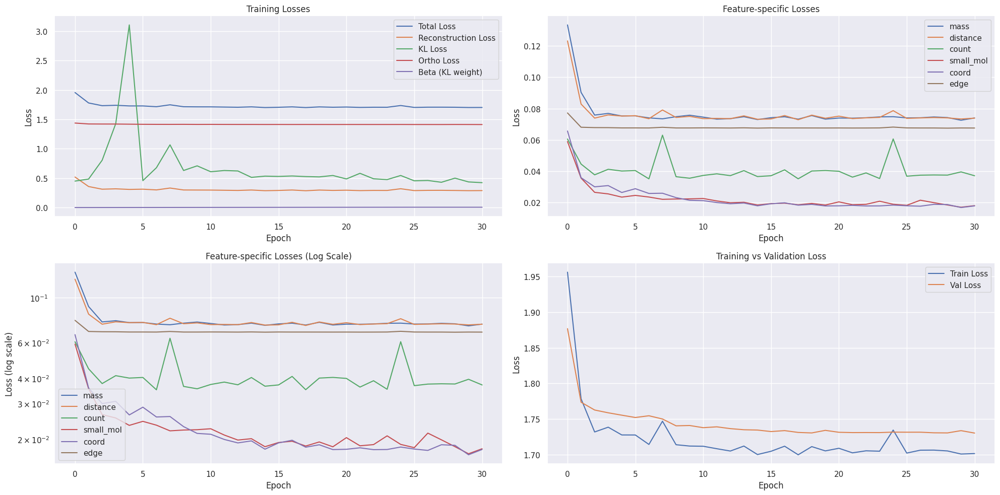

Epoch 32/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 18.06it/s, loss=1.6976, recon=0.2831, kl=0.4184, ortho=1.4124]


Detailed loss diagnostics:
Raw recon_loss: 0.2728
Raw KL loss: 0.3559
Ortho loss: 1.4107
Current beta: 0.0050
mu mean: 0.0287, std: 0.5655
logvar mean: -0.8284, std: 0.8455
mass: 0.0732
distance: 0.0736
count: 0.0260
small_mol: 0.0185
coord: 0.0143
edge: 0.0672


Epoch 32/100 [Train]:  31%|███       | 13/42 [00:00<00:01, 19.08it/s, loss=1.6507, recon=0.2382, kl=0.4461, ortho=1.4102]


Detailed loss diagnostics:
Raw recon_loss: 0.2585
Raw KL loss: 0.4456
Ortho loss: 1.4107
Current beta: 0.0050
mu mean: 0.0122, std: 0.6197
logvar mean: -1.0158, std: 0.9649
mass: 0.0646
distance: 0.0666
count: 0.0292
small_mol: 0.0093
coord: 0.0195
edge: 0.0693


Epoch 32/100 [Train]:  55%|█████▍    | 23/42 [00:01<00:01, 18.77it/s, loss=1.6995, recon=0.2864, kl=0.4945, ortho=1.4106]


Detailed loss diagnostics:
Raw recon_loss: 0.2929
Raw KL loss: 0.4326
Ortho loss: 1.4130
Current beta: 0.0050
mu mean: -0.0013, std: 0.6809
logvar mean: -0.8513, std: 0.8640
mass: 0.0775
distance: 0.0735
count: 0.0261
small_mol: 0.0267
coord: 0.0210
edge: 0.0681


Epoch 32/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 19.69it/s, loss=1.6927, recon=0.2797, kl=0.3868, ortho=1.4110]


Detailed loss diagnostics:
Raw recon_loss: 0.2565
Raw KL loss: 0.4353
Ortho loss: 1.4127
Current beta: 0.0050
mu mean: 0.0699, std: 0.6455
logvar mean: -0.9321, std: 0.9106
mass: 0.0635
distance: 0.0608
count: 0.0251
small_mol: 0.0196
coord: 0.0200
edge: 0.0674


Epoch 32/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.51it/s, loss=1.8034, recon=0.3749, kl=0.3000, ortho=1.4270]



Detailed loss diagnostics:
Raw recon_loss: 0.3373
Raw KL loss: 0.5996
Ortho loss: 1.4127
Current beta: 0.0050
mu mean: 0.0663, std: 0.7922
logvar mean: -1.0740, std: 1.1729
mass: 0.0914
distance: 0.0830
count: 0.0270
small_mol: 0.0338
coord: 0.0343
edge: 0.0677

Starting validation...


Epoch 32/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 65.49it/s]



Epoch [32/100] - Time: 2.48s
Train - Total: 1.7038, Recon: 0.2899, KL: 0.4296, Ortho: 1.4117, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0739
  distance_loss: 0.0744
  count_loss: 0.0397
  small_mol_loss: 0.0177
  coord_loss: 0.0167
  edge_loss: 0.0675


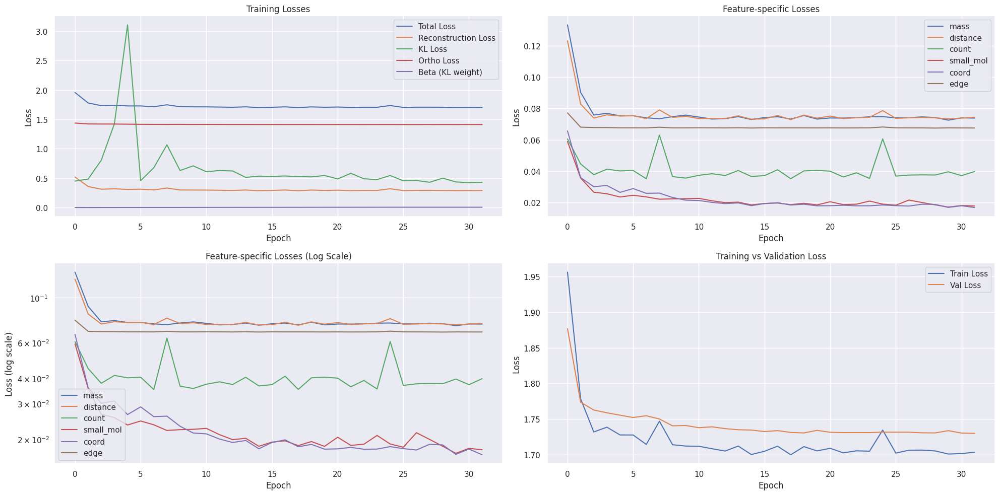

Epoch 33/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 17.43it/s, loss=1.6960, recon=0.2828, kl=0.4729, ortho=1.4108]


Detailed loss diagnostics:
Raw recon_loss: 0.2762
Raw KL loss: 0.4793
Ortho loss: 1.4114
Current beta: 0.0050
mu mean: -0.0178, std: 0.6830
logvar mean: -0.9862, std: 0.9605
mass: 0.0773
distance: 0.0736
count: 0.0262
small_mol: 0.0125
coord: 0.0194
edge: 0.0672


Epoch 33/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 19.36it/s, loss=1.8061, recon=0.3949, kl=0.3793, ortho=1.4093]


Detailed loss diagnostics:
Raw recon_loss: 0.2556
Raw KL loss: 0.4579
Ortho loss: 1.4098
Current beta: 0.0050
mu mean: 0.0205, std: 0.6709
logvar mean: -0.9332, std: 0.9512
mass: 0.0656
distance: 0.0628
count: 0.0253
small_mol: 0.0143
coord: 0.0199
edge: 0.0677


Epoch 33/100 [Train]:  57%|█████▋    | 24/42 [00:01<00:00, 18.47it/s, loss=1.7377, recon=0.3251, kl=0.4015, ortho=1.4106]


Detailed loss diagnostics:
Raw recon_loss: 0.2835
Raw KL loss: 0.3587
Ortho loss: 1.4115
Current beta: 0.0050
mu mean: -0.0144, std: 0.6074
logvar mean: -0.7430, std: 0.8196
mass: 0.0768
distance: 0.0748
count: 0.0263
small_mol: 0.0240
coord: 0.0148
edge: 0.0669


Epoch 33/100 [Train]:  79%|███████▊  | 33/42 [00:01<00:00, 18.12it/s, loss=1.6804, recon=0.2679, kl=0.4376, ortho=1.4103]


Detailed loss diagnostics:
Raw recon_loss: 0.2588
Raw KL loss: 0.2964
Ortho loss: 1.4124
Current beta: 0.0050
mu mean: 0.0483, std: 0.4728
logvar mean: -0.7917, std: 0.8198
mass: 0.0728
distance: 0.0708
count: 0.0259
small_mol: 0.0091
coord: 0.0137
edge: 0.0666


Epoch 33/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 18.66it/s, loss=1.8759, recon=0.4382, kl=0.3571, ortho=1.4360]



Detailed loss diagnostics:
Raw recon_loss: 0.4027
Raw KL loss: 0.5515
Ortho loss: 1.4104
Current beta: 0.0050
mu mean: 0.0447, std: 0.7841
logvar mean: -0.9784, std: 0.9519
mass: 0.0792
distance: 0.1000
count: 0.1226
small_mol: 0.0191
coord: 0.0122
edge: 0.0695

Starting validation...


Epoch 33/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 63.88it/s]



Epoch [33/100] - Time: 2.59s
Train - Total: 1.7030, Recon: 0.2891, KL: 0.4312, Ortho: 1.4118, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0738
  distance_loss: 0.0739
  count_loss: 0.0375
  small_mol_loss: 0.0195
  coord_loss: 0.0169
  edge_loss: 0.0675


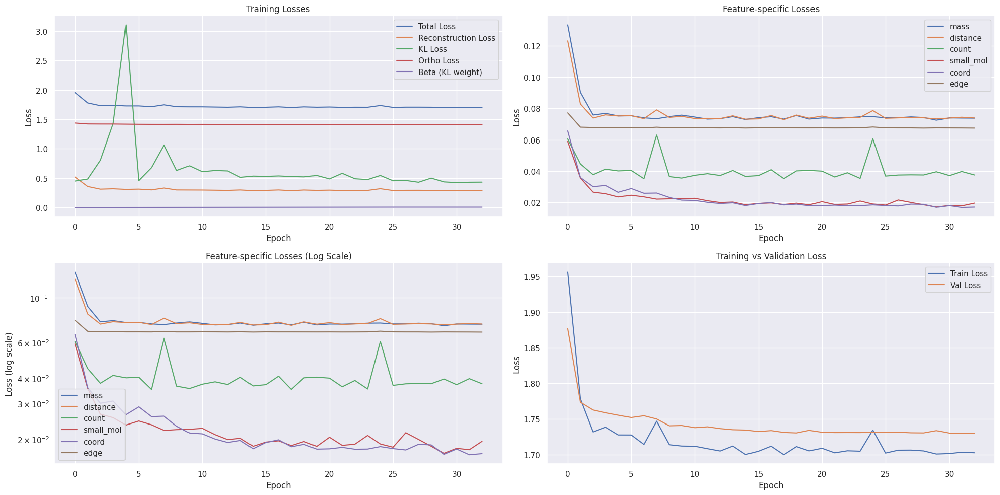

Epoch 34/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 18.81it/s, loss=1.6873, recon=0.2745, kl=0.3914, ortho=1.4109]


Detailed loss diagnostics:
Raw recon_loss: 0.2979
Raw KL loss: 0.3378
Ortho loss: 1.4100
Current beta: 0.0050
mu mean: 0.0162, std: 0.5343
logvar mean: -0.8274, std: 0.8535
mass: 0.0840
distance: 0.0792
count: 0.0267
small_mol: 0.0234
coord: 0.0169
edge: 0.0677


Epoch 34/100 [Train]:  31%|███       | 13/42 [00:00<00:01, 18.91it/s, loss=1.7318, recon=0.3191, kl=0.3314, ortho=1.4110]


Detailed loss diagnostics:
Raw recon_loss: 0.2680
Raw KL loss: 0.5114
Ortho loss: 1.4111
Current beta: 0.0050
mu mean: -0.0257, std: 0.7309
logvar mean: -0.9664, std: 0.9779
mass: 0.0649
distance: 0.0717
count: 0.0314
small_mol: 0.0144
coord: 0.0164
edge: 0.0691


Epoch 34/100 [Train]:  55%|█████▍    | 23/42 [00:01<00:00, 19.55it/s, loss=1.7290, recon=0.3166, kl=0.4731, ortho=1.4100]


Detailed loss diagnostics:
Raw recon_loss: 0.2843
Raw KL loss: 0.2982
Ortho loss: 1.4111
Current beta: 0.0050
mu mean: -0.0263, std: 0.5172
logvar mean: -0.7056, std: 0.8083
mass: 0.0778
distance: 0.0755
count: 0.0263
small_mol: 0.0217
coord: 0.0160
edge: 0.0670


Epoch 34/100 [Train]:  79%|███████▊  | 33/42 [00:01<00:00, 19.03it/s, loss=1.7118, recon=0.2991, kl=0.3413, ortho=1.4110]


Detailed loss diagnostics:
Raw recon_loss: 0.2730
Raw KL loss: 0.3439
Ortho loss: 1.4110
Current beta: 0.0050
mu mean: -0.0013, std: 0.5664
logvar mean: -0.7667, std: 0.8372
mass: 0.0751
distance: 0.0740
count: 0.0260
small_mol: 0.0169
coord: 0.0140
edge: 0.0670


Epoch 34/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.20it/s, loss=1.7046, recon=0.2707, kl=0.3853, ortho=1.4320]



Detailed loss diagnostics:
Raw recon_loss: 0.2588
Raw KL loss: 0.5008
Ortho loss: 1.4106
Current beta: 0.0050
mu mean: 0.0265, std: 0.7158
logvar mean: -0.9721, std: 0.9633
mass: 0.0677
distance: 0.0678
count: 0.0256
small_mol: 0.0160
coord: 0.0143
edge: 0.0673

Starting validation...


Epoch 34/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 63.93it/s]



Epoch [34/100] - Time: 2.52s
Train - Total: 1.6991, Recon: 0.2855, KL: 0.4260, Ortho: 1.4114, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0739
  distance_loss: 0.0736
  count_loss: 0.0356
  small_mol_loss: 0.0180
  coord_loss: 0.0169
  edge_loss: 0.0675


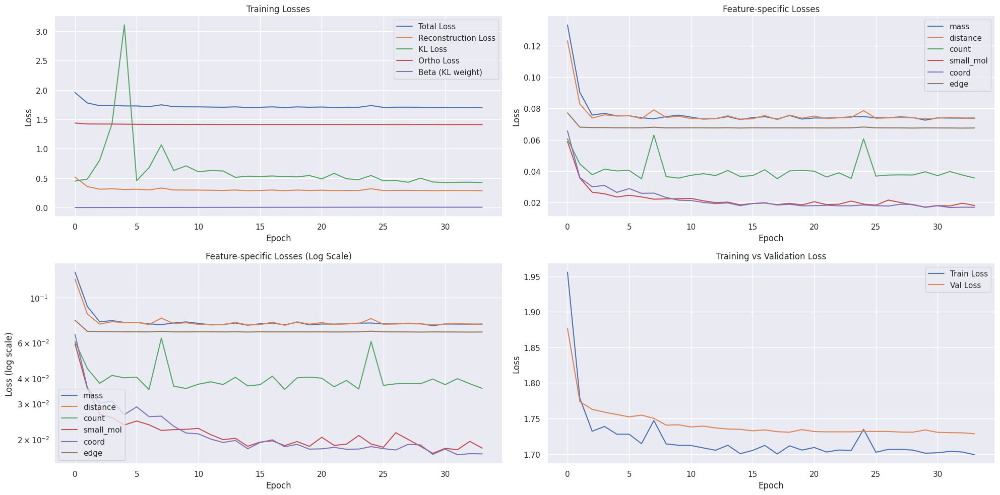

Epoch 35/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 18.59it/s, loss=1.7082, recon=0.2943, kl=0.4424, ortho=1.4117]


Detailed loss diagnostics:
Raw recon_loss: 0.2697
Raw KL loss: 0.5031
Ortho loss: 1.4103
Current beta: 0.0050
mu mean: 0.0218, std: 0.6842
logvar mean: -1.0594, std: 0.9975
mass: 0.0741
distance: 0.0694
count: 0.0258
small_mol: 0.0130
coord: 0.0204
edge: 0.0671


Epoch 35/100 [Train]:  31%|███       | 13/42 [00:00<00:01, 19.03it/s, loss=1.7231, recon=0.3052, kl=0.7950, ortho=1.4140]


Detailed loss diagnostics:
Raw recon_loss: 0.4101
Raw KL loss: 0.4632
Ortho loss: 1.4111
Current beta: 0.0050
mu mean: 0.0563, std: 0.6482
logvar mean: -1.0202, std: 0.9515
mass: 0.0751
distance: 0.0945
count: 0.1328
small_mol: 0.0239
coord: 0.0132
edge: 0.0706


Epoch 35/100 [Train]:  55%|█████▍    | 23/42 [00:01<00:00, 20.14it/s, loss=1.6423, recon=0.2305, kl=0.4153, ortho=1.4097]


Detailed loss diagnostics:
Raw recon_loss: 0.2824
Raw KL loss: 0.4690
Ortho loss: 1.4110
Current beta: 0.0050
mu mean: -0.0443, std: 0.6780
logvar mean: -0.9725, std: 0.9491
mass: 0.0775
distance: 0.0732
count: 0.0260
small_mol: 0.0193
coord: 0.0186
edge: 0.0678


Epoch 35/100 [Train]:  79%|███████▊  | 33/42 [00:01<00:00, 17.85it/s, loss=1.6877, recon=0.2755, kl=0.3869, ortho=1.4102]


Detailed loss diagnostics:
Raw recon_loss: 0.2480
Raw KL loss: 0.3533
Ortho loss: 1.4107
Current beta: 0.0050
mu mean: -0.0056, std: 0.5599
logvar mean: -0.8078, std: 0.9108
mass: 0.0643
distance: 0.0633
count: 0.0253
small_mol: 0.0119
coord: 0.0164
edge: 0.0669


Epoch 35/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 18.92it/s, loss=1.8180, recon=0.3862, kl=0.5053, ortho=1.4293]



Detailed loss diagnostics:
Raw recon_loss: 0.2860
Raw KL loss: 0.3739
Ortho loss: 1.4093
Current beta: 0.0050
mu mean: 0.0053, std: 0.5818
logvar mean: -0.8414, std: 0.9075
mass: 0.0774
distance: 0.0808
count: 0.0264
small_mol: 0.0178
coord: 0.0165
edge: 0.0672

Starting validation...


Epoch 35/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 66.30it/s]



Epoch [35/100] - Time: 2.55s
Train - Total: 1.7088, Recon: 0.2952, KL: 0.4436, Ortho: 1.4114, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0745
  distance_loss: 0.0757
  count_loss: 0.0418
  small_mol_loss: 0.0183
  coord_loss: 0.0172
  edge_loss: 0.0676


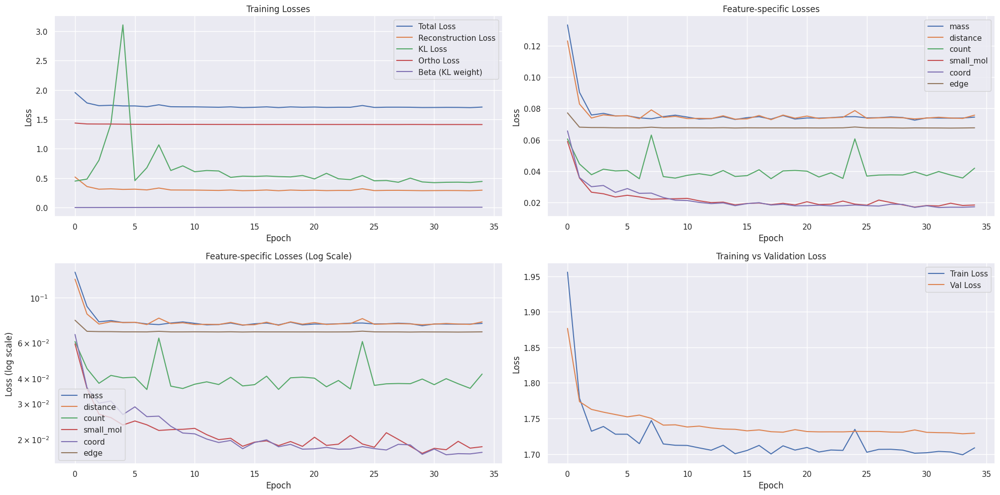

Epoch 36/100 [Train]:   5%|▍         | 2/42 [00:00<00:02, 19.80it/s, loss=1.6871, recon=0.2736, kl=0.4828, ortho=1.4110]


Detailed loss diagnostics:
Raw recon_loss: 0.2698
Raw KL loss: 0.3361
Ortho loss: 1.4105
Current beta: 0.0050
mu mean: 0.0429, std: 0.5306
logvar mean: -0.8191, std: 0.8648
mass: 0.0728
distance: 0.0724
count: 0.0259
small_mol: 0.0198
coord: 0.0116
edge: 0.0673


Epoch 36/100 [Train]:  31%|███       | 13/42 [00:00<00:01, 18.82it/s, loss=1.6661, recon=0.2533, kl=0.3656, ortho=1.4110]


Detailed loss diagnostics:
Raw recon_loss: 0.4036
Raw KL loss: 0.5138
Ortho loss: 1.4106
Current beta: 0.0050
mu mean: 0.0478, std: 0.7250
logvar mean: -0.9979, std: 0.9659
mass: 0.0776
distance: 0.0903
count: 0.1247
small_mol: 0.0232
coord: 0.0165
edge: 0.0713


Epoch 36/100 [Train]:  52%|█████▏    | 22/42 [00:01<00:00, 20.38it/s, loss=1.6466, recon=0.2339, kl=0.4156, ortho=1.4106]


Detailed loss diagnostics:
Raw recon_loss: 0.2796
Raw KL loss: 0.4517
Ortho loss: 1.4103
Current beta: 0.0050
mu mean: -0.0151, std: 0.6780
logvar mean: -0.9142, std: 0.9273
mass: 0.0725
distance: 0.0698
count: 0.0259
small_mol: 0.0248
coord: 0.0188
edge: 0.0678


Epoch 36/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 18.92it/s, loss=1.6922, recon=0.2792, kl=0.3420, ortho=1.4113]


Detailed loss diagnostics:
Raw recon_loss: 0.2605
Raw KL loss: 0.3489
Ortho loss: 1.4131
Current beta: 0.0050
mu mean: 0.0268, std: 0.5573
logvar mean: -0.7938, std: 0.9041
mass: 0.0682
distance: 0.0678
count: 0.0255
small_mol: 0.0207
coord: 0.0123
edge: 0.0661


Epoch 36/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.16it/s, loss=1.8144, recon=0.3846, kl=0.2625, ortho=1.4285]



Detailed loss diagnostics:
Raw recon_loss: 0.3225
Raw KL loss: 0.5088
Ortho loss: 1.4126
Current beta: 0.0050
mu mean: -0.0556, std: 0.7555
logvar mean: -0.8909, std: 1.0422
mass: 0.0849
distance: 0.0809
count: 0.0266
small_mol: 0.0188
coord: 0.0436
edge: 0.0677

Starting validation...


Epoch 36/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 65.89it/s]



Epoch [36/100] - Time: 2.52s
Train - Total: 1.7077, Recon: 0.2945, KL: 0.4042, Ortho: 1.4112, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0743
  distance_loss: 0.0755
  count_loss: 0.0415
  small_mol_loss: 0.0182
  coord_loss: 0.0173
  edge_loss: 0.0676


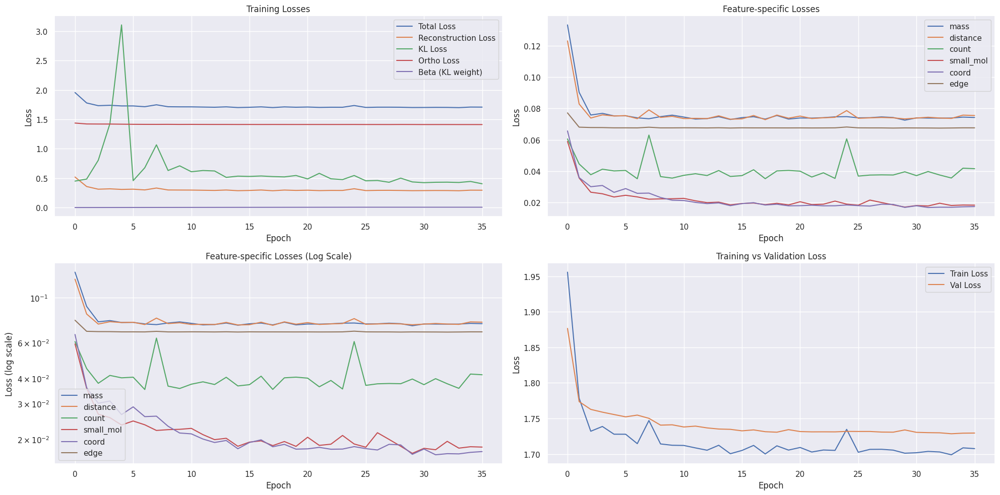

Epoch 37/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 17.80it/s, loss=1.6687, recon=0.2542, kl=0.5643, ortho=1.4117]


Detailed loss diagnostics:
Raw recon_loss: 0.3024
Raw KL loss: 0.3338
Ortho loss: 1.4119
Current beta: 0.0050
mu mean: 0.0633, std: 0.5590
logvar mean: -0.7552, std: 0.8330
mass: 0.0848
distance: 0.0788
count: 0.0268
small_mol: 0.0329
coord: 0.0124
edge: 0.0667


Epoch 37/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 18.51it/s, loss=1.6707, recon=0.2569, kl=0.3943, ortho=1.4118]


Detailed loss diagnostics:
Raw recon_loss: 0.2486
Raw KL loss: 0.5241
Ortho loss: 1.4130
Current beta: 0.0050
mu mean: -0.0132, std: 0.7426
logvar mean: -1.0028, std: 0.9646
mass: 0.0620
distance: 0.0624
count: 0.0252
small_mol: 0.0223
coord: 0.0105
edge: 0.0663


Epoch 37/100 [Train]:  57%|█████▋    | 24/42 [00:01<00:00, 19.31it/s, loss=1.6881, recon=0.2748, kl=0.4614, ortho=1.4110]


Detailed loss diagnostics:
Raw recon_loss: 0.2900
Raw KL loss: 0.4640
Ortho loss: 1.4098
Current beta: 0.0050
mu mean: 0.0111, std: 0.6822
logvar mean: -0.9252, std: 0.9745
mass: 0.0812
distance: 0.0774
count: 0.0264
small_mol: 0.0213
coord: 0.0156
edge: 0.0682


Epoch 37/100 [Train]:  79%|███████▊  | 33/42 [00:01<00:00, 19.45it/s, loss=1.6870, recon=0.2749, kl=0.3766, ortho=1.4102]


Detailed loss diagnostics:
Raw recon_loss: 0.2730
Raw KL loss: 0.4522
Ortho loss: 1.4116
Current beta: 0.0050
mu mean: -0.0435, std: 0.6779
logvar mean: -0.8935, std: 0.9586
mass: 0.0761
distance: 0.0756
count: 0.0263
small_mol: 0.0137
coord: 0.0155
edge: 0.0658


Epoch 37/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.53it/s, loss=1.7018, recon=0.2731, kl=0.4675, ortho=1.4264]



Detailed loss diagnostics:
Raw recon_loss: 0.4194
Raw KL loss: 0.3436
Ortho loss: 1.4100
Current beta: 0.0050
mu mean: -0.0238, std: 0.5503
logvar mean: -0.7994, std: 0.9105
mass: 0.0798
distance: 0.1021
count: 0.1315
small_mol: 0.0203
coord: 0.0160
edge: 0.0697

Starting validation...


Epoch 37/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 65.95it/s]



Epoch [37/100] - Time: 2.48s
Train - Total: 1.6992, Recon: 0.2858, KL: 0.4333, Ortho: 1.4112, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0740
  distance_loss: 0.0738
  count_loss: 0.0363
  small_mol_loss: 0.0179
  coord_loss: 0.0162
  edge_loss: 0.0675


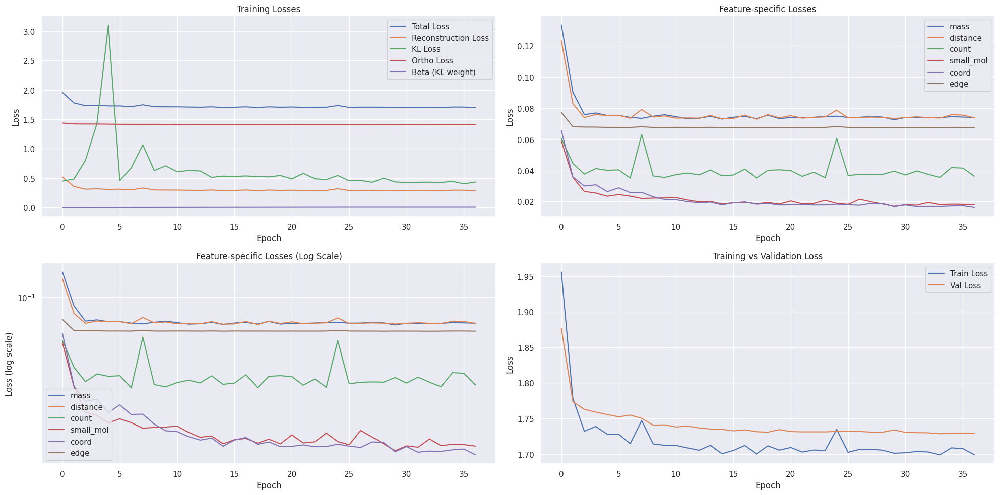

Epoch 38/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 17.93it/s, loss=1.6762, recon=0.2630, kl=0.5684, ortho=1.4103]


Detailed loss diagnostics:
Raw recon_loss: 0.2768
Raw KL loss: 0.3558
Ortho loss: 1.4100
Current beta: 0.0050
mu mean: -0.0151, std: 0.5696
logvar mean: -0.8141, std: 0.8968
mass: 0.0746
distance: 0.0751
count: 0.0261
small_mol: 0.0228
coord: 0.0114
edge: 0.0668


Epoch 38/100 [Train]:  31%|███       | 13/42 [00:00<00:01, 19.36it/s, loss=1.6403, recon=0.2280, kl=0.3494, ortho=1.4106]


Detailed loss diagnostics:
Raw recon_loss: 0.2993
Raw KL loss: 0.3898
Ortho loss: 1.4101
Current beta: 0.0050
mu mean: 0.0113, std: 0.6420
logvar mean: -0.7597, std: 0.9083
mass: 0.0799
distance: 0.0773
count: 0.0265
small_mol: 0.0282
coord: 0.0199
edge: 0.0675


Epoch 38/100 [Train]:  55%|█████▍    | 23/42 [00:01<00:01, 18.80it/s, loss=1.7148, recon=0.3014, kl=0.5385, ortho=1.4107]


Detailed loss diagnostics:
Raw recon_loss: 0.2533
Raw KL loss: 0.3587
Ortho loss: 1.4101
Current beta: 0.0050
mu mean: 0.0493, std: 0.5774
logvar mean: -0.8002, std: 0.8987
mass: 0.0678
distance: 0.0670
count: 0.0256
small_mol: 0.0148
coord: 0.0116
edge: 0.0664


Epoch 38/100 [Train]:  76%|███████▌  | 32/42 [00:01<00:00, 20.01it/s, loss=1.6996, recon=0.2873, kl=0.3918, ortho=1.4103]


Detailed loss diagnostics:
Raw recon_loss: 0.4277
Raw KL loss: 0.3944
Ortho loss: 1.4097
Current beta: 0.0050
mu mean: 0.0393, std: 0.6249
logvar mean: -0.8302, std: 0.9010
mass: 0.0800
distance: 0.0978
count: 0.1387
small_mol: 0.0269
coord: 0.0134
edge: 0.0709


Epoch 38/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.57it/s, loss=1.8976, recon=0.4657, kl=0.4645, ortho=1.4296]



Detailed loss diagnostics:
Raw recon_loss: 0.2964
Raw KL loss: 0.6099
Ortho loss: 1.4110
Current beta: 0.0050
mu mean: 0.0317, std: 0.8253
logvar mean: -1.0137, std: 1.1618
mass: 0.0788
distance: 0.0772
count: 0.0265
small_mol: 0.0267
coord: 0.0203
edge: 0.0671

Starting validation...


Epoch 38/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 66.94it/s]



Epoch [38/100] - Time: 2.47s
Train - Total: 1.7011, Recon: 0.2880, KL: 0.3973, Ortho: 1.4110, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0748
  distance_loss: 0.0737
  count_loss: 0.0360
  small_mol_loss: 0.0186
  coord_loss: 0.0173
  edge_loss: 0.0676


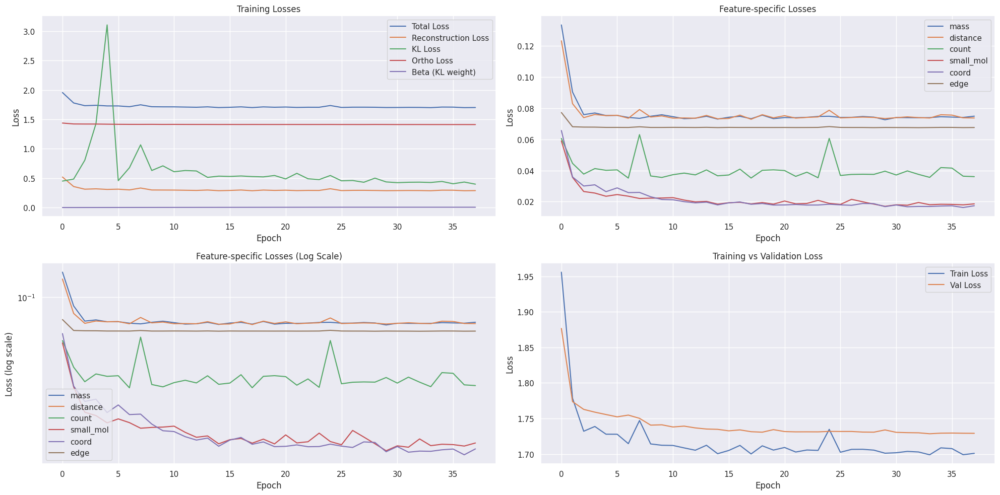

Epoch 39/100 [Train]:   5%|▍         | 2/42 [00:00<00:02, 19.41it/s, loss=1.6983, recon=0.2860, kl=0.5363, ortho=1.4097]


Detailed loss diagnostics:
Raw recon_loss: 0.2661
Raw KL loss: 0.3947
Ortho loss: 1.4105
Current beta: 0.0050
mu mean: -0.0166, std: 0.5815
logvar mean: -0.9126, std: 0.9701
mass: 0.0732
distance: 0.0706
count: 0.0260
small_mol: 0.0175
coord: 0.0121
edge: 0.0667


Epoch 39/100 [Train]:  31%|███       | 13/42 [00:00<00:01, 18.29it/s, loss=1.6427, recon=0.2307, kl=0.4289, ortho=1.4098]


Detailed loss diagnostics:
Raw recon_loss: 0.2701
Raw KL loss: 0.4374
Ortho loss: 1.4106
Current beta: 0.0050
mu mean: 0.0235, std: 0.6226
logvar mean: -0.9827, std: 0.9848
mass: 0.0739
distance: 0.0744
count: 0.0261
small_mol: 0.0152
coord: 0.0132
edge: 0.0672


Epoch 39/100 [Train]:  55%|█████▍    | 23/42 [00:01<00:01, 16.96it/s, loss=1.6993, recon=0.2871, kl=0.3479, ortho=1.4105]


Detailed loss diagnostics:
Raw recon_loss: 0.2660
Raw KL loss: 0.3086
Ortho loss: 1.4107
Current beta: 0.0050
mu mean: 0.0009, std: 0.5240
logvar mean: -0.7054, std: 0.8731
mass: 0.0676
distance: 0.0732
count: 0.0320
small_mol: 0.0157
coord: 0.0092
edge: 0.0683


Epoch 39/100 [Train]:  79%|███████▊  | 33/42 [00:01<00:00, 18.81it/s, loss=1.6643, recon=0.2518, kl=0.3730, ortho=1.4106]


Detailed loss diagnostics:
Raw recon_loss: 0.3025
Raw KL loss: 0.3788
Ortho loss: 1.4097
Current beta: 0.0050
mu mean: 0.0031, std: 0.5854
logvar mean: -0.8717, std: 0.9066
mass: 0.0854
distance: 0.0820
count: 0.0269
small_mol: 0.0243
coord: 0.0167
edge: 0.0672


Epoch 39/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 18.32it/s, loss=1.8065, recon=0.3751, kl=0.5272, ortho=1.4287]



Detailed loss diagnostics:
Raw recon_loss: 0.2811
Raw KL loss: 0.4173
Ortho loss: 1.4108
Current beta: 0.0050
mu mean: -0.0018, std: 0.6135
logvar mean: -0.9284, std: 0.9751
mass: 0.0756
distance: 0.0751
count: 0.0261
small_mol: 0.0186
coord: 0.0188
edge: 0.0668

Starting validation...


Epoch 39/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 67.28it/s]



Epoch [39/100] - Time: 2.61s
Train - Total: 1.7074, Recon: 0.2942, KL: 0.4450, Ortho: 1.4109, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0749
  distance_loss: 0.0753
  count_loss: 0.0396
  small_mol_loss: 0.0196
  coord_loss: 0.0173
  edge_loss: 0.0675


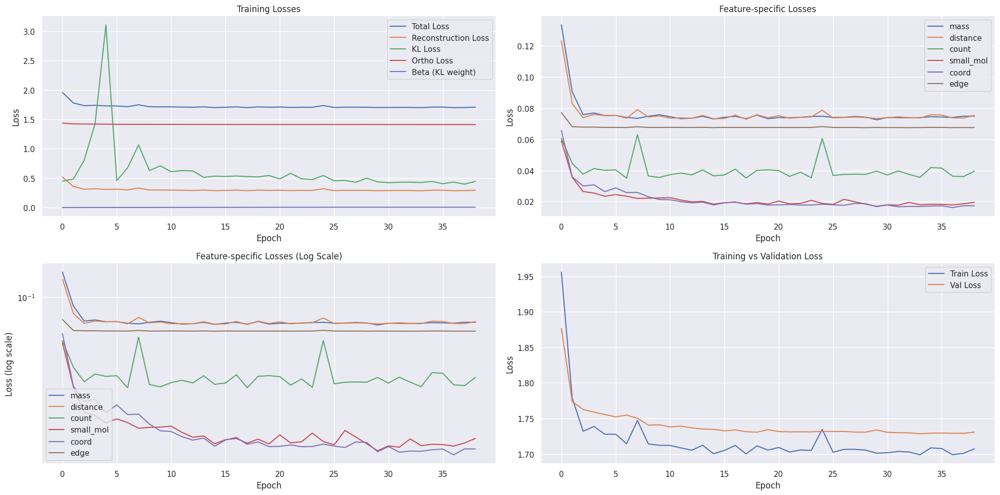

Epoch 40/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 18.66it/s, loss=1.6710, recon=0.2561, kl=0.4212, ortho=1.4128]


Detailed loss diagnostics:
Raw recon_loss: 0.2472
Raw KL loss: 0.3569
Ortho loss: 1.4104
Current beta: 0.0050
mu mean: 0.0110, std: 0.5795
logvar mean: -0.7860, std: 0.9133
mass: 0.0661
distance: 0.0643
count: 0.0254
small_mol: 0.0144
coord: 0.0106
edge: 0.0665


Epoch 40/100 [Train]:  31%|███       | 13/42 [00:00<00:01, 18.70it/s, loss=1.7169, recon=0.3046, kl=0.3495, ortho=1.4106]


Detailed loss diagnostics:
Raw recon_loss: 0.2693
Raw KL loss: 0.3770
Ortho loss: 1.4099
Current beta: 0.0050
mu mean: -0.0104, std: 0.5920
logvar mean: -0.8355, std: 0.9204
mass: 0.0745
distance: 0.0726
count: 0.0261
small_mol: 0.0148
coord: 0.0146
edge: 0.0668


Epoch 40/100 [Train]:  52%|█████▏    | 22/42 [00:01<00:01, 18.99it/s, loss=1.8337, recon=0.4217, kl=0.3665, ortho=1.4102]


Detailed loss diagnostics:
Raw recon_loss: 0.2795
Raw KL loss: 0.4592
Ortho loss: 1.4101
Current beta: 0.0050
mu mean: -0.0108, std: 0.6858
logvar mean: -0.8970, std: 0.9682
mass: 0.0771
distance: 0.0755
count: 0.0263
small_mol: 0.0172
coord: 0.0162
edge: 0.0672


Epoch 40/100 [Train]:  79%|███████▊  | 33/42 [00:01<00:00, 19.58it/s, loss=1.6753, recon=0.2631, kl=0.3809, ortho=1.4104]


Detailed loss diagnostics:
Raw recon_loss: 0.2462
Raw KL loss: 0.4381
Ortho loss: 1.4102
Current beta: 0.0050
mu mean: 0.0083, std: 0.6320
logvar mean: -0.9684, std: 0.9717
mass: 0.0641
distance: 0.0624
count: 0.0252
small_mol: 0.0125
coord: 0.0141
edge: 0.0679


Epoch 40/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.38it/s, loss=1.7402, recon=0.3029, kl=0.3400, ortho=1.4356]



Detailed loss diagnostics:
Raw recon_loss: 0.2979
Raw KL loss: 0.3900
Ortho loss: 1.4107
Current beta: 0.0050
mu mean: 0.0188, std: 0.6476
logvar mean: -0.7524, std: 0.8853
mass: 0.0799
distance: 0.0744
count: 0.0263
small_mol: 0.0318
coord: 0.0184
edge: 0.0671

Starting validation...


Epoch 40/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 64.44it/s]



Epoch [40/100] - Time: 2.50s
Train - Total: 1.6988, Recon: 0.2847, KL: 0.4564, Ortho: 1.4118, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0737
  distance_loss: 0.0736
  count_loss: 0.0359
  small_mol_loss: 0.0176
  coord_loss: 0.0164
  edge_loss: 0.0676


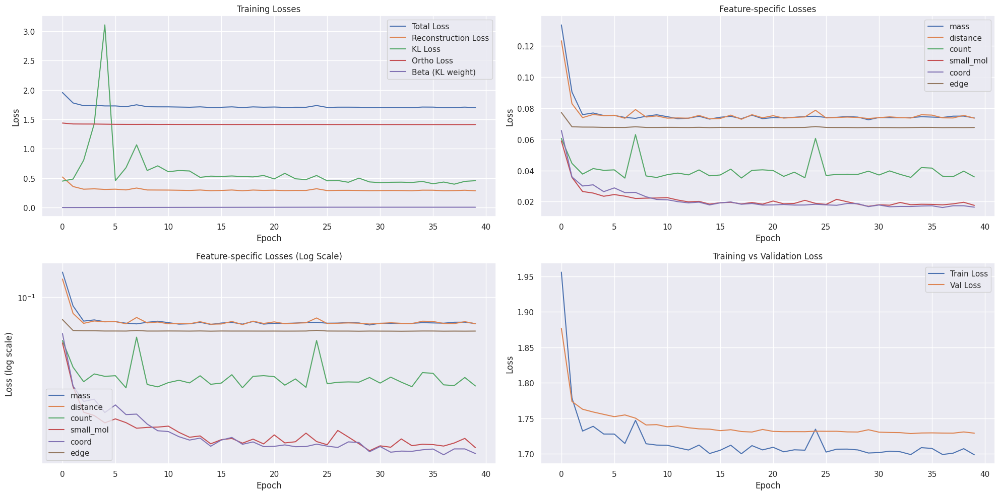

Epoch 41/100 [Train]:   5%|▍         | 2/42 [00:00<00:02, 17.60it/s, loss=1.6783, recon=0.2672, kl=0.3102, ortho=1.4096]


Detailed loss diagnostics:
Raw recon_loss: 0.2521
Raw KL loss: 0.4164
Ortho loss: 1.4100
Current beta: 0.0050
mu mean: -0.0060, std: 0.6520
logvar mean: -0.8225, std: 0.9673
mass: 0.0666
distance: 0.0659
count: 0.0255
small_mol: 0.0143
coord: 0.0130
edge: 0.0669


Epoch 41/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 19.21it/s, loss=1.7329, recon=0.3210, kl=0.4326, ortho=1.4098]


Detailed loss diagnostics:
Raw recon_loss: 0.2764
Raw KL loss: 0.4384
Ortho loss: 1.4101
Current beta: 0.0050
mu mean: 0.0329, std: 0.6837
logvar mean: -0.8340, std: 0.9433
mass: 0.0753
distance: 0.0731
count: 0.0260
small_mol: 0.0230
coord: 0.0111
edge: 0.0679


Epoch 41/100 [Train]:  57%|█████▋    | 24/42 [00:01<00:00, 18.65it/s, loss=1.6613, recon=0.2485, kl=0.4617, ortho=1.4105]


Detailed loss diagnostics:
Raw recon_loss: 0.3132
Raw KL loss: 0.6015
Ortho loss: 1.4104
Current beta: 0.0050
mu mean: -0.0232, std: 0.8282
logvar mean: -0.9589, std: 1.2063
mass: 0.0849
distance: 0.0812
count: 0.0267
small_mol: 0.0208
coord: 0.0326
edge: 0.0670


Epoch 41/100 [Train]:  79%|███████▊  | 33/42 [00:01<00:00, 19.20it/s, loss=1.7325, recon=0.3196, kl=0.3787, ortho=1.4109]


Detailed loss diagnostics:
Raw recon_loss: 0.2716
Raw KL loss: 0.3671
Ortho loss: 1.4108
Current beta: 0.0050
mu mean: -0.0233, std: 0.5997
logvar mean: -0.7615, std: 0.9173
mass: 0.0752
distance: 0.0737
count: 0.0262
small_mol: 0.0184
coord: 0.0118
edge: 0.0663


Epoch 41/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.11it/s, loss=1.9037, recon=0.4667, kl=0.5073, ortho=1.4344]



Detailed loss diagnostics:
Raw recon_loss: 0.2823
Raw KL loss: 0.3455
Ortho loss: 1.4105
Current beta: 0.0050
mu mean: -0.0019, std: 0.5756
logvar mean: -0.7439, std: 0.9127
mass: 0.0796
distance: 0.0776
count: 0.0265
small_mol: 0.0168
coord: 0.0144
edge: 0.0676

Starting validation...


Epoch 41/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 65.62it/s]



Epoch [41/100] - Time: 2.53s
Train - Total: 1.7072, Recon: 0.2940, KL: 0.4216, Ortho: 1.4111, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0754
  distance_loss: 0.0752
  count_loss: 0.0385
  small_mol_loss: 0.0199
  coord_loss: 0.0174
  edge_loss: 0.0676


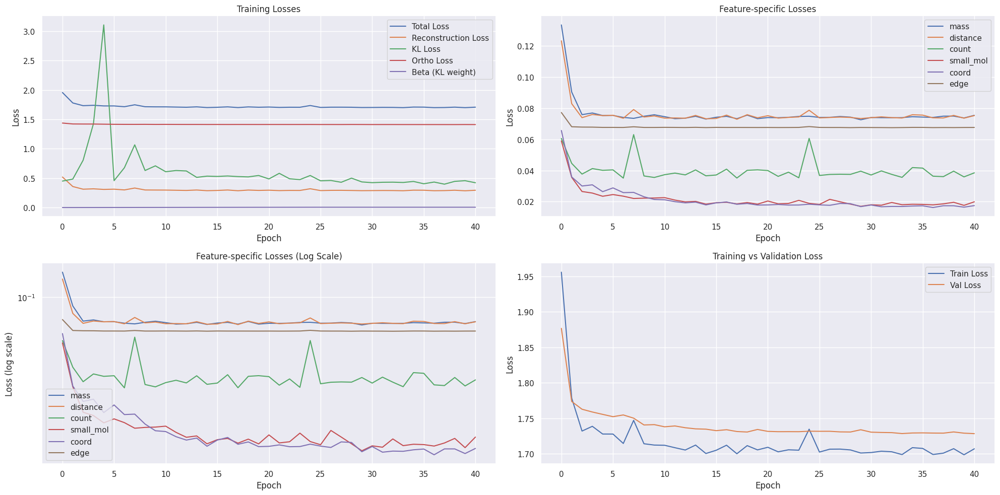

Epoch 42/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 17.18it/s, loss=1.6627, recon=0.2483, kl=0.4954, ortho=1.4119]


Detailed loss diagnostics:
Raw recon_loss: 0.2951
Raw KL loss: 0.5476
Ortho loss: 1.4096
Current beta: 0.0050
mu mean: 0.0089, std: 0.7931
logvar mean: -0.9050, std: 1.1057
mass: 0.0772
distance: 0.0760
count: 0.0264
small_mol: 0.0192
coord: 0.0292
edge: 0.0670


Epoch 42/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 19.06it/s, loss=1.6706, recon=0.2582, kl=0.3829, ortho=1.4105]


Detailed loss diagnostics:
Raw recon_loss: 0.2486
Raw KL loss: 0.4130
Ortho loss: 1.4108
Current beta: 0.0050
mu mean: 0.0253, std: 0.6685
logvar mean: -0.7692, std: 0.9440
mass: 0.0639
distance: 0.0627
count: 0.0253
small_mol: 0.0168
coord: 0.0128
edge: 0.0672


Epoch 42/100 [Train]:  55%|█████▍    | 23/42 [00:01<00:00, 19.38it/s, loss=1.6962, recon=0.2830, kl=0.4270, ortho=1.4110]


Detailed loss diagnostics:
Raw recon_loss: 0.2786
Raw KL loss: 0.4791
Ortho loss: 1.4111
Current beta: 0.0050
mu mean: 0.0082, std: 0.7057
logvar mean: -0.9087, std: 1.0193
mass: 0.0754
distance: 0.0736
count: 0.0262
small_mol: 0.0216
coord: 0.0154
edge: 0.0664


Epoch 42/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 18.85it/s, loss=1.6741, recon=0.2612, kl=0.5099, ortho=1.4104]


Detailed loss diagnostics:
Raw recon_loss: 0.2968
Raw KL loss: 0.4791
Ortho loss: 1.4115
Current beta: 0.0050
mu mean: 0.0350, std: 0.6936
logvar mean: -0.9292, std: 1.0518
mass: 0.0787
distance: 0.0801
count: 0.0264
small_mol: 0.0290
coord: 0.0151
edge: 0.0674


Epoch 42/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 18.97it/s, loss=1.7782, recon=0.3497, kl=0.4121, ortho=1.4264]



Detailed loss diagnostics:
Raw recon_loss: 0.2498
Raw KL loss: 0.6359
Ortho loss: 1.4096
Current beta: 0.0050
mu mean: 0.0335, std: 0.8556
logvar mean: -1.0093, std: 1.1816
mass: 0.0639
distance: 0.0616
count: 0.0252
small_mol: 0.0153
coord: 0.0186
edge: 0.0653

Starting validation...


Epoch 42/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 63.81it/s]



Epoch [42/100] - Time: 2.55s
Train - Total: 1.7066, Recon: 0.2932, KL: 0.4427, Ortho: 1.4112, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0753
  distance_loss: 0.0755
  count_loss: 0.0392
  small_mol_loss: 0.0187
  coord_loss: 0.0169
  edge_loss: 0.0675


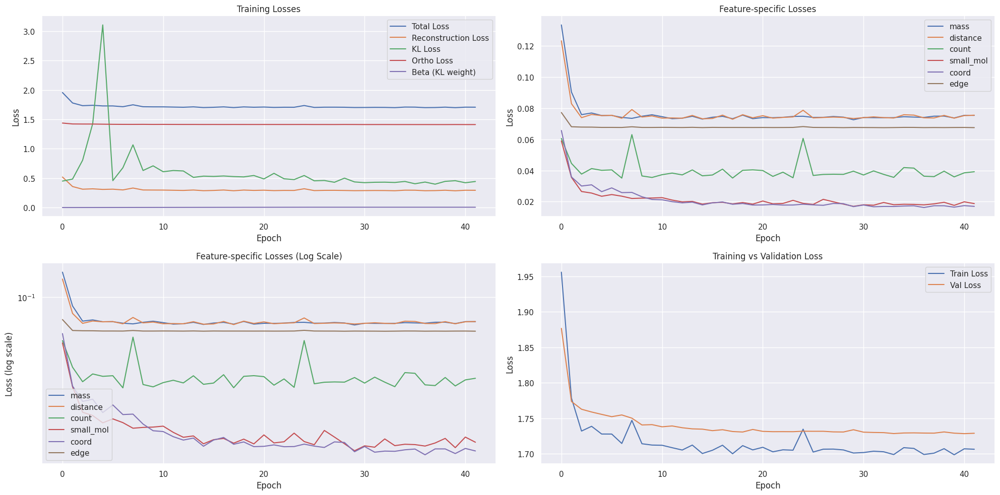

Epoch 43/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 18.61it/s, loss=1.6850, recon=0.2734, kl=0.3496, ortho=1.4098]


Detailed loss diagnostics:
Raw recon_loss: 0.2709
Raw KL loss: 0.3920
Ortho loss: 1.4110
Current beta: 0.0050
mu mean: -0.0012, std: 0.6359
logvar mean: -0.7449, std: 0.9802
mass: 0.0716
distance: 0.0706
count: 0.0258
small_mol: 0.0212
coord: 0.0150
edge: 0.0667


Epoch 43/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 19.87it/s, loss=1.9215, recon=0.5078, kl=0.3054, ortho=1.4122]


Detailed loss diagnostics:
Raw recon_loss: 0.2868
Raw KL loss: 0.3091
Ortho loss: 1.4107
Current beta: 0.0050
mu mean: -0.0114, std: 0.5602
logvar mean: -0.5779, std: 0.9145
mass: 0.0784
distance: 0.0766
count: 0.0264
small_mol: 0.0223
coord: 0.0165
edge: 0.0666


Epoch 43/100 [Train]:  55%|█████▍    | 23/42 [00:01<00:00, 19.83it/s, loss=1.6916, recon=0.2794, kl=0.4488, ortho=1.4099]


Detailed loss diagnostics:
Raw recon_loss: 0.4241
Raw KL loss: 0.3664
Ortho loss: 1.4128
Current beta: 0.0050
mu mean: 0.0654, std: 0.5940
logvar mean: -0.7633, std: 0.9665
mass: 0.0767
distance: 0.1051
count: 0.1342
small_mol: 0.0195
coord: 0.0139
edge: 0.0748


Epoch 43/100 [Train]:  79%|███████▊  | 33/42 [00:01<00:00, 19.30it/s, loss=1.7318, recon=0.3185, kl=0.4324, ortho=1.4111]


Detailed loss diagnostics:
Raw recon_loss: 0.2433
Raw KL loss: 0.4002
Ortho loss: 1.4112
Current beta: 0.0050
mu mean: -0.0155, std: 0.6217
logvar mean: -0.8209, std: 1.0193
mass: 0.0651
distance: 0.0636
count: 0.0253
small_mol: 0.0100
coord: 0.0126
edge: 0.0667


Epoch 43/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.37it/s, loss=1.7864, recon=0.3477, kl=0.3946, ortho=1.4367]



Detailed loss diagnostics:
Raw recon_loss: 0.2844
Raw KL loss: 0.3648
Ortho loss: 1.4116
Current beta: 0.0050
mu mean: 0.0216, std: 0.5976
logvar mean: -0.7516, std: 0.9692
mass: 0.0829
distance: 0.0739
count: 0.0259
small_mol: 0.0216
coord: 0.0124
edge: 0.0677

Starting validation...


Epoch 43/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 65.38it/s]



Epoch [43/100] - Time: 2.50s
Train - Total: 1.7026, Recon: 0.2891, KL: 0.3964, Ortho: 1.4115, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0740
  distance_loss: 0.0742
  count_loss: 0.0383
  small_mol_loss: 0.0187
  coord_loss: 0.0163
  edge_loss: 0.0676


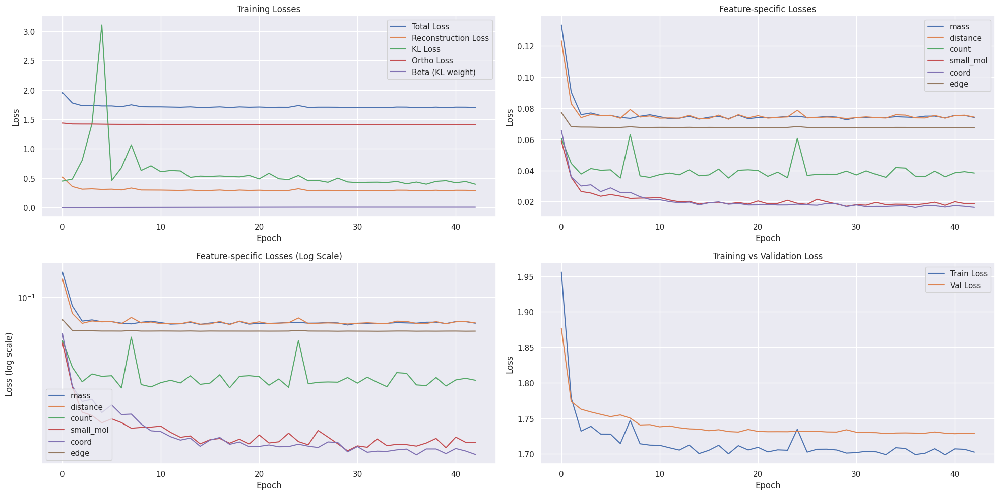

Epoch 44/100 [Train]:   7%|▋         | 3/42 [00:00<00:01, 19.77it/s, loss=1.7227, recon=0.3090, kl=0.4638, ortho=1.4114]


Detailed loss diagnostics:
Raw recon_loss: 0.2843
Raw KL loss: 0.3058
Ortho loss: 1.4099
Current beta: 0.0050
mu mean: -0.0437, std: 0.5002
logvar mean: -0.6968, std: 0.9858
mass: 0.0796
distance: 0.0798
count: 0.0265
small_mol: 0.0155
coord: 0.0161
edge: 0.0668


Epoch 44/100 [Train]:  29%|██▊       | 12/42 [00:00<00:01, 19.88it/s, loss=1.6899, recon=0.2779, kl=0.3868, ortho=1.4100]


Detailed loss diagnostics:
Raw recon_loss: 0.3598
Raw KL loss: 0.3468
Ortho loss: 1.4124
Current beta: 0.0050
mu mean: 0.0466, std: 0.5494
logvar mean: -0.7418, std: 1.0225
mass: 0.0951
distance: 0.1062
count: 0.0436
small_mol: 0.0286
coord: 0.0185
edge: 0.0678


Epoch 44/100 [Train]:  52%|█████▏    | 22/42 [00:01<00:01, 18.95it/s, loss=1.6475, recon=0.2349, kl=0.4157, ortho=1.4105]


Detailed loss diagnostics:
Raw recon_loss: 0.2721
Raw KL loss: 0.4193
Ortho loss: 1.4103
Current beta: 0.0050
mu mean: 0.0052, std: 0.6164
logvar mean: -0.8913, std: 1.0859
mass: 0.0701
distance: 0.0710
count: 0.0258
small_mol: 0.0199
coord: 0.0172
edge: 0.0682


Epoch 44/100 [Train]:  79%|███████▊  | 33/42 [00:01<00:00, 18.99it/s, loss=1.6826, recon=0.2710, kl=0.3506, ortho=1.4099]


Detailed loss diagnostics:
Raw recon_loss: 0.2734
Raw KL loss: 0.4249
Ortho loss: 1.4096
Current beta: 0.0050
mu mean: -0.0081, std: 0.6224
logvar mean: -0.8708, std: 1.1363
mass: 0.0740
distance: 0.0718
count: 0.0260
small_mol: 0.0154
coord: 0.0188
edge: 0.0673


Epoch 44/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 18.91it/s, loss=1.7466, recon=0.3183, kl=0.4166, ortho=1.4262]



Detailed loss diagnostics:
Raw recon_loss: 0.2734
Raw KL loss: 0.3949
Ortho loss: 1.4103
Current beta: 0.0050
mu mean: -0.0002, std: 0.6227
logvar mean: -0.7637, std: 1.0516
mass: 0.0776
distance: 0.0759
count: 0.0264
small_mol: 0.0124
coord: 0.0135
edge: 0.0676

Starting validation...


Epoch 44/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 66.36it/s]



Epoch [44/100] - Time: 2.54s
Train - Total: 1.7034, Recon: 0.2906, KL: 0.4212, Ortho: 1.4107, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0747
  distance_loss: 0.0749
  count_loss: 0.0391
  small_mol_loss: 0.0182
  coord_loss: 0.0161
  edge_loss: 0.0676


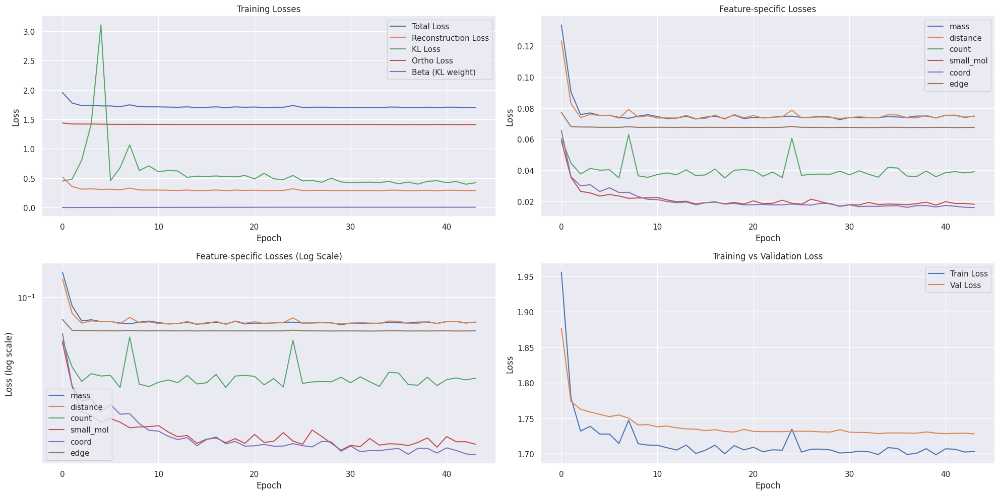

Epoch 45/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 17.40it/s, loss=1.6575, recon=0.2452, kl=0.5215, ortho=1.4097]


Detailed loss diagnostics:
Raw recon_loss: 0.2596
Raw KL loss: 0.3620
Ortho loss: 1.4098
Current beta: 0.0050
mu mean: -0.0070, std: 0.5668
logvar mean: -0.7739, std: 1.0448
mass: 0.0729
distance: 0.0700
count: 0.0258
small_mol: 0.0131
coord: 0.0102
edge: 0.0677


Epoch 45/100 [Train]:  31%|███       | 13/42 [00:00<00:01, 18.80it/s, loss=1.6674, recon=0.2549, kl=0.3784, ortho=1.4106]


Detailed loss diagnostics:
Raw recon_loss: 0.2937
Raw KL loss: 0.4509
Ortho loss: 1.4112
Current beta: 0.0050
mu mean: 0.0077, std: 0.6669
logvar mean: -0.8802, std: 1.1045
mass: 0.0776
distance: 0.0732
count: 0.0262
small_mol: 0.0317
coord: 0.0177
edge: 0.0673


Epoch 45/100 [Train]:  55%|█████▍    | 23/42 [00:01<00:01, 18.05it/s, loss=1.6529, recon=0.2411, kl=0.5078, ortho=1.4093]


Detailed loss diagnostics:
Raw recon_loss: 0.2670
Raw KL loss: 0.3785
Ortho loss: 1.4096
Current beta: 0.0050
mu mean: 0.0333, std: 0.5763
logvar mean: -0.8334, std: 1.0613
mass: 0.0762
distance: 0.0704
count: 0.0260
small_mol: 0.0124
coord: 0.0145
edge: 0.0673


Epoch 45/100 [Train]:  79%|███████▊  | 33/42 [00:01<00:00, 18.86it/s, loss=1.6902, recon=0.2784, kl=0.4115, ortho=1.4097]


Detailed loss diagnostics:
Raw recon_loss: 0.2587
Raw KL loss: 0.3873
Ortho loss: 1.4089
Current beta: 0.0050
mu mean: 0.0127, std: 0.6170
logvar mean: -0.7695, std: 1.0198
mass: 0.0689
distance: 0.0684
count: 0.0257
small_mol: 0.0176
coord: 0.0108
edge: 0.0672


Epoch 45/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 18.62it/s, loss=1.8313, recon=0.3927, kl=0.3372, ortho=1.4369]



Detailed loss diagnostics:
Raw recon_loss: 0.3174
Raw KL loss: 0.3952
Ortho loss: 1.4106
Current beta: 0.0050
mu mean: -0.0086, std: 0.6310
logvar mean: -0.7766, std: 1.0108
mass: 0.0794
distance: 0.0896
count: 0.0353
small_mol: 0.0290
coord: 0.0157
edge: 0.0684

Starting validation...


Epoch 45/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 64.11it/s]



Epoch [45/100] - Time: 2.59s
Train - Total: 1.7041, Recon: 0.2910, KL: 0.4261, Ortho: 1.4109, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0745
  distance_loss: 0.0748
  count_loss: 0.0398
  small_mol_loss: 0.0183
  coord_loss: 0.0161
  edge_loss: 0.0676


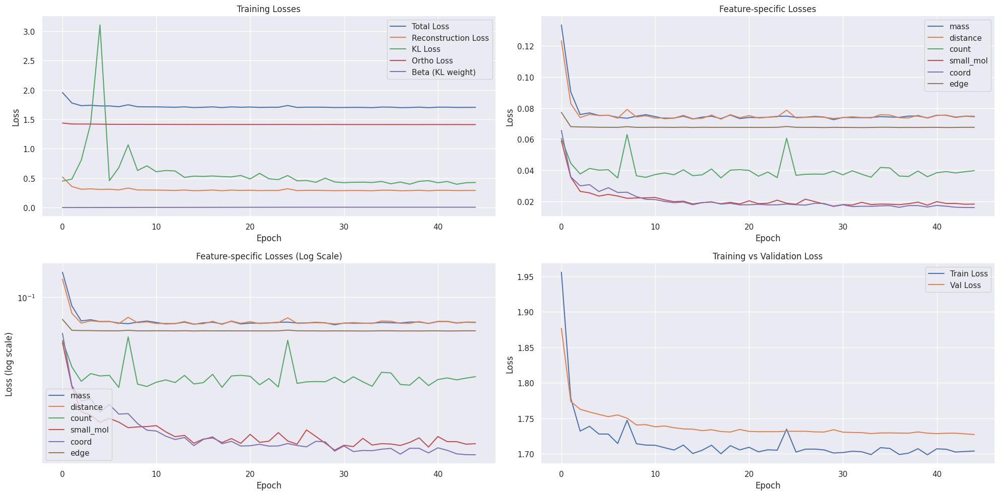

Epoch 46/100 [Train]:   5%|▍         | 2/42 [00:00<00:02, 19.31it/s, loss=1.6631, recon=0.2519, kl=0.3285, ortho=1.4095]


Detailed loss diagnostics:
Raw recon_loss: 0.2593
Raw KL loss: 0.4138
Ortho loss: 1.4091
Current beta: 0.0050
mu mean: -0.0324, std: 0.6464
logvar mean: -0.7964, std: 1.0533
mass: 0.0697
distance: 0.0705
count: 0.0257
small_mol: 0.0152
coord: 0.0114
edge: 0.0669


Epoch 46/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 19.09it/s, loss=1.6914, recon=0.2789, kl=0.3664, ortho=1.4106]


Detailed loss diagnostics:
Raw recon_loss: 0.4372
Raw KL loss: 0.4550
Ortho loss: 1.4101
Current beta: 0.0050
mu mean: 0.0035, std: 0.6489
logvar mean: -0.9342, std: 1.1220
mass: 0.0753
distance: 0.0911
count: 0.1663
small_mol: 0.0219
coord: 0.0132
edge: 0.0694


Epoch 46/100 [Train]:  55%|█████▍    | 23/42 [00:01<00:00, 19.79it/s, loss=1.7037, recon=0.2924, kl=0.3388, ortho=1.4096]


Detailed loss diagnostics:
Raw recon_loss: 0.2794
Raw KL loss: 0.3473
Ortho loss: 1.4101
Current beta: 0.0050
mu mean: 0.0556, std: 0.5425
logvar mean: -0.7884, std: 1.0215
mass: 0.0741
distance: 0.0755
count: 0.0259
small_mol: 0.0196
coord: 0.0165
edge: 0.0678


Epoch 46/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 19.28it/s, loss=1.6699, recon=0.2584, kl=0.3696, ortho=1.4097]


Detailed loss diagnostics:
Raw recon_loss: 0.2376
Raw KL loss: 0.3915
Ortho loss: 1.4103
Current beta: 0.0050
mu mean: 0.0226, std: 0.6466
logvar mean: -0.7275, std: 0.9890
mass: 0.0621
distance: 0.0611
count: 0.0251
small_mol: 0.0114
coord: 0.0117
edge: 0.0663


Epoch 46/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.54it/s, loss=1.8219, recon=0.3928, kl=0.3786, ortho=1.4272]



Detailed loss diagnostics:
Raw recon_loss: 0.2748
Raw KL loss: 0.3616
Ortho loss: 1.4104
Current beta: 0.0050
mu mean: 0.0440, std: 0.5891
logvar mean: -0.7637, std: 0.9765
mass: 0.0765
distance: 0.0739
count: 0.0261
small_mol: 0.0137
coord: 0.0171
edge: 0.0674

Starting validation...


Epoch 46/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 64.88it/s]



Epoch [46/100] - Time: 2.48s
Train - Total: 1.7028, Recon: 0.2898, KL: 0.3860, Ortho: 1.4110, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0739
  distance_loss: 0.0747
  count_loss: 0.0389
  small_mol_loss: 0.0179
  coord_loss: 0.0168
  edge_loss: 0.0676


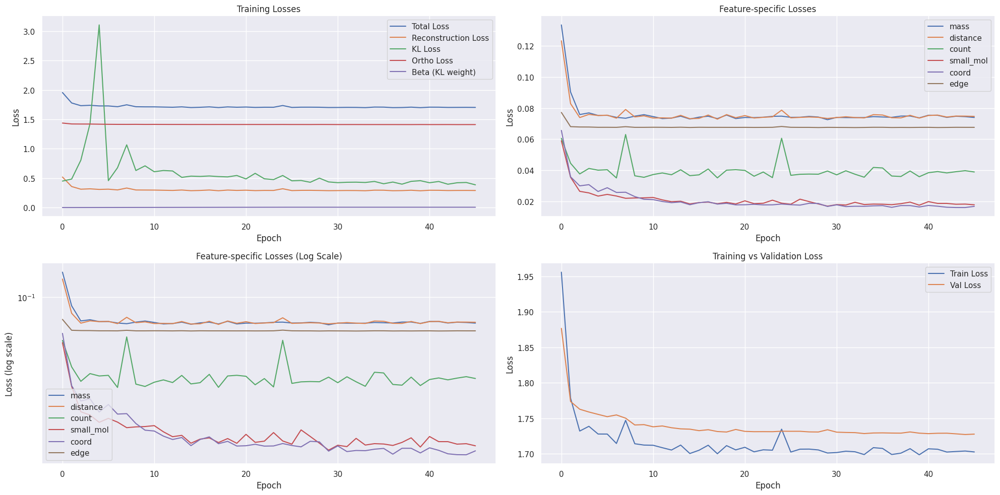

Epoch 47/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 17.97it/s, loss=1.7230, recon=0.3091, kl=0.6305, ortho=1.4107]


Detailed loss diagnostics:
Raw recon_loss: 0.2895
Raw KL loss: 0.3052
Ortho loss: 1.4108
Current beta: 0.0050
mu mean: -0.0420, std: 0.4962
logvar mean: -0.7268, std: 0.9897
mass: 0.0751
distance: 0.0819
count: 0.0345
small_mol: 0.0153
coord: 0.0142
edge: 0.0685


Epoch 47/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 17.99it/s, loss=1.8083, recon=0.3948, kl=0.4656, ortho=1.4111]


Detailed loss diagnostics:
Raw recon_loss: 0.2578
Raw KL loss: 0.4357
Ortho loss: 1.4113
Current beta: 0.0050
mu mean: -0.0490, std: 0.6444
logvar mean: -0.8878, std: 1.0773
mass: 0.0693
distance: 0.0675
count: 0.0257
small_mol: 0.0138
coord: 0.0144
edge: 0.0672


Epoch 47/100 [Train]:  57%|█████▋    | 24/42 [00:01<00:00, 19.02it/s, loss=1.6575, recon=0.2445, kl=0.4327, ortho=1.4108]


Detailed loss diagnostics:
Raw recon_loss: 0.2507
Raw KL loss: 0.3730
Ortho loss: 1.4090
Current beta: 0.0050
mu mean: 0.0339, std: 0.5761
logvar mean: -0.8258, std: 1.0124
mass: 0.0672
distance: 0.0651
count: 0.0254
small_mol: 0.0138
coord: 0.0118
edge: 0.0674


Epoch 47/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 19.04it/s, loss=1.7110, recon=0.2988, kl=0.3068, ortho=1.4106]


Detailed loss diagnostics:
Raw recon_loss: 0.2737
Raw KL loss: 0.4350
Ortho loss: 1.4112
Current beta: 0.0050
mu mean: -0.0313, std: 0.6508
logvar mean: -0.8889, std: 1.0521
mass: 0.0733
distance: 0.0687
count: 0.0257
small_mol: 0.0151
coord: 0.0228
edge: 0.0681


Epoch 47/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 18.74it/s, loss=1.7927, recon=0.3645, kl=0.3422, ortho=1.4265]



Detailed loss diagnostics:
Raw recon_loss: 0.2451
Raw KL loss: 0.3554
Ortho loss: 1.4115
Current beta: 0.0050
mu mean: 0.0047, std: 0.5774
logvar mean: -0.7228, std: 1.0364
mass: 0.0637
distance: 0.0605
count: 0.0251
small_mol: 0.0144
coord: 0.0139
edge: 0.0676

Starting validation...


Epoch 47/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 65.37it/s]



Epoch [47/100] - Time: 2.57s
Train - Total: 1.7018, Recon: 0.2888, KL: 0.4200, Ortho: 1.4109, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0739
  distance_loss: 0.0742
  count_loss: 0.0380
  small_mol_loss: 0.0190
  coord_loss: 0.0162
  edge_loss: 0.0676


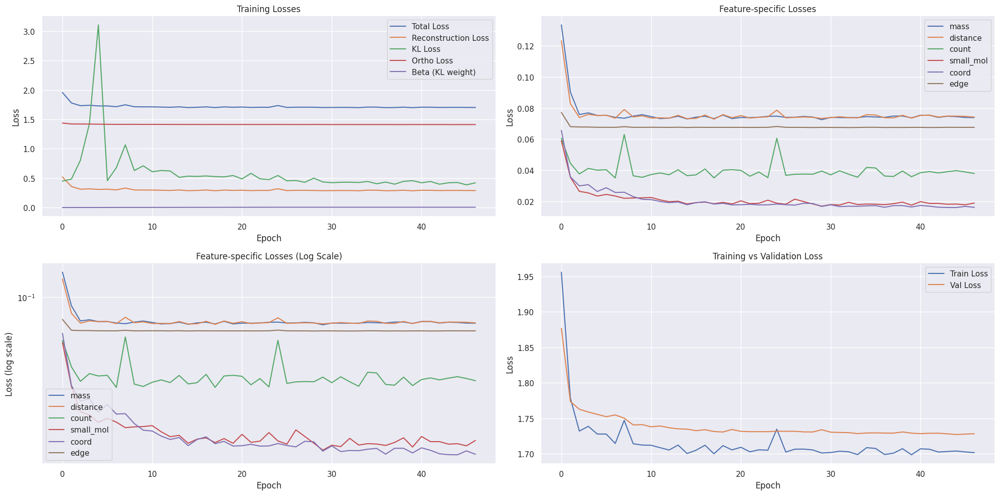

Epoch 48/100 [Train]:   5%|▍         | 2/42 [00:00<00:02, 18.20it/s, loss=1.6833, recon=0.2696, kl=0.4765, ortho=1.4114]


Detailed loss diagnostics:
Raw recon_loss: 0.2588
Raw KL loss: 0.4045
Ortho loss: 1.4106
Current beta: 0.0050
mu mean: -0.0244, std: 0.6098
logvar mean: -0.8472, std: 1.0712
mass: 0.0684
distance: 0.0683
count: 0.0257
small_mol: 0.0179
coord: 0.0113
edge: 0.0672


Epoch 48/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 20.02it/s, loss=1.6860, recon=0.2711, kl=0.8277, ortho=1.4108]


Detailed loss diagnostics:
Raw recon_loss: 0.3061
Raw KL loss: 1.3452
Ortho loss: 1.4146
Current beta: 0.0050
mu mean: 0.0715, std: 1.2618
logvar mean: -1.7072, std: 1.9355
mass: 0.0792
distance: 0.0757
count: 0.0263
small_mol: 0.0264
coord: 0.0323
edge: 0.0661


Epoch 48/100 [Train]:  55%|█████▍    | 23/42 [00:01<00:00, 20.16it/s, loss=1.6779, recon=0.2654, kl=0.4691, ortho=1.4101]


Detailed loss diagnostics:
Raw recon_loss: 0.2734
Raw KL loss: 0.7089
Ortho loss: 1.4120
Current beta: 0.0050
mu mean: 0.0221, std: 0.8414
logvar mean: -1.2211, std: 1.5084
mass: 0.0720
distance: 0.0701
count: 0.0258
small_mol: 0.0226
coord: 0.0153
edge: 0.0676


Epoch 48/100 [Train]:  79%|███████▊  | 33/42 [00:01<00:00, 19.49it/s, loss=1.7036, recon=0.2877, kl=0.4776, ortho=1.4136]


Detailed loss diagnostics:
Raw recon_loss: 0.2529
Raw KL loss: 0.4758
Ortho loss: 1.4098
Current beta: 0.0050
mu mean: -0.0481, std: 0.6857
logvar mean: -0.9064, std: 1.1491
mass: 0.0666
distance: 0.0663
count: 0.0255
small_mol: 0.0121
coord: 0.0152
edge: 0.0672


Epoch 48/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.36it/s, loss=1.7565, recon=0.3240, kl=0.2582, ortho=1.4312]



Detailed loss diagnostics:
Raw recon_loss: 0.2323
Raw KL loss: 0.4248
Ortho loss: 1.4098
Current beta: 0.0050
mu mean: 0.0106, std: 0.6290
logvar mean: -0.8583, std: 1.1240
mass: 0.0587
distance: 0.0579
count: 0.0248
small_mol: 0.0124
coord: 0.0110
edge: 0.0675

Starting validation...


Epoch 48/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 65.42it/s]



Epoch [48/100] - Time: 2.50s
Train - Total: 1.6998, Recon: 0.2855, KL: 0.5742, Ortho: 1.4115, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0741
  distance_loss: 0.0742
  count_loss: 0.0356
  small_mol_loss: 0.0182
  coord_loss: 0.0159
  edge_loss: 0.0675


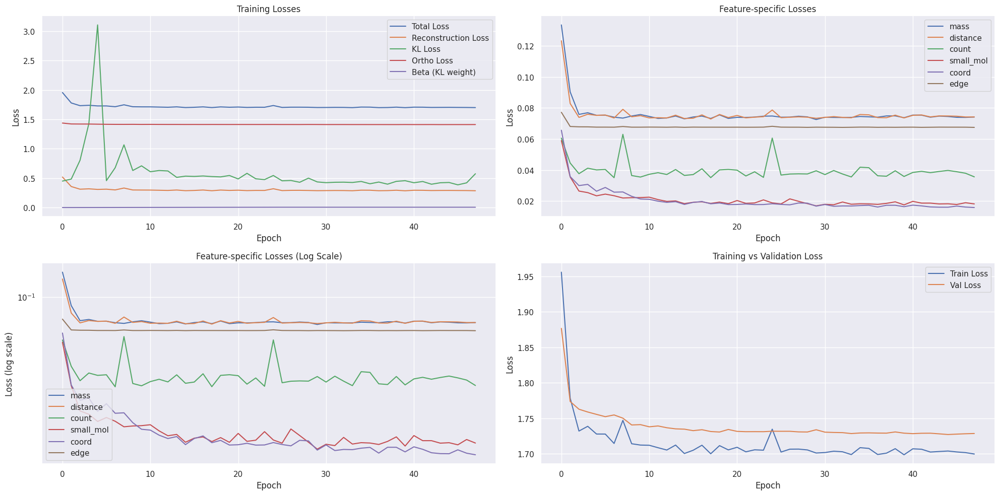

Epoch 49/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 17.31it/s, loss=1.6462, recon=0.2339, kl=0.3196, ortho=1.4106]


Detailed loss diagnostics:
Raw recon_loss: 0.3840
Raw KL loss: 0.4752
Ortho loss: 1.4098
Current beta: 0.0050
mu mean: 0.0219, std: 0.6871
logvar mean: -0.8966, std: 1.1383
mass: 0.0726
distance: 0.0918
count: 0.1123
small_mol: 0.0202
coord: 0.0175
edge: 0.0696


Epoch 49/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 19.64it/s, loss=1.6828, recon=0.2705, kl=0.6091, ortho=1.4092]


Detailed loss diagnostics:
Raw recon_loss: 0.2677
Raw KL loss: 0.3434
Ortho loss: 1.4115
Current beta: 0.0050
mu mean: 0.0420, std: 0.5495
logvar mean: -0.7312, std: 1.0333
mass: 0.0735
distance: 0.0724
count: 0.0260
small_mol: 0.0154
coord: 0.0136
edge: 0.0669


Epoch 49/100 [Train]:  52%|█████▏    | 22/42 [00:01<00:00, 20.33it/s, loss=1.6768, recon=0.2660, kl=0.3269, ortho=1.4092]


Detailed loss diagnostics:
Raw recon_loss: 0.3837
Raw KL loss: 0.4590
Ortho loss: 1.4092
Current beta: 0.0050
mu mean: -0.0383, std: 0.6880
logvar mean: -0.8218, std: 1.1248
mass: 0.0777
distance: 0.0934
count: 0.1100
small_mol: 0.0153
coord: 0.0162
edge: 0.0711


Epoch 49/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 20.30it/s, loss=1.6703, recon=0.2574, kl=0.2640, ortho=1.4115]


Detailed loss diagnostics:
Raw recon_loss: 0.2719
Raw KL loss: 0.3826
Ortho loss: 1.4096
Current beta: 0.0050
mu mean: 0.0039, std: 0.6289
logvar mean: -0.6911, std: 1.0513
mass: 0.0768
distance: 0.0727
count: 0.0261
small_mol: 0.0148
coord: 0.0144
edge: 0.0671


Epoch 49/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.80it/s, loss=3.1561, recon=1.7223, kl=0.4460, ortho=1.4316]



Detailed loss diagnostics:
Raw recon_loss: 0.2357
Raw KL loss: 0.3412
Ortho loss: 1.4091
Current beta: 0.0050
mu mean: 0.0331, std: 0.5723
logvar mean: -0.6934, std: 0.9852
mass: 0.0608
distance: 0.0608
count: 0.0251
small_mol: 0.0102
coord: 0.0121
edge: 0.0668

Starting validation...


Epoch 49/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 64.49it/s]



Epoch [49/100] - Time: 2.46s
Train - Total: 1.7329, Recon: 0.3198, KL: 0.4026, Ortho: 1.4111, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0739
  distance_loss: 0.0786
  count_loss: 0.0640
  small_mol_loss: 0.0186
  coord_loss: 0.0164
  edge_loss: 0.0682


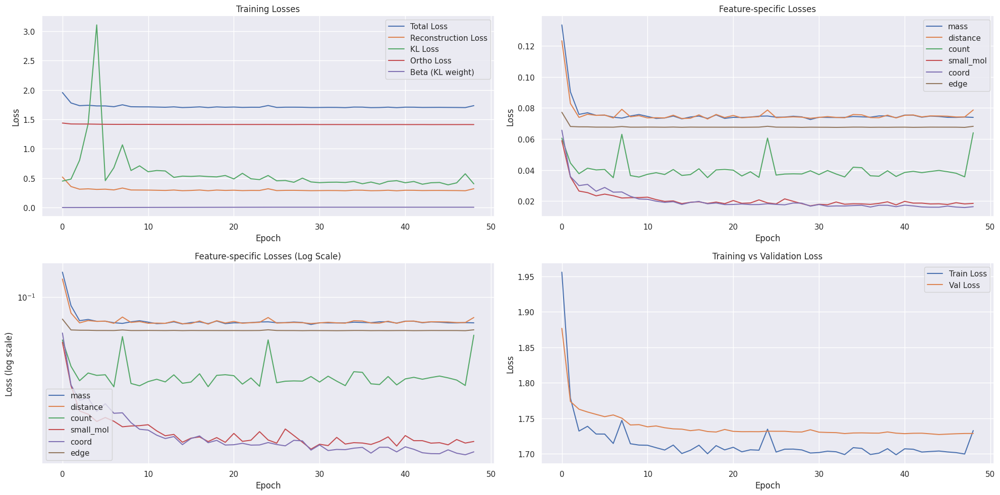

Epoch 50/100 [Train]:   7%|▋         | 3/42 [00:00<00:02, 18.32it/s, loss=1.6618, recon=0.2485, kl=0.3703, ortho=1.4114]


Detailed loss diagnostics:
Raw recon_loss: 0.2748
Raw KL loss: 0.3712
Ortho loss: 1.4111
Current beta: 0.0050
mu mean: 0.0421, std: 0.5932
logvar mean: -0.7702, std: 1.0158
mass: 0.0735
distance: 0.0716
count: 0.0260
small_mol: 0.0220
coord: 0.0141
edge: 0.0675


Epoch 50/100 [Train]:  31%|███       | 13/42 [00:00<00:01, 18.79it/s, loss=1.6792, recon=0.2677, kl=0.3309, ortho=1.4098]


Detailed loss diagnostics:
Raw recon_loss: 0.2656
Raw KL loss: 0.4317
Ortho loss: 1.4116
Current beta: 0.0050
mu mean: -0.0004, std: 0.6676
logvar mean: -0.7926, std: 1.0957
mass: 0.0702
distance: 0.0716
count: 0.0259
small_mol: 0.0189
coord: 0.0126
edge: 0.0664


Epoch 50/100 [Train]:  57%|█████▋    | 24/42 [00:01<00:00, 20.14it/s, loss=1.6995, recon=0.2866, kl=0.3360, ortho=1.4112]


Detailed loss diagnostics:
Raw recon_loss: 0.2602
Raw KL loss: 0.3673
Ortho loss: 1.4097
Current beta: 0.0050
mu mean: 0.0271, std: 0.6029
logvar mean: -0.7376, std: 0.9951
mass: 0.0709
distance: 0.0683
count: 0.0258
small_mol: 0.0172
coord: 0.0112
edge: 0.0668


Epoch 50/100 [Train]:  79%|███████▊  | 33/42 [00:01<00:00, 19.70it/s, loss=1.6740, recon=0.2629, kl=0.3028, ortho=1.4097]


Detailed loss diagnostics:
Raw recon_loss: 0.2615
Raw KL loss: 0.4166
Ortho loss: 1.4097
Current beta: 0.0050
mu mean: -0.0138, std: 0.6557
logvar mean: -0.7802, std: 1.0655
mass: 0.0695
distance: 0.0680
count: 0.0256
small_mol: 0.0167
coord: 0.0142
edge: 0.0674


Epoch 50/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.57it/s, loss=1.7850, recon=0.3498, kl=0.2283, ortho=1.4340]



Detailed loss diagnostics:
Raw recon_loss: 0.3028
Raw KL loss: 0.5358
Ortho loss: 1.4103
Current beta: 0.0050
mu mean: -0.0377, std: 0.7881
logvar mean: -0.8440, std: 1.1712
mass: 0.0783
distance: 0.0777
count: 0.0264
small_mol: 0.0199
coord: 0.0326
edge: 0.0681

Starting validation...


Epoch 50/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 64.79it/s]



Epoch [50/100] - Time: 2.48s
Train - Total: 1.6929, Recon: 0.2801, KL: 0.3898, Ortho: 1.4109, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0734
  distance_loss: 0.0724
  count_loss: 0.0336
  small_mol_loss: 0.0171
  coord_loss: 0.0161
  edge_loss: 0.0675


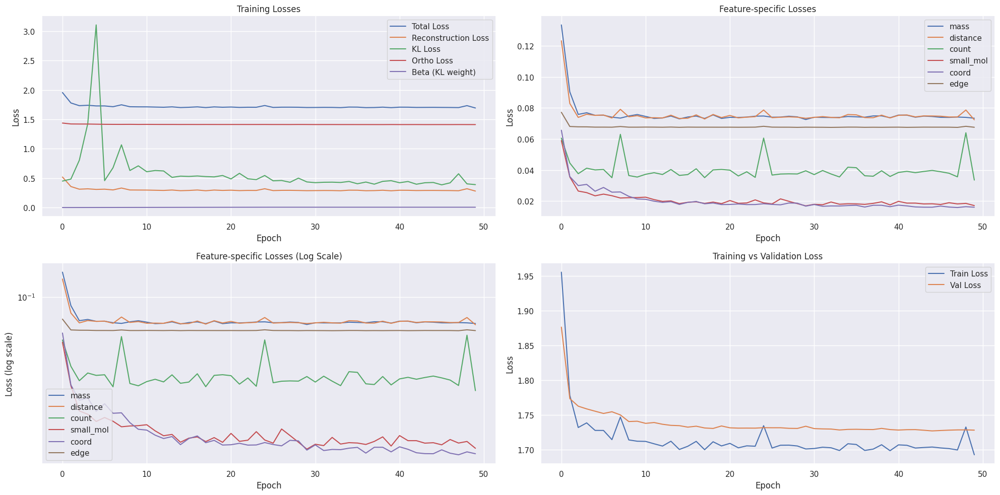

Epoch 51/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 18.74it/s, loss=1.6691, recon=0.2547, kl=0.5044, ortho=1.4119]


Detailed loss diagnostics:
Raw recon_loss: 0.2810
Raw KL loss: 0.3410
Ortho loss: 1.4118
Current beta: 0.0050
mu mean: 0.0127, std: 0.5365
logvar mean: -0.7990, std: 0.9997
mass: 0.0770
distance: 0.0760
count: 0.0262
small_mol: 0.0147
coord: 0.0187
edge: 0.0686


Epoch 51/100 [Train]:  31%|███       | 13/42 [00:00<00:01, 19.62it/s, loss=1.6439, recon=0.2315, kl=0.3896, ortho=1.4104]


Detailed loss diagnostics:
Raw recon_loss: 0.2744
Raw KL loss: 0.3339
Ortho loss: 1.4102
Current beta: 0.0050
mu mean: -0.0213, std: 0.5576
logvar mean: -0.6857, std: 1.0109
mass: 0.0756
distance: 0.0725
count: 0.0258
small_mol: 0.0201
coord: 0.0128
edge: 0.0676


Epoch 51/100 [Train]:  57%|█████▋    | 24/42 [00:01<00:00, 20.03it/s, loss=1.6875, recon=0.2763, kl=0.3489, ortho=1.4094]


Detailed loss diagnostics:
Raw recon_loss: 0.2943
Raw KL loss: 0.3824
Ortho loss: 1.4100
Current beta: 0.0050
mu mean: 0.0006, std: 0.6231
logvar mean: -0.7171, std: 1.0410
mass: 0.0820
distance: 0.0781
count: 0.0266
small_mol: 0.0195
coord: 0.0203
edge: 0.0678


Epoch 51/100 [Train]:  76%|███████▌  | 32/42 [00:01<00:00, 20.15it/s, loss=1.6967, recon=0.2856, kl=0.4413, ortho=1.4089]


Detailed loss diagnostics:
Raw recon_loss: 0.2691
Raw KL loss: 0.4622
Ortho loss: 1.4109
Current beta: 0.0050
mu mean: 0.0249, std: 0.7286
logvar mean: -0.7698, std: 1.0432
mass: 0.0728
distance: 0.0719
count: 0.0259
small_mol: 0.0201
coord: 0.0117
edge: 0.0667


Epoch 51/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.90it/s, loss=1.7698, recon=0.3412, kl=0.3263, ortho=1.4270]



Detailed loss diagnostics:
Raw recon_loss: 0.2631
Raw KL loss: 0.2926
Ortho loss: 1.4099
Current beta: 0.0050
mu mean: 0.0268, std: 0.4737
logvar mean: -0.7152, std: 1.0085
mass: 0.0696
distance: 0.0700
count: 0.0257
small_mol: 0.0182
coord: 0.0124
edge: 0.0672

Starting validation...


Epoch 51/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 64.95it/s]



Epoch [51/100] - Time: 2.44s
Train - Total: 1.7018, Recon: 0.2890, KL: 0.3866, Ortho: 1.4109, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0743
  distance_loss: 0.0742
  count_loss: 0.0385
  small_mol_loss: 0.0179
  coord_loss: 0.0166
  edge_loss: 0.0676


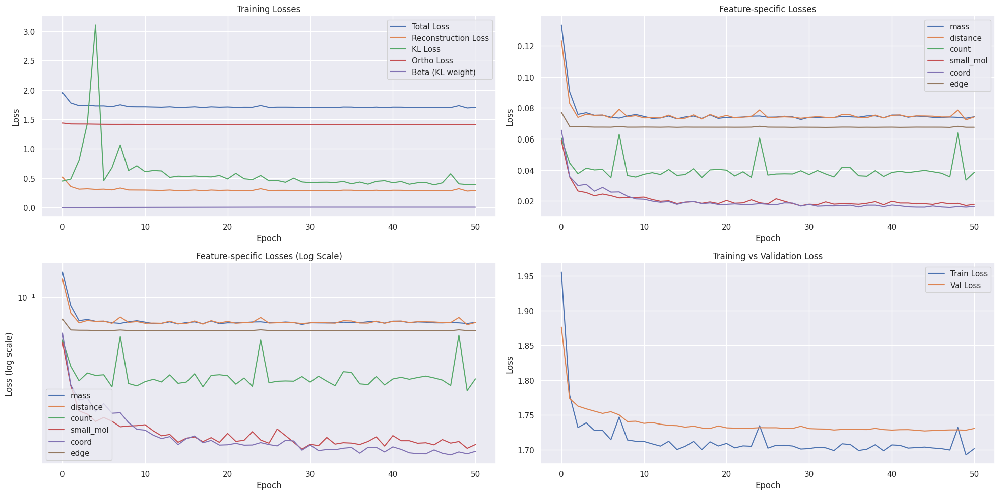

Epoch 52/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 17.92it/s, loss=1.6530, recon=0.2383, kl=0.5598, ortho=1.4120]


Detailed loss diagnostics:
Raw recon_loss: 0.3006
Raw KL loss: 0.4265
Ortho loss: 1.4108
Current beta: 0.0050
mu mean: -0.0384, std: 0.6624
logvar mean: -0.7683, std: 1.1271
mass: 0.0779
distance: 0.0737
count: 0.0262
small_mol: 0.0230
coord: 0.0323
edge: 0.0674


Epoch 52/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 18.90it/s, loss=1.7043, recon=0.2924, kl=0.3845, ortho=1.4100]


Detailed loss diagnostics:
Raw recon_loss: 0.2877
Raw KL loss: 0.3722
Ortho loss: 1.4094
Current beta: 0.0050
mu mean: 0.0328, std: 0.5844
logvar mean: -0.7989, std: 1.0374
mass: 0.0790
distance: 0.0763
count: 0.0264
small_mol: 0.0216
coord: 0.0178
edge: 0.0666


Epoch 52/100 [Train]:  52%|█████▏    | 22/42 [00:01<00:01, 17.83it/s, loss=1.6850, recon=0.2729, kl=0.3441, ortho=1.4104]


Detailed loss diagnostics:
Raw recon_loss: 0.2668
Raw KL loss: 0.3397
Ortho loss: 1.4090
Current beta: 0.0050
mu mean: -0.0025, std: 0.5604
logvar mean: -0.7219, std: 1.0045
mass: 0.0729
distance: 0.0704
count: 0.0260
small_mol: 0.0161
coord: 0.0150
edge: 0.0663


Epoch 52/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 18.83it/s, loss=1.6550, recon=0.2443, kl=0.2932, ortho=1.4092]


Detailed loss diagnostics:
Raw recon_loss: 0.2638
Raw KL loss: 0.3072
Ortho loss: 1.4099
Current beta: 0.0050
mu mean: 0.0014, std: 0.5212
logvar mean: -0.6768, std: 0.9906
mass: 0.0726
distance: 0.0730
count: 0.0260
small_mol: 0.0122
coord: 0.0126
edge: 0.0674


Epoch 52/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 18.93it/s, loss=1.8203, recon=0.3903, kl=0.3337, ortho=1.4283]



Detailed loss diagnostics:
Raw recon_loss: 0.2680
Raw KL loss: 0.3431
Ortho loss: 1.4096
Current beta: 0.0050
mu mean: -0.0183, std: 0.5641
logvar mean: -0.7231, std: 1.0134
mass: 0.0749
distance: 0.0741
count: 0.0260
small_mol: 0.0162
coord: 0.0105
edge: 0.0663

Starting validation...


Epoch 52/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 67.24it/s]



Epoch [52/100] - Time: 2.54s
Train - Total: 1.6966, Recon: 0.2840, KL: 0.3813, Ortho: 1.4107, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0730
  distance_loss: 0.0738
  count_loss: 0.0363
  small_mol_loss: 0.0180
  coord_loss: 0.0155
  edge_loss: 0.0675


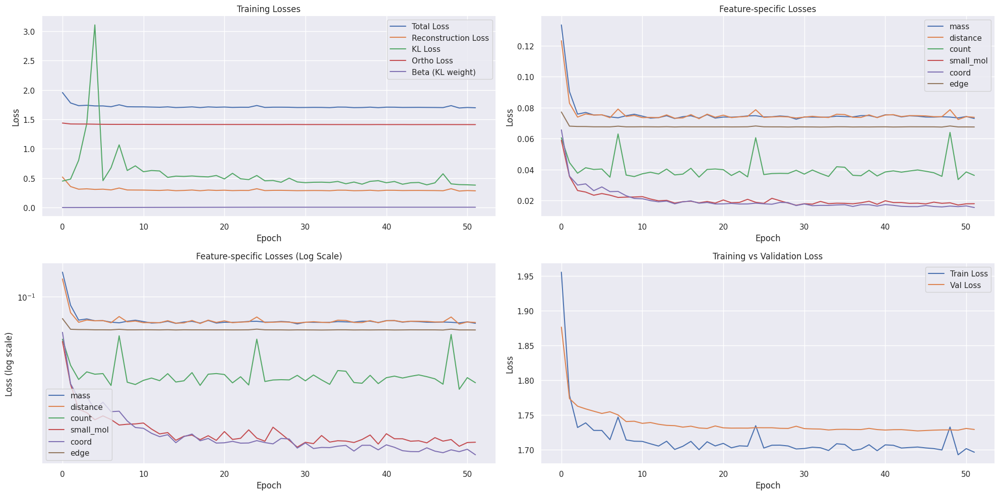

Epoch 53/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 18.65it/s, loss=1.6841, recon=0.2713, kl=0.4353, ortho=1.4106]


Detailed loss diagnostics:
Raw recon_loss: 0.4692
Raw KL loss: 0.3718
Ortho loss: 1.4094
Current beta: 0.0050
mu mean: -0.0117, std: 0.6030
logvar mean: -0.7515, std: 1.0261
mass: 0.0818
distance: 0.1062
count: 0.1612
small_mol: 0.0270
coord: 0.0199
edge: 0.0731


Epoch 53/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 18.98it/s, loss=1.6539, recon=0.2403, kl=0.4098, ortho=1.4116]


Detailed loss diagnostics:
Raw recon_loss: 0.2655
Raw KL loss: 0.4435
Ortho loss: 1.4106
Current beta: 0.0050
mu mean: -0.0273, std: 0.6765
logvar mean: -0.8389, std: 1.0883
mass: 0.0694
distance: 0.0696
count: 0.0257
small_mol: 0.0196
coord: 0.0136
edge: 0.0677


Epoch 53/100 [Train]:  57%|█████▋    | 24/42 [00:01<00:00, 19.89it/s, loss=1.6567, recon=0.2444, kl=0.3624, ortho=1.4105]


Detailed loss diagnostics:
Raw recon_loss: 0.2582
Raw KL loss: 0.2855
Ortho loss: 1.4092
Current beta: 0.0050
mu mean: 0.0448, std: 0.4928
logvar mean: -0.6477, std: 0.9698
mass: 0.0717
distance: 0.0679
count: 0.0257
small_mol: 0.0119
coord: 0.0134
edge: 0.0676


Epoch 53/100 [Train]:  76%|███████▌  | 32/42 [00:01<00:00, 19.39it/s, loss=1.7262, recon=0.3127, kl=0.4380, ortho=1.4114]


Detailed loss diagnostics:
Raw recon_loss: 0.2735
Raw KL loss: 0.4848
Ortho loss: 1.4099
Current beta: 0.0050
mu mean: -0.0040, std: 0.7336
logvar mean: -0.8034, std: 1.1660
mass: 0.0699
distance: 0.0685
count: 0.0258
small_mol: 0.0183
coord: 0.0257
edge: 0.0653


Epoch 53/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.31it/s, loss=1.7394, recon=0.3025, kl=0.4108, ortho=1.4348]



Detailed loss diagnostics:
Raw recon_loss: 0.2541
Raw KL loss: 0.3536
Ortho loss: 1.4105
Current beta: 0.0050
mu mean: -0.0412, std: 0.5541
logvar mean: -0.7512, std: 1.0914
mass: 0.0691
distance: 0.0685
count: 0.0257
small_mol: 0.0142
coord: 0.0098
edge: 0.0669

Starting validation...


Epoch 53/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 63.44it/s]



Epoch [53/100] - Time: 2.51s
Train - Total: 1.6986, Recon: 0.2858, KL: 0.3815, Ortho: 1.4109, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0731
  distance_loss: 0.0736
  count_loss: 0.0384
  small_mol_loss: 0.0171
  coord_loss: 0.0162
  edge_loss: 0.0675


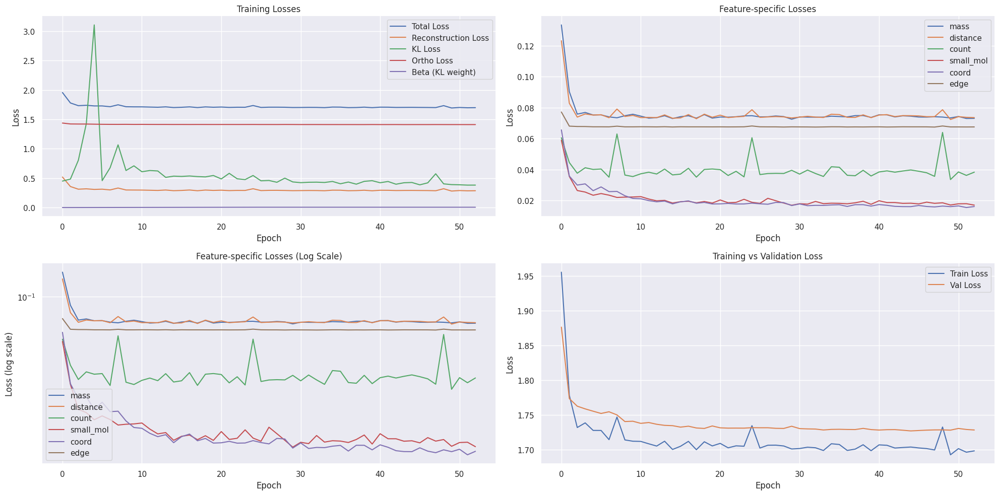

Epoch 54/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 17.92it/s, loss=1.6808, recon=0.2689, kl=0.3412, ortho=1.4102]


Detailed loss diagnostics:
Raw recon_loss: 0.3304
Raw KL loss: 0.3482
Ortho loss: 1.4118
Current beta: 0.0050
mu mean: -0.0049, std: 0.5563
logvar mean: -0.7316, std: 1.0743
mass: 0.0833
distance: 0.0964
count: 0.0391
small_mol: 0.0273
coord: 0.0147
edge: 0.0696


Epoch 54/100 [Train]:  31%|███       | 13/42 [00:00<00:01, 19.08it/s, loss=1.9455, recon=0.5335, kl=0.4366, ortho=1.4098]


Detailed loss diagnostics:
Raw recon_loss: 0.2724
Raw KL loss: 0.3599
Ortho loss: 1.4090
Current beta: 0.0050
mu mean: 0.0240, std: 0.5946
logvar mean: -0.7186, std: 1.0212
mass: 0.0745
distance: 0.0724
count: 0.0261
small_mol: 0.0185
coord: 0.0140
edge: 0.0669


Epoch 54/100 [Train]:  55%|█████▍    | 23/42 [00:01<00:00, 19.25it/s, loss=1.6843, recon=0.2719, kl=0.4072, ortho=1.4103]


Detailed loss diagnostics:
Raw recon_loss: 0.2539
Raw KL loss: 0.3537
Ortho loss: 1.4106
Current beta: 0.0050
mu mean: 0.0099, std: 0.5432
logvar mean: -0.7956, std: 1.0835
mass: 0.0703
distance: 0.0713
count: 0.0259
small_mol: 0.0082
coord: 0.0125
edge: 0.0657


Epoch 54/100 [Train]:  79%|███████▊  | 33/42 [00:01<00:00, 19.31it/s, loss=1.6901, recon=0.2797, kl=0.3260, ortho=1.4087]


Detailed loss diagnostics:
Raw recon_loss: 0.2884
Raw KL loss: 0.4253
Ortho loss: 1.4101
Current beta: 0.0050
mu mean: 0.0254, std: 0.6313
logvar mean: -0.8820, std: 1.1023
mass: 0.0823
distance: 0.0726
count: 0.0259
small_mol: 0.0260
coord: 0.0141
edge: 0.0674


Epoch 54/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.17it/s, loss=1.7166, recon=0.2892, kl=0.2534, ortho=1.4261]



Detailed loss diagnostics:
Raw recon_loss: 0.2794
Raw KL loss: 0.3781
Ortho loss: 1.4103
Current beta: 0.0050
mu mean: 0.0285, std: 0.6107
logvar mean: -0.7594, std: 1.0237
mass: 0.0742
distance: 0.0746
count: 0.0261
small_mol: 0.0281
coord: 0.0096
edge: 0.0669

Starting validation...


Epoch 54/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 64.22it/s]



Epoch [54/100] - Time: 2.53s
Train - Total: 1.7010, Recon: 0.2884, KL: 0.3891, Ortho: 1.4106, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0746
  distance_loss: 0.0748
  count_loss: 0.0383
  small_mol_loss: 0.0177
  coord_loss: 0.0156
  edge_loss: 0.0675


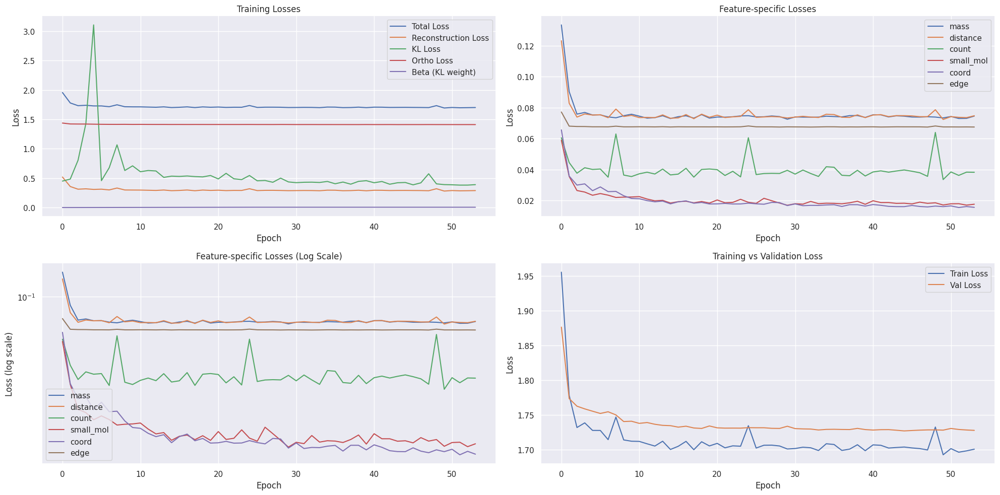

Epoch 55/100 [Train]:   5%|▍         | 2/42 [00:00<00:02, 18.04it/s, loss=1.8161, recon=0.4032, kl=0.4077, ortho=1.4109]


Detailed loss diagnostics:
Raw recon_loss: 0.2789
Raw KL loss: 0.3867
Ortho loss: 1.4115
Current beta: 0.0050
mu mean: -0.0064, std: 0.5922
logvar mean: -0.8021, std: 1.1008
mass: 0.0786
distance: 0.0777
count: 0.0264
small_mol: 0.0109
coord: 0.0181
edge: 0.0671


Epoch 55/100 [Train]:  31%|███       | 13/42 [00:00<00:01, 18.44it/s, loss=1.6655, recon=0.2520, kl=0.4305, ortho=1.4113]


Detailed loss diagnostics:
Raw recon_loss: 0.2522
Raw KL loss: 0.6233
Ortho loss: 1.4101
Current beta: 0.0050
mu mean: 0.0162, std: 0.8474
logvar mean: -0.9151, std: 1.3362
mass: 0.0646
distance: 0.0628
count: 0.0252
small_mol: 0.0119
coord: 0.0210
edge: 0.0666


Epoch 55/100 [Train]:  52%|█████▏    | 22/42 [00:01<00:01, 18.58it/s, loss=1.6911, recon=0.2783, kl=0.3297, ortho=1.4112]


Detailed loss diagnostics:
Raw recon_loss: 0.2587
Raw KL loss: 0.3643
Ortho loss: 1.4096
Current beta: 0.0050
mu mean: 0.0254, std: 0.5782
logvar mean: -0.7732, std: 1.0501
mass: 0.0697
distance: 0.0656
count: 0.0255
small_mol: 0.0176
coord: 0.0137
edge: 0.0666


Epoch 55/100 [Train]:  76%|███████▌  | 32/42 [00:01<00:00, 19.78it/s, loss=1.6766, recon=0.2640, kl=0.3293, ortho=1.4110]


Detailed loss diagnostics:
Raw recon_loss: 0.2772
Raw KL loss: 0.3048
Ortho loss: 1.4104
Current beta: 0.0050
mu mean: -0.0117, std: 0.5257
logvar mean: -0.6230, std: 1.0075
mass: 0.0780
distance: 0.0754
count: 0.0263
small_mol: 0.0189
coord: 0.0121
edge: 0.0665


Epoch 55/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.13it/s, loss=1.7545, recon=0.3264, kl=0.4410, ortho=1.4260]



Detailed loss diagnostics:
Raw recon_loss: 0.2796
Raw KL loss: 0.3882
Ortho loss: 1.4095
Current beta: 0.0050
mu mean: 0.0146, std: 0.6272
logvar mean: -0.7251, std: 1.0609
mass: 0.0614
distance: 0.0678
count: 0.0575
small_mol: 0.0100
coord: 0.0142
edge: 0.0688

Starting validation...


Epoch 55/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 65.55it/s]



Epoch [55/100] - Time: 2.53s
Train - Total: 1.6905, Recon: 0.2780, KL: 0.3894, Ortho: 1.4105, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0729
  distance_loss: 0.0723
  count_loss: 0.0326
  small_mol_loss: 0.0172
  coord_loss: 0.0155
  edge_loss: 0.0675


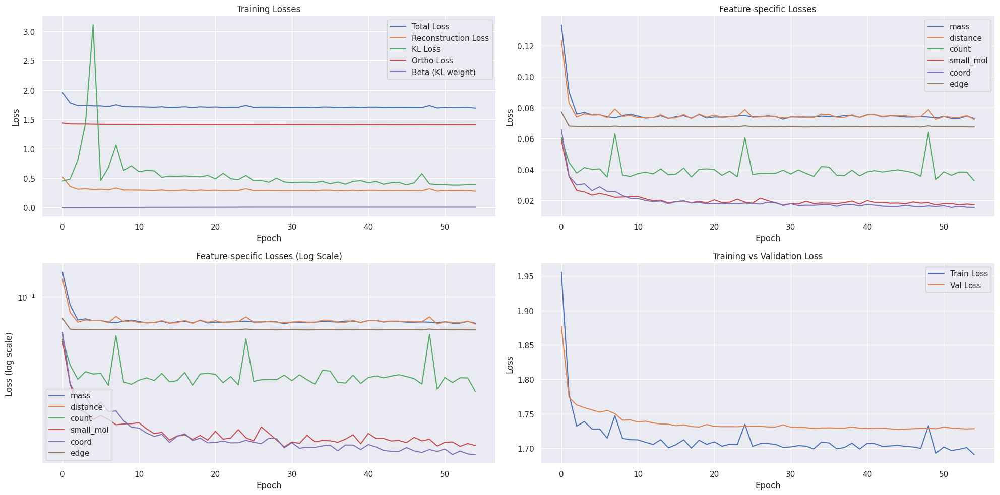

Epoch 56/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 18.27it/s, loss=1.7789, recon=0.3673, kl=0.3745, ortho=1.4098]


Detailed loss diagnostics:
Raw recon_loss: 0.2414
Raw KL loss: 0.3403
Ortho loss: 1.4100
Current beta: 0.0050
mu mean: 0.0190, std: 0.5761
logvar mean: -0.6666, std: 1.0221
mass: 0.0626
distance: 0.0603
count: 0.0251
small_mol: 0.0155
coord: 0.0105
edge: 0.0674


Epoch 56/100 [Train]:  31%|███       | 13/42 [00:00<00:01, 19.28it/s, loss=1.6600, recon=0.2493, kl=0.3340, ortho=1.4091]


Detailed loss diagnostics:
Raw recon_loss: 0.2521
Raw KL loss: 0.3085
Ortho loss: 1.4094
Current beta: 0.0050
mu mean: 0.0341, std: 0.4946
logvar mean: -0.7245, std: 1.0347
mass: 0.0700
distance: 0.0662
count: 0.0256
small_mol: 0.0107
coord: 0.0123
edge: 0.0673


Epoch 56/100 [Train]:  52%|█████▏    | 22/42 [00:01<00:01, 19.16it/s, loss=1.7218, recon=0.3104, kl=0.2950, ortho=1.4100]


Detailed loss diagnostics:
Raw recon_loss: 0.2879
Raw KL loss: 0.2829
Ortho loss: 1.4103
Current beta: 0.0050
mu mean: 0.0007, std: 0.4857
logvar mean: -0.6291, std: 1.0093
mass: 0.0777
distance: 0.0754
count: 0.0261
small_mol: 0.0263
coord: 0.0142
edge: 0.0681


Epoch 56/100 [Train]:  76%|███████▌  | 32/42 [00:01<00:00, 18.93it/s, loss=1.6867, recon=0.2762, kl=0.3225, ortho=1.4088]


Detailed loss diagnostics:
Raw recon_loss: 0.2738
Raw KL loss: 0.3386
Ortho loss: 1.4102
Current beta: 0.0050
mu mean: -0.0356, std: 0.5490
logvar mean: -0.7117, std: 1.0495
mass: 0.0788
distance: 0.0768
count: 0.0263
small_mol: 0.0137
coord: 0.0114
edge: 0.0668


Epoch 56/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.15it/s, loss=1.8040, recon=0.3684, kl=0.2229, ortho=1.4345]



Detailed loss diagnostics:
Raw recon_loss: 0.2931
Raw KL loss: 0.3836
Ortho loss: 1.4108
Current beta: 0.0050
mu mean: 0.0049, std: 0.6377
logvar mean: -0.6857, std: 1.0510
mass: 0.0793
distance: 0.0745
count: 0.0264
small_mol: 0.0260
coord: 0.0202
edge: 0.0666

Starting validation...


Epoch 56/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 64.91it/s]



Epoch [56/100] - Time: 2.53s
Train - Total: 1.6986, Recon: 0.2862, KL: 0.3519, Ortho: 1.4106, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0746
  distance_loss: 0.0738
  count_loss: 0.0366
  small_mol_loss: 0.0171
  coord_loss: 0.0164
  edge_loss: 0.0676


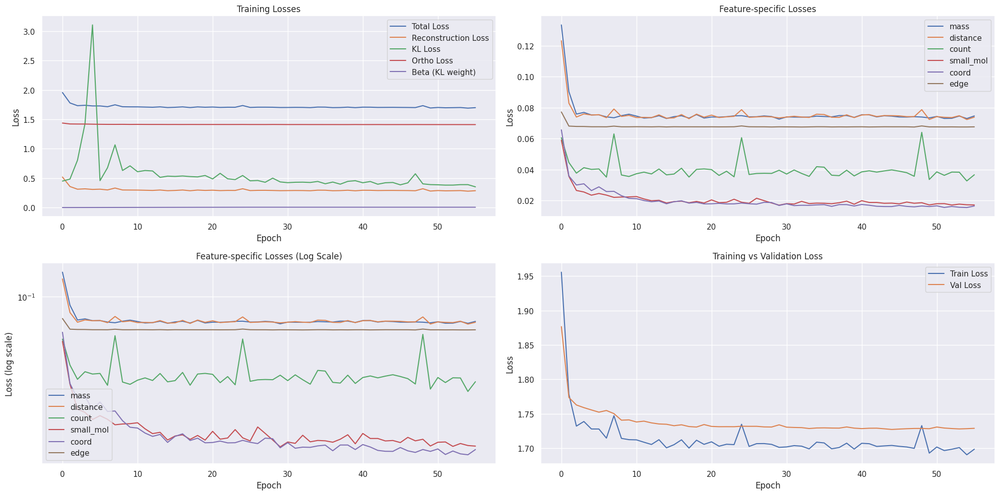

Epoch 57/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 18.40it/s, loss=1.6535, recon=0.2404, kl=0.4168, ortho=1.4110]


Detailed loss diagnostics:
Raw recon_loss: 0.2889
Raw KL loss: 0.4455
Ortho loss: 1.4093
Current beta: 0.0050
mu mean: 0.0284, std: 0.6562
logvar mean: -0.8414, std: 1.2260
mass: 0.0770
distance: 0.0773
count: 0.0262
small_mol: 0.0198
coord: 0.0213
edge: 0.0673


Epoch 57/100 [Train]:  31%|███       | 13/42 [00:00<00:01, 19.55it/s, loss=1.7490, recon=0.3365, kl=0.3644, ortho=1.4106]


Detailed loss diagnostics:
Raw recon_loss: 0.2626
Raw KL loss: 0.3444
Ortho loss: 1.4096
Current beta: 0.0050
mu mean: -0.0563, std: 0.5655
logvar mean: -0.6902, std: 1.0660
mass: 0.0724
distance: 0.0707
count: 0.0257
small_mol: 0.0147
coord: 0.0118
edge: 0.0675


Epoch 57/100 [Train]:  57%|█████▋    | 24/42 [00:01<00:00, 19.67it/s, loss=1.6675, recon=0.2551, kl=0.3014, ortho=1.4109]


Detailed loss diagnostics:
Raw recon_loss: 0.2630
Raw KL loss: 0.3092
Ortho loss: 1.4109
Current beta: 0.0050
mu mean: -0.0402, std: 0.5413
logvar mean: -0.5953, std: 1.0194
mass: 0.0712
distance: 0.0680
count: 0.0257
small_mol: 0.0179
coord: 0.0131
edge: 0.0671


Epoch 57/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 19.56it/s, loss=1.6977, recon=0.2835, kl=0.4154, ortho=1.4122]


Detailed loss diagnostics:
Raw recon_loss: 0.2922
Raw KL loss: 0.3905
Ortho loss: 1.4113
Current beta: 0.0050
mu mean: -0.0324, std: 0.6478
logvar mean: -0.6793, std: 1.0526
mass: 0.0780
distance: 0.0762
count: 0.0264
small_mol: 0.0281
coord: 0.0168
edge: 0.0668


Epoch 57/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.44it/s, loss=1.7764, recon=0.3423, kl=0.2902, ortho=1.4326]



Detailed loss diagnostics:
Raw recon_loss: 0.2510
Raw KL loss: 0.6027
Ortho loss: 1.4093
Current beta: 0.0050
mu mean: -0.0269, std: 0.7994
logvar mean: -0.9907, std: 1.3698
mass: 0.0643
distance: 0.0625
count: 0.0252
small_mol: 0.0138
coord: 0.0187
edge: 0.0665

Starting validation...


Epoch 57/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 65.08it/s]



Epoch [57/100] - Time: 2.49s
Train - Total: 1.6952, Recon: 0.2824, KL: 0.3687, Ortho: 1.4110, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0737
  distance_loss: 0.0734
  count_loss: 0.0347
  small_mol_loss: 0.0170
  coord_loss: 0.0161
  edge_loss: 0.0676


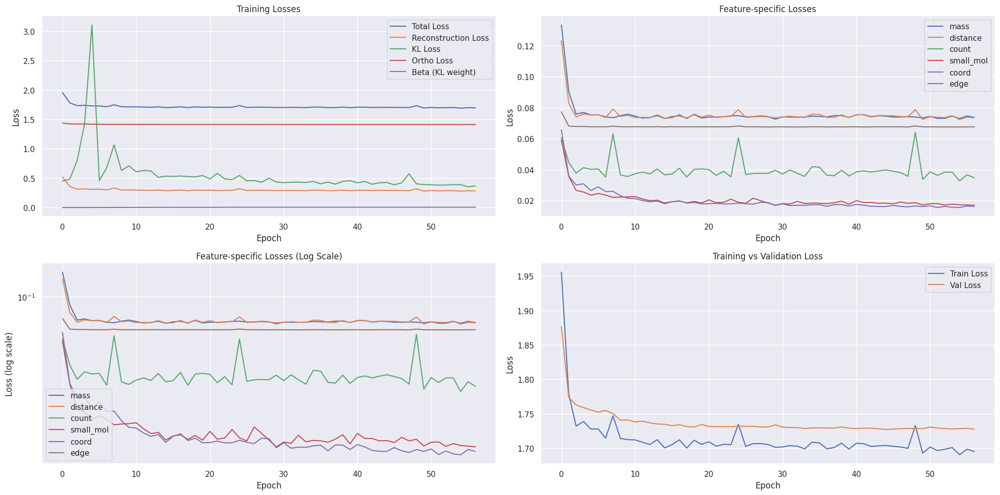

Epoch 58/100 [Train]:   5%|▍         | 2/42 [00:00<00:02, 15.03it/s, loss=1.6729, recon=0.2611, kl=0.4072, ortho=1.4098]


Detailed loss diagnostics:
Raw recon_loss: 0.2605
Raw KL loss: 0.4439
Ortho loss: 1.4105
Current beta: 0.0050
mu mean: -0.0653, std: 0.6629
logvar mean: -0.8316, std: 1.1603
mass: 0.0689
distance: 0.0677
count: 0.0257
small_mol: 0.0158
coord: 0.0152
edge: 0.0671


Epoch 58/100 [Train]:  31%|███       | 13/42 [00:00<00:01, 18.97it/s, loss=1.6850, recon=0.2729, kl=0.3939, ortho=1.4101]


Detailed loss diagnostics:
Raw recon_loss: 0.3065
Raw KL loss: 0.5128
Ortho loss: 1.4109
Current beta: 0.0050
mu mean: 0.0184, std: 0.7561
logvar mean: -0.8299, std: 1.2103
mass: 0.0787
distance: 0.0762
count: 0.0263
small_mol: 0.0130
coord: 0.0449
edge: 0.0674


Epoch 58/100 [Train]:  52%|█████▏    | 22/42 [00:01<00:01, 18.40it/s, loss=1.6669, recon=0.2544, kl=0.3877, ortho=1.4106]


Detailed loss diagnostics:
Raw recon_loss: 0.3037
Raw KL loss: 0.3121
Ortho loss: 1.4124
Current beta: 0.0050
mu mean: 0.0513, std: 0.5176
logvar mean: -0.6847, std: 1.0501
mass: 0.0831
distance: 0.0757
count: 0.0264
small_mol: 0.0280
coord: 0.0229
edge: 0.0675


Epoch 58/100 [Train]:  79%|███████▊  | 33/42 [00:01<00:00, 19.13it/s, loss=1.6928, recon=0.2816, kl=0.3685, ortho=1.4094]


Detailed loss diagnostics:
Raw recon_loss: 0.2655
Raw KL loss: 0.3790
Ortho loss: 1.4089
Current beta: 0.0050
mu mean: 0.0045, std: 0.5930
logvar mean: -0.7672, std: 1.1171
mass: 0.0704
distance: 0.0707
count: 0.0258
small_mol: 0.0155
coord: 0.0155
edge: 0.0675


Epoch 58/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.18it/s, loss=1.7624, recon=0.3313, kl=0.3584, ortho=1.4293]



Detailed loss diagnostics:
Raw recon_loss: 0.2491
Raw KL loss: 0.3237
Ortho loss: 1.4096
Current beta: 0.0050
mu mean: -0.0144, std: 0.5367
logvar mean: -0.6834, std: 1.0629
mass: 0.0680
distance: 0.0674
count: 0.0255
small_mol: 0.0121
coord: 0.0099
edge: 0.0663

Starting validation...


Epoch 58/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 66.40it/s]



Epoch [58/100] - Time: 2.51s
Train - Total: 1.7005, Recon: 0.2878, KL: 0.3993, Ortho: 1.4107, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0743
  distance_loss: 0.0747
  count_loss: 0.0380
  small_mol_loss: 0.0171
  coord_loss: 0.0162
  edge_loss: 0.0675


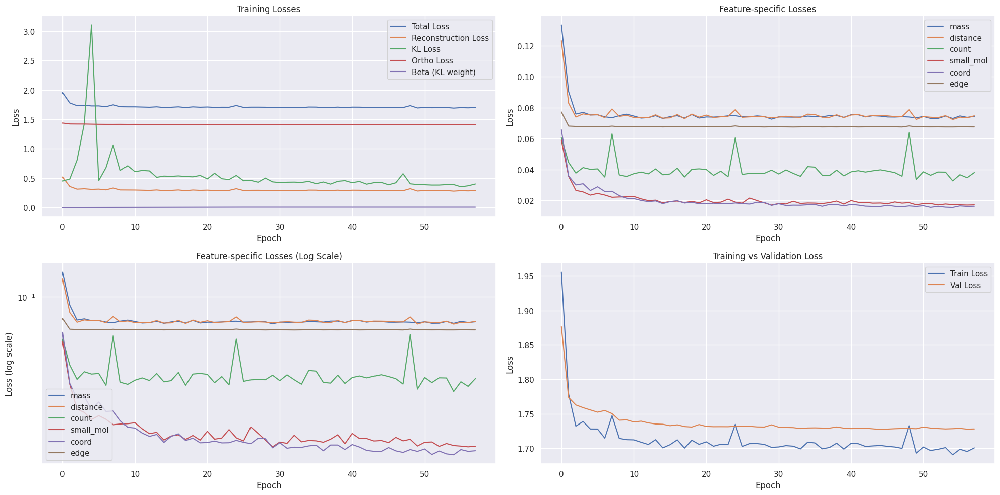

Epoch 59/100 [Train]:  10%|▉         | 4/42 [00:00<00:01, 19.06it/s, loss=1.7061, recon=0.2951, kl=0.4556, ortho=1.4087]


Detailed loss diagnostics:
Raw recon_loss: 0.2634
Raw KL loss: 0.3232
Ortho loss: 1.4105
Current beta: 0.0050
mu mean: 0.0173, std: 0.5543
logvar mean: -0.6492, std: 1.0392
mass: 0.0711
distance: 0.0690
count: 0.0257
small_mol: 0.0197
coord: 0.0104
edge: 0.0674


Epoch 59/100 [Train]:  29%|██▊       | 12/42 [00:00<00:01, 18.45it/s, loss=1.6751, recon=0.2642, kl=0.3037, ortho=1.4094]


Detailed loss diagnostics:
Raw recon_loss: 0.2455
Raw KL loss: 0.4594
Ortho loss: 1.4095
Current beta: 0.0050
mu mean: -0.0212, std: 0.6877
logvar mean: -0.8218, std: 1.1940
mass: 0.0651
distance: 0.0650
count: 0.0254
small_mol: 0.0088
coord: 0.0138
edge: 0.0673


Epoch 59/100 [Train]:  57%|█████▋    | 24/42 [00:01<00:00, 18.72it/s, loss=1.6503, recon=0.2386, kl=0.4106, ortho=1.4096]


Detailed loss diagnostics:
Raw recon_loss: 0.3515
Raw KL loss: 0.3697
Ortho loss: 1.4110
Current beta: 0.0050
mu mean: 0.0377, std: 0.5681
logvar mean: -0.7972, std: 1.1238
mass: 0.0923
distance: 0.0864
count: 0.0271
small_mol: 0.0442
coord: 0.0342
edge: 0.0673


Epoch 59/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 18.35it/s, loss=1.7022, recon=0.2905, kl=0.3783, ortho=1.4098]


Detailed loss diagnostics:
Raw recon_loss: 0.2917
Raw KL loss: 0.3639
Ortho loss: 1.4096
Current beta: 0.0050
mu mean: -0.0423, std: 0.5811
logvar mean: -0.7244, std: 1.1115
mass: 0.0814
distance: 0.0769
count: 0.0265
small_mol: 0.0215
coord: 0.0181
edge: 0.0674


Epoch 59/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 18.89it/s, loss=1.7701, recon=0.3431, kl=0.2855, ortho=1.4256]



Detailed loss diagnostics:
Raw recon_loss: 0.2936
Raw KL loss: 0.3147
Ortho loss: 1.4095
Current beta: 0.0050
mu mean: -0.0042, std: 0.5110
logvar mean: -0.6814, std: 1.0890
mass: 0.0840
distance: 0.0771
count: 0.0267
small_mol: 0.0228
coord: 0.0165
edge: 0.0665

Starting validation...


Epoch 59/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 65.71it/s]



Epoch [59/100] - Time: 2.55s
Train - Total: 1.7027, Recon: 0.2903, KL: 0.3785, Ortho: 1.4105, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0749
  distance_loss: 0.0748
  count_loss: 0.0380
  small_mol_loss: 0.0188
  coord_loss: 0.0163
  edge_loss: 0.0674


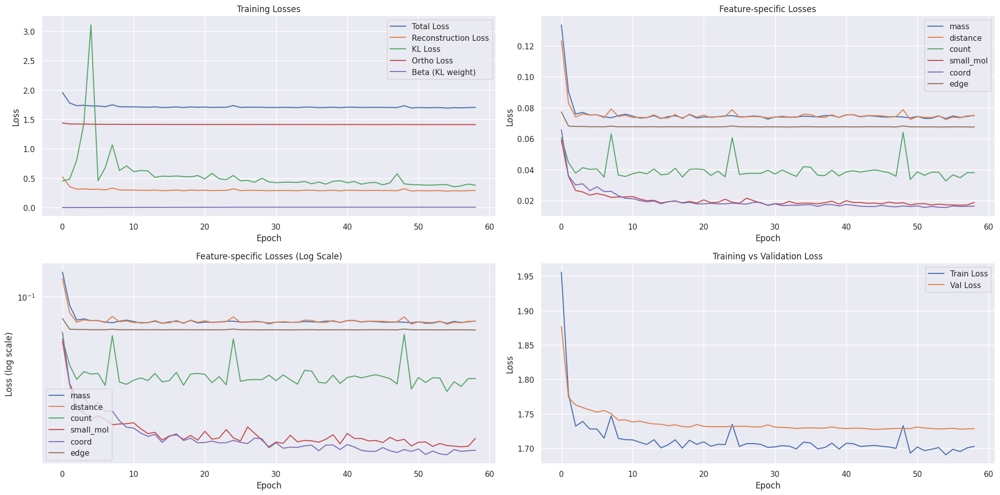

Epoch 60/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 17.89it/s, loss=1.7156, recon=0.3034, kl=0.3591, ortho=1.4105]


Detailed loss diagnostics:
Raw recon_loss: 0.2651
Raw KL loss: 0.3242
Ortho loss: 1.4108
Current beta: 0.0050
mu mean: 0.0020, std: 0.5247
logvar mean: -0.7149, std: 1.0725
mass: 0.0744
distance: 0.0710
count: 0.0260
small_mol: 0.0127
coord: 0.0133
edge: 0.0677


Epoch 60/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 18.94it/s, loss=1.6759, recon=0.2650, kl=0.4056, ortho=1.4089]


Detailed loss diagnostics:
Raw recon_loss: 0.2342
Raw KL loss: 0.3507
Ortho loss: 1.4090
Current beta: 0.0050
mu mean: -0.0424, std: 0.5346
logvar mean: -0.7678, std: 1.1538
mass: 0.0594
distance: 0.0591
count: 0.0249
small_mol: 0.0095
coord: 0.0138
edge: 0.0674


Epoch 60/100 [Train]:  55%|█████▍    | 23/42 [00:01<00:00, 19.83it/s, loss=1.6723, recon=0.2614, kl=0.3394, ortho=1.4092]


Detailed loss diagnostics:
Raw recon_loss: 0.2660
Raw KL loss: 0.3168
Ortho loss: 1.4098
Current beta: 0.0050
mu mean: 0.0231, std: 0.4924
logvar mean: -0.7216, std: 1.1214
mass: 0.0742
distance: 0.0708
count: 0.0259
small_mol: 0.0143
coord: 0.0130
edge: 0.0677


Epoch 60/100 [Train]:  76%|███████▌  | 32/42 [00:01<00:00, 19.96it/s, loss=1.6805, recon=0.2693, kl=0.3038, ortho=1.4097]


Detailed loss diagnostics:
Raw recon_loss: 0.2383
Raw KL loss: 0.3893
Ortho loss: 1.4117
Current beta: 0.0050
mu mean: 0.0287, std: 0.6228
logvar mean: -0.7347, std: 1.1149
mass: 0.0618
distance: 0.0600
count: 0.0250
small_mol: 0.0143
coord: 0.0102
edge: 0.0670


Epoch 60/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.66it/s, loss=1.7585, recon=0.3215, kl=0.3813, ortho=1.4352]



Detailed loss diagnostics:
Raw recon_loss: 0.2348
Raw KL loss: 0.3928
Ortho loss: 1.4091
Current beta: 0.0050
mu mean: -0.0011, std: 0.6510
logvar mean: -0.6582, std: 1.0849
mass: 0.0609
distance: 0.0604
count: 0.0250
small_mol: 0.0102
coord: 0.0118
edge: 0.0665

Starting validation...


Epoch 60/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 67.56it/s]



Epoch [60/100] - Time: 2.46s
Train - Total: 1.6956, Recon: 0.2831, KL: 0.3758, Ortho: 1.4106, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0724
  distance_loss: 0.0726
  count_loss: 0.0380
  small_mol_loss: 0.0167
  coord_loss: 0.0158
  edge_loss: 0.0676


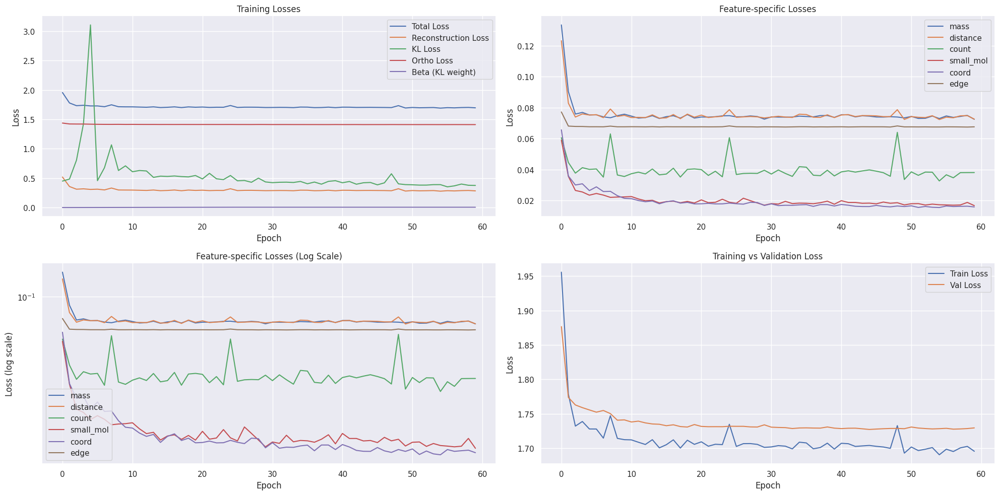

Epoch 61/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 17.92it/s, loss=1.7163, recon=0.3037, kl=0.3924, ortho=1.4106]


Detailed loss diagnostics:
Raw recon_loss: 0.2727
Raw KL loss: 0.2823
Ortho loss: 1.4103
Current beta: 0.0050
mu mean: 0.0108, std: 0.4954
logvar mean: -0.5863, std: 1.0116
mass: 0.0773
distance: 0.0750
count: 0.0263
small_mol: 0.0154
coord: 0.0118
edge: 0.0669


Epoch 61/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 18.23it/s, loss=1.6818, recon=0.2693, kl=0.4410, ortho=1.4103]


Detailed loss diagnostics:
Raw recon_loss: 0.2561
Raw KL loss: 0.5710
Ortho loss: 1.4101
Current beta: 0.0050
mu mean: 0.0500, std: 0.7916
logvar mean: -0.9391, std: 1.2598
mass: 0.0674
distance: 0.0656
count: 0.0255
small_mol: 0.0140
coord: 0.0169
edge: 0.0667


Epoch 61/100 [Train]:  55%|█████▍    | 23/42 [00:01<00:01, 18.78it/s, loss=1.6848, recon=0.2730, kl=0.3533, ortho=1.4100]


Detailed loss diagnostics:
Raw recon_loss: 0.4448
Raw KL loss: 0.3582
Ortho loss: 1.4097
Current beta: 0.0050
mu mean: -0.0117, std: 0.5475
logvar mean: -0.7725, std: 1.1425
mass: 0.0814
distance: 0.1086
count: 0.1558
small_mol: 0.0168
coord: 0.0122
edge: 0.0700


Epoch 61/100 [Train]:  79%|███████▊  | 33/42 [00:01<00:00, 18.04it/s, loss=1.6712, recon=0.2592, kl=0.3247, ortho=1.4104]


Detailed loss diagnostics:
Raw recon_loss: 0.2922
Raw KL loss: 0.3031
Ortho loss: 1.4099
Current beta: 0.0050
mu mean: 0.0075, std: 0.4991
logvar mean: -0.6780, std: 1.0557
mass: 0.0812
distance: 0.0758
count: 0.0264
small_mol: 0.0222
coord: 0.0196
edge: 0.0671


Epoch 61/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 18.63it/s, loss=1.7328, recon=0.3056, kl=0.2371, ortho=1.4260]



Detailed loss diagnostics:
Raw recon_loss: 0.2609
Raw KL loss: 0.2846
Ortho loss: 1.4094
Current beta: 0.0050
mu mean: -0.0203, std: 0.4848
logvar mean: -0.6151, std: 1.0402
mass: 0.0729
distance: 0.0719
count: 0.0260
small_mol: 0.0132
coord: 0.0102
edge: 0.0667

Starting validation...


Epoch 61/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 65.43it/s]



Epoch [61/100] - Time: 2.58s
Train - Total: 1.6993, Recon: 0.2870, KL: 0.3743, Ortho: 1.4103, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0733
  distance_loss: 0.0740
  count_loss: 0.0397
  small_mol_loss: 0.0171
  coord_loss: 0.0154
  edge_loss: 0.0675


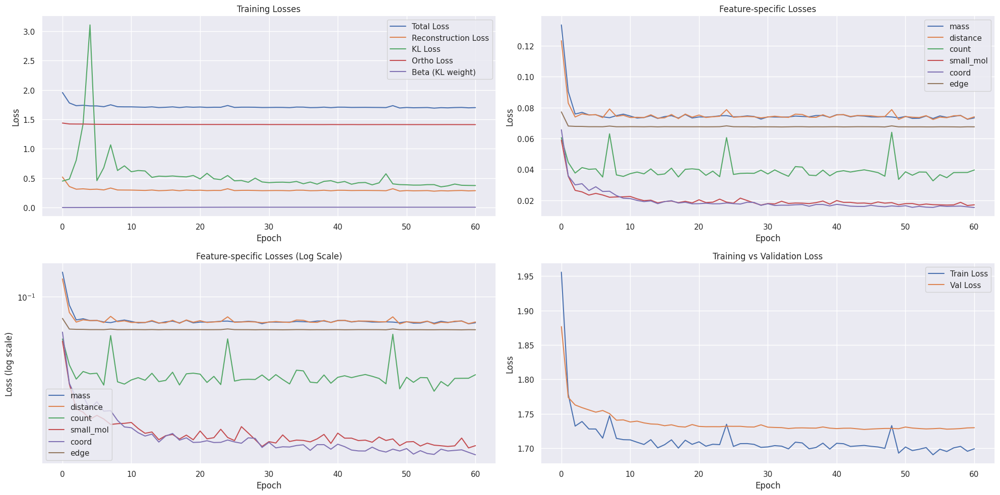

Epoch 62/100 [Train]:  10%|▉         | 4/42 [00:00<00:01, 19.55it/s, loss=1.6999, recon=0.2864, kl=0.6533, ortho=1.4102]


Detailed loss diagnostics:
Raw recon_loss: 0.2932
Raw KL loss: 0.5906
Ortho loss: 1.4105
Current beta: 0.0050
mu mean: 0.0060, std: 0.8267
logvar mean: -0.8813, std: 1.3122
mass: 0.0769
distance: 0.0751
count: 0.0261
small_mol: 0.0243
coord: 0.0235
edge: 0.0673


Epoch 62/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 19.04it/s, loss=1.6474, recon=0.2351, kl=0.3639, ortho=1.4105]


Detailed loss diagnostics:
Raw recon_loss: 0.2685
Raw KL loss: 0.3395
Ortho loss: 1.4097
Current beta: 0.0050
mu mean: -0.0001, std: 0.5283
logvar mean: -0.7559, std: 1.1237
mass: 0.0743
distance: 0.0725
count: 0.0261
small_mol: 0.0153
coord: 0.0133
edge: 0.0670


Epoch 62/100 [Train]:  55%|█████▍    | 23/42 [00:01<00:01, 18.98it/s, loss=1.6759, recon=0.2655, kl=0.3668, ortho=1.4085]


Detailed loss diagnostics:
Raw recon_loss: 0.2837
Raw KL loss: 0.3426
Ortho loss: 1.4089
Current beta: 0.0050
mu mean: -0.0029, std: 0.5680
logvar mean: -0.6830, std: 1.0599
mass: 0.0782
distance: 0.0758
count: 0.0265
small_mol: 0.0239
coord: 0.0130
edge: 0.0664


Epoch 62/100 [Train]:  76%|███████▌  | 32/42 [00:01<00:00, 18.90it/s, loss=1.7325, recon=0.3214, kl=0.3048, ortho=1.4096]


Detailed loss diagnostics:
Raw recon_loss: 0.3011
Raw KL loss: 0.3350
Ortho loss: 1.4097
Current beta: 0.0050
mu mean: 0.0058, std: 0.5477
logvar mean: -0.7064, std: 1.0632
mass: 0.0651
distance: 0.0725
count: 0.0719
small_mol: 0.0084
coord: 0.0126
edge: 0.0706


Epoch 62/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.20it/s, loss=1.8089, recon=0.3784, kl=0.3144, ortho=1.4290]



Detailed loss diagnostics:
Raw recon_loss: 0.2686
Raw KL loss: 0.2988
Ortho loss: 1.4096
Current beta: 0.0050
mu mean: 0.0099, std: 0.5215
logvar mean: -0.6234, std: 1.0066
mass: 0.0724
distance: 0.0685
count: 0.0258
small_mol: 0.0194
coord: 0.0144
edge: 0.0681

Starting validation...


Epoch 62/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 65.66it/s]



Epoch [62/100] - Time: 2.52s
Train - Total: 1.6974, Recon: 0.2852, KL: 0.3707, Ortho: 1.4103, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0741
  distance_loss: 0.0743
  count_loss: 0.0371
  small_mol_loss: 0.0169
  coord_loss: 0.0153
  edge_loss: 0.0675


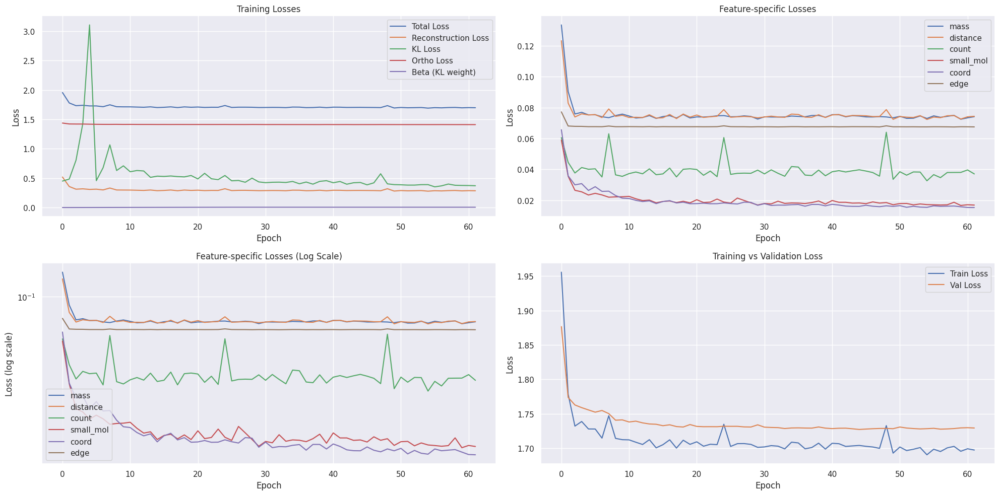

Epoch 63/100 [Train]:   5%|▍         | 2/42 [00:00<00:02, 16.25it/s, loss=1.6909, recon=0.2779, kl=0.3550, ortho=1.4112]


Detailed loss diagnostics:
Raw recon_loss: 0.2457
Raw KL loss: 0.3448
Ortho loss: 1.4106
Current beta: 0.0050
mu mean: -0.0110, std: 0.5649
logvar mean: -0.6905, std: 1.0817
mass: 0.0631
distance: 0.0652
count: 0.0285
small_mol: 0.0129
coord: 0.0088
edge: 0.0673


Epoch 63/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 18.84it/s, loss=1.6419, recon=0.2298, kl=0.4437, ortho=1.4099]


Detailed loss diagnostics:
Raw recon_loss: 0.4869
Raw KL loss: 0.3545
Ortho loss: 1.4104
Current beta: 0.0050
mu mean: -0.0166, std: 0.5491
logvar mean: -0.7712, std: 1.1179
mass: 0.0887
distance: 0.1168
count: 0.1774
small_mol: 0.0186
coord: 0.0161
edge: 0.0693


Epoch 63/100 [Train]:  52%|█████▏    | 22/42 [00:01<00:01, 19.15it/s, loss=1.7143, recon=0.3025, kl=0.4452, ortho=1.4096]


Detailed loss diagnostics:
Raw recon_loss: 0.2377
Raw KL loss: 0.3150
Ortho loss: 1.4106
Current beta: 0.0050
mu mean: -0.0295, std: 0.4780
logvar mean: -0.7678, std: 1.1132
mass: 0.0653
distance: 0.0615
count: 0.0252
small_mol: 0.0092
coord: 0.0107
edge: 0.0659


Epoch 63/100 [Train]:  76%|███████▌  | 32/42 [00:01<00:00, 19.38it/s, loss=1.6656, recon=0.2540, kl=0.4288, ortho=1.4095]


Detailed loss diagnostics:
Raw recon_loss: 0.2712
Raw KL loss: 0.3017
Ortho loss: 1.4089
Current beta: 0.0050
mu mean: -0.0027, std: 0.4878
logvar mean: -0.7000, std: 1.0766
mass: 0.0810
distance: 0.0718
count: 0.0260
small_mol: 0.0148
coord: 0.0108
edge: 0.0668


Epoch 63/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.08it/s, loss=1.7375, recon=0.3099, kl=0.2827, ortho=1.4262]



Detailed loss diagnostics:
Raw recon_loss: 0.2672
Raw KL loss: 0.3157
Ortho loss: 1.4088
Current beta: 0.0050
mu mean: 0.0266, std: 0.5273
logvar mean: -0.6678, std: 1.0624
mass: 0.0723
distance: 0.0692
count: 0.0257
small_mol: 0.0181
coord: 0.0141
edge: 0.0679

Starting validation...


Epoch 63/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 65.79it/s]



Epoch [63/100] - Time: 2.53s
Train - Total: 1.7017, Recon: 0.2893, KL: 0.3803, Ortho: 1.4104, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0740
  distance_loss: 0.0745
  count_loss: 0.0396
  small_mol_loss: 0.0180
  coord_loss: 0.0156
  edge_loss: 0.0676


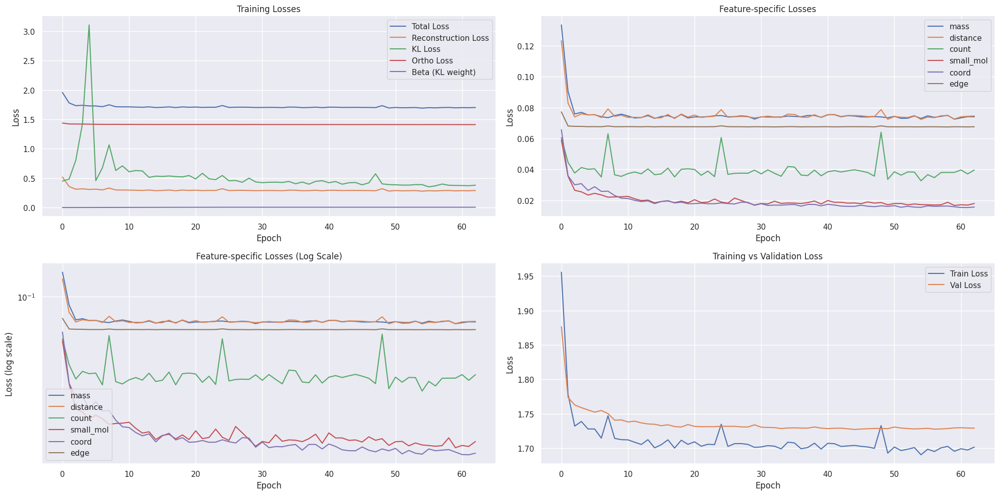

Epoch 64/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 17.97it/s, loss=1.7056, recon=0.2941, kl=0.3788, ortho=1.4096]


Detailed loss diagnostics:
Raw recon_loss: 0.2698
Raw KL loss: 0.3717
Ortho loss: 1.4110
Current beta: 0.0050
mu mean: -0.0049, std: 0.6067
logvar mean: -0.7157, std: 1.0731
mass: 0.0745
distance: 0.0721
count: 0.0260
small_mol: 0.0107
coord: 0.0195
edge: 0.0670


Epoch 64/100 [Train]:  31%|███       | 13/42 [00:00<00:01, 18.80it/s, loss=1.6791, recon=0.2670, kl=0.3952, ortho=1.4101]


Detailed loss diagnostics:
Raw recon_loss: 0.2467
Raw KL loss: 0.4047
Ortho loss: 1.4092
Current beta: 0.0050
mu mean: -0.0155, std: 0.6394
logvar mean: -0.7303, std: 1.1413
mass: 0.0638
distance: 0.0634
count: 0.0252
small_mol: 0.0144
coord: 0.0123
edge: 0.0677


Epoch 64/100 [Train]:  55%|█████▍    | 23/42 [00:01<00:01, 18.42it/s, loss=1.6600, recon=0.2491, kl=0.4253, ortho=1.4088]


Detailed loss diagnostics:
Raw recon_loss: 0.2756
Raw KL loss: 0.3176
Ortho loss: 1.4091
Current beta: 0.0050
mu mean: -0.0340, std: 0.5338
logvar mean: -0.6470, std: 1.0770
mass: 0.0780
distance: 0.0713
count: 0.0261
small_mol: 0.0175
coord: 0.0151
edge: 0.0677


Epoch 64/100 [Train]:  76%|███████▌  | 32/42 [00:01<00:00, 18.58it/s, loss=1.7922, recon=0.3810, kl=0.3253, ortho=1.4096]


Detailed loss diagnostics:
Raw recon_loss: 0.2518
Raw KL loss: 0.3289
Ortho loss: 1.4086
Current beta: 0.0050
mu mean: -0.0002, std: 0.5525
logvar mean: -0.6451, std: 1.0840
mass: 0.0695
distance: 0.0643
count: 0.0254
small_mol: 0.0145
coord: 0.0120
edge: 0.0661


Epoch 64/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 18.65it/s, loss=1.7355, recon=0.3030, kl=0.3831, ortho=1.4306]



Detailed loss diagnostics:
Raw recon_loss: 0.4084
Raw KL loss: 0.3365
Ortho loss: 1.4097
Current beta: 0.0050
mu mean: 0.0166, std: 0.5398
logvar mean: -0.6964, std: 1.1281
mass: 0.0766
distance: 0.0925
count: 0.1336
small_mol: 0.0217
coord: 0.0116
edge: 0.0724

Starting validation...


Epoch 64/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 65.39it/s]



Epoch [64/100] - Time: 2.58s
Train - Total: 1.6988, Recon: 0.2866, KL: 0.3825, Ortho: 1.4102, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0734
  distance_loss: 0.0739
  count_loss: 0.0390
  small_mol_loss: 0.0168
  coord_loss: 0.0160
  edge_loss: 0.0676


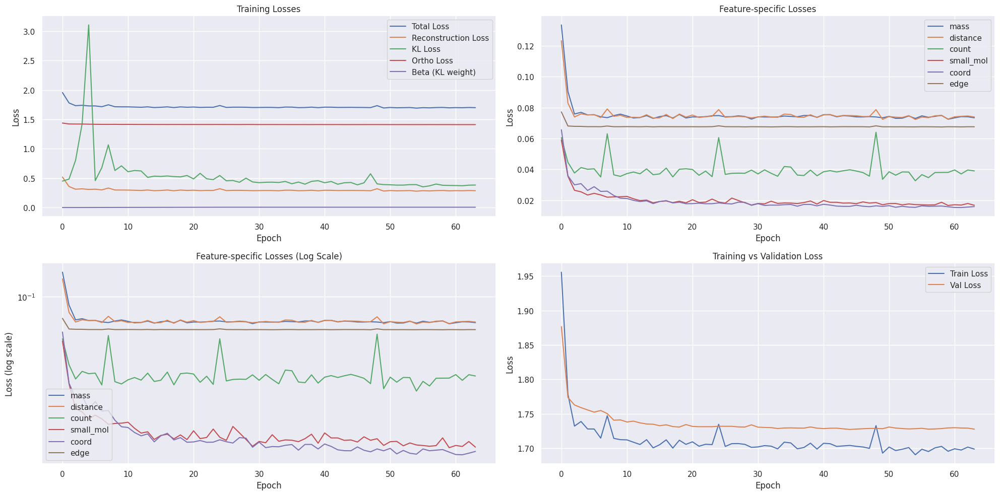

Epoch 65/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 18.54it/s, loss=1.7343, recon=0.3226, kl=0.3580, ortho=1.4099]


Detailed loss diagnostics:
Raw recon_loss: 0.2735
Raw KL loss: 0.3985
Ortho loss: 1.4103
Current beta: 0.0050
mu mean: -0.0340, std: 0.6383
logvar mean: -0.7200, std: 1.1391
mass: 0.0743
distance: 0.0705
count: 0.0259
small_mol: 0.0141
coord: 0.0206
edge: 0.0683


Epoch 65/100 [Train]:  29%|██▊       | 12/42 [00:00<00:01, 18.62it/s, loss=1.6797, recon=0.2678, kl=0.3005, ortho=1.4104]


Detailed loss diagnostics:
Raw recon_loss: 0.2953
Raw KL loss: 0.3327
Ortho loss: 1.4093
Current beta: 0.0050
mu mean: -0.0028, std: 0.5289
logvar mean: -0.7141, std: 1.1175
mass: 0.0804
distance: 0.0764
count: 0.0264
small_mol: 0.0247
coord: 0.0198
edge: 0.0675


Epoch 65/100 [Train]:  57%|█████▋    | 24/42 [00:01<00:00, 20.17it/s, loss=1.8138, recon=0.4017, kl=0.3550, ortho=1.4103]


Detailed loss diagnostics:
Raw recon_loss: 0.2920
Raw KL loss: 0.4307
Ortho loss: 1.4086
Current beta: 0.0050
mu mean: 0.0167, std: 0.6543
logvar mean: -0.8073, std: 1.1772
mass: 0.0815
distance: 0.0809
count: 0.0267
small_mol: 0.0184
coord: 0.0171
edge: 0.0673


Epoch 65/100 [Train]:  76%|███████▌  | 32/42 [00:01<00:00, 20.07it/s, loss=1.6570, recon=0.2454, kl=0.4076, ortho=1.4096]


Detailed loss diagnostics:
Raw recon_loss: 0.2840
Raw KL loss: 0.3948
Ortho loss: 1.4105
Current beta: 0.0050
mu mean: -0.0142, std: 0.6111
logvar mean: -0.7665, std: 1.1872
mass: 0.0795
distance: 0.0785
count: 0.0265
small_mol: 0.0164
coord: 0.0162
edge: 0.0670


Epoch 65/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.43it/s, loss=1.8278, recon=0.3996, kl=0.3059, ortho=1.4267]



Detailed loss diagnostics:
Raw recon_loss: 0.2774
Raw KL loss: 0.4158
Ortho loss: 1.4097
Current beta: 0.0050
mu mean: -0.0130, std: 0.6306
logvar mean: -0.7673, std: 1.2577
mass: 0.0745
distance: 0.0750
count: 0.0262
small_mol: 0.0173
coord: 0.0181
edge: 0.0664

Starting validation...


Epoch 65/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 66.62it/s]



Epoch [65/100] - Time: 2.49s
Train - Total: 1.7011, Recon: 0.2892, KL: 0.3910, Ortho: 1.4100, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0751
  distance_loss: 0.0759
  count_loss: 0.0370
  small_mol_loss: 0.0180
  coord_loss: 0.0157
  edge_loss: 0.0675


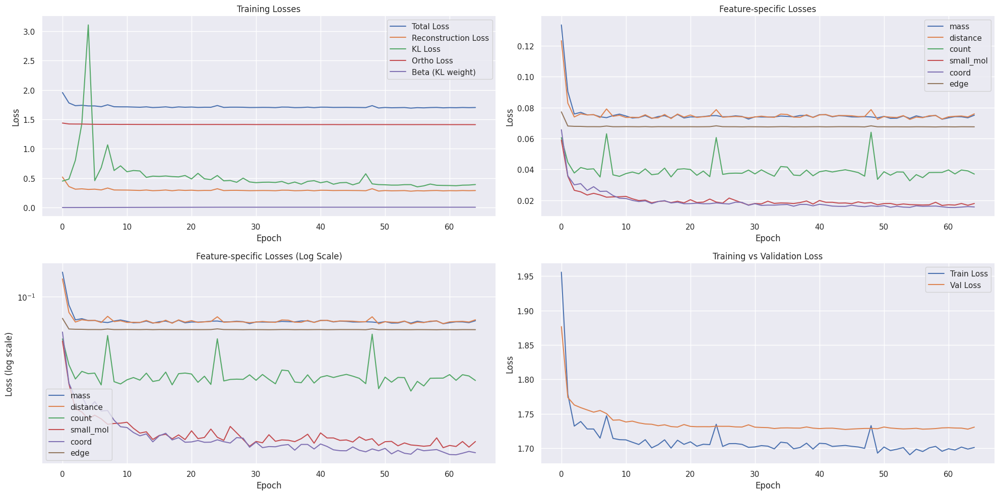

Epoch 66/100 [Train]:   5%|▍         | 2/42 [00:00<00:02, 15.85it/s, loss=1.6882, recon=0.2762, kl=0.3242, ortho=1.4105]


Detailed loss diagnostics:
Raw recon_loss: 0.2473
Raw KL loss: 0.3922
Ortho loss: 1.4089
Current beta: 0.0050
mu mean: 0.0145, std: 0.6094
logvar mean: -0.7647, std: 1.1563
mass: 0.0631
distance: 0.0653
count: 0.0285
small_mol: 0.0078
coord: 0.0147
edge: 0.0679


Epoch 66/100 [Train]:  29%|██▊       | 12/42 [00:00<00:01, 19.24it/s, loss=1.6865, recon=0.2733, kl=0.3049, ortho=1.4117]


Detailed loss diagnostics:
Raw recon_loss: 0.2449
Raw KL loss: 0.3302
Ortho loss: 1.4094
Current beta: 0.0050
mu mean: 0.0141, std: 0.5449
logvar mean: -0.6611, std: 1.1070
mass: 0.0618
distance: 0.0615
count: 0.0251
small_mol: 0.0180
coord: 0.0113
edge: 0.0672


Epoch 66/100 [Train]:  55%|█████▍    | 23/42 [00:01<00:01, 18.66it/s, loss=1.6839, recon=0.2725, kl=0.3230, ortho=1.4098]


Detailed loss diagnostics:
Raw recon_loss: 0.2607
Raw KL loss: 0.4902
Ortho loss: 1.4091
Current beta: 0.0050
mu mean: -0.0426, std: 0.7409
logvar mean: -0.7535, std: 1.2414
mass: 0.0714
distance: 0.0646
count: 0.0254
small_mol: 0.0155
coord: 0.0175
edge: 0.0664


Epoch 66/100 [Train]:  79%|███████▊  | 33/42 [00:01<00:00, 19.73it/s, loss=1.6846, recon=0.2716, kl=0.3610, ortho=1.4112]


Detailed loss diagnostics:
Raw recon_loss: 0.2882
Raw KL loss: 0.3325
Ortho loss: 1.4101
Current beta: 0.0050
mu mean: 0.0569, std: 0.5435
logvar mean: -0.6793, std: 1.1051
mass: 0.0782
distance: 0.0712
count: 0.0260
small_mol: 0.0302
coord: 0.0149
edge: 0.0677


Epoch 66/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.33it/s, loss=1.7449, recon=0.3179, kl=0.2754, ortho=1.4256]



Detailed loss diagnostics:
Raw recon_loss: 0.2779
Raw KL loss: 0.3812
Ortho loss: 1.4101
Current beta: 0.0050
mu mean: 0.0513, std: 0.5723
logvar mean: -0.8014, std: 1.1836
mass: 0.0751
distance: 0.0747
count: 0.0260
small_mol: 0.0245
coord: 0.0109
edge: 0.0668

Starting validation...


Epoch 66/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 65.78it/s]



Epoch [66/100] - Time: 2.50s
Train - Total: 1.6973, Recon: 0.2856, KL: 0.3491, Ortho: 1.4100, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0730
  distance_loss: 0.0733
  count_loss: 0.0392
  small_mol_loss: 0.0173
  coord_loss: 0.0152
  edge_loss: 0.0675


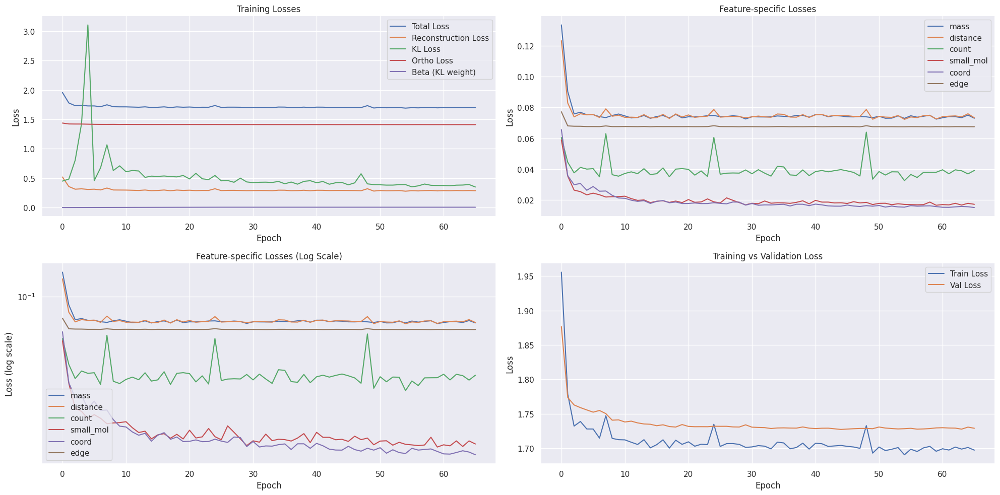

Epoch 67/100 [Train]:   5%|▍         | 2/42 [00:00<00:02, 16.70it/s, loss=1.7891, recon=0.3766, kl=0.4325, ortho=1.4103]


Detailed loss diagnostics:
Raw recon_loss: 0.2490
Raw KL loss: 0.5078
Ortho loss: 1.4097
Current beta: 0.0050
mu mean: 0.0055, std: 0.7245
logvar mean: -0.8903, std: 1.2767
mass: 0.0652
distance: 0.0622
count: 0.0252
small_mol: 0.0093
coord: 0.0200
edge: 0.0670


Epoch 67/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 18.86it/s, loss=1.8864, recon=0.4750, kl=0.3810, ortho=1.4095]


Detailed loss diagnostics:
Raw recon_loss: 0.2323
Raw KL loss: 0.3545
Ortho loss: 1.4085
Current beta: 0.0050
mu mean: 0.0057, std: 0.5584
logvar mean: -0.7266, std: 1.1509
mass: 0.0595
distance: 0.0577
count: 0.0248
small_mol: 0.0119
coord: 0.0110
edge: 0.0674


Epoch 67/100 [Train]:  57%|█████▋    | 24/42 [00:01<00:00, 18.69it/s, loss=1.7136, recon=0.3009, kl=0.3909, ortho=1.4107]


Detailed loss diagnostics:
Raw recon_loss: 0.2840
Raw KL loss: 0.3742
Ortho loss: 1.4088
Current beta: 0.0050
mu mean: 0.0429, std: 0.5958
logvar mean: -0.7123, std: 1.1512
mass: 0.0772
distance: 0.0739
count: 0.0262
small_mol: 0.0230
coord: 0.0162
edge: 0.0675


Epoch 67/100 [Train]:  79%|███████▊  | 33/42 [00:01<00:00, 19.48it/s, loss=1.6944, recon=0.2830, kl=0.3577, ortho=1.4097]


Detailed loss diagnostics:
Raw recon_loss: 0.2563
Raw KL loss: 0.3798
Ortho loss: 1.4100
Current beta: 0.0050
mu mean: 0.0224, std: 0.5765
logvar mean: -0.7920, std: 1.1918
mass: 0.0676
distance: 0.0668
count: 0.0256
small_mol: 0.0160
coord: 0.0129
edge: 0.0674


Epoch 67/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.24it/s, loss=1.8059, recon=0.3789, kl=0.2808, ortho=1.4256]



Detailed loss diagnostics:
Raw recon_loss: 0.2959
Raw KL loss: 0.3800
Ortho loss: 1.4108
Current beta: 0.0050
mu mean: 0.0240, std: 0.5372
logvar mean: -0.8802, std: 1.2249
mass: 0.0874
distance: 0.0771
count: 0.0263
small_mol: 0.0225
coord: 0.0163
edge: 0.0663

Starting validation...


Epoch 67/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 63.35it/s]



Epoch [67/100] - Time: 2.52s
Train - Total: 1.7026, Recon: 0.2905, KL: 0.3818, Ortho: 1.4102, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0750
  distance_loss: 0.0751
  count_loss: 0.0390
  small_mol_loss: 0.0180
  coord_loss: 0.0158
  edge_loss: 0.0676


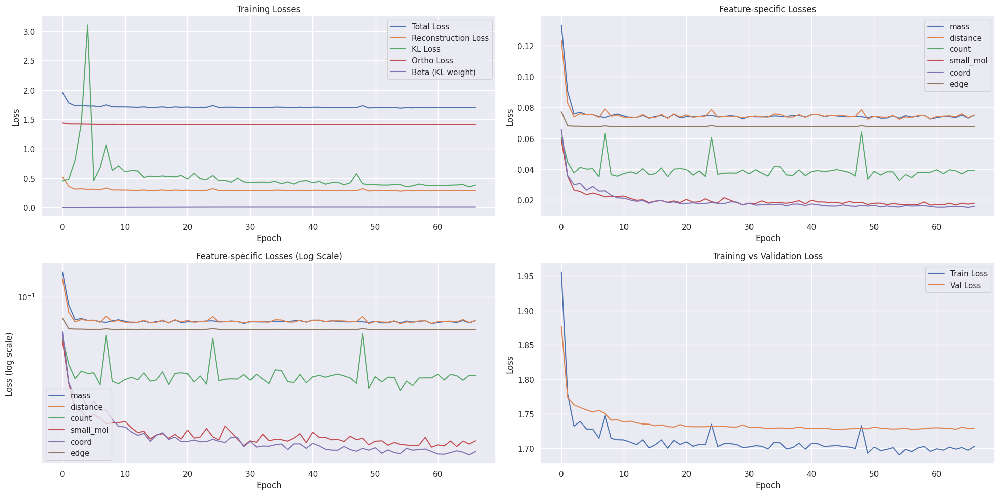

Epoch 68/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 18.00it/s, loss=1.6528, recon=0.2400, kl=0.5434, ortho=1.4101]


Detailed loss diagnostics:
Raw recon_loss: 0.3179
Raw KL loss: 0.3885
Ortho loss: 1.4096
Current beta: 0.0050
mu mean: 0.0301, std: 0.5622
logvar mean: -0.8484, std: 1.2252
mass: 0.0882
distance: 0.0809
count: 0.0269
small_mol: 0.0297
coord: 0.0250
edge: 0.0671


Epoch 68/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 19.88it/s, loss=1.6761, recon=0.2641, kl=0.4280, ortho=1.4099]


Detailed loss diagnostics:
Raw recon_loss: 0.2421
Raw KL loss: 0.4385
Ortho loss: 1.4107
Current beta: 0.0050
mu mean: -0.0139, std: 0.6133
logvar mean: -0.9229, std: 1.2721
mass: 0.0644
distance: 0.0624
count: 0.0253
small_mol: 0.0102
coord: 0.0129
edge: 0.0669


Epoch 68/100 [Train]:  55%|█████▍    | 23/42 [00:01<00:00, 19.73it/s, loss=1.6382, recon=0.2273, kl=0.3423, ortho=1.4092]


Detailed loss diagnostics:
Raw recon_loss: 0.3404
Raw KL loss: 0.3277
Ortho loss: 1.4088
Current beta: 0.0050
mu mean: 0.0284, std: 0.5005
logvar mean: -0.7239, std: 1.1863
mass: 0.1081
distance: 0.0862
count: 0.0272
small_mol: 0.0312
coord: 0.0207
edge: 0.0670


Epoch 68/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 20.06it/s, loss=1.6783, recon=0.2676, kl=0.3381, ortho=1.4091]


Detailed loss diagnostics:
Raw recon_loss: 0.2863
Raw KL loss: 0.3813
Ortho loss: 1.4108
Current beta: 0.0050
mu mean: 0.0554, std: 0.5933
logvar mean: -0.7654, std: 1.1421
mass: 0.0722
distance: 0.0801
count: 0.0341
small_mol: 0.0181
coord: 0.0131
edge: 0.0687


Epoch 68/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.74it/s, loss=1.7693, recon=0.3311, kl=0.2694, ortho=1.4368]



Detailed loss diagnostics:
Raw recon_loss: 0.2359
Raw KL loss: 0.4415
Ortho loss: 1.4103
Current beta: 0.0050
mu mean: 0.0147, std: 0.6511
logvar mean: -0.8056, std: 1.2569
mass: 0.0627
distance: 0.0623
count: 0.0252
small_mol: 0.0075
coord: 0.0113
edge: 0.0669

Starting validation...


Epoch 68/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 66.56it/s]



Epoch [68/100] - Time: 2.45s
Train - Total: 1.6982, Recon: 0.2858, KL: 0.4089, Ortho: 1.4104, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0742
  distance_loss: 0.0739
  count_loss: 0.0372
  small_mol_loss: 0.0176
  coord_loss: 0.0153
  edge_loss: 0.0675


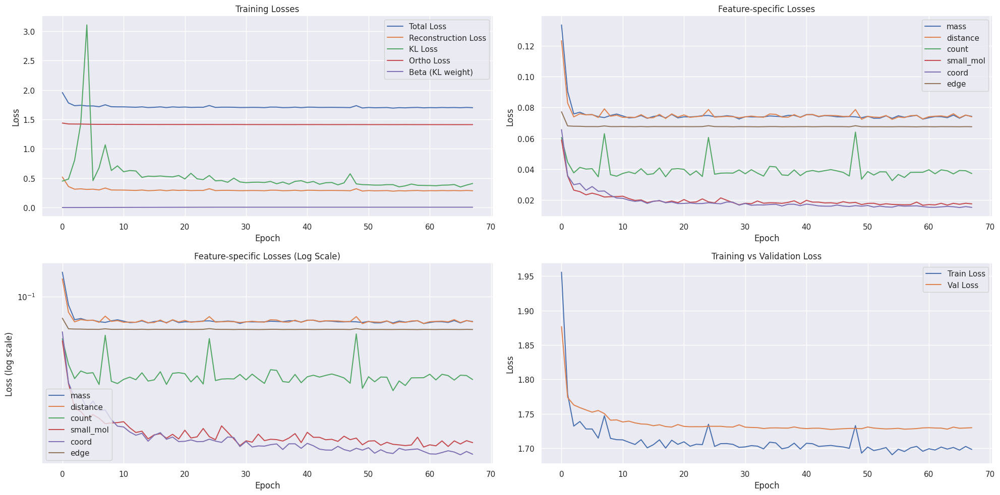

Epoch 69/100 [Train]:   5%|▍         | 2/42 [00:00<00:02, 19.45it/s, loss=1.6652, recon=0.2544, kl=0.3453, ortho=1.4091]


Detailed loss diagnostics:
Raw recon_loss: 0.2525
Raw KL loss: 0.3408
Ortho loss: 1.4101
Current beta: 0.0050
mu mean: -0.0012, std: 0.5135
logvar mean: -0.7636, std: 1.1934
mass: 0.0690
distance: 0.0668
count: 0.0256
small_mol: 0.0128
coord: 0.0106
edge: 0.0677


Epoch 69/100 [Train]:  31%|███       | 13/42 [00:00<00:01, 17.33it/s, loss=1.6582, recon=0.2470, kl=0.3029, ortho=1.4097]


Detailed loss diagnostics:
Raw recon_loss: 0.2379
Raw KL loss: 0.4289
Ortho loss: 1.4100
Current beta: 0.0050
mu mean: 0.0420, std: 0.6450
logvar mean: -0.7754, std: 1.2352
mass: 0.0631
distance: 0.0612
count: 0.0251
small_mol: 0.0113
coord: 0.0089
edge: 0.0682


Epoch 69/100 [Train]:  57%|█████▋    | 24/42 [00:01<00:00, 18.92it/s, loss=1.6983, recon=0.2862, kl=0.4857, ortho=1.4097]


Detailed loss diagnostics:
Raw recon_loss: 0.3519
Raw KL loss: 0.4007
Ortho loss: 1.4100
Current beta: 0.0050
mu mean: -0.0131, std: 0.6374
logvar mean: -0.7189, std: 1.1498
mass: 0.0723
distance: 0.0820
count: 0.0952
small_mol: 0.0177
coord: 0.0148
edge: 0.0699


Epoch 69/100 [Train]:  79%|███████▊  | 33/42 [00:01<00:00, 19.48it/s, loss=1.7145, recon=0.3042, kl=0.3355, ortho=1.4086]


Detailed loss diagnostics:
Raw recon_loss: 0.2636
Raw KL loss: 0.3402
Ortho loss: 1.4095
Current beta: 0.0050
mu mean: 0.0481, std: 0.5422
logvar mean: -0.7143, std: 1.1297
mass: 0.0724
distance: 0.0683
count: 0.0258
small_mol: 0.0168
coord: 0.0124
edge: 0.0680


Epoch 69/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 18.92it/s, loss=1.7883, recon=0.3597, kl=0.2731, ortho=1.4272]



Detailed loss diagnostics:
Raw recon_loss: 0.2883
Raw KL loss: 0.4094
Ortho loss: 1.4102
Current beta: 0.0050
mu mean: -0.0356, std: 0.6336
logvar mean: -0.7350, std: 1.2044
mass: 0.0753
distance: 0.0755
count: 0.0262
small_mol: 0.0250
coord: 0.0192
edge: 0.0671

Starting validation...


Epoch 69/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 62.79it/s]



Epoch [69/100] - Time: 2.56s
Train - Total: 1.6950, Recon: 0.2830, KL: 0.3847, Ortho: 1.4101, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0733
  distance_loss: 0.0730
  count_loss: 0.0361
  small_mol_loss: 0.0178
  coord_loss: 0.0153
  edge_loss: 0.0675


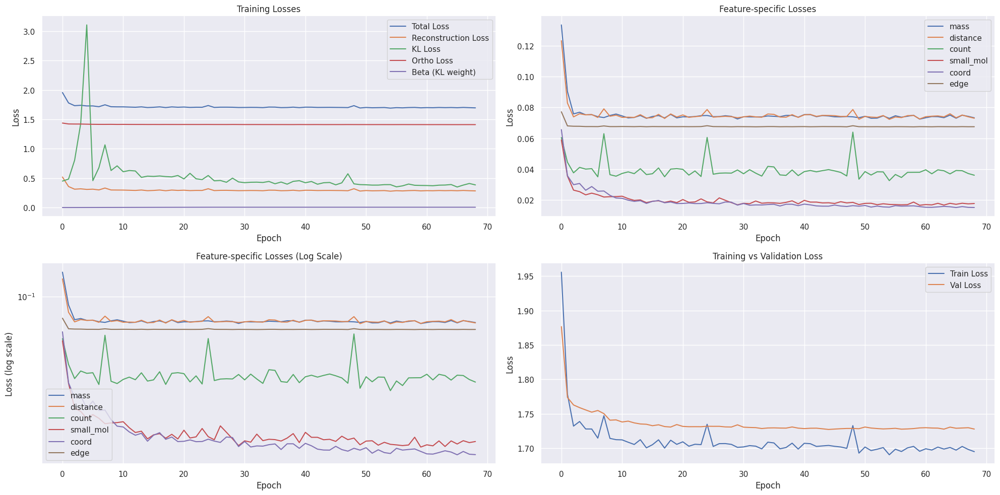

Epoch 70/100 [Train]:   5%|▍         | 2/42 [00:00<00:02, 19.03it/s, loss=1.6802, recon=0.2694, kl=0.2915, ortho=1.4093]


Detailed loss diagnostics:
Raw recon_loss: 0.2702
Raw KL loss: 0.3177
Ortho loss: 1.4111
Current beta: 0.0050
mu mean: -0.0265, std: 0.5286
logvar mean: -0.6289, std: 1.1330
mass: 0.0752
distance: 0.0726
count: 0.0261
small_mol: 0.0154
coord: 0.0132
edge: 0.0676


Epoch 70/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 18.98it/s, loss=1.6951, recon=0.2826, kl=0.3759, ortho=1.4106]


Detailed loss diagnostics:
Raw recon_loss: 0.2892
Raw KL loss: 0.3596
Ortho loss: 1.4105
Current beta: 0.0050
mu mean: 0.0509, std: 0.5520
logvar mean: -0.7525, std: 1.1745
mass: 0.0632
distance: 0.0648
count: 0.0686
small_mol: 0.0107
coord: 0.0135
edge: 0.0684


Epoch 70/100 [Train]:  57%|█████▋    | 24/42 [00:01<00:00, 19.12it/s, loss=1.6917, recon=0.2798, kl=0.3307, ortho=1.4103]


Detailed loss diagnostics:
Raw recon_loss: 0.2349
Raw KL loss: 0.4100
Ortho loss: 1.4100
Current beta: 0.0050
mu mean: 0.0299, std: 0.6090
logvar mean: -0.7819, std: 1.2601
mass: 0.0614
distance: 0.0606
count: 0.0250
small_mol: 0.0132
coord: 0.0082
edge: 0.0665


Epoch 70/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 19.70it/s, loss=1.6846, recon=0.2737, kl=0.3393, ortho=1.4092]


Detailed loss diagnostics:
Raw recon_loss: 0.2798
Raw KL loss: 0.3305
Ortho loss: 1.4088
Current beta: 0.0050
mu mean: 0.0056, std: 0.5247
logvar mean: -0.6738, std: 1.1708
mass: 0.0754
distance: 0.0758
count: 0.0261
small_mol: 0.0248
coord: 0.0109
edge: 0.0669


Epoch 70/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.03it/s, loss=1.8136, recon=0.3727, kl=0.5288, ortho=1.4382]



Detailed loss diagnostics:
Raw recon_loss: 0.2447
Raw KL loss: 0.3530
Ortho loss: 1.4097
Current beta: 0.0050
mu mean: -0.0187, std: 0.5440
logvar mean: -0.7268, std: 1.2042
mass: 0.0650
distance: 0.0652
count: 0.0254
small_mol: 0.0126
coord: 0.0099
edge: 0.0665

Starting validation...


Epoch 70/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 63.95it/s]



Epoch [70/100] - Time: 2.54s
Train - Total: 1.6990, Recon: 0.2865, KL: 0.3984, Ortho: 1.4105, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0744
  distance_loss: 0.0745
  count_loss: 0.0362
  small_mol_loss: 0.0174
  coord_loss: 0.0164
  edge_loss: 0.0675


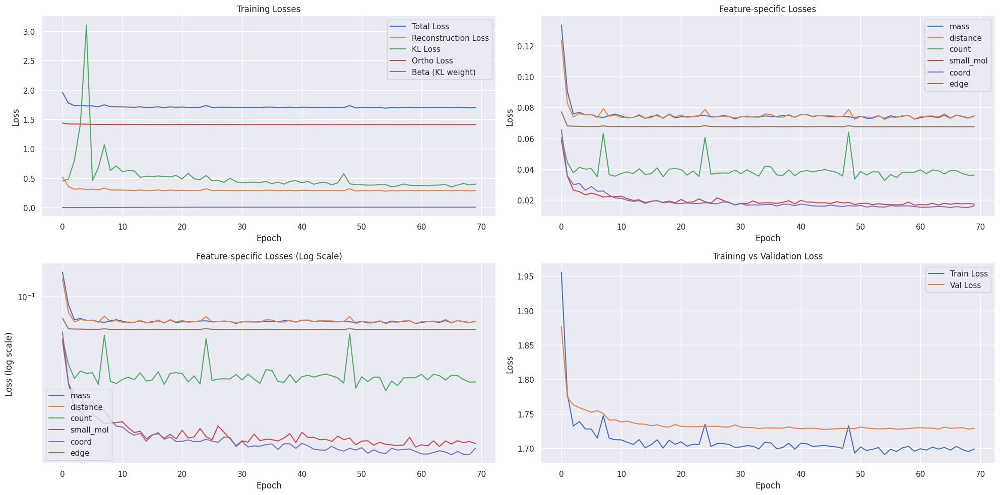

Epoch 71/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 17.08it/s, loss=1.6460, recon=0.2342, kl=0.3733, ortho=1.4099]


Detailed loss diagnostics:
Raw recon_loss: 0.2759
Raw KL loss: 0.3470
Ortho loss: 1.4106
Current beta: 0.0050
mu mean: 0.0111, std: 0.5474
logvar mean: -0.6994, std: 1.1756
mass: 0.0772
distance: 0.0747
count: 0.0261
small_mol: 0.0185
coord: 0.0122
edge: 0.0672


Epoch 71/100 [Train]:  31%|███       | 13/42 [00:00<00:01, 19.48it/s, loss=1.6869, recon=0.2753, kl=0.3476, ortho=1.4099]


Detailed loss diagnostics:
Raw recon_loss: 0.2707
Raw KL loss: 0.3383
Ortho loss: 1.4105
Current beta: 0.0050
mu mean: 0.0227, std: 0.5300
logvar mean: -0.7113, std: 1.1837
mass: 0.0717
distance: 0.0702
count: 0.0259
small_mol: 0.0188
coord: 0.0168
edge: 0.0673


Epoch 71/100 [Train]:  57%|█████▋    | 24/42 [00:01<00:00, 19.38it/s, loss=1.6606, recon=0.2497, kl=0.3739, ortho=1.4090]


Detailed loss diagnostics:
Raw recon_loss: 0.2463
Raw KL loss: 0.4127
Ortho loss: 1.4101
Current beta: 0.0050
mu mean: 0.0494, std: 0.6444
logvar mean: -0.7143, std: 1.1945
mass: 0.0630
distance: 0.0617
count: 0.0252
small_mol: 0.0141
coord: 0.0144
edge: 0.0679


Epoch 71/100 [Train]:  79%|███████▊  | 33/42 [00:01<00:00, 19.74it/s, loss=1.6526, recon=0.2409, kl=0.3186, ortho=1.4101]


Detailed loss diagnostics:
Raw recon_loss: 0.3315
Raw KL loss: 0.3091
Ortho loss: 1.4091
Current beta: 0.0050
mu mean: 0.0596, std: 0.4824
logvar mean: -0.6975, std: 1.1420
mass: 0.0952
distance: 0.0968
count: 0.0275
small_mol: 0.0261
coord: 0.0191
edge: 0.0668


Epoch 71/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.51it/s, loss=1.8632, recon=0.4348, kl=0.3371, ortho=1.4268]



Detailed loss diagnostics:
Raw recon_loss: 0.2747
Raw KL loss: 0.4264
Ortho loss: 1.4091
Current beta: 0.0050
mu mean: 0.0310, std: 0.6479
logvar mean: -0.7694, std: 1.2324
mass: 0.0707
distance: 0.0683
count: 0.0257
small_mol: 0.0149
coord: 0.0278
edge: 0.0673

Starting validation...


Epoch 71/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 66.04it/s]



Epoch [71/100] - Time: 2.48s
Train - Total: 1.7045, Recon: 0.2925, KL: 0.3585, Ortho: 1.4102, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0756
  distance_loss: 0.0758
  count_loss: 0.0382
  small_mol_loss: 0.0192
  coord_loss: 0.0161
  edge_loss: 0.0675


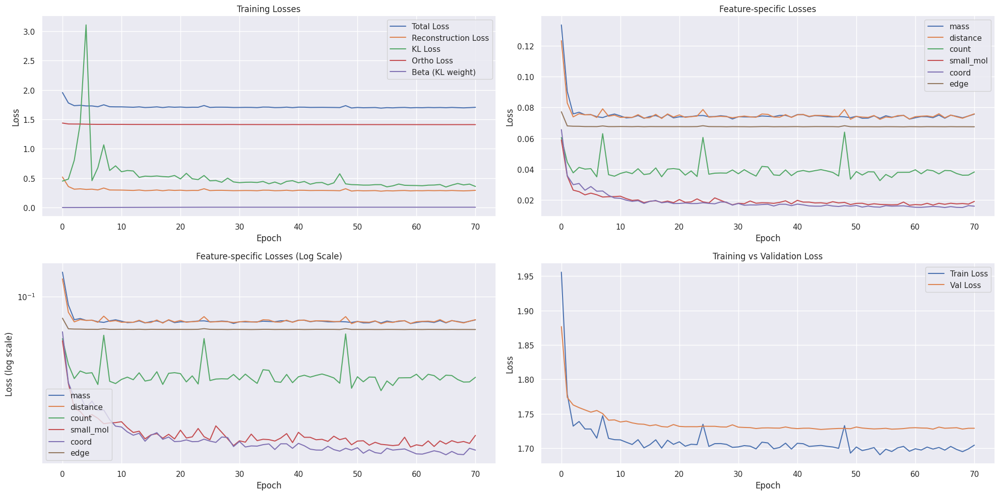

Epoch 72/100 [Train]:   5%|▍         | 2/42 [00:00<00:02, 17.73it/s, loss=1.7005, recon=0.2890, kl=0.3750, ortho=1.4096]


Detailed loss diagnostics:
Raw recon_loss: 0.2681
Raw KL loss: 0.4371
Ortho loss: 1.4110
Current beta: 0.0050
mu mean: -0.0144, std: 0.6387
logvar mean: -0.8592, std: 1.2363
mass: 0.0721
distance: 0.0707
count: 0.0258
small_mol: 0.0102
coord: 0.0229
edge: 0.0664


Epoch 72/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 18.94it/s, loss=1.6742, recon=0.2614, kl=0.4083, ortho=1.4108]


Detailed loss diagnostics:
Raw recon_loss: 0.2973
Raw KL loss: 0.3926
Ortho loss: 1.4118
Current beta: 0.0050
mu mean: 0.0662, std: 0.5904
logvar mean: -0.7813, std: 1.2068
mass: 0.0838
distance: 0.0802
count: 0.0266
small_mol: 0.0221
coord: 0.0181
edge: 0.0664


Epoch 72/100 [Train]:  52%|█████▏    | 22/42 [00:01<00:01, 19.43it/s, loss=1.6760, recon=0.2651, kl=0.3050, ortho=1.4094]


Detailed loss diagnostics:
Raw recon_loss: 0.2675
Raw KL loss: 0.3344
Ortho loss: 1.4092
Current beta: 0.0050
mu mean: 0.0419, std: 0.5078
logvar mean: -0.7314, std: 1.1979
mass: 0.0731
distance: 0.0707
count: 0.0259
small_mol: 0.0171
coord: 0.0140
edge: 0.0667


Epoch 72/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 20.03it/s, loss=1.6781, recon=0.2666, kl=0.2765, ortho=1.4101]


Detailed loss diagnostics:
Raw recon_loss: 0.2442
Raw KL loss: 0.3141
Ortho loss: 1.4101
Current beta: 0.0050
mu mean: -0.0036, std: 0.5193
logvar mean: -0.6185, std: 1.1285
mass: 0.0648
distance: 0.0636
count: 0.0254
small_mol: 0.0105
coord: 0.0138
edge: 0.0662


Epoch 72/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.26it/s, loss=1.7993, recon=0.3723, kl=0.3511, ortho=1.4252]



Detailed loss diagnostics:
Raw recon_loss: 0.2656
Raw KL loss: 0.3207
Ortho loss: 1.4098
Current beta: 0.0050
mu mean: 0.0079, std: 0.5338
logvar mean: -0.6380, std: 1.1046
mass: 0.0699
distance: 0.0686
count: 0.0257
small_mol: 0.0221
coord: 0.0132
edge: 0.0661

Starting validation...


Epoch 72/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 66.39it/s]



Epoch [72/100] - Time: 2.51s
Train - Total: 1.6954, Recon: 0.2831, KL: 0.3919, Ortho: 1.4103, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0730
  distance_loss: 0.0731
  count_loss: 0.0366
  small_mol_loss: 0.0176
  coord_loss: 0.0154
  edge_loss: 0.0675


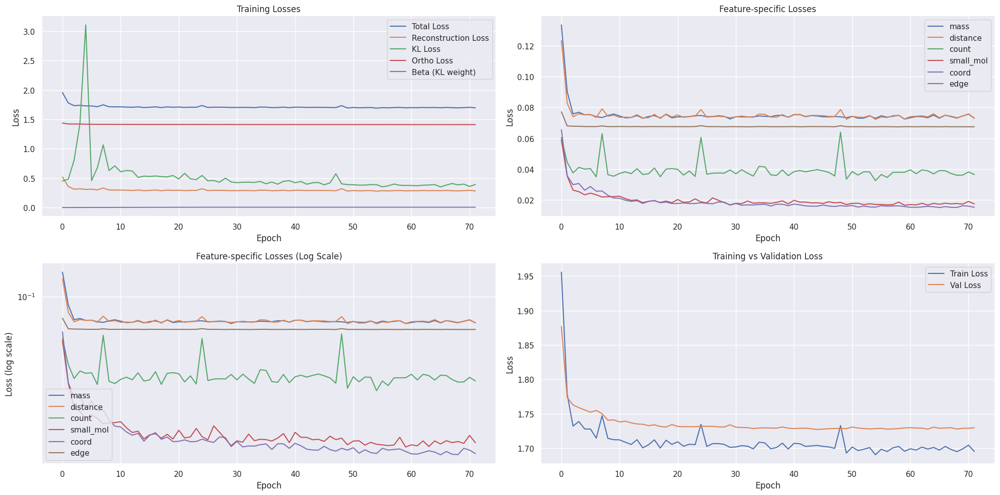

Epoch 73/100 [Train]:   5%|▍         | 2/42 [00:00<00:02, 18.20it/s, loss=1.6841, recon=0.2736, kl=0.3578, ortho=1.4088]


Detailed loss diagnostics:
Raw recon_loss: 0.2496
Raw KL loss: 0.3251
Ortho loss: 1.4090
Current beta: 0.0050
mu mean: 0.0022, std: 0.5565
logvar mean: -0.5982, std: 1.0874
mass: 0.0663
distance: 0.0662
count: 0.0254
small_mol: 0.0162
coord: 0.0091
edge: 0.0664


Epoch 73/100 [Train]:  29%|██▊       | 12/42 [00:00<00:01, 19.25it/s, loss=1.6498, recon=0.2388, kl=0.3158, ortho=1.4095]


Detailed loss diagnostics:
Raw recon_loss: 0.2597
Raw KL loss: 0.3520
Ortho loss: 1.4101
Current beta: 0.0050
mu mean: -0.0041, std: 0.5713
logvar mean: -0.6730, std: 1.1521
mass: 0.0688
distance: 0.0671
count: 0.0257
small_mol: 0.0222
coord: 0.0096
edge: 0.0663


Epoch 73/100 [Train]:  57%|█████▋    | 24/42 [00:01<00:00, 20.04it/s, loss=1.6735, recon=0.2628, kl=0.3373, ortho=1.4091]


Detailed loss diagnostics:
Raw recon_loss: 0.2941
Raw KL loss: 0.3507
Ortho loss: 1.4091
Current beta: 0.0050
mu mean: 0.0018, std: 0.5658
logvar mean: -0.6787, std: 1.1637
mass: 0.0771
distance: 0.0845
count: 0.0344
small_mol: 0.0169
coord: 0.0127
edge: 0.0685


Epoch 73/100 [Train]:  79%|███████▊  | 33/42 [00:01<00:00, 19.25it/s, loss=1.6855, recon=0.2733, kl=0.3132, ortho=1.4107]


Detailed loss diagnostics:
Raw recon_loss: 0.2713
Raw KL loss: 0.3121
Ortho loss: 1.4086
Current beta: 0.0050
mu mean: 0.0122, std: 0.5161
logvar mean: -0.6391, std: 1.1171
mass: 0.0757
distance: 0.0721
count: 0.0260
small_mol: 0.0146
coord: 0.0155
edge: 0.0673


Epoch 73/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.53it/s, loss=1.9514, recon=0.5145, kl=0.4243, ortho=1.4348]



Detailed loss diagnostics:
Raw recon_loss: 0.2802
Raw KL loss: 0.3972
Ortho loss: 1.4095
Current beta: 0.0050
mu mean: 0.0136, std: 0.6385
logvar mean: -0.6605, std: 1.1981
mass: 0.0763
distance: 0.0733
count: 0.0260
small_mol: 0.0101
coord: 0.0263
edge: 0.0682

Starting validation...


Epoch 73/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 66.44it/s]



Epoch [73/100] - Time: 2.48s
Train - Total: 1.6979, Recon: 0.2861, KL: 0.3581, Ortho: 1.4100, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0731
  distance_loss: 0.0734
  count_loss: 0.0375
  small_mol_loss: 0.0196
  coord_loss: 0.0151
  edge_loss: 0.0675


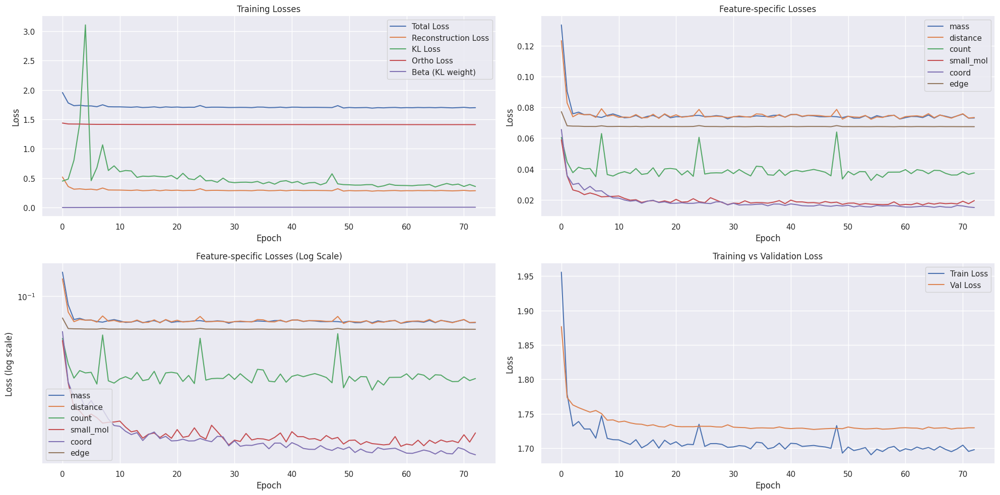

Epoch 74/100 [Train]:   5%|▍         | 2/42 [00:00<00:02, 16.42it/s, loss=1.6908, recon=0.2772, kl=0.5295, ortho=1.4110]


Detailed loss diagnostics:
Raw recon_loss: 0.2791
Raw KL loss: 0.3149
Ortho loss: 1.4087
Current beta: 0.0050
mu mean: -0.0306, std: 0.4945
logvar mean: -0.6811, std: 1.1752
mass: 0.0790
distance: 0.0734
count: 0.0261
small_mol: 0.0181
coord: 0.0151
edge: 0.0674


Epoch 74/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 21.04it/s, loss=1.7242, recon=0.3100, kl=0.7179, ortho=1.4106]


Detailed loss diagnostics:
Raw recon_loss: 0.2701
Raw KL loss: 1.0270
Ortho loss: 1.4112
Current beta: 0.0050
mu mean: 0.0539, std: 1.0911
logvar mean: -1.3496, std: 1.9415
mass: 0.0727
distance: 0.0714
count: 0.0259
small_mol: 0.0198
coord: 0.0142
edge: 0.0660


Epoch 74/100 [Train]:  55%|█████▍    | 23/42 [00:01<00:00, 19.81it/s, loss=1.7578, recon=0.3437, kl=0.6025, ortho=1.4111]


Detailed loss diagnostics:
Raw recon_loss: 0.2565
Raw KL loss: 0.7130
Ortho loss: 1.4099
Current beta: 0.0050
mu mean: 0.0273, std: 0.8753
logvar mean: -1.0760, std: 1.6204
mass: 0.0671
distance: 0.0669
count: 0.0256
small_mol: 0.0146
coord: 0.0150
edge: 0.0673


Epoch 74/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 19.10it/s, loss=1.7395, recon=0.3233, kl=0.5529, ortho=1.4135]


Detailed loss diagnostics:
Raw recon_loss: 0.2530
Raw KL loss: 0.5222
Ortho loss: 1.4114
Current beta: 0.0050
mu mean: 0.0161, std: 0.7293
logvar mean: -0.8765, std: 1.3844
mass: 0.0654
distance: 0.0645
count: 0.0253
small_mol: 0.0167
coord: 0.0137
edge: 0.0674


Epoch 74/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 20.12it/s, loss=1.8371, recon=0.3965, kl=0.3095, ortho=1.4390]



Detailed loss diagnostics:
Raw recon_loss: 0.2710
Raw KL loss: 0.5204
Ortho loss: 1.4108
Current beta: 0.0050
mu mean: 0.0053, std: 0.7661
logvar mean: -0.7756, std: 1.3418
mass: 0.0744
distance: 0.0717
count: 0.0261
small_mol: 0.0129
coord: 0.0184
edge: 0.0674

Starting validation...


Epoch 74/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 69.65it/s]



Epoch [74/100] - Time: 2.40s
Train - Total: 1.7016, Recon: 0.2874, KL: 0.5575, Ortho: 1.4114, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0739
  distance_loss: 0.0733
  count_loss: 0.0363
  small_mol_loss: 0.0200
  coord_loss: 0.0164
  edge_loss: 0.0675


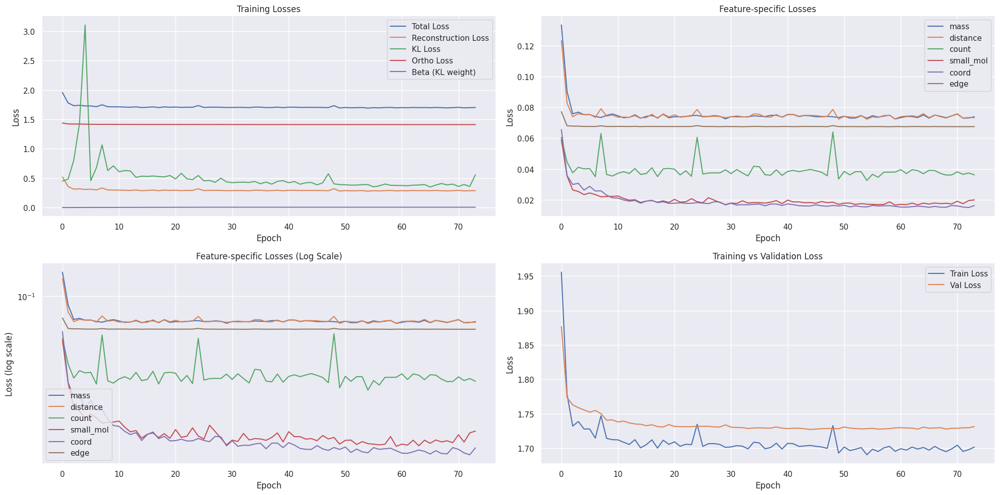

Epoch 75/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 17.74it/s, loss=1.6605, recon=0.2448, kl=0.8008, ortho=1.4117]


Detailed loss diagnostics:
Raw recon_loss: 0.3029
Raw KL loss: 0.4163
Ortho loss: 1.4100
Current beta: 0.0050
mu mean: 0.0357, std: 0.5969
logvar mean: -0.8223, std: 1.3226
mass: 0.0832
distance: 0.0800
count: 0.0266
small_mol: 0.0313
coord: 0.0156
edge: 0.0660


Epoch 75/100 [Train]:  31%|███       | 13/42 [00:00<00:01, 19.63it/s, loss=1.6804, recon=0.2658, kl=0.7112, ortho=1.4110]


Detailed loss diagnostics:
Raw recon_loss: 0.2897
Raw KL loss: 0.8178
Ortho loss: 1.4122
Current beta: 0.0050
mu mean: 0.0367, std: 0.8952
logvar mean: -1.3454, std: 1.7992
mass: 0.0831
distance: 0.0721
count: 0.0261
small_mol: 0.0203
coord: 0.0207
edge: 0.0674


Epoch 75/100 [Train]:  55%|█████▍    | 23/42 [00:01<00:00, 19.98it/s, loss=1.7232, recon=0.3073, kl=0.7800, ortho=1.4120]


Detailed loss diagnostics:
Raw recon_loss: 0.2837
Raw KL loss: 0.6616
Ortho loss: 1.4107
Current beta: 0.0050
mu mean: -0.0075, std: 0.8280
logvar mean: -1.0506, std: 1.5633
mass: 0.0780
distance: 0.0766
count: 0.0263
small_mol: 0.0207
coord: 0.0159
edge: 0.0662


Epoch 75/100 [Train]:  76%|███████▌  | 32/42 [00:01<00:00, 20.07it/s, loss=1.8302, recon=0.4186, kl=0.4076, ortho=1.4096]


Detailed loss diagnostics:
Raw recon_loss: 0.2509
Raw KL loss: 0.4090
Ortho loss: 1.4099
Current beta: 0.0050
mu mean: -0.0203, std: 0.6125
logvar mean: -0.7366, std: 1.3005
mass: 0.0667
distance: 0.0665
count: 0.0256
small_mol: 0.0141
coord: 0.0105
edge: 0.0674


Epoch 75/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.70it/s, loss=1.8474, recon=0.4112, kl=0.3851, ortho=1.4342]



Detailed loss diagnostics:
Raw recon_loss: 0.2818
Raw KL loss: 0.3800
Ortho loss: 1.4093
Current beta: 0.0050
mu mean: -0.0291, std: 0.5868
logvar mean: -0.6816, std: 1.2529
mass: 0.0770
distance: 0.0728
count: 0.0262
small_mol: 0.0243
coord: 0.0142
edge: 0.0672

Starting validation...


Epoch 75/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 69.52it/s]



Epoch [75/100] - Time: 2.44s
Train - Total: 1.7042, Recon: 0.2900, KL: 0.5604, Ortho: 1.4114, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0740
  distance_loss: 0.0741
  count_loss: 0.0388
  small_mol_loss: 0.0189
  coord_loss: 0.0166
  edge_loss: 0.0676


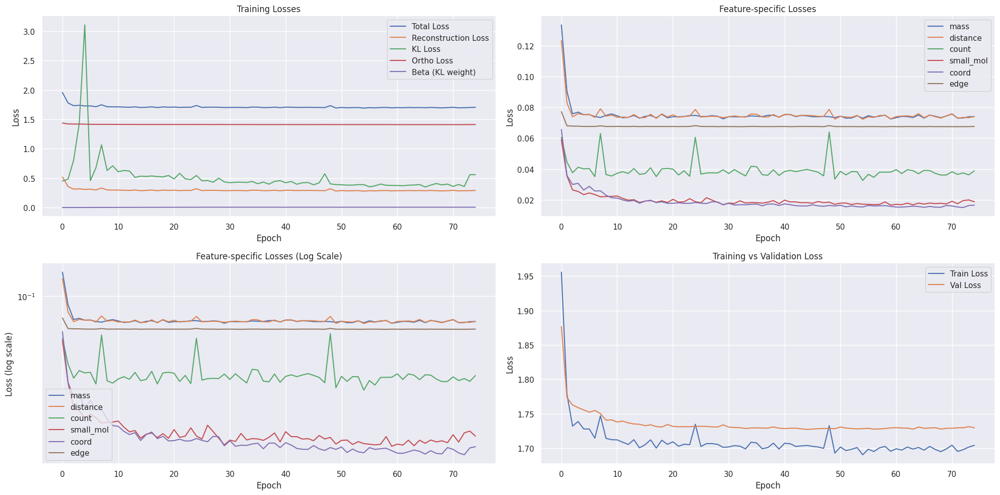

Epoch 76/100 [Train]:   5%|▍         | 2/42 [00:00<00:02, 19.11it/s, loss=1.6914, recon=0.2779, kl=0.4466, ortho=1.4112]


Detailed loss diagnostics:
Raw recon_loss: 0.2796
Raw KL loss: 0.3672
Ortho loss: 1.4109
Current beta: 0.0050
mu mean: -0.0009, std: 0.5646
logvar mean: -0.7022, std: 1.2318
mass: 0.0768
distance: 0.0742
count: 0.0261
small_mol: 0.0207
coord: 0.0148
edge: 0.0671


Epoch 76/100 [Train]:  31%|███       | 13/42 [00:00<00:01, 19.28it/s, loss=1.6541, recon=0.2424, kl=0.4976, ortho=1.4093]


Detailed loss diagnostics:
Raw recon_loss: 0.2547
Raw KL loss: 0.5309
Ortho loss: 1.4102
Current beta: 0.0050
mu mean: 0.0279, std: 0.7041
logvar mean: -0.9689, std: 1.4248
mass: 0.0666
distance: 0.0668
count: 0.0254
small_mol: 0.0180
coord: 0.0103
edge: 0.0676


Epoch 76/100 [Train]:  52%|█████▏    | 22/42 [00:01<00:01, 19.22it/s, loss=1.6877, recon=0.2754, kl=0.3628, ortho=1.4105]


Detailed loss diagnostics:
Raw recon_loss: 0.2859
Raw KL loss: 0.3721
Ortho loss: 1.4103
Current beta: 0.0050
mu mean: 0.0085, std: 0.5737
logvar mean: -0.7333, std: 1.2046
mass: 0.0815
distance: 0.0794
count: 0.0267
small_mol: 0.0182
coord: 0.0134
edge: 0.0667


Epoch 76/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 19.72it/s, loss=1.6925, recon=0.2813, kl=0.3777, ortho=1.4093]


Detailed loss diagnostics:
Raw recon_loss: 0.2461
Raw KL loss: 0.5352
Ortho loss: 1.4090
Current beta: 0.0050
mu mean: 0.0074, std: 0.7793
logvar mean: -0.7987, std: 1.2867
mass: 0.0639
distance: 0.0618
count: 0.0252
small_mol: 0.0129
coord: 0.0144
edge: 0.0680


Epoch 76/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.54it/s, loss=1.8795, recon=0.4516, kl=0.3966, ortho=1.4259]



Detailed loss diagnostics:
Raw recon_loss: 0.2674
Raw KL loss: 0.3841
Ortho loss: 1.4097
Current beta: 0.0050
mu mean: -0.0360, std: 0.6077
logvar mean: -0.6959, std: 1.1824
mass: 0.0722
distance: 0.0713
count: 0.0259
small_mol: 0.0160
coord: 0.0147
edge: 0.0673

Starting validation...


Epoch 76/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 68.12it/s]



Epoch [76/100] - Time: 2.47s
Train - Total: 1.7032, Recon: 0.2903, KL: 0.4490, Ortho: 1.4107, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0743
  distance_loss: 0.0756
  count_loss: 0.0388
  small_mol_loss: 0.0183
  coord_loss: 0.0158
  edge_loss: 0.0675


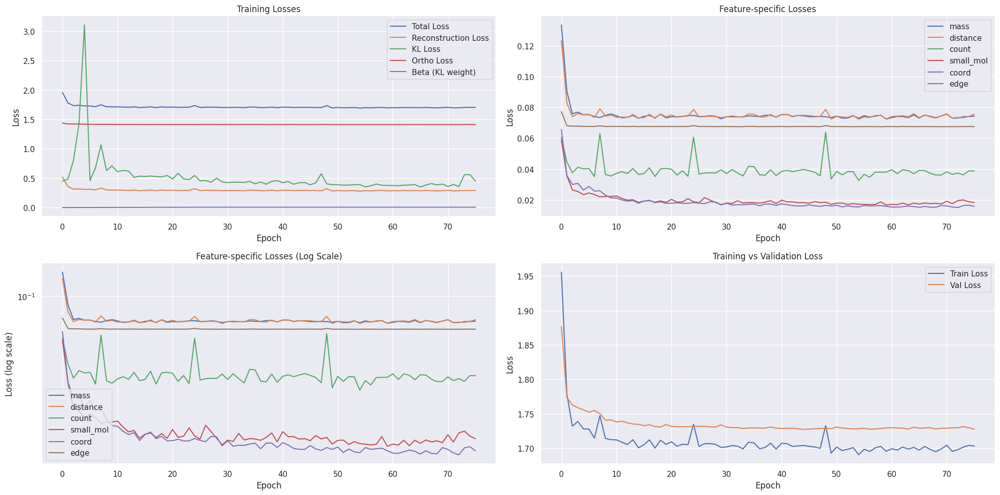

Epoch 77/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 18.79it/s, loss=1.7001, recon=0.2872, kl=0.5639, ortho=1.4100]


Detailed loss diagnostics:
Raw recon_loss: 0.2679
Raw KL loss: 0.4629
Ortho loss: 1.4094
Current beta: 0.0050
mu mean: 0.0135, std: 0.7205
logvar mean: -0.7280, std: 1.1707
mass: 0.0722
distance: 0.0730
count: 0.0260
small_mol: 0.0151
coord: 0.0152
edge: 0.0664


Epoch 77/100 [Train]:  31%|███       | 13/42 [00:00<00:01, 20.66it/s, loss=1.6772, recon=0.2648, kl=0.3393, ortho=1.4108]


Detailed loss diagnostics:
Raw recon_loss: 0.2559
Raw KL loss: 0.3877
Ortho loss: 1.4095
Current beta: 0.0050
mu mean: 0.0239, std: 0.5784
logvar mean: -0.8011, std: 1.2026
mass: 0.0685
distance: 0.0654
count: 0.0256
small_mol: 0.0169
coord: 0.0125
edge: 0.0671


Epoch 77/100 [Train]:  52%|█████▏    | 22/42 [00:01<00:01, 19.81it/s, loss=1.8422, recon=0.4305, kl=0.5169, ortho=1.4091]


Detailed loss diagnostics:
Raw recon_loss: 0.2667
Raw KL loss: 0.3861
Ortho loss: 1.4093
Current beta: 0.0050
mu mean: -0.0130, std: 0.6076
logvar mean: -0.7256, std: 1.1609
mass: 0.0747
distance: 0.0708
count: 0.0259
small_mol: 0.0142
coord: 0.0140
edge: 0.0672


Epoch 77/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 20.75it/s, loss=1.6670, recon=0.2564, kl=0.3932, ortho=1.4087]


Detailed loss diagnostics:
Raw recon_loss: 0.2614
Raw KL loss: 0.3206
Ortho loss: 1.4085
Current beta: 0.0050
mu mean: 0.0018, std: 0.5257
logvar mean: -0.6594, std: 1.1132
mass: 0.0720
distance: 0.0689
count: 0.0258
small_mol: 0.0175
coord: 0.0098
edge: 0.0673


Epoch 77/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 20.05it/s, loss=1.8087, recon=0.3783, kl=0.3482, ortho=1.4287]



Detailed loss diagnostics:
Raw recon_loss: 0.2677
Raw KL loss: 0.3232
Ortho loss: 1.4098
Current beta: 0.0050
mu mean: 0.0103, std: 0.5334
logvar mean: -0.6501, std: 1.1151
mass: 0.0716
distance: 0.0685
count: 0.0258
small_mol: 0.0211
coord: 0.0133
edge: 0.0676

Starting validation...


Epoch 77/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 67.55it/s]



Epoch [77/100] - Time: 2.42s
Train - Total: 1.6971, Recon: 0.2846, KL: 0.4062, Ortho: 1.4105, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0740
  distance_loss: 0.0735
  count_loss: 0.0367
  small_mol_loss: 0.0178
  coord_loss: 0.0152
  edge_loss: 0.0675


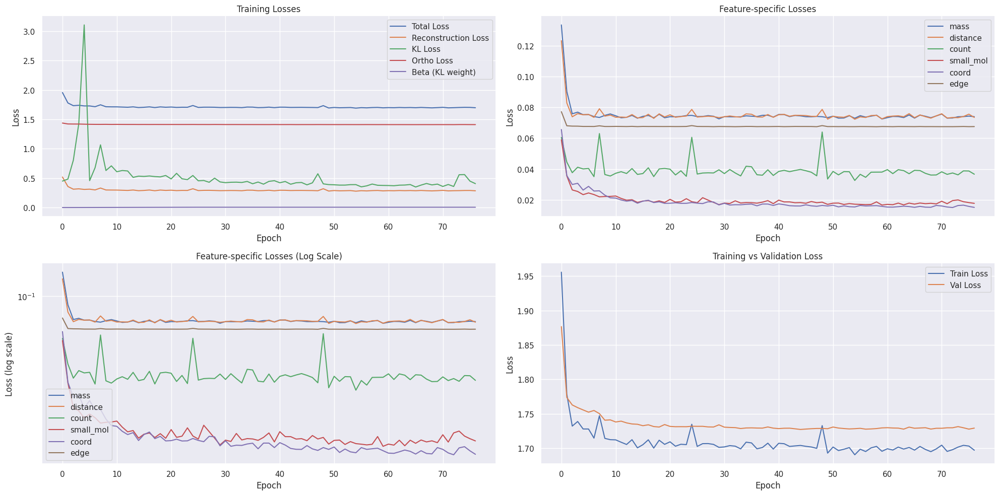

Epoch 78/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 18.95it/s, loss=1.8319, recon=0.4212, kl=0.3082, ortho=1.4092]


Detailed loss diagnostics:
Raw recon_loss: 0.2707
Raw KL loss: 0.3588
Ortho loss: 1.4096
Current beta: 0.0050
mu mean: 0.0023, std: 0.5814
logvar mean: -0.6859, std: 1.1289
mass: 0.0735
distance: 0.0716
count: 0.0260
small_mol: 0.0204
coord: 0.0129
edge: 0.0662


Epoch 78/100 [Train]:  29%|██▊       | 12/42 [00:00<00:01, 20.50it/s, loss=1.6954, recon=0.2806, kl=0.4658, ortho=1.4125]


Detailed loss diagnostics:
Raw recon_loss: 0.2894
Raw KL loss: 0.4759
Ortho loss: 1.4086
Current beta: 0.0050
mu mean: -0.0001, std: 0.7073
logvar mean: -0.7849, std: 1.2791
mass: 0.0792
distance: 0.0751
count: 0.0263
small_mol: 0.0212
coord: 0.0207
edge: 0.0670


Epoch 78/100 [Train]:  52%|█████▏    | 22/42 [00:01<00:01, 18.80it/s, loss=1.6640, recon=0.2538, kl=0.3198, ortho=1.4086]


Detailed loss diagnostics:
Raw recon_loss: 0.2391
Raw KL loss: 0.4324
Ortho loss: 1.4101
Current beta: 0.0050
mu mean: 0.0047, std: 0.6556
logvar mean: -0.7776, std: 1.2247
mass: 0.0610
distance: 0.0614
count: 0.0250
small_mol: 0.0101
coord: 0.0152
edge: 0.0665


Epoch 78/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 19.07it/s, loss=1.6416, recon=0.2302, kl=0.4185, ortho=1.4093]


Detailed loss diagnostics:
Raw recon_loss: 0.3143
Raw KL loss: 0.4468
Ortho loss: 1.4099
Current beta: 0.0050
mu mean: -0.0104, std: 0.6869
logvar mean: -0.7332, std: 1.2367
mass: 0.0861
distance: 0.0839
count: 0.0270
small_mol: 0.0203
coord: 0.0297
edge: 0.0673


Epoch 78/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.49it/s, loss=1.9021, recon=0.4747, kl=0.3650, ortho=1.4255]



Detailed loss diagnostics:
Raw recon_loss: 0.2997
Raw KL loss: 0.2866
Ortho loss: 1.4103
Current beta: 0.0050
mu mean: 0.0085, std: 0.4743
logvar mean: -0.6179, std: 1.1041
mass: 0.0856
distance: 0.0793
count: 0.0267
small_mol: 0.0240
coord: 0.0170
edge: 0.0670

Starting validation...


Epoch 78/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 67.43it/s]



Epoch [78/100] - Time: 2.47s
Train - Total: 1.7010, Recon: 0.2892, KL: 0.3784, Ortho: 1.4099, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0742
  distance_loss: 0.0749
  count_loss: 0.0383
  small_mol_loss: 0.0184
  coord_loss: 0.0158
  edge_loss: 0.0675


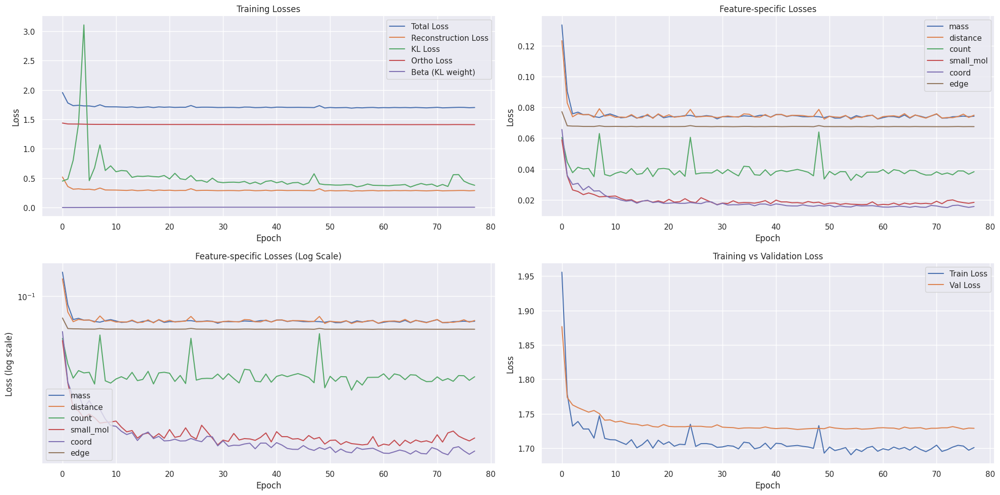

Epoch 79/100 [Train]:  10%|▉         | 4/42 [00:00<00:01, 19.16it/s, loss=1.6901, recon=0.2782, kl=0.4160, ortho=1.4098]


Detailed loss diagnostics:
Raw recon_loss: 0.2713
Raw KL loss: 0.3475
Ortho loss: 1.4088
Current beta: 0.0050
mu mean: -0.0074, std: 0.5491
logvar mean: -0.7138, std: 1.1622
mass: 0.0764
distance: 0.0731
count: 0.0262
small_mol: 0.0133
coord: 0.0154
edge: 0.0669


Epoch 79/100 [Train]:  31%|███       | 13/42 [00:00<00:01, 20.49it/s, loss=1.6784, recon=0.2668, kl=0.3971, ortho=1.4096]


Detailed loss diagnostics:
Raw recon_loss: 0.2754
Raw KL loss: 0.5015
Ortho loss: 1.4090
Current beta: 0.0050
mu mean: 0.0257, std: 0.6664
logvar mean: -0.9821, std: 1.3868
mass: 0.0734
distance: 0.0738
count: 0.0260
small_mol: 0.0213
coord: 0.0136
edge: 0.0674


Epoch 79/100 [Train]:  52%|█████▏    | 22/42 [00:01<00:01, 19.24it/s, loss=1.7117, recon=0.2990, kl=0.5374, ortho=1.4101]


Detailed loss diagnostics:
Raw recon_loss: 0.2370
Raw KL loss: 0.4536
Ortho loss: 1.4115
Current beta: 0.0050
mu mean: 0.0577, std: 0.6283
logvar mean: -0.8987, std: 1.3286
mass: 0.0598
distance: 0.0579
count: 0.0249
small_mol: 0.0142
coord: 0.0124
edge: 0.0678


Epoch 79/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 20.08it/s, loss=1.6661, recon=0.2538, kl=0.3639, ortho=1.4104]


Detailed loss diagnostics:
Raw recon_loss: 0.2740
Raw KL loss: 0.4459
Ortho loss: 1.4100
Current beta: 0.0050
mu mean: -0.0065, std: 0.6378
logvar mean: -0.8491, std: 1.3136
mass: 0.0755
distance: 0.0728
count: 0.0261
small_mol: 0.0169
coord: 0.0152
edge: 0.0675


Epoch 79/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.97it/s, loss=1.7500, recon=0.3144, kl=0.2463, ortho=1.4344]



Detailed loss diagnostics:
Raw recon_loss: 0.2573
Raw KL loss: 0.3341
Ortho loss: 1.4094
Current beta: 0.0050
mu mean: 0.0252, std: 0.5274
logvar mean: -0.6828, std: 1.1818
mass: 0.0687
distance: 0.0674
count: 0.0256
small_mol: 0.0164
coord: 0.0123
edge: 0.0669

Starting validation...


Epoch 79/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 63.07it/s]



Epoch [79/100] - Time: 2.44s
Train - Total: 1.6953, Recon: 0.2827, KL: 0.4525, Ortho: 1.4103, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0733
  distance_loss: 0.0733
  count_loss: 0.0360
  small_mol_loss: 0.0173
  coord_loss: 0.0154
  edge_loss: 0.0674


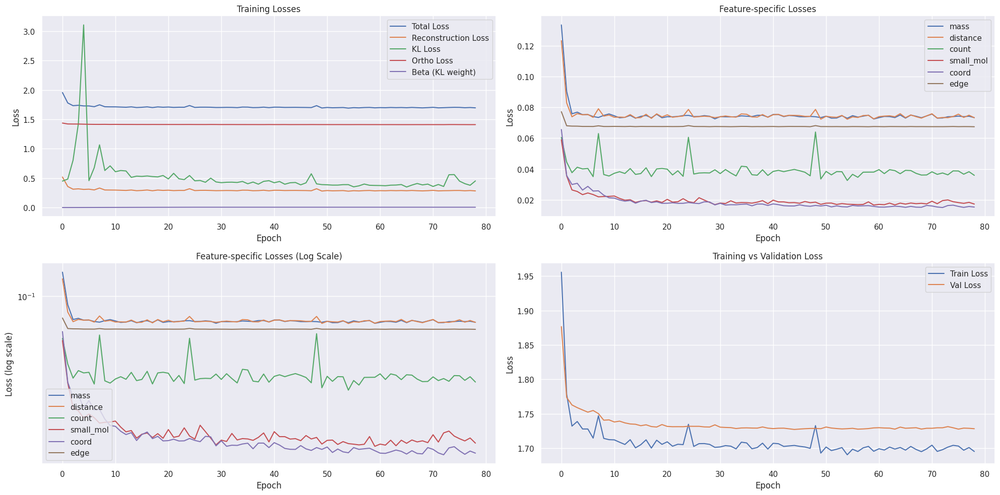

Epoch 80/100 [Train]:   5%|▍         | 2/42 [00:00<00:02, 15.61it/s, loss=1.7016, recon=0.2901, kl=0.4025, ortho=1.4095]


Detailed loss diagnostics:
Raw recon_loss: 0.2611
Raw KL loss: 0.3491
Ortho loss: 1.4094
Current beta: 0.0050
mu mean: -0.0150, std: 0.5481
logvar mean: -0.6924, std: 1.1981
mass: 0.0712
distance: 0.0683
count: 0.0258
small_mol: 0.0136
coord: 0.0145
edge: 0.0676


Epoch 80/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 19.59it/s, loss=1.6756, recon=0.2641, kl=0.3926, ortho=1.4096]


Detailed loss diagnostics:
Raw recon_loss: 0.2870
Raw KL loss: 0.3688
Ortho loss: 1.4095
Current beta: 0.0050
mu mean: 0.0134, std: 0.5932
logvar mean: -0.6576, std: 1.1852
mass: 0.0775
distance: 0.0756
count: 0.0263
small_mol: 0.0233
coord: 0.0173
edge: 0.0669


Epoch 80/100 [Train]:  57%|█████▋    | 24/42 [00:01<00:00, 19.95it/s, loss=1.7874, recon=0.3759, kl=0.3972, ortho=1.4095]


Detailed loss diagnostics:
Raw recon_loss: 0.2735
Raw KL loss: 0.4666
Ortho loss: 1.4099
Current beta: 0.0050
mu mean: 0.0179, std: 0.7109
logvar mean: -0.7192, std: 1.2584
mass: 0.0717
distance: 0.0713
count: 0.0258
small_mol: 0.0167
coord: 0.0209
edge: 0.0671


Epoch 80/100 [Train]:  76%|███████▌  | 32/42 [00:01<00:00, 19.30it/s, loss=1.8448, recon=0.4331, kl=0.3098, ortho=1.4102]


Detailed loss diagnostics:
Raw recon_loss: 0.2797
Raw KL loss: 0.3079
Ortho loss: 1.4095
Current beta: 0.0050
mu mean: -0.0360, std: 0.5274
logvar mean: -0.5562, std: 1.1122
mass: 0.0768
distance: 0.0729
count: 0.0262
small_mol: 0.0247
coord: 0.0126
edge: 0.0666


Epoch 80/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.23it/s, loss=1.7340, recon=0.3013, kl=0.2940, ortho=1.4312]



Detailed loss diagnostics:
Raw recon_loss: 0.2594
Raw KL loss: 0.3451
Ortho loss: 1.4097
Current beta: 0.0050
mu mean: 0.0364, std: 0.5545
logvar mean: -0.6667, std: 1.1691
mass: 0.0685
distance: 0.0699
count: 0.0256
small_mol: 0.0130
coord: 0.0148
edge: 0.0676

Starting validation...


Epoch 80/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 64.72it/s]



Epoch [80/100] - Time: 2.52s
Train - Total: 1.7004, Recon: 0.2884, KL: 0.3658, Ortho: 1.4102, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0738
  distance_loss: 0.0747
  count_loss: 0.0399
  small_mol_loss: 0.0171
  coord_loss: 0.0153
  edge_loss: 0.0676


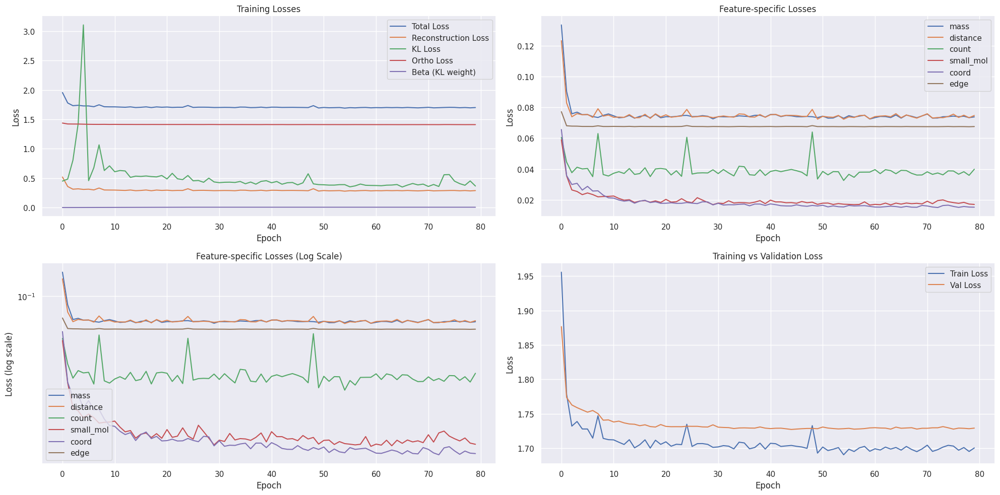

Epoch 81/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 17.50it/s, loss=1.6982, recon=0.2875, kl=0.4312, ortho=1.4085]


Detailed loss diagnostics:
Raw recon_loss: 0.2504
Raw KL loss: 0.4326
Ortho loss: 1.4100
Current beta: 0.0050
mu mean: 0.0325, std: 0.6681
logvar mean: -0.7348, std: 1.2131
mass: 0.0652
distance: 0.0635
count: 0.0253
small_mol: 0.0160
coord: 0.0135
edge: 0.0669


Epoch 81/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 19.53it/s, loss=1.6474, recon=0.2358, kl=0.4108, ortho=1.4096]


Detailed loss diagnostics:
Raw recon_loss: 0.2736
Raw KL loss: 0.3691
Ortho loss: 1.4094
Current beta: 0.0050
mu mean: 0.0078, std: 0.5909
logvar mean: -0.6883, std: 1.1716
mass: 0.0753
distance: 0.0734
count: 0.0261
small_mol: 0.0171
coord: 0.0150
edge: 0.0667


Epoch 81/100 [Train]:  55%|█████▍    | 23/42 [00:01<00:00, 20.27it/s, loss=1.7086, recon=0.2968, kl=0.4806, ortho=1.4094]


Detailed loss diagnostics:
Raw recon_loss: 0.2527
Raw KL loss: 0.3607
Ortho loss: 1.4104
Current beta: 0.0050
mu mean: -0.0104, std: 0.5425
logvar mean: -0.7702, std: 1.2220
mass: 0.0715
distance: 0.0686
count: 0.0258
small_mol: 0.0078
coord: 0.0127
edge: 0.0664


Epoch 81/100 [Train]:  76%|███████▌  | 32/42 [00:01<00:00, 20.07it/s, loss=1.6850, recon=0.2746, kl=0.3598, ortho=1.4086]


Detailed loss diagnostics:
Raw recon_loss: 0.2777
Raw KL loss: 0.3248
Ortho loss: 1.4091
Current beta: 0.0050
mu mean: -0.0072, std: 0.5365
logvar mean: -0.6361, std: 1.1396
mass: 0.0718
distance: 0.0783
count: 0.0324
small_mol: 0.0115
coord: 0.0153
edge: 0.0684


Epoch 81/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.72it/s, loss=1.8858, recon=0.4495, kl=0.3771, ortho=1.4344]



Detailed loss diagnostics:
Raw recon_loss: 0.2952
Raw KL loss: 0.3133
Ortho loss: 1.4093
Current beta: 0.0050
mu mean: 0.0290, std: 0.5158
logvar mean: -0.6370, std: 1.1287
mass: 0.0810
distance: 0.0810
count: 0.0264
small_mol: 0.0245
coord: 0.0147
edge: 0.0677

Starting validation...


Epoch 81/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 67.56it/s]



Epoch [81/100] - Time: 2.45s
Train - Total: 1.6974, Recon: 0.2851, KL: 0.3723, Ortho: 1.4104, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0734
  distance_loss: 0.0732
  count_loss: 0.0363
  small_mol_loss: 0.0191
  coord_loss: 0.0156
  edge_loss: 0.0675


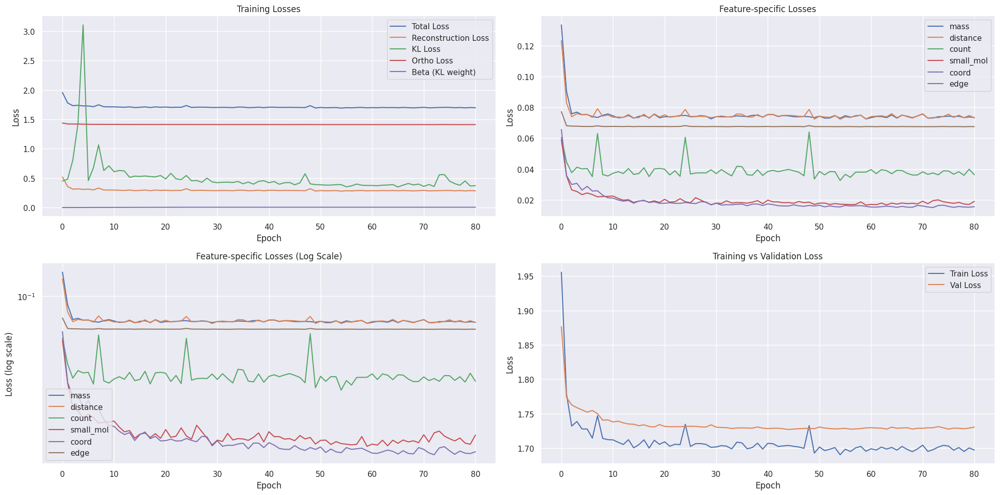

Epoch 82/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 18.56it/s, loss=1.6503, recon=0.2389, kl=0.4036, ortho=1.4094]


Detailed loss diagnostics:
Raw recon_loss: 0.2668
Raw KL loss: 0.3199
Ortho loss: 1.4090
Current beta: 0.0050
mu mean: -0.0303, std: 0.4856
logvar mean: -0.7180, std: 1.2020
mass: 0.0732
distance: 0.0711
count: 0.0260
small_mol: 0.0142
coord: 0.0146
edge: 0.0677


Epoch 82/100 [Train]:  31%|███       | 13/42 [00:00<00:01, 20.11it/s, loss=1.6876, recon=0.2763, kl=0.4143, ortho=1.4092]


Detailed loss diagnostics:
Raw recon_loss: 0.4383
Raw KL loss: 0.4673
Ortho loss: 1.4103
Current beta: 0.0050
mu mean: -0.0815, std: 0.6387
logvar mean: -0.9146, std: 1.3659
mass: 0.0828
distance: 0.0973
count: 0.1591
small_mol: 0.0104
coord: 0.0201
edge: 0.0687


Epoch 82/100 [Train]:  52%|█████▏    | 22/42 [00:01<00:00, 20.31it/s, loss=1.6727, recon=0.2597, kl=0.6864, ortho=1.4095]


Detailed loss diagnostics:
Raw recon_loss: 0.2633
Raw KL loss: 0.4075
Ortho loss: 1.4099
Current beta: 0.0050
mu mean: -0.0115, std: 0.5586
logvar mean: -0.8798, std: 1.3504
mass: 0.0714
distance: 0.0694
count: 0.0258
small_mol: 0.0158
coord: 0.0137
edge: 0.0671


Epoch 82/100 [Train]:  76%|███████▌  | 32/42 [00:01<00:00, 19.26it/s, loss=1.7189, recon=0.3060, kl=0.5756, ortho=1.4100]


Detailed loss diagnostics:
Raw recon_loss: 0.2753
Raw KL loss: 0.3496
Ortho loss: 1.4095
Current beta: 0.0050
mu mean: -0.0065, std: 0.5201
logvar mean: -0.7638, std: 1.2359
mass: 0.0766
distance: 0.0723
count: 0.0262
small_mol: 0.0197
coord: 0.0140
edge: 0.0664


Epoch 82/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.71it/s, loss=1.8060, recon=0.3765, kl=0.5484, ortho=1.4267]



Detailed loss diagnostics:
Raw recon_loss: 0.2566
Raw KL loss: 0.3173
Ortho loss: 1.4107
Current beta: 0.0050
mu mean: 0.0069, std: 0.5256
logvar mean: -0.6151, std: 1.1357
mass: 0.0689
distance: 0.0687
count: 0.0257
small_mol: 0.0137
coord: 0.0118
edge: 0.0678

Starting validation...


Epoch 82/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 66.42it/s]



Epoch [82/100] - Time: 2.45s
Train - Total: 1.6986, Recon: 0.2860, KL: 0.4343, Ortho: 1.4104, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0737
  distance_loss: 0.0739
  count_loss: 0.0370
  small_mol_loss: 0.0182
  coord_loss: 0.0157
  edge_loss: 0.0675


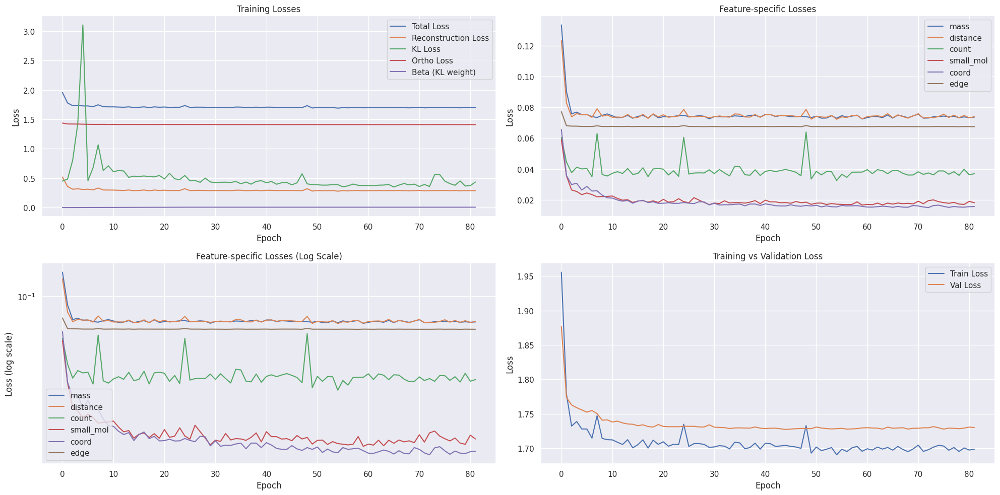

Epoch 83/100 [Train]:   5%|▍         | 2/42 [00:00<00:02, 16.77it/s, loss=1.7016, recon=0.2905, kl=0.3378, ortho=1.4094]


Detailed loss diagnostics:
Raw recon_loss: 0.2548
Raw KL loss: 0.3351
Ortho loss: 1.4098
Current beta: 0.0050
mu mean: -0.0265, std: 0.5341
logvar mean: -0.6620, std: 1.1765
mass: 0.0671
distance: 0.0660
count: 0.0254
small_mol: 0.0191
coord: 0.0117
edge: 0.0655


Epoch 83/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 18.65it/s, loss=1.7256, recon=0.3124, kl=0.3021, ortho=1.4118]


Detailed loss diagnostics:
Raw recon_loss: 0.2845
Raw KL loss: 0.3399
Ortho loss: 1.4091
Current beta: 0.0050
mu mean: -0.0086, std: 0.5427
logvar mean: -0.6726, std: 1.1773
mass: 0.0809
distance: 0.0791
count: 0.0266
small_mol: 0.0153
coord: 0.0159
edge: 0.0667


Epoch 83/100 [Train]:  52%|█████▏    | 22/42 [00:01<00:01, 18.05it/s, loss=1.6569, recon=0.2457, kl=0.4296, ortho=1.4090]


Detailed loss diagnostics:
Raw recon_loss: 0.2772
Raw KL loss: 0.3770
Ortho loss: 1.4087
Current beta: 0.0050
mu mean: -0.0426, std: 0.5918
logvar mean: -0.6941, std: 1.2054
mass: 0.0780
distance: 0.0746
count: 0.0263
small_mol: 0.0173
coord: 0.0138
edge: 0.0672


Epoch 83/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 19.90it/s, loss=1.6882, recon=0.2769, kl=0.3733, ortho=1.4094]


Detailed loss diagnostics:
Raw recon_loss: 0.2281
Raw KL loss: 0.3795
Ortho loss: 1.4097
Current beta: 0.0050
mu mean: -0.0035, std: 0.5742
logvar mean: -0.7066, std: 1.3098
mass: 0.0586
distance: 0.0574
count: 0.0248
small_mol: 0.0090
coord: 0.0113
edge: 0.0670


Epoch 83/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.39it/s, loss=1.7981, recon=0.3689, kl=0.4313, ortho=1.4271]



Detailed loss diagnostics:
Raw recon_loss: 0.2790
Raw KL loss: 0.4644
Ortho loss: 1.4097
Current beta: 0.0050
mu mean: 0.0243, std: 0.6703
logvar mean: -0.8141, std: 1.3716
mass: 0.0779
distance: 0.0756
count: 0.0263
small_mol: 0.0150
coord: 0.0171
edge: 0.0670

Starting validation...


Epoch 83/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 66.40it/s]



Epoch [83/100] - Time: 2.49s
Train - Total: 1.7012, Recon: 0.2892, KL: 0.3554, Ortho: 1.4102, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0744
  distance_loss: 0.0753
  count_loss: 0.0378
  small_mol_loss: 0.0178
  coord_loss: 0.0163
  edge_loss: 0.0675


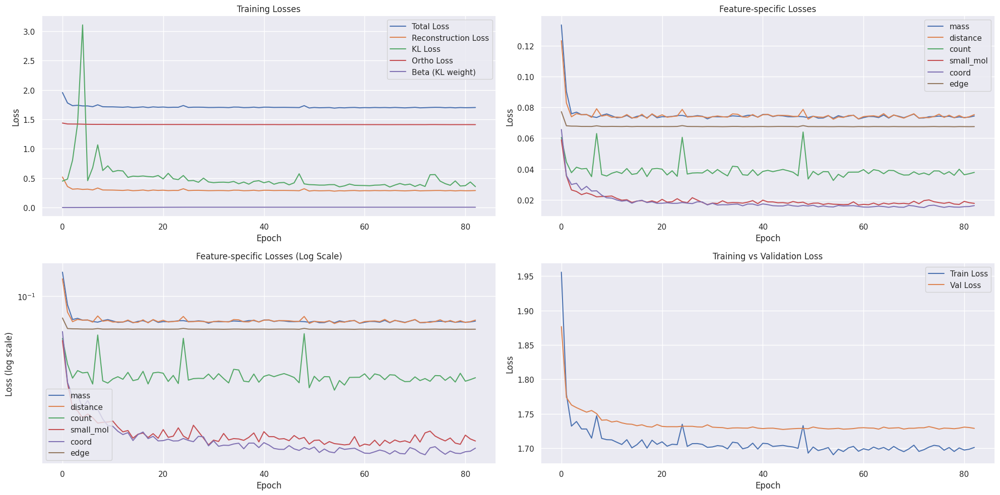

Epoch 84/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 18.36it/s, loss=1.7125, recon=0.3003, kl=0.3220, ortho=1.4105]


Detailed loss diagnostics:
Raw recon_loss: 0.2407
Raw KL loss: 0.4159
Ortho loss: 1.4099
Current beta: 0.0050
mu mean: 0.0800, std: 0.6249
logvar mean: -0.7558, std: 1.2697
mass: 0.0640
distance: 0.0627
count: 0.0252
small_mol: 0.0091
coord: 0.0128
edge: 0.0668


Epoch 84/100 [Train]:  31%|███       | 13/42 [00:00<00:01, 19.75it/s, loss=1.6678, recon=0.2576, kl=0.3509, ortho=1.4084]


Detailed loss diagnostics:
Raw recon_loss: 0.3047
Raw KL loss: 0.3904
Ortho loss: 1.4093
Current beta: 0.0050
mu mean: -0.0289, std: 0.6058
logvar mean: -0.7338, std: 1.2102
mass: 0.0832
distance: 0.0838
count: 0.0268
small_mol: 0.0179
coord: 0.0250
edge: 0.0680


Epoch 84/100 [Train]:  52%|█████▏    | 22/42 [00:01<00:00, 21.07it/s, loss=1.6959, recon=0.2847, kl=0.3481, ortho=1.4094]


Detailed loss diagnostics:
Raw recon_loss: 0.2658
Raw KL loss: 0.4296
Ortho loss: 1.4087
Current beta: 0.0050
mu mean: -0.0413, std: 0.6354
logvar mean: -0.7907, std: 1.2838
mass: 0.0706
distance: 0.0697
count: 0.0258
small_mol: 0.0206
coord: 0.0122
edge: 0.0670


Epoch 84/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 19.97it/s, loss=1.6697, recon=0.2575, kl=0.4438, ortho=1.4100]


Detailed loss diagnostics:
Raw recon_loss: 0.2787
Raw KL loss: 0.3250
Ortho loss: 1.4107
Current beta: 0.0050
mu mean: -0.0487, std: 0.5181
logvar mean: -0.6552, std: 1.1853
mass: 0.0775
distance: 0.0776
count: 0.0265
small_mol: 0.0133
coord: 0.0171
edge: 0.0666


Epoch 84/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 20.00it/s, loss=1.8554, recon=0.4256, kl=0.3664, ortho=1.4280]



Detailed loss diagnostics:
Raw recon_loss: 0.2903
Raw KL loss: 0.4867
Ortho loss: 1.4115
Current beta: 0.0050
mu mean: 0.0101, std: 0.7127
logvar mean: -0.7797, std: 1.3552
mass: 0.0791
distance: 0.0736
count: 0.0262
small_mol: 0.0196
coord: 0.0248
edge: 0.0669

Starting validation...


Epoch 84/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 69.12it/s]



Epoch [84/100] - Time: 2.41s
Train - Total: 1.6992, Recon: 0.2873, KL: 0.3787, Ortho: 1.4100, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0747
  distance_loss: 0.0745
  count_loss: 0.0359
  small_mol_loss: 0.0188
  coord_loss: 0.0161
  edge_loss: 0.0674


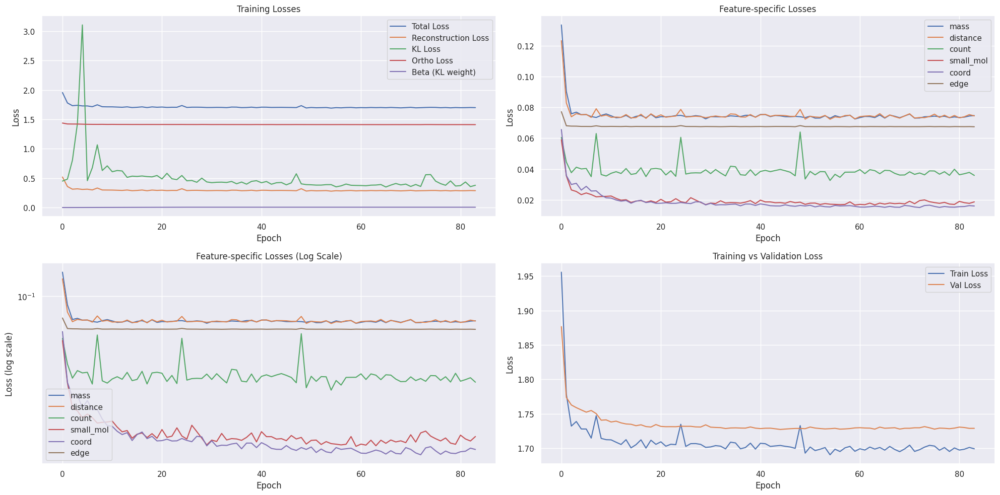

Epoch 85/100 [Train]:   7%|▋         | 3/42 [00:00<00:01, 20.33it/s, loss=1.6877, recon=0.2775, kl=0.3682, ortho=1.4084]


Detailed loss diagnostics:
Raw recon_loss: 0.4233
Raw KL loss: 0.3706
Ortho loss: 1.4091
Current beta: 0.0050
mu mean: -0.0070, std: 0.5657
logvar mean: -0.7440, std: 1.2353
mass: 0.0776
distance: 0.0884
count: 0.1551
small_mol: 0.0172
coord: 0.0158
edge: 0.0692


Epoch 85/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 20.14it/s, loss=1.8399, recon=0.4287, kl=0.3944, ortho=1.4092]


Detailed loss diagnostics:
Raw recon_loss: 0.2566
Raw KL loss: 0.3407
Ortho loss: 1.4101
Current beta: 0.0050
mu mean: 0.0017, std: 0.5269
logvar mean: -0.6999, std: 1.2202
mass: 0.0691
distance: 0.0677
count: 0.0257
small_mol: 0.0171
coord: 0.0102
edge: 0.0669


Epoch 85/100 [Train]:  52%|█████▏    | 22/42 [00:01<00:01, 19.81it/s, loss=1.6944, recon=0.2833, kl=0.3372, ortho=1.4094]


Detailed loss diagnostics:
Raw recon_loss: 0.2717
Raw KL loss: 0.3021
Ortho loss: 1.4104
Current beta: 0.0050
mu mean: 0.0014, std: 0.4946
logvar mean: -0.6259, std: 1.1419
mass: 0.0743
distance: 0.0712
count: 0.0259
small_mol: 0.0208
coord: 0.0113
edge: 0.0684


Epoch 85/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 18.59it/s, loss=1.6480, recon=0.2378, kl=0.4073, ortho=1.4082]


Detailed loss diagnostics:
Raw recon_loss: 0.2525
Raw KL loss: 0.4837
Ortho loss: 1.4108
Current beta: 0.0050
mu mean: -0.0027, std: 0.7080
logvar mean: -0.8191, std: 1.3007
mass: 0.0667
distance: 0.0642
count: 0.0255
small_mol: 0.0125
coord: 0.0165
edge: 0.0671


Epoch 85/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.25it/s, loss=1.8685, recon=0.4415, kl=0.3045, ortho=1.4255]



Detailed loss diagnostics:
Raw recon_loss: 0.2582
Raw KL loss: 0.3298
Ortho loss: 1.4091
Current beta: 0.0050
mu mean: -0.0071, std: 0.5337
logvar mean: -0.6392, std: 1.1778
mass: 0.0719
distance: 0.0708
count: 0.0258
small_mol: 0.0106
coord: 0.0114
edge: 0.0675

Starting validation...


Epoch 85/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 66.94it/s]



Epoch [85/100] - Time: 2.51s
Train - Total: 1.7000, Recon: 0.2883, KL: 0.3749, Ortho: 1.4099, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0743
  distance_loss: 0.0743
  count_loss: 0.0384
  small_mol_loss: 0.0181
  coord_loss: 0.0156
  edge_loss: 0.0675


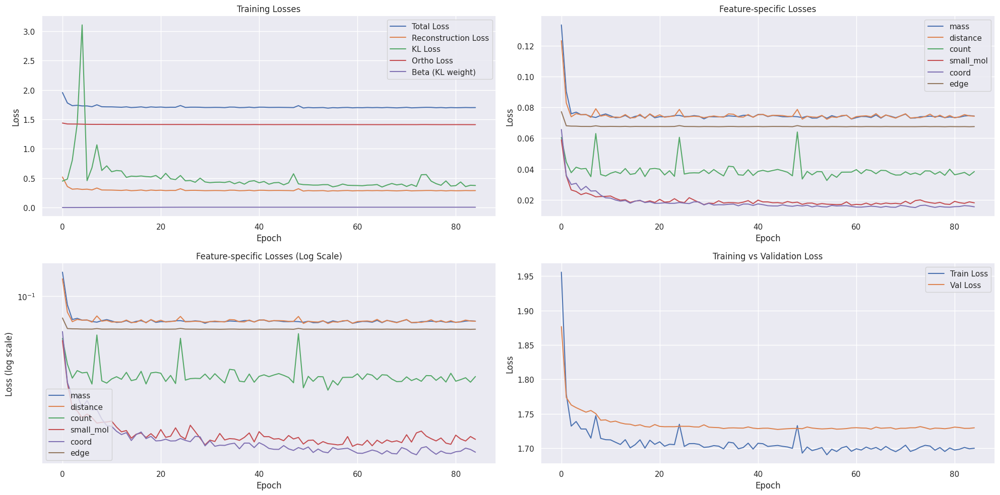

Epoch 86/100 [Train]:   5%|▍         | 2/42 [00:00<00:02, 17.39it/s, loss=1.6656, recon=0.2529, kl=0.4794, ortho=1.4103]


Detailed loss diagnostics:
Raw recon_loss: 0.2400
Raw KL loss: 0.3404
Ortho loss: 1.4088
Current beta: 0.0050
mu mean: 0.0198, std: 0.5409
logvar mean: -0.6692, std: 1.2002
mass: 0.0629
distance: 0.0607
count: 0.0250
small_mol: 0.0126
coord: 0.0106
edge: 0.0681


Epoch 86/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 19.69it/s, loss=1.7036, recon=0.2909, kl=0.3649, ortho=1.4109]


Detailed loss diagnostics:
Raw recon_loss: 0.3051
Raw KL loss: 0.4410
Ortho loss: 1.4083
Current beta: 0.0050
mu mean: 0.0151, std: 0.6862
logvar mean: -0.6959, std: 1.2413
mass: 0.0652
distance: 0.0720
count: 0.0725
small_mol: 0.0140
coord: 0.0096
edge: 0.0718


Epoch 86/100 [Train]:  57%|█████▋    | 24/42 [00:01<00:00, 18.96it/s, loss=1.6836, recon=0.2728, kl=0.3447, ortho=1.4091]


Detailed loss diagnostics:
Raw recon_loss: 0.2671
Raw KL loss: 0.3110
Ortho loss: 1.4087
Current beta: 0.0050
mu mean: 0.0177, std: 0.5192
logvar mean: -0.6053, std: 1.1411
mass: 0.0710
distance: 0.0684
count: 0.0257
small_mol: 0.0226
coord: 0.0122
edge: 0.0672


Epoch 86/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 18.10it/s, loss=1.7251, recon=0.3141, kl=0.4299, ortho=1.4088]


Detailed loss diagnostics:
Raw recon_loss: 0.2354
Raw KL loss: 0.4462
Ortho loss: 1.4098
Current beta: 0.0050
mu mean: -0.0324, std: 0.6730
logvar mean: -0.7483, std: 1.2872
mass: 0.0630
distance: 0.0618
count: 0.0251
small_mol: 0.0072
coord: 0.0122
edge: 0.0660


Epoch 86/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.12it/s, loss=1.8194, recon=0.3841, kl=0.3922, ortho=1.4334]



Detailed loss diagnostics:
Raw recon_loss: 0.2658
Raw KL loss: 0.3186
Ortho loss: 1.4106
Current beta: 0.0050
mu mean: -0.0110, std: 0.4897
logvar mean: -0.6699, std: 1.2340
mass: 0.0738
distance: 0.0702
count: 0.0260
small_mol: 0.0134
coord: 0.0152
edge: 0.0672

Starting validation...


Epoch 86/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 65.96it/s]



Epoch [86/100] - Time: 2.52s
Train - Total: 1.6946, Recon: 0.2827, KL: 0.3633, Ortho: 1.4101, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0727
  distance_loss: 0.0731
  count_loss: 0.0366
  small_mol_loss: 0.0176
  coord_loss: 0.0153
  edge_loss: 0.0675


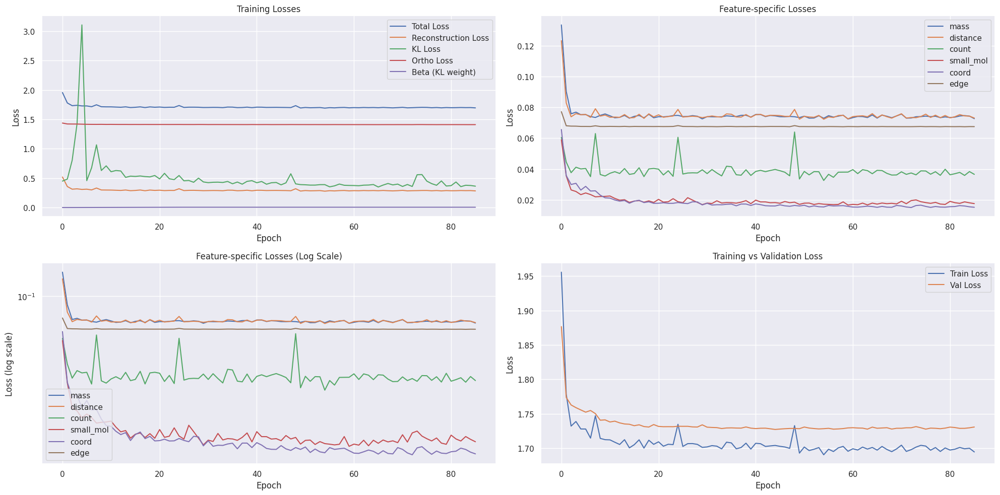

Epoch 87/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 18.22it/s, loss=1.6973, recon=0.2853, kl=0.2960, ortho=1.4106]


Detailed loss diagnostics:
Raw recon_loss: 0.2521
Raw KL loss: 0.4881
Ortho loss: 1.4092
Current beta: 0.0050
mu mean: 0.0454, std: 0.7121
logvar mean: -0.8068, std: 1.3104
mass: 0.0660
distance: 0.0634
count: 0.0254
small_mol: 0.0134
coord: 0.0169
edge: 0.0671


Epoch 87/100 [Train]:  29%|██▊       | 12/42 [00:00<00:01, 20.26it/s, loss=1.6631, recon=0.2511, kl=0.4729, ortho=1.4096]


Detailed loss diagnostics:
Raw recon_loss: 0.2738
Raw KL loss: 0.3289
Ortho loss: 1.4096
Current beta: 0.0050
mu mean: 0.0045, std: 0.5086
logvar mean: -0.6933, std: 1.2139
mass: 0.0762
distance: 0.0751
count: 0.0262
small_mol: 0.0116
coord: 0.0174
edge: 0.0673


Epoch 87/100 [Train]:  52%|█████▏    | 22/42 [00:01<00:01, 19.74it/s, loss=1.6676, recon=0.2561, kl=0.3452, ortho=1.4098]


Detailed loss diagnostics:
Raw recon_loss: 0.2597
Raw KL loss: 0.2889
Ortho loss: 1.4100
Current beta: 0.0050
mu mean: 0.0076, std: 0.4723
logvar mean: -0.6017, std: 1.1577
mass: 0.0712
distance: 0.0688
count: 0.0258
small_mol: 0.0155
coord: 0.0106
edge: 0.0677


Epoch 87/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 20.64it/s, loss=1.6817, recon=0.2706, kl=0.3219, ortho=1.4094]


Detailed loss diagnostics:
Raw recon_loss: 0.2592
Raw KL loss: 0.2785
Ortho loss: 1.4089
Current beta: 0.0050
mu mean: 0.0069, std: 0.4579
logvar mean: -0.5896, std: 1.1392
mass: 0.0706
distance: 0.0703
count: 0.0259
small_mol: 0.0131
coord: 0.0122
edge: 0.0671


Epoch 87/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 20.06it/s, loss=1.8552, recon=0.4229, kl=0.2949, ortho=1.4309]



Detailed loss diagnostics:
Raw recon_loss: 0.3096
Raw KL loss: 0.4262
Ortho loss: 1.4098
Current beta: 0.0050
mu mean: -0.0570, std: 0.6330
logvar mean: -0.7669, std: 1.3228
mass: 0.0835
distance: 0.0800
count: 0.0265
small_mol: 0.0280
coord: 0.0242
edge: 0.0674

Starting validation...


Epoch 87/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 67.75it/s]



Epoch [87/100] - Time: 2.41s
Train - Total: 1.7004, Recon: 0.2887, KL: 0.3602, Ortho: 1.4099, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0751
  distance_loss: 0.0760
  count_loss: 0.0370
  small_mol_loss: 0.0177
  coord_loss: 0.0155
  edge_loss: 0.0675


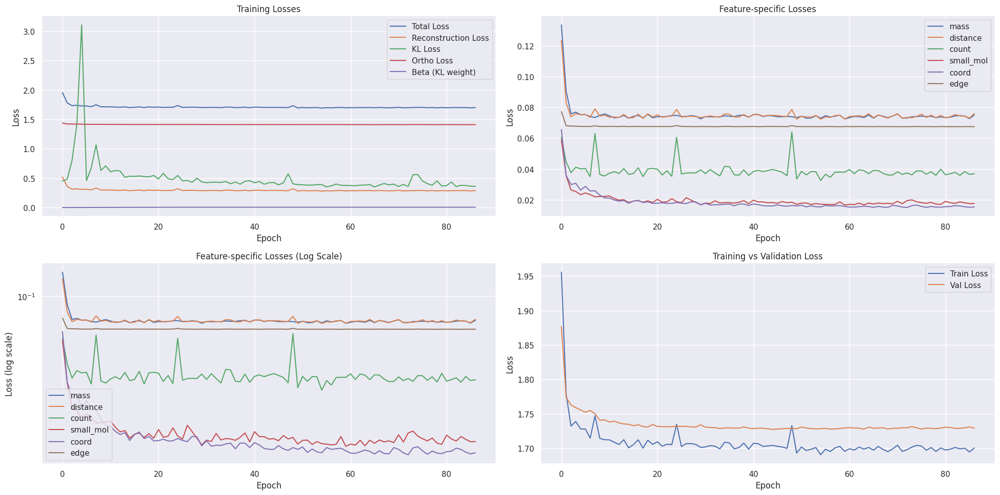

Epoch 88/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 18.64it/s, loss=1.6783, recon=0.2665, kl=0.3794, ortho=1.4099]


Detailed loss diagnostics:
Raw recon_loss: 0.2660
Raw KL loss: 0.3253
Ortho loss: 1.4101
Current beta: 0.0050
mu mean: -0.0480, std: 0.5138
logvar mean: -0.6657, std: 1.1979
mass: 0.0737
distance: 0.0740
count: 0.0262
small_mol: 0.0169
coord: 0.0091
edge: 0.0661


Epoch 88/100 [Train]:  31%|███       | 13/42 [00:00<00:01, 20.39it/s, loss=1.7000, recon=0.2893, kl=0.3539, ortho=1.4090]


Detailed loss diagnostics:
Raw recon_loss: 0.2554
Raw KL loss: 0.2862
Ortho loss: 1.4089
Current beta: 0.0050
mu mean: 0.0010, std: 0.4439
logvar mean: -0.6461, std: 1.1933
mass: 0.0723
distance: 0.0678
count: 0.0258
small_mol: 0.0112
coord: 0.0107
edge: 0.0676


Epoch 88/100 [Train]:  52%|█████▏    | 22/42 [00:01<00:00, 20.35it/s, loss=1.6713, recon=0.2591, kl=0.4368, ortho=1.4101]


Detailed loss diagnostics:
Raw recon_loss: 0.2408
Raw KL loss: 0.4014
Ortho loss: 1.4097
Current beta: 0.0050
mu mean: -0.0309, std: 0.6077
logvar mean: -0.7360, std: 1.2892
mass: 0.0618
distance: 0.0612
count: 0.0251
small_mol: 0.0169
coord: 0.0087
edge: 0.0672


Epoch 88/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 20.32it/s, loss=1.6890, recon=0.2778, kl=0.2934, ortho=1.4097]


Detailed loss diagnostics:
Raw recon_loss: 0.3093
Raw KL loss: 0.3080
Ortho loss: 1.4094
Current beta: 0.0050
mu mean: -0.0006, std: 0.5091
logvar mean: -0.6114, std: 1.1435
mass: 0.0864
distance: 0.0837
count: 0.0268
small_mol: 0.0260
coord: 0.0189
edge: 0.0676


Epoch 88/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 20.15it/s, loss=1.7643, recon=0.3355, kl=0.3177, ortho=1.4272]



Detailed loss diagnostics:
Raw recon_loss: 0.2626
Raw KL loss: 0.3432
Ortho loss: 1.4093
Current beta: 0.0050
mu mean: 0.0169, std: 0.5670
logvar mean: -0.6399, std: 1.1406
mass: 0.0711
distance: 0.0704
count: 0.0259
small_mol: 0.0146
coord: 0.0135
edge: 0.0672

Starting validation...


Epoch 88/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 66.33it/s]



Epoch [88/100] - Time: 2.41s
Train - Total: 1.6925, Recon: 0.2807, KL: 0.3603, Ortho: 1.4100, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0731
  distance_loss: 0.0726
  count_loss: 0.0355
  small_mol_loss: 0.0168
  coord_loss: 0.0152
  edge_loss: 0.0675


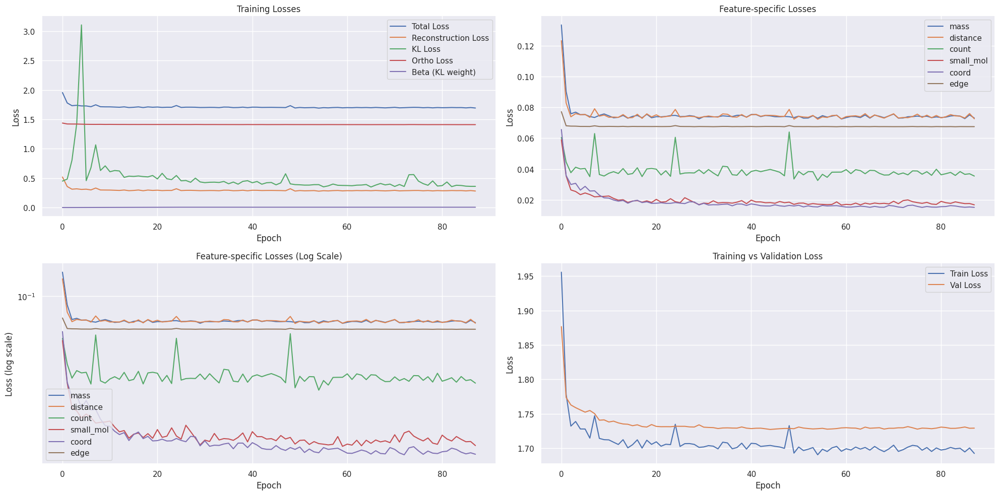

Epoch 89/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 18.91it/s, loss=1.6931, recon=0.2829, kl=0.3332, ortho=1.4086]


Detailed loss diagnostics:
Raw recon_loss: 0.2848
Raw KL loss: 0.3318
Ortho loss: 1.4089
Current beta: 0.0050
mu mean: 0.0389, std: 0.5457
logvar mean: -0.6460, std: 1.1419
mass: 0.0820
distance: 0.0787
count: 0.0265
small_mol: 0.0146
coord: 0.0158
edge: 0.0673


Epoch 89/100 [Train]:  31%|███       | 13/42 [00:00<00:01, 19.77it/s, loss=1.6722, recon=0.2619, kl=0.2962, ortho=1.4088]


Detailed loss diagnostics:
Raw recon_loss: 0.2738
Raw KL loss: 0.3029
Ortho loss: 1.4097
Current beta: 0.0050
mu mean: 0.0066, std: 0.4893
logvar mean: -0.6424, std: 1.1566
mass: 0.0771
distance: 0.0725
count: 0.0262
small_mol: 0.0160
coord: 0.0155
edge: 0.0666


Epoch 89/100 [Train]:  52%|█████▏    | 22/42 [00:01<00:01, 19.05it/s, loss=1.6742, recon=0.2627, kl=0.3405, ortho=1.4098]


Detailed loss diagnostics:
Raw recon_loss: 0.2660
Raw KL loss: 0.3274
Ortho loss: 1.4088
Current beta: 0.0050
mu mean: -0.0453, std: 0.5231
logvar mean: -0.6706, std: 1.1665
mass: 0.0727
distance: 0.0723
count: 0.0260
small_mol: 0.0125
coord: 0.0160
edge: 0.0665


Epoch 89/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 19.02it/s, loss=1.7010, recon=0.2893, kl=0.3057, ortho=1.4102]


Detailed loss diagnostics:
Raw recon_loss: 0.3501
Raw KL loss: 0.3405
Ortho loss: 1.4091
Current beta: 0.0050
mu mean: -0.0299, std: 0.5503
logvar mean: -0.6559, std: 1.1749
mass: 0.0696
distance: 0.0846
count: 0.0957
small_mol: 0.0153
coord: 0.0161
edge: 0.0689


Epoch 89/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.14it/s, loss=1.7997, recon=0.3661, kl=0.3627, ortho=1.4318]



Detailed loss diagnostics:
Raw recon_loss: 0.3980
Raw KL loss: 0.3239
Ortho loss: 1.4088
Current beta: 0.0050
mu mean: -0.0095, std: 0.5168
logvar mean: -0.6648, std: 1.1830
mass: 0.0782
distance: 0.0936
count: 0.1222
small_mol: 0.0199
coord: 0.0131
edge: 0.0711

Starting validation...


Epoch 89/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 64.64it/s]



Epoch [89/100] - Time: 2.53s
Train - Total: 1.6992, Recon: 0.2876, KL: 0.3459, Ortho: 1.4099, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0737
  distance_loss: 0.0741
  count_loss: 0.0393
  small_mol_loss: 0.0172
  coord_loss: 0.0157
  edge_loss: 0.0675


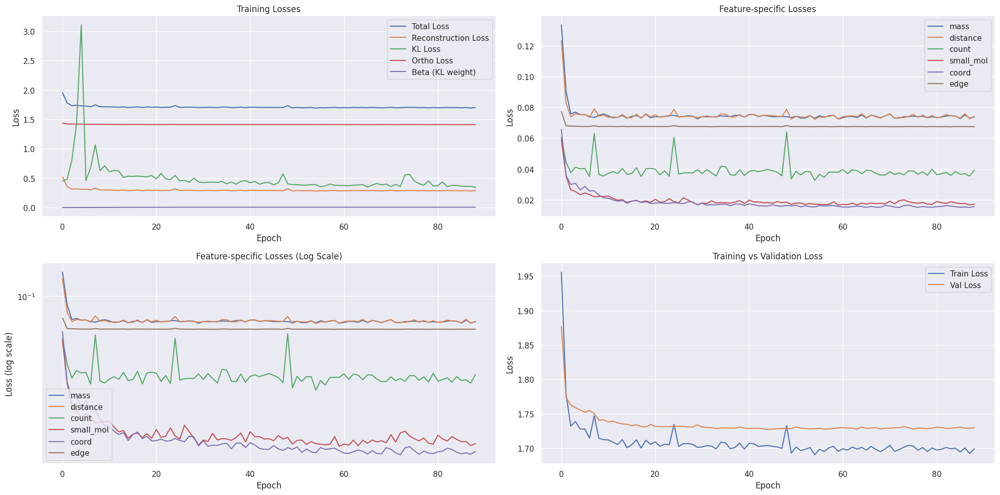

Epoch 90/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 18.00it/s, loss=1.6428, recon=0.2326, kl=0.3807, ortho=1.4084]


Detailed loss diagnostics:
Raw recon_loss: 0.2908
Raw KL loss: 0.3486
Ortho loss: 1.4097
Current beta: 0.0050
mu mean: 0.0122, std: 0.5519
logvar mean: -0.6986, std: 1.1824
mass: 0.0623
distance: 0.0669
count: 0.0688
small_mol: 0.0118
coord: 0.0129
edge: 0.0681


Epoch 90/100 [Train]:  29%|██▊       | 12/42 [00:00<00:01, 19.38it/s, loss=1.6726, recon=0.2620, kl=0.2804, ortho=1.4092]


Detailed loss diagnostics:
Raw recon_loss: 0.2722
Raw KL loss: 0.4108
Ortho loss: 1.4095
Current beta: 0.0050
mu mean: -0.0241, std: 0.6493
logvar mean: -0.6843, std: 1.2198
mass: 0.0681
distance: 0.0660
count: 0.0255
small_mol: 0.0185
coord: 0.0259
edge: 0.0681


Epoch 90/100 [Train]:  55%|█████▍    | 23/42 [00:01<00:00, 19.59it/s, loss=1.6493, recon=0.2386, kl=0.3220, ortho=1.4091]


Detailed loss diagnostics:
Raw recon_loss: 0.2613
Raw KL loss: 0.3225
Ortho loss: 1.4105
Current beta: 0.0050
mu mean: -0.0245, std: 0.5315
logvar mean: -0.6215, std: 1.1619
mass: 0.0720
distance: 0.0724
count: 0.0260
small_mol: 0.0093
coord: 0.0142
edge: 0.0673


Epoch 90/100 [Train]:  79%|███████▊  | 33/42 [00:01<00:00, 19.67it/s, loss=1.7136, recon=0.3014, kl=0.3256, ortho=1.4106]


Detailed loss diagnostics:
Raw recon_loss: 0.2643
Raw KL loss: 0.3355
Ortho loss: 1.4107
Current beta: 0.0050
mu mean: 0.0152, std: 0.5439
logvar mean: -0.6307, std: 1.1896
mass: 0.0727
distance: 0.0717
count: 0.0260
small_mol: 0.0132
coord: 0.0146
edge: 0.0661


Epoch 90/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.80it/s, loss=1.8766, recon=0.4464, kl=0.3436, ortho=1.4285]



Detailed loss diagnostics:
Raw recon_loss: 0.2644
Raw KL loss: 0.2910
Ortho loss: 1.4104
Current beta: 0.0050
mu mean: -0.0148, std: 0.4508
logvar mean: -0.6411, std: 1.2044
mass: 0.0710
distance: 0.0682
count: 0.0257
small_mol: 0.0199
coord: 0.0125
edge: 0.0672

Starting validation...


Epoch 90/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 67.26it/s]



Epoch [90/100] - Time: 2.44s
Train - Total: 1.6980, Recon: 0.2862, KL: 0.3480, Ortho: 1.4101, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0740
  distance_loss: 0.0740
  count_loss: 0.0370
  small_mol_loss: 0.0186
  coord_loss: 0.0150
  edge_loss: 0.0674


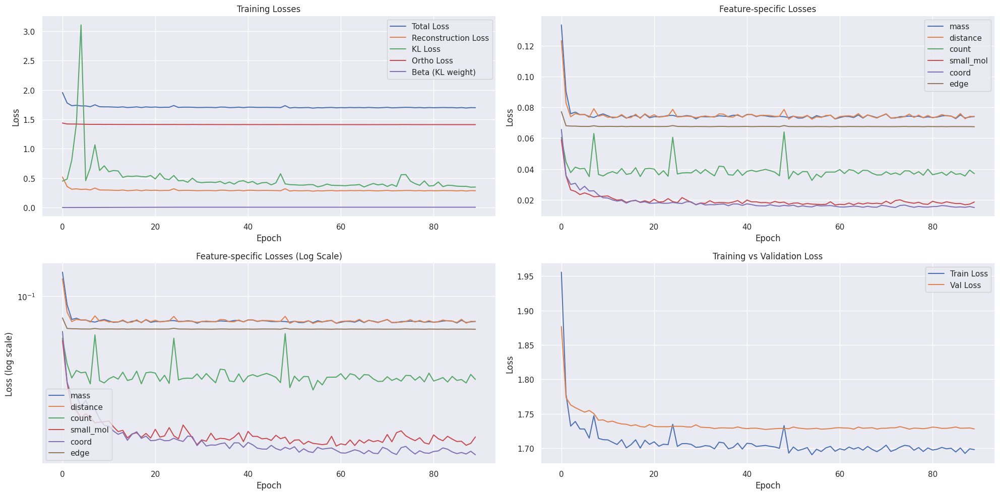

Epoch 91/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 18.29it/s, loss=1.7229, recon=0.3109, kl=0.3535, ortho=1.4102]


Detailed loss diagnostics:
Raw recon_loss: 0.2765
Raw KL loss: 0.3329
Ortho loss: 1.4102
Current beta: 0.0050
mu mean: -0.0128, std: 0.5185
logvar mean: -0.7086, std: 1.1975
mass: 0.0770
distance: 0.0749
count: 0.0262
small_mol: 0.0172
coord: 0.0137
edge: 0.0675


Epoch 91/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 19.76it/s, loss=1.6645, recon=0.2519, kl=0.5263, ortho=1.4100]


Detailed loss diagnostics:
Raw recon_loss: 0.4779
Raw KL loss: 0.4833
Ortho loss: 1.4086
Current beta: 0.0050
mu mean: 0.0177, std: 0.6888
logvar mean: -0.8266, std: 1.3901
mass: 0.0807
distance: 0.0986
count: 0.1931
small_mol: 0.0173
coord: 0.0187
edge: 0.0696


Epoch 91/100 [Train]:  55%|█████▍    | 23/42 [00:01<00:00, 19.08it/s, loss=1.6919, recon=0.2800, kl=0.3425, ortho=1.4101]


Detailed loss diagnostics:
Raw recon_loss: 0.3814
Raw KL loss: 0.3713
Ortho loss: 1.4093
Current beta: 0.0050
mu mean: -0.0059, std: 0.5774
logvar mean: -0.7190, std: 1.2237
mass: 0.0775
distance: 0.0947
count: 0.1059
small_mol: 0.0135
coord: 0.0185
edge: 0.0713


Epoch 91/100 [Train]:  76%|███████▌  | 32/42 [00:01<00:00, 18.95it/s, loss=1.6897, recon=0.2796, kl=0.3526, ortho=1.4083]


Detailed loss diagnostics:
Raw recon_loss: 0.3128
Raw KL loss: 0.3433
Ortho loss: 1.4100
Current beta: 0.0050
mu mean: -0.0051, std: 0.5237
logvar mean: -0.7073, std: 1.2556
mass: 0.0876
distance: 0.0795
count: 0.0268
small_mol: 0.0353
coord: 0.0166
edge: 0.0670


Epoch 91/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.32it/s, loss=1.8104, recon=0.3800, kl=0.3402, ortho=1.4287]



Detailed loss diagnostics:
Raw recon_loss: 0.2570
Raw KL loss: 0.3598
Ortho loss: 1.4090
Current beta: 0.0050
mu mean: -0.0071, std: 0.5426
logvar mean: -0.7477, std: 1.2525
mass: 0.0685
distance: 0.0664
count: 0.0256
small_mol: 0.0177
coord: 0.0128
edge: 0.0660

Starting validation...


Epoch 91/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 70.48it/s]



Epoch [91/100] - Time: 2.48s
Train - Total: 1.7054, Recon: 0.2934, KL: 0.3835, Ortho: 1.4101, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0754
  distance_loss: 0.0752
  count_loss: 0.0403
  small_mol_loss: 0.0189
  coord_loss: 0.0161
  edge_loss: 0.0675


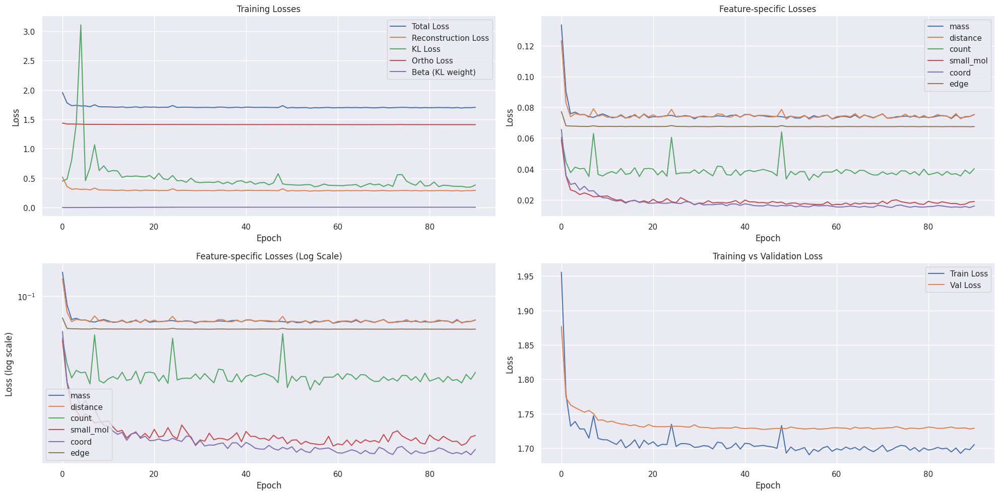

Epoch 92/100 [Train]:   5%|▍         | 2/42 [00:00<00:02, 18.96it/s, loss=1.6913, recon=0.2795, kl=0.3912, ortho=1.4098]


Detailed loss diagnostics:
Raw recon_loss: 0.2361
Raw KL loss: 0.4535
Ortho loss: 1.4104
Current beta: 0.0050
mu mean: 0.0213, std: 0.6484
logvar mean: -0.8509, std: 1.3430
mass: 0.0616
distance: 0.0622
count: 0.0251
small_mol: 0.0119
coord: 0.0096
edge: 0.0657


Epoch 92/100 [Train]:  31%|███       | 13/42 [00:00<00:01, 19.50it/s, loss=1.7294, recon=0.3165, kl=0.5308, ortho=1.4102]


Detailed loss diagnostics:
Raw recon_loss: 0.2615
Raw KL loss: 0.5457
Ortho loss: 1.4091
Current beta: 0.0050
mu mean: 0.0075, std: 0.6366
logvar mean: -1.1679, std: 1.6310
mass: 0.0711
distance: 0.0715
count: 0.0258
small_mol: 0.0126
coord: 0.0135
edge: 0.0671


Epoch 92/100 [Train]:  57%|█████▋    | 24/42 [00:01<00:00, 20.18it/s, loss=1.8094, recon=0.3969, kl=0.4998, ortho=1.4100]


Detailed loss diagnostics:
Raw recon_loss: 0.3051
Raw KL loss: 0.8194
Ortho loss: 1.4088
Current beta: 0.0050
mu mean: 0.0551, std: 0.9334
logvar mean: -1.2385, std: 1.7849
mass: 0.0887
distance: 0.0755
count: 0.0264
small_mol: 0.0221
coord: 0.0249
edge: 0.0676


Epoch 92/100 [Train]:  79%|███████▊  | 33/42 [00:01<00:00, 18.49it/s, loss=1.6865, recon=0.2757, kl=0.3282, ortho=1.4092]


Detailed loss diagnostics:
Raw recon_loss: 0.3000
Raw KL loss: 0.3949
Ortho loss: 1.4101
Current beta: 0.0050
mu mean: 0.0222, std: 0.5894
logvar mean: -0.7563, std: 1.3071
mass: 0.0632
distance: 0.0702
count: 0.0780
small_mol: 0.0082
coord: 0.0095
edge: 0.0710


Epoch 92/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.49it/s, loss=1.7701, recon=0.3408, kl=0.2657, ortho=1.4279]



Detailed loss diagnostics:
Raw recon_loss: 0.2880
Raw KL loss: 0.4280
Ortho loss: 1.4091
Current beta: 0.0050
mu mean: -0.0354, std: 0.6161
logvar mean: -0.7695, std: 1.4070
mass: 0.0800
distance: 0.0751
count: 0.0264
small_mol: 0.0196
coord: 0.0196
edge: 0.0674

Starting validation...


Epoch 92/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 67.28it/s]



Epoch [92/100] - Time: 2.48s
Train - Total: 1.6940, Recon: 0.2813, KL: 0.4986, Ortho: 1.4103, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0738
  distance_loss: 0.0729
  count_loss: 0.0348
  small_mol_loss: 0.0173
  coord_loss: 0.0149
  edge_loss: 0.0675


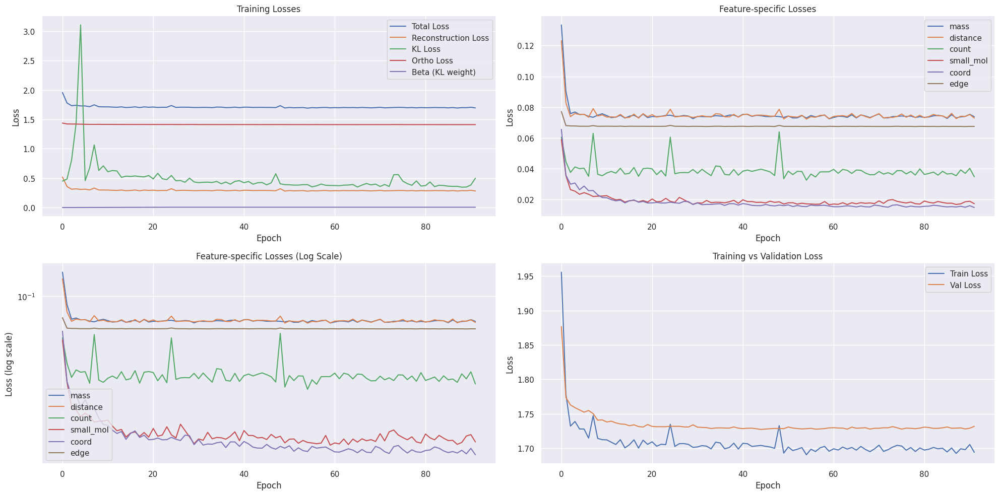

Epoch 93/100 [Train]:   5%|▍         | 2/42 [00:00<00:02, 16.79it/s, loss=1.8253, recon=0.4149, kl=0.3821, ortho=1.4085]


Detailed loss diagnostics:
Raw recon_loss: 0.2390
Raw KL loss: 0.4345
Ortho loss: 1.4088
Current beta: 0.0050
mu mean: -0.0034, std: 0.6412
logvar mean: -0.7649, std: 1.3464
mass: 0.0627
distance: 0.0621
count: 0.0251
small_mol: 0.0126
coord: 0.0099
edge: 0.0665


Epoch 93/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 20.68it/s, loss=1.6588, recon=0.2486, kl=0.3733, ortho=1.4083]


Detailed loss diagnostics:
Raw recon_loss: 0.2580
Raw KL loss: 0.5460
Ortho loss: 1.4112
Current beta: 0.0050
mu mean: 0.0267, std: 0.7519
logvar mean: -0.9104, std: 1.4005
mass: 0.0663
distance: 0.0651
count: 0.0254
small_mol: 0.0146
coord: 0.0189
edge: 0.0677


Epoch 93/100 [Train]:  52%|█████▏    | 22/42 [00:01<00:01, 19.69it/s, loss=1.6684, recon=0.2579, kl=0.3017, ortho=1.4090]


Detailed loss diagnostics:
Raw recon_loss: 0.2834
Raw KL loss: 0.3510
Ortho loss: 1.4102
Current beta: 0.0050
mu mean: -0.0342, std: 0.5586
logvar mean: -0.6657, std: 1.2159
mass: 0.0787
distance: 0.0785
count: 0.0265
small_mol: 0.0127
coord: 0.0200
edge: 0.0671


Epoch 93/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 20.69it/s, loss=1.6447, recon=0.2333, kl=0.3968, ortho=1.4094]


Detailed loss diagnostics:
Raw recon_loss: 0.2745
Raw KL loss: 0.4920
Ortho loss: 1.4096
Current beta: 0.0050
mu mean: -0.0120, std: 0.7158
logvar mean: -0.7687, std: 1.3885
mass: 0.0730
distance: 0.0723
count: 0.0259
small_mol: 0.0130
coord: 0.0228
edge: 0.0675


Epoch 93/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 20.08it/s, loss=1.7866, recon=0.3595, kl=0.3469, ortho=1.4254]



Detailed loss diagnostics:
Raw recon_loss: 0.2287
Raw KL loss: 0.3734
Ortho loss: 1.4103
Current beta: 0.0050
mu mean: 0.0018, std: 0.5823
logvar mean: -0.6877, std: 1.2593
mass: 0.0613
distance: 0.0592
count: 0.0250
small_mol: 0.0083
coord: 0.0082
edge: 0.0667

Starting validation...


Epoch 93/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 68.04it/s]



Epoch [93/100] - Time: 2.41s
Train - Total: 1.6995, Recon: 0.2876, KL: 0.3805, Ortho: 1.4100, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0744
  distance_loss: 0.0749
  count_loss: 0.0375
  small_mol_loss: 0.0177
  coord_loss: 0.0156
  edge_loss: 0.0675


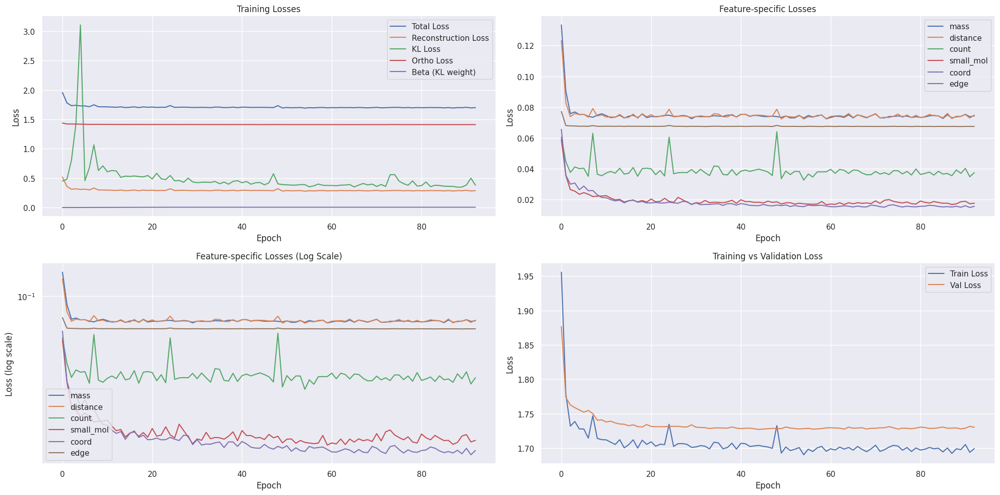

Epoch 94/100 [Train]:   7%|▋         | 3/42 [00:00<00:01, 20.98it/s, loss=1.6791, recon=0.2685, kl=0.3168, ortho=1.4090]


Detailed loss diagnostics:
Raw recon_loss: 0.2600
Raw KL loss: 0.2913
Ortho loss: 1.4100
Current beta: 0.0050
mu mean: 0.0489, std: 0.4634
logvar mean: -0.6140, std: 1.1866
mass: 0.0720
distance: 0.0672
count: 0.0257
small_mol: 0.0156
coord: 0.0127
edge: 0.0669


Epoch 94/100 [Train]:  31%|███       | 13/42 [00:00<00:01, 18.37it/s, loss=1.6590, recon=0.2477, kl=0.3228, ortho=1.4097]


Detailed loss diagnostics:
Raw recon_loss: 0.4297
Raw KL loss: 0.3729
Ortho loss: 1.4102
Current beta: 0.0050
mu mean: -0.0317, std: 0.5643
logvar mean: -0.7432, std: 1.2656
mass: 0.0822
distance: 0.0969
count: 0.1405
small_mol: 0.0250
coord: 0.0138
edge: 0.0714


Epoch 94/100 [Train]:  57%|█████▋    | 24/42 [00:01<00:00, 20.37it/s, loss=1.6827, recon=0.2718, kl=0.3705, ortho=1.4090]


Detailed loss diagnostics:
Raw recon_loss: 0.2739
Raw KL loss: 0.3146
Ortho loss: 1.4094
Current beta: 0.0050
mu mean: 0.0034, std: 0.5098
logvar mean: -0.6464, std: 1.1658
mass: 0.0775
distance: 0.0741
count: 0.0262
small_mol: 0.0145
coord: 0.0140
edge: 0.0676


Epoch 94/100 [Train]:  79%|███████▊  | 33/42 [00:01<00:00, 19.94it/s, loss=1.8295, recon=0.4187, kl=0.3192, ortho=1.4092]


Detailed loss diagnostics:
Raw recon_loss: 0.4098
Raw KL loss: 0.3492
Ortho loss: 1.4091
Current beta: 0.0050
mu mean: -0.0267, std: 0.5617
logvar mean: -0.6700, std: 1.1816
mass: 0.0776
distance: 0.0992
count: 0.1317
small_mol: 0.0123
coord: 0.0195
edge: 0.0696


Epoch 94/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.62it/s, loss=1.7289, recon=0.2947, kl=0.3170, ortho=1.4326]



Detailed loss diagnostics:
Raw recon_loss: 0.2460
Raw KL loss: 0.3867
Ortho loss: 1.4092
Current beta: 0.0050
mu mean: -0.0304, std: 0.5983
logvar mean: -0.6897, std: 1.2810
mass: 0.0640
distance: 0.0636
count: 0.0253
small_mol: 0.0103
coord: 0.0165
edge: 0.0663

Starting validation...


Epoch 94/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 68.98it/s]



Epoch [94/100] - Time: 2.45s
Train - Total: 1.6949, Recon: 0.2830, KL: 0.3564, Ortho: 1.4101, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0725
  distance_loss: 0.0730
  count_loss: 0.0386
  small_mol_loss: 0.0166
  coord_loss: 0.0147
  edge_loss: 0.0675


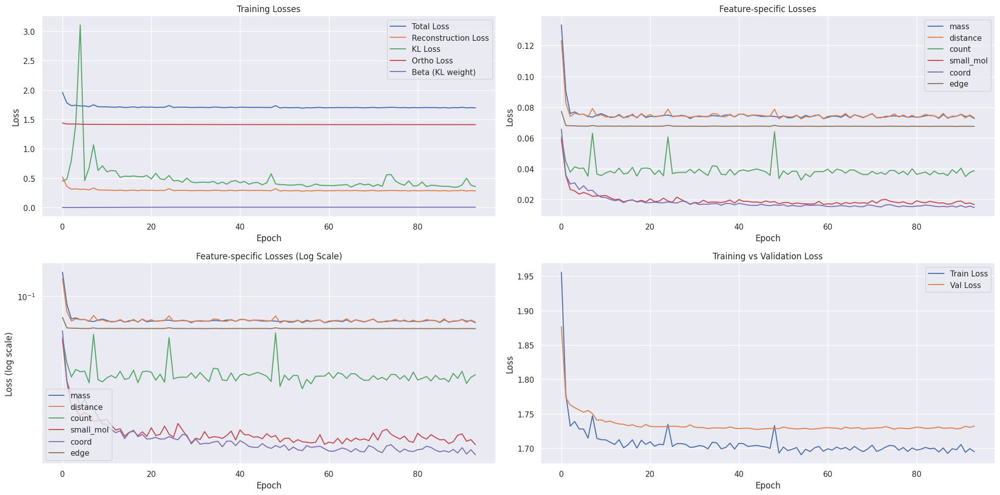

Epoch 95/100 [Train]:   7%|▋         | 3/42 [00:00<00:01, 20.77it/s, loss=1.6707, recon=0.2589, kl=0.3110, ortho=1.4102]


Detailed loss diagnostics:
Raw recon_loss: 0.2865
Raw KL loss: 0.3572
Ortho loss: 1.4084
Current beta: 0.0050
mu mean: 0.0063, std: 0.5632
logvar mean: -0.6978, std: 1.2065
mass: 0.0791
distance: 0.0759
count: 0.0265
small_mol: 0.0216
coord: 0.0166
edge: 0.0668


Epoch 95/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 18.91it/s, loss=1.6984, recon=0.2862, kl=0.4162, ortho=1.4101]


Detailed loss diagnostics:
Raw recon_loss: 0.2746
Raw KL loss: 0.2953
Ortho loss: 1.4097
Current beta: 0.0050
mu mean: -0.0274, std: 0.4851
logvar mean: -0.5908, std: 1.1648
mass: 0.0784
distance: 0.0761
count: 0.0262
small_mol: 0.0134
coord: 0.0133
edge: 0.0671


Epoch 95/100 [Train]:  57%|█████▋    | 24/42 [00:01<00:00, 19.01it/s, loss=1.6876, recon=0.2772, kl=0.4085, ortho=1.4084]


Detailed loss diagnostics:
Raw recon_loss: 0.2580
Raw KL loss: 0.2835
Ortho loss: 1.4105
Current beta: 0.0050
mu mean: -0.0551, std: 0.4600
logvar mean: -0.5974, std: 1.1612
mass: 0.0714
distance: 0.0709
count: 0.0259
small_mol: 0.0106
coord: 0.0126
edge: 0.0665


Epoch 95/100 [Train]:  79%|███████▊  | 33/42 [00:01<00:00, 18.93it/s, loss=1.6963, recon=0.2845, kl=0.3337, ortho=1.4102]


Detailed loss diagnostics:
Raw recon_loss: 0.2423
Raw KL loss: 0.4307
Ortho loss: 1.4103
Current beta: 0.0050
mu mean: -0.0147, std: 0.6755
logvar mean: -0.7104, std: 1.2125
mass: 0.0630
distance: 0.0624
count: 0.0252
small_mol: 0.0140
coord: 0.0112
edge: 0.0664


Epoch 95/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.18it/s, loss=1.7474, recon=0.3057, kl=0.3348, ortho=1.4400]



Detailed loss diagnostics:
Raw recon_loss: 0.3040
Raw KL loss: 0.4153
Ortho loss: 1.4087
Current beta: 0.0050
mu mean: 0.0279, std: 0.6594
logvar mean: -0.6654, std: 1.2236
mass: 0.0631
distance: 0.0699
count: 0.0748
small_mol: 0.0158
coord: 0.0087
edge: 0.0717

Starting validation...


Epoch 95/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 67.46it/s]



Epoch [95/100] - Time: 2.51s
Train - Total: 1.6923, Recon: 0.2805, KL: 0.3320, Ortho: 1.4101, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0733
  distance_loss: 0.0728
  count_loss: 0.0343
  small_mol_loss: 0.0169
  coord_loss: 0.0156
  edge_loss: 0.0676


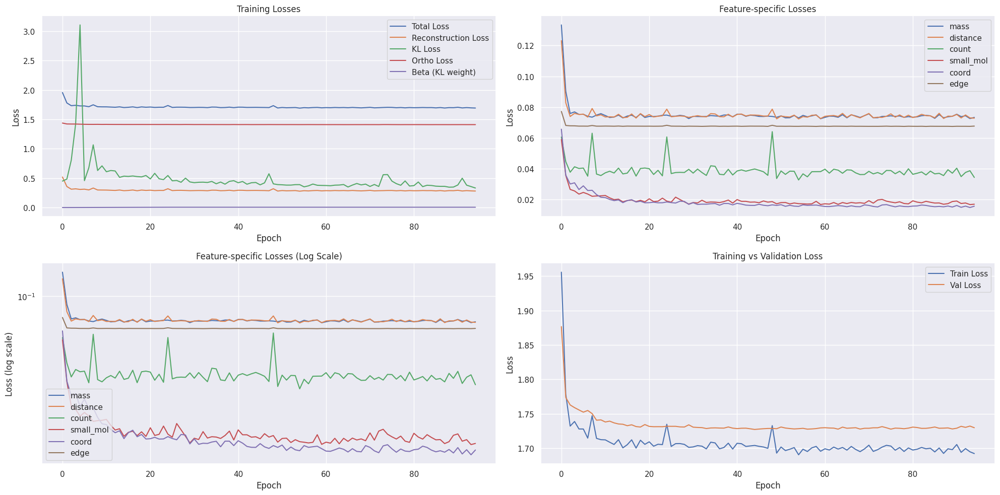

Epoch 96/100 [Train]:   5%|▍         | 2/42 [00:00<00:02, 17.15it/s, loss=1.7016, recon=0.2881, kl=0.3996, ortho=1.4115]


Detailed loss diagnostics:
Raw recon_loss: 0.2832
Raw KL loss: 0.2817
Ortho loss: 1.4091
Current beta: 0.0050
mu mean: 0.0020, std: 0.4409
logvar mean: -0.6214, std: 1.1969
mass: 0.0779
distance: 0.0736
count: 0.0260
small_mol: 0.0198
coord: 0.0168
edge: 0.0690


Epoch 96/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 19.04it/s, loss=1.6849, recon=0.2739, kl=0.3268, ortho=1.4093]


Detailed loss diagnostics:
Raw recon_loss: 0.3914
Raw KL loss: 0.3122
Ortho loss: 1.4093
Current beta: 0.0050
mu mean: 0.0200, std: 0.5293
logvar mean: -0.5748, std: 1.1436
mass: 0.0744
distance: 0.0911
count: 0.1240
small_mol: 0.0184
coord: 0.0122
edge: 0.0713


Epoch 96/100 [Train]:  52%|█████▏    | 22/42 [00:01<00:00, 20.20it/s, loss=1.6878, recon=0.2762, kl=0.3399, ortho=1.4099]


Detailed loss diagnostics:
Raw recon_loss: 0.3882
Raw KL loss: 0.3026
Ortho loss: 1.4100
Current beta: 0.0050
mu mean: -0.0514, std: 0.4869
logvar mean: -0.6218, std: 1.1762
mass: 0.0736
distance: 0.0831
count: 0.1396
small_mol: 0.0105
coord: 0.0120
edge: 0.0694


Epoch 96/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 19.86it/s, loss=1.6913, recon=0.2809, kl=0.3349, ortho=1.4087]


Detailed loss diagnostics:
Raw recon_loss: 0.2651
Raw KL loss: 0.3814
Ortho loss: 1.4094
Current beta: 0.0050
mu mean: 0.0321, std: 0.5892
logvar mean: -0.7178, std: 1.2467
mass: 0.0678
distance: 0.0644
count: 0.0253
small_mol: 0.0149
coord: 0.0250
edge: 0.0676


Epoch 96/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.83it/s, loss=1.7381, recon=0.3052, kl=0.2521, ortho=1.4316]



Detailed loss diagnostics:
Raw recon_loss: 0.2485
Raw KL loss: 0.2823
Ortho loss: 1.4096
Current beta: 0.0050
mu mean: 0.0159, std: 0.4577
logvar mean: -0.6053, std: 1.1569
mass: 0.0680
distance: 0.0665
count: 0.0255
small_mol: 0.0132
coord: 0.0089
edge: 0.0665

Starting validation...


Epoch 96/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 69.89it/s]



Epoch [96/100] - Time: 2.43s
Train - Total: 1.6956, Recon: 0.2838, KL: 0.3395, Ortho: 1.4101, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0736
  distance_loss: 0.0736
  count_loss: 0.0378
  small_mol_loss: 0.0165
  coord_loss: 0.0147
  edge_loss: 0.0675


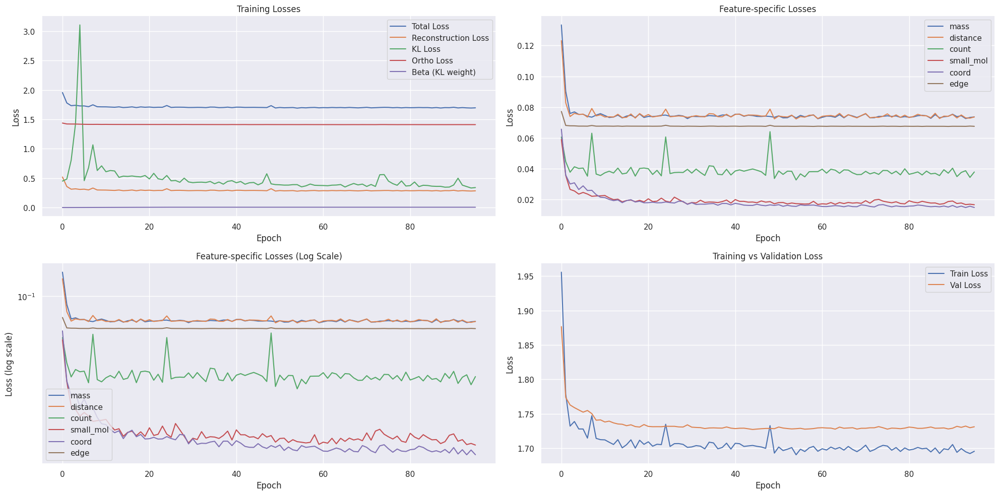

Epoch 97/100 [Train]:   5%|▍         | 2/42 [00:00<00:02, 19.10it/s, loss=1.7011, recon=0.2897, kl=0.4414, ortho=1.4092]


Detailed loss diagnostics:
Raw recon_loss: 0.3716
Raw KL loss: 0.3584
Ortho loss: 1.4090
Current beta: 0.0050
mu mean: 0.0293, std: 0.5640
logvar mean: -0.7069, std: 1.2002
mass: 0.0721
distance: 0.0830
count: 0.1130
small_mol: 0.0164
coord: 0.0157
edge: 0.0714


Epoch 97/100 [Train]:  31%|███       | 13/42 [00:00<00:01, 20.24it/s, loss=1.8209, recon=0.4085, kl=0.3442, ortho=1.4107]


Detailed loss diagnostics:
Raw recon_loss: 0.2598
Raw KL loss: 0.3356
Ortho loss: 1.4089
Current beta: 0.0050
mu mean: 0.0664, std: 0.5039
logvar mean: -0.7268, std: 1.2440
mass: 0.0704
distance: 0.0684
count: 0.0257
small_mol: 0.0170
coord: 0.0106
edge: 0.0677


Epoch 97/100 [Train]:  52%|█████▏    | 22/42 [00:01<00:00, 20.34it/s, loss=1.6851, recon=0.2747, kl=0.3618, ortho=1.4086]


Detailed loss diagnostics:
Raw recon_loss: 0.2722
Raw KL loss: 0.3410
Ortho loss: 1.4092
Current beta: 0.0050
mu mean: -0.0228, std: 0.5417
logvar mean: -0.6728, std: 1.2123
mass: 0.0739
distance: 0.0725
count: 0.0261
small_mol: 0.0199
coord: 0.0125
edge: 0.0673


Epoch 97/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 19.98it/s, loss=1.7207, recon=0.3092, kl=0.3911, ortho=1.4095]


Detailed loss diagnostics:
Raw recon_loss: 0.2635
Raw KL loss: 0.3084
Ortho loss: 1.4096
Current beta: 0.0050
mu mean: 0.0178, std: 0.4797
logvar mean: -0.6618, std: 1.2167
mass: 0.0731
distance: 0.0697
count: 0.0260
small_mol: 0.0151
coord: 0.0132
edge: 0.0665


Epoch 97/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.89it/s, loss=1.8616, recon=0.4324, kl=0.3971, ortho=1.4272]



Detailed loss diagnostics:
Raw recon_loss: 0.3255
Raw KL loss: 0.3730
Ortho loss: 1.4102
Current beta: 0.0050
mu mean: 0.0343, std: 0.5526
logvar mean: -0.7598, std: 1.2939
mass: 0.0803
distance: 0.0846
count: 0.0375
small_mol: 0.0280
coord: 0.0260
edge: 0.0690

Starting validation...


Epoch 97/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 67.38it/s]



Epoch [97/100] - Time: 2.43s
Train - Total: 1.7008, Recon: 0.2890, KL: 0.3717, Ortho: 1.4100, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0742
  distance_loss: 0.0746
  count_loss: 0.0388
  small_mol_loss: 0.0186
  coord_loss: 0.0152
  edge_loss: 0.0675


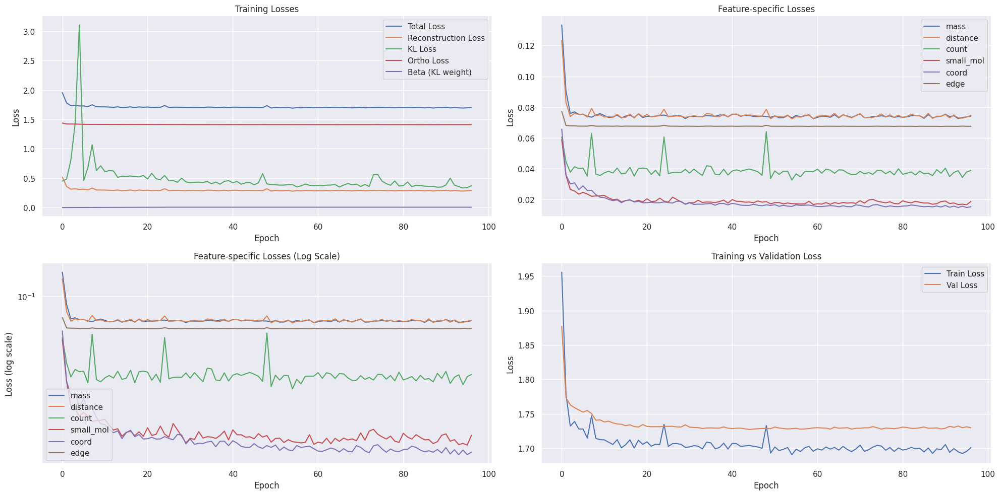

Epoch 98/100 [Train]:   5%|▍         | 2/42 [00:00<00:02, 19.64it/s, loss=1.6822, recon=0.2702, kl=0.3929, ortho=1.4100]


Detailed loss diagnostics:
Raw recon_loss: 0.2468
Raw KL loss: 0.3319
Ortho loss: 1.4088
Current beta: 0.0050
mu mean: 0.0212, std: 0.5135
logvar mean: -0.6948, std: 1.2383
mass: 0.0647
distance: 0.0640
count: 0.0253
small_mol: 0.0152
coord: 0.0106
edge: 0.0669


Epoch 98/100 [Train]:  29%|██▊       | 12/42 [00:00<00:01, 19.78it/s, loss=1.6795, recon=0.2675, kl=0.3028, ortho=1.4104]


Detailed loss diagnostics:
Raw recon_loss: 0.2715
Raw KL loss: 0.3189
Ortho loss: 1.4103
Current beta: 0.0050
mu mean: -0.0047, std: 0.4894
logvar mean: -0.6769, std: 1.2472
mass: 0.0756
distance: 0.0712
count: 0.0259
small_mol: 0.0165
coord: 0.0142
edge: 0.0680


Epoch 98/100 [Train]:  57%|█████▋    | 24/42 [00:01<00:00, 20.17it/s, loss=1.6823, recon=0.2714, kl=0.3126, ortho=1.4094]


Detailed loss diagnostics:
Raw recon_loss: 0.2665
Raw KL loss: 0.3149
Ortho loss: 1.4091
Current beta: 0.0050
mu mean: -0.0179, std: 0.4850
logvar mean: -0.6803, std: 1.2267
mass: 0.0763
distance: 0.0726
count: 0.0261
small_mol: 0.0116
coord: 0.0135
edge: 0.0664


Epoch 98/100 [Train]:  79%|███████▊  | 33/42 [00:01<00:00, 19.12it/s, loss=1.6971, recon=0.2851, kl=0.3342, ortho=1.4103]


Detailed loss diagnostics:
Raw recon_loss: 0.3137
Raw KL loss: 0.5617
Ortho loss: 1.4090
Current beta: 0.0050
mu mean: 0.0466, std: 0.7736
logvar mean: -0.8730, std: 1.4533
mass: 0.0650
distance: 0.0719
count: 0.0747
small_mol: 0.0136
coord: 0.0167
edge: 0.0719


Epoch 98/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.81it/s, loss=1.7842, recon=0.3547, kl=0.2997, ortho=1.4279]



Detailed loss diagnostics:
Raw recon_loss: 0.3982
Raw KL loss: 0.3534
Ortho loss: 1.4092
Current beta: 0.0050
mu mean: -0.0486, std: 0.5481
logvar mean: -0.6928, std: 1.2495
mass: 0.0777
distance: 0.0957
count: 0.1178
small_mol: 0.0229
coord: 0.0132
edge: 0.0709

Starting validation...


Epoch 98/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 68.29it/s]



Epoch [98/100] - Time: 2.43s
Train - Total: 1.6946, Recon: 0.2826, KL: 0.3585, Ortho: 1.4102, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0733
  distance_loss: 0.0731
  count_loss: 0.0357
  small_mol_loss: 0.0180
  coord_loss: 0.0151
  edge_loss: 0.0674


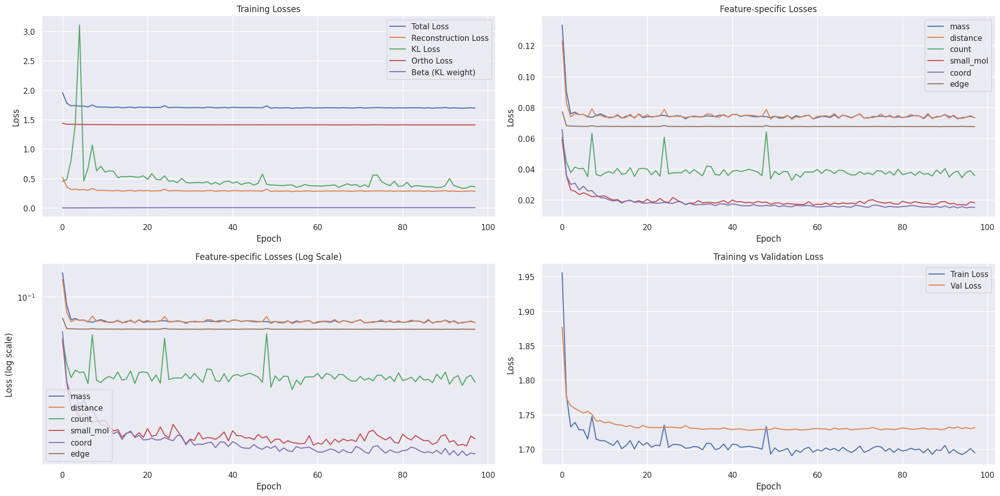

Epoch 99/100 [Train]:   5%|▍         | 2/42 [00:00<00:02, 17.16it/s, loss=1.7021, recon=0.2906, kl=0.4278, ortho=1.4094]


Detailed loss diagnostics:
Raw recon_loss: 0.2670
Raw KL loss: 0.3978
Ortho loss: 1.4103
Current beta: 0.0050
mu mean: -0.0193, std: 0.5998
logvar mean: -0.7394, std: 1.2939
mass: 0.0736
distance: 0.0725
count: 0.0261
small_mol: 0.0125
coord: 0.0163
edge: 0.0662


Epoch 99/100 [Train]:  31%|███       | 13/42 [00:00<00:01, 18.37it/s, loss=1.8403, recon=0.4284, kl=0.3895, ortho=1.4100]


Detailed loss diagnostics:
Raw recon_loss: 0.2364
Raw KL loss: 0.3780
Ortho loss: 1.4092
Current beta: 0.0050
mu mean: -0.0127, std: 0.5426
logvar mean: -0.7847, std: 1.3510
mass: 0.0604
distance: 0.0596
count: 0.0250
small_mol: 0.0113
coord: 0.0131
edge: 0.0669


Epoch 99/100 [Train]:  57%|█████▋    | 24/42 [00:01<00:00, 19.43it/s, loss=1.7013, recon=0.2889, kl=0.5354, ortho=1.4097]


Detailed loss diagnostics:
Raw recon_loss: 0.4166
Raw KL loss: 0.4100
Ortho loss: 1.4097
Current beta: 0.0050
mu mean: -0.0107, std: 0.5690
logvar mean: -0.8483, std: 1.3911
mass: 0.0773
distance: 0.1006
count: 0.1315
small_mol: 0.0262
coord: 0.0120
edge: 0.0690


Epoch 99/100 [Train]:  79%|███████▊  | 33/42 [00:01<00:00, 20.41it/s, loss=1.7071, recon=0.2956, kl=0.4337, ortho=1.4093]


Detailed loss diagnostics:
Raw recon_loss: 0.2411
Raw KL loss: 0.3286
Ortho loss: 1.4096
Current beta: 0.0050
mu mean: -0.0361, std: 0.5116
logvar mean: -0.6556, std: 1.2427
mass: 0.0654
distance: 0.0653
count: 0.0254
small_mol: 0.0073
coord: 0.0108
edge: 0.0669


Epoch 99/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.80it/s, loss=1.8203, recon=0.3927, kl=0.3925, ortho=1.4256]



Detailed loss diagnostics:
Raw recon_loss: 0.2567
Raw KL loss: 0.4884
Ortho loss: 1.4094
Current beta: 0.0050
mu mean: -0.0228, std: 0.7314
logvar mean: -0.7370, std: 1.3273
mass: 0.0663
distance: 0.0640
count: 0.0254
small_mol: 0.0131
coord: 0.0215
edge: 0.0664

Starting validation...


Epoch 99/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 68.00it/s]



Epoch [99/100] - Time: 2.44s
Train - Total: 1.6982, Recon: 0.2862, KL: 0.3897, Ortho: 1.4101, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0736
  distance_loss: 0.0737
  count_loss: 0.0371
  small_mol_loss: 0.0188
  coord_loss: 0.0154
  edge_loss: 0.0675


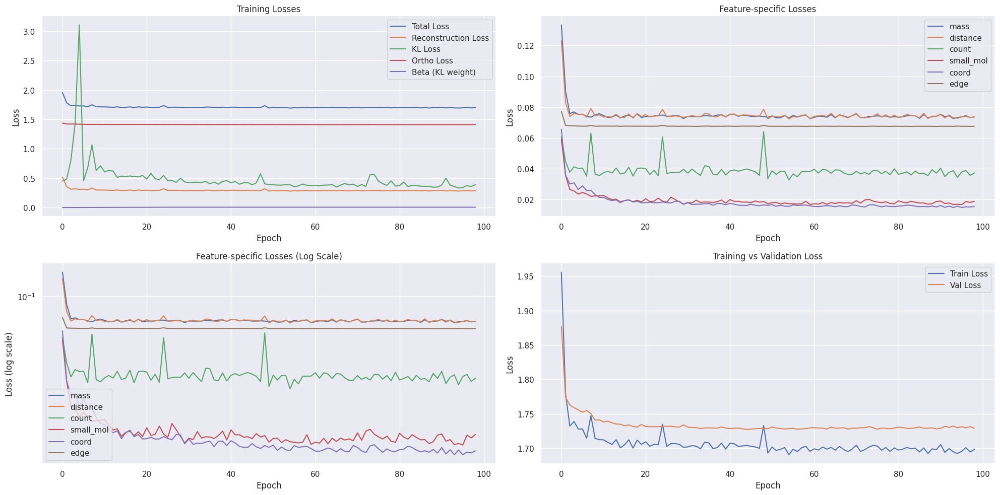

Epoch 100/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 18.70it/s, loss=1.6771, recon=0.2651, kl=0.4297, ortho=1.4098]


Detailed loss diagnostics:
Raw recon_loss: 0.3005
Raw KL loss: 0.4092
Ortho loss: 1.4088
Current beta: 0.0050
mu mean: -0.0028, std: 0.6267
logvar mean: -0.7099, std: 1.2812
mass: 0.0637
distance: 0.0718
count: 0.0721
small_mol: 0.0126
coord: 0.0089
edge: 0.0713


Epoch 100/100 [Train]:  31%|███       | 13/42 [00:00<00:01, 20.84it/s, loss=1.6517, recon=0.2409, kl=0.4097, ortho=1.4088]


Detailed loss diagnostics:
Raw recon_loss: 0.2722
Raw KL loss: 0.3442
Ortho loss: 1.4091
Current beta: 0.0050
mu mean: -0.0178, std: 0.5325
logvar mean: -0.6814, std: 1.2630
mass: 0.0739
distance: 0.0707
count: 0.0260
small_mol: 0.0192
coord: 0.0158
edge: 0.0666


Epoch 100/100 [Train]:  52%|█████▏    | 22/42 [00:01<00:00, 20.74it/s, loss=1.6738, recon=0.2630, kl=0.2757, ortho=1.4093]


Detailed loss diagnostics:
Raw recon_loss: 0.2822
Raw KL loss: 0.3238
Ortho loss: 1.4089
Current beta: 0.0050
mu mean: -0.0225, std: 0.5258
logvar mean: -0.6112, std: 1.2046
mass: 0.0752
distance: 0.0730
count: 0.0261
small_mol: 0.0241
coord: 0.0165
edge: 0.0673


Epoch 100/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 20.14it/s, loss=1.6417, recon=0.2297, kl=0.3520, ortho=1.4102]


Detailed loss diagnostics:
Raw recon_loss: 0.3560
Raw KL loss: 0.3831
Ortho loss: 1.4094
Current beta: 0.0050
mu mean: -0.0388, std: 0.6036
logvar mean: -0.6790, std: 1.2397
mass: 0.0737
distance: 0.0876
count: 0.0959
small_mol: 0.0153
coord: 0.0142
edge: 0.0694


Epoch 100/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 20.49it/s, loss=1.8739, recon=0.4463, kl=0.2428, ortho=1.4264]



Detailed loss diagnostics:
Raw recon_loss: 0.2556
Raw KL loss: 0.3242
Ortho loss: 1.4083
Current beta: 0.0050
mu mean: -0.0060, std: 0.5111
logvar mean: -0.6580, std: 1.2258
mass: 0.0667
distance: 0.0659
count: 0.0255
small_mol: 0.0191
coord: 0.0114
edge: 0.0668

Starting validation...


Epoch 100/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 68.11it/s]



Epoch [100/100] - Time: 2.37s
Train - Total: 1.6977, Recon: 0.2862, KL: 0.3518, Ortho: 1.4098, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0742
  distance_loss: 0.0744
  count_loss: 0.0369
  small_mol_loss: 0.0179
  coord_loss: 0.0153
  edge_loss: 0.0675


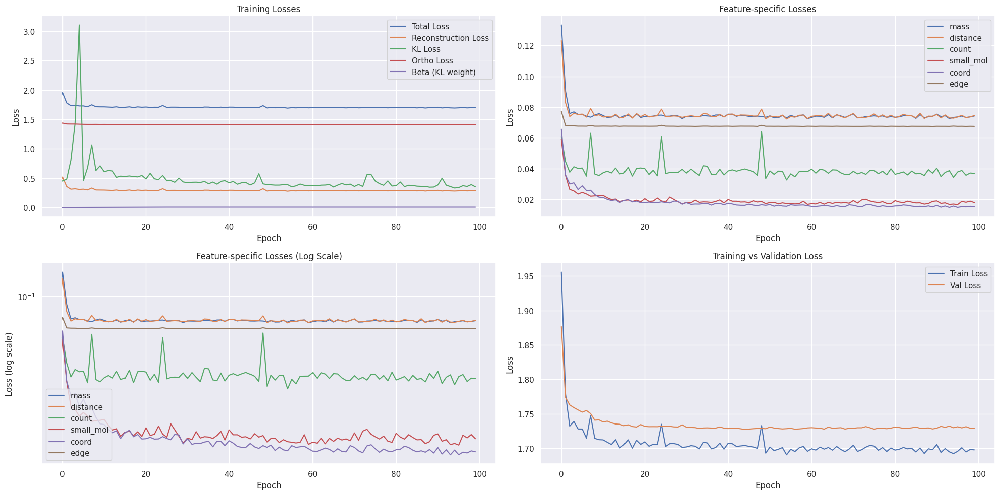


Training completed!


In [83]:
 #Adjust batch size for better gradient estimates
train_loader, test_loader, in_channels, norm_params = prepare_graphs_for_vae(
    graphs,
    batch_size=16,  # Increased batch size
    train_ratio=0.8,
    shuffle=True
)

# Update model parameters
model = ProteinGraphVAE(
    in_channels=8,
    hidden_channels=64,
    latent_channels=16,
    num_heads=4,
    edge_dim=1
).to(device)



# Adjust learning rate schedule
optimizer = torch.optim.Adam(model.parameters(), lr=0.0005, weight_decay=1e-5)
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=3)

# Update loss weights in the model to focus on underperforming features
model.loss_weights = {
    'mass': 0.1,
    'distance': 0.1,
    'count': 0.05,     # Lara: Updated, old=0.2 ; Increased to improve count prediction
    'small_mol': 0.1,
    'coord': 0.1,
    'edge': 0.2       # Increased to improve edge reconstruction
}

# Train with slightly different parameters
num_epochs = 100
model, history = train_model(
    model=model,
    train_loader=augmented_train_loader,
    test_loader=test_loader,
    device=device,
    num_epochs=num_epochs,
    min_beta=0.00001,    # Lower starting point
    max_beta=0.005,      # Slightly lower max
    warmup_epochs=25,    # Longer warmup
    lambda_ortho=0.1     # Keep orthogonal regularization as is
)

Filtered node counts: 102 - 6112


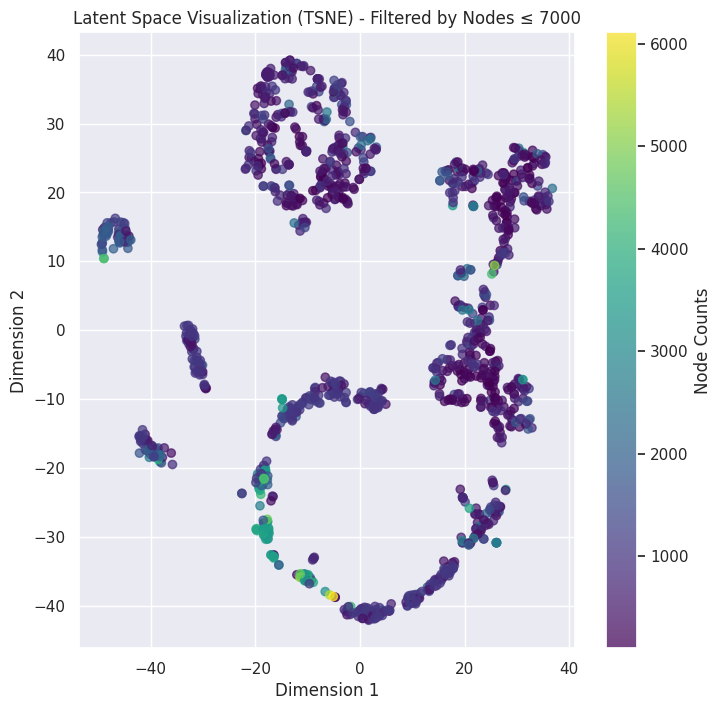

In [89]:
visualize_latent_space_with_node_count_filtered(
    model=model,
    data_loader=augmented_train_loader,
    device=device,
    method='tsne',
    perplexity=30,
    max_nodes=7000
)

Filtered node counts: 102 - 6112


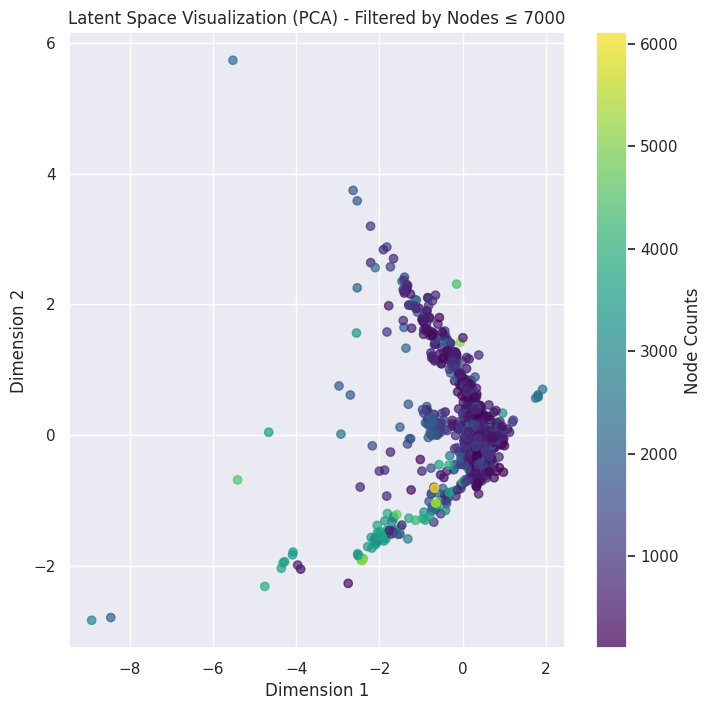

In [90]:
visualize_latent_space_with_node_count_filtered(
    model=model,
    data_loader=augmented_train_loader,
    device=device,
    method='pca',
    max_nodes=7000
)

# Save the model

In [92]:
import torch

# Assuming `model` is your trained ProteinGraphVAE instance
model_path = '/content/drive/MyDrive/CAS_AML/models/protein_graph_vae.pth'

# Save the model's state dictionary
torch.save(model.state_dict(), model_path)

print(f"Model saved to {model_path}")

Model saved to /content/drive/MyDrive/CAS_AML/models/protein_graph_vae.pth


# Analysis of the latent space

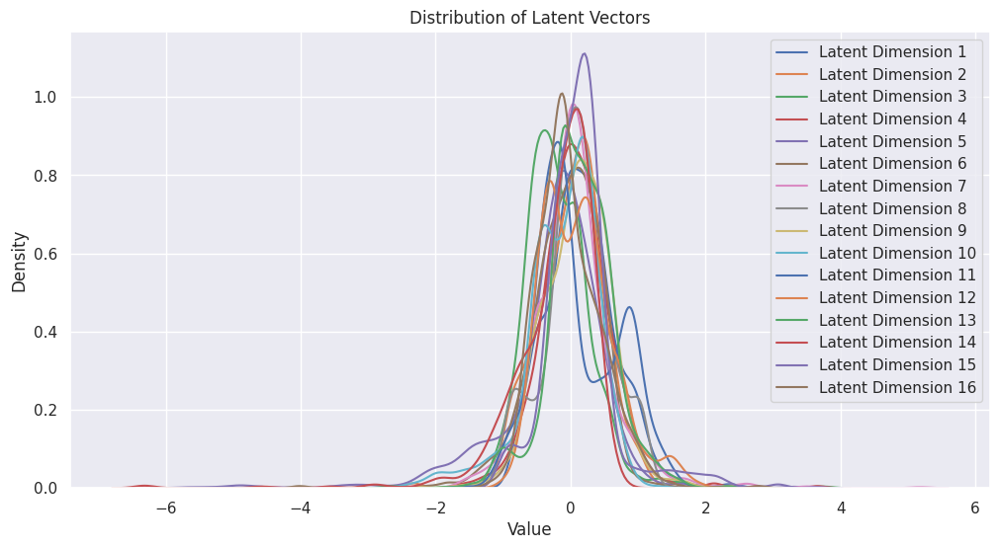

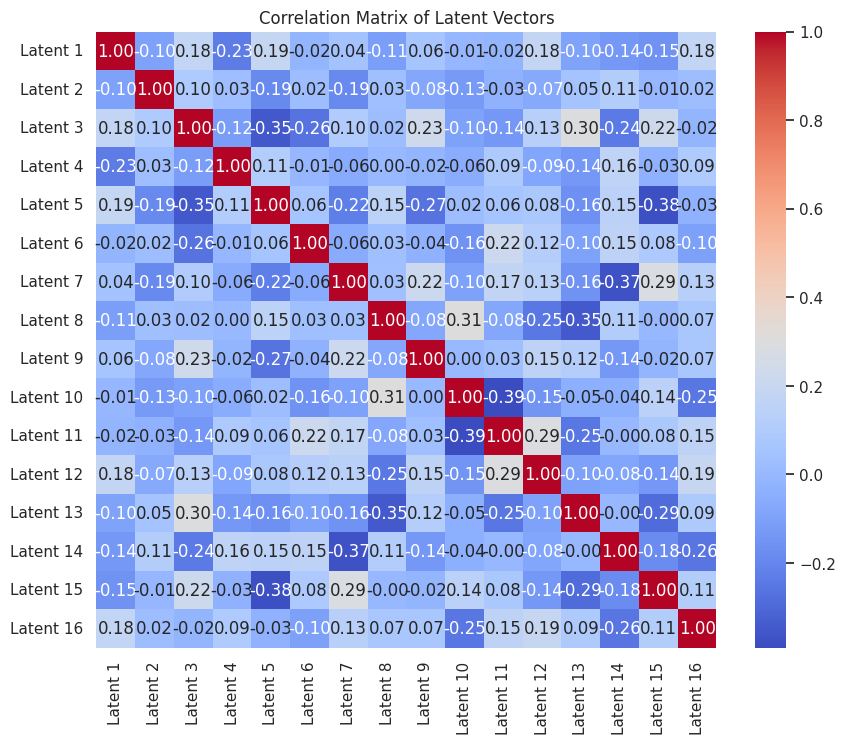

In [96]:
import torch
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

def plot_latent_distribution_and_correlation(model, data_loader, device):
    """
    Plot the distribution of latent vectors and the correlation matrix.

    Args:
        model: Trained ProteinGraphVAE model.
        data_loader: DataLoader containing the data.
        device: torch device.
    """
    model.eval()
    latent_vectors = []

    with torch.no_grad():
        for batch in data_loader:
            batch = batch.to(device)
            mu, logvar = model.encode(batch.x, batch.edge_index, batch.edge_attr, batch.batch)
            z = model.reparameterize(mu, logvar)
            latent_vectors.append(z.cpu().numpy())

    latent_vectors = np.concatenate(latent_vectors, axis=0)

    # Plot the distribution of latent vectors
    plt.figure(figsize=(12, 6))
    for i in range(latent_vectors.shape[1]):
        sns.kdeplot(latent_vectors[:, i], label=f'Latent Dimension {i+1}')
    plt.title('Distribution of Latent Vectors')
    plt.xlabel('Value')
    plt.ylabel('Density')
    plt.legend()
    plt.show()

    # Compute and plot the correlation matrix
    correlation_matrix = np.corrcoef(latent_vectors, rowvar=False)
    plt.figure(figsize=(10, 8))
    sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt='.2f',
                xticklabels=[f'Latent {i+1}' for i in range(latent_vectors.shape[1])],
                yticklabels=[f'Latent {i+1}' for i in range(latent_vectors.shape[1])])
    plt.title('Correlation Matrix of Latent Vectors')
    plt.show()

# Example usage
plot_latent_distribution_and_correlation(model, augmented_train_loader, device)

In [97]:
import torch
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.decomposition import PCA
from scipy.stats import wasserstein_distance

def analyze_latent_space(model, data_loader, device, save_path=None):
    """
    Analyze and visualize the latent space distributions and correlations

    Args:
        model: Trained ProteinGraphVAE model
        data_loader: DataLoader containing protein graphs
        device: torch device
        save_path: Optional path to save visualizations
    """
    model.eval()
    latent_vectors = []

    # Collect latent vectors
    with torch.no_grad():
        for batch in data_loader:
            batch = batch.to(device)
            mu, logvar = model.encode(batch.x, batch.edge_index, batch.edge_attr, batch.batch)
            latent_vectors.append(mu.cpu().numpy())

    # Concatenate all latent vectors
    latent_vectors = np.concatenate(latent_vectors, axis=0)

    # Create figure with subplots
    fig = plt.figure(figsize=(20, 10))

    # 1. Distribution plots for each latent dimension
    ax1 = plt.subplot(231)
    for i in range(latent_vectors.shape[1]):
        sns.kdeplot(data=latent_vectors[:, i], ax=ax1, label=f'Dim {i}')
    ax1.set_title('Latent Dimension Distributions')
    ax1.set_xlabel('Value')
    ax1.set_ylabel('Density')
    ax1.legend(bbox_to_anchor=(1.05, 1), loc='upper left')

    # 2. Correlation matrix
    ax2 = plt.subplot(232)
    corr_matrix = np.corrcoef(latent_vectors.T)
    sns.heatmap(corr_matrix,
                ax=ax2,
                cmap='coolwarm',
                center=0,
                vmin=-1,
                vmax=1,
                square=True,
                xticklabels=False,
                yticklabels=False)
    ax2.set_title('Latent Dimension Correlations')

    # 3. PCA visualization
    ax3 = plt.subplot(233)
    pca = PCA(n_components=2)
    pca_result = pca.fit_transform(latent_vectors)
    scatter = ax3.scatter(pca_result[:, 0],
                          pca_result[:, 1],
                          alpha=0.5,
                          c=np.sum(latent_vectors**2, axis=1),  # Color by L2 norm
                          cmap='viridis')
    plt.colorbar(scatter, ax=ax3, label='L2 Norm')
    ax3.set_title(f'PCA Projection\nExplained Variance: {pca.explained_variance_ratio_.sum():.2%}')

    # 4. Box plot of latent dimensions
    ax4 = plt.subplot(234)
    ax4.boxplot(latent_vectors)
    ax4.set_title('Latent Dimension Ranges')
    ax4.set_xlabel('Dimension')
    ax4.set_ylabel('Value')

    # 5. Dimension-wise statistics
    ax5 = plt.subplot(235)
    stats = pd.DataFrame({
        'Mean': np.mean(latent_vectors, axis=0),
        'Std': np.std(latent_vectors, axis=0),
        'Median': np.median(latent_vectors, axis=0),
        'IQR': np.percentile(latent_vectors, 75, axis=0) - np.percentile(latent_vectors, 25, axis=0)
    })
    stats.index = [f'Dim {i}' for i in range(latent_vectors.shape[1])]
    sns.heatmap(stats,
                ax=ax5,
                cmap='viridis',
                annot=True,
                fmt='.2f')
    ax5.set_title('Dimension-wise Statistics')

    # 6. Wasserstein distance matrix between dimensions
    ax6 = plt.subplot(236)
    n_dims = latent_vectors.shape[1]
    wasserstein_mat = np.zeros((n_dims, n_dims))
    for i in range(n_dims):
        for j in range(n_dims):
            wasserstein_mat[i, j] = wasserstein_distance(
                latent_vectors[:, i],
                latent_vectors[:, j]
            )
    sns.heatmap(wasserstein_mat,
                ax=ax6,
                cmap='viridis',
                square=True,
                xticklabels=False,
                yticklabels=False)
    ax6.set_title('Wasserstein Distances\nbetween Dimensions')

    plt.tight_layout()

    # Save if path provided
    if save_path:
        plt.savefig(save_path, dpi=300, bbox_inches='tight')

    # Calculate additional metrics
    metrics = {
        'mean_correlation': np.mean(np.abs(corr_matrix - np.eye(n_dims))),
        'max_correlation': np.max(np.abs(corr_matrix - np.eye(n_dims))),
        'mean_wasserstein': np.mean(wasserstein_mat),
        'dimension_entropy': -np.sum(np.mean(latent_vectors, axis=0) * np.log(np.abs(np.mean(latent_vectors, axis=0)) + 1e-10)),
        'pca_explained_variance': pca.explained_variance_ratio_.sum()
    }

    return fig, metrics

def visualize_latent_traversal(model, data_loader, device, dim_idx=0, n_steps=10):
    """
    Visualize how changing a single latent dimension affects the reconstruction

    Args:
        model: Trained ProteinGraphVAE model
        data_loader: DataLoader containing protein graphs
        device: torch device
        dim_idx: Index of dimension to traverse
        n_steps: Number of steps in traversal
    """
    model.eval()

    # Get a sample batch
    batch = next(iter(data_loader)).to(device)

    # Get latent representation
    with torch.no_grad():
        mu, logvar = model.encode(batch.x, batch.edge_index, batch.edge_attr, batch.batch)
        z = model.reparameterize(mu, logvar)

    # Create traversal values
    traversal_range = np.linspace(-3, 3, n_steps)
    reconstructions = []

    # Generate reconstructions
    with torch.no_grad():
        for value in traversal_range:
            z_new = z.clone()
            z_new[:, dim_idx] = value
            recon, edge_recon = model.decode(z_new, batch.x.size(0), batch.edge_index)
            reconstructions.append(recon.cpu().numpy())

    return np.array(reconstructions), traversal_range

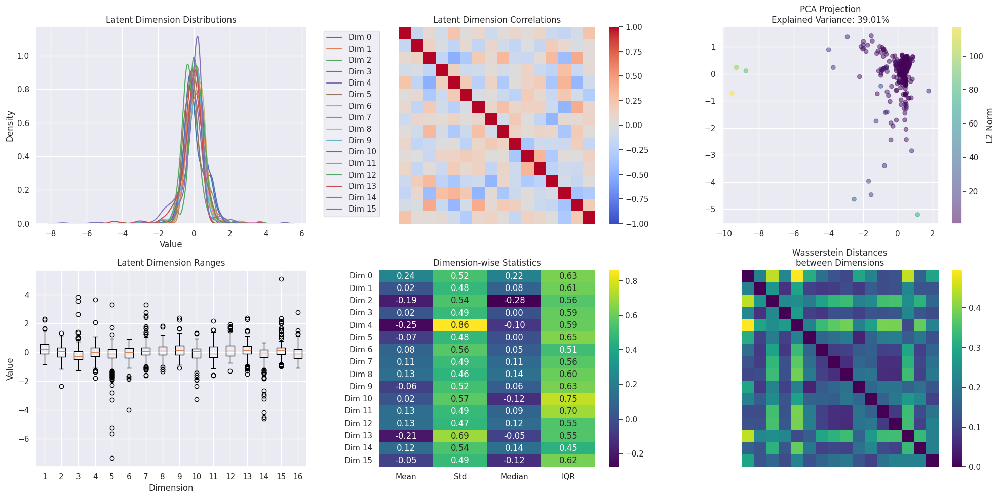

mean_correlation: 0.1482
max_correlation: 0.4983
mean_wasserstein: 0.1824
dimension_entropy: 0.5777
pca_explained_variance: 0.3901


In [98]:
# After training your model
fig, metrics = analyze_latent_space(model, test_loader, device)
plt.show()

# Print latent space metrics
for name, value in metrics.items():
    print(f"{name}: {value:.4f}")

# Visualize how changing dimension 0 affects reconstruction
reconstructions, traversal_values = visualize_latent_traversal(model, test_loader, device, dim_idx=0)

# Generator

In [147]:
def generate_protein_graphs(
    model,
    num_samples=5,
    nodes_per_graph=200,
    norm_params=None,
    device='cuda',
    k=10,
    temperature=1.0
):
    model.eval()
    model = model.to(device)

    # Handle normalization parameters
    feature_means, feature_stds = norm_params
    feature_means = feature_means.clone().detach().to(device)
    feature_stds = feature_stds.clone().detach().to(device)

    generated_graphs = []

    with torch.no_grad():
        for _ in range(num_samples):
            z = torch.randn(1, model.latent_channels).to(device) * temperature

            # Placeholder edge_index for decoding
            edge_index = torch.tensor(
                [[i, (i + 1) % nodes_per_graph] for i in range(nodes_per_graph)],
                dtype=torch.long
            ).t().contiguous().to(device)

            # Decode features
            decoded_features, _ = model.decode(
                z,
                num_nodes=nodes_per_graph,
                edge_index=edge_index
            )

            # Unnormalize features
            decoded_features = (decoded_features * feature_stds) + feature_means

            # Extract coordinates (ensure they are 2D)
            coords = decoded_features[0, :, -3:].cpu().numpy()

            # Create edges using k-NN
            nbrs = NearestNeighbors(n_neighbors=k, algorithm='ball_tree').fit(coords)
            distances, indices = nbrs.kneighbors(coords)

            edge_index = []
            edge_attr = []
            for i in range(len(indices)):
                for j in range(1, k):
                    edge_index.append([i, indices[i, j]])
                    edge_attr.append([distances[i, j]])

            edge_index = torch.tensor(edge_index, dtype=torch.long).t().contiguous().to(device)
            edge_attr = torch.tensor(edge_attr, dtype=torch.float).to(device)

            # Create PyG Data object
            graph = Data(
                x=decoded_features[0],  # Use the first graph's features
                edge_index=edge_index,
                edge_attr=edge_attr
            )
            generated_graphs.append(graph)

    return generated_graphs



In [158]:
# Extract only the graphs from the tuples
graph_data = [g[1] for g in graphs]

generated_graphs = generate_protein_graphs(
    model=model,
    num_samples=10,  # Generate 10 graphs
    nodes_per_graph=600,  # 300 nodes per graph
    norm_params=norm_params,
    device=device,
    k=5,
    temperature=1.5
)

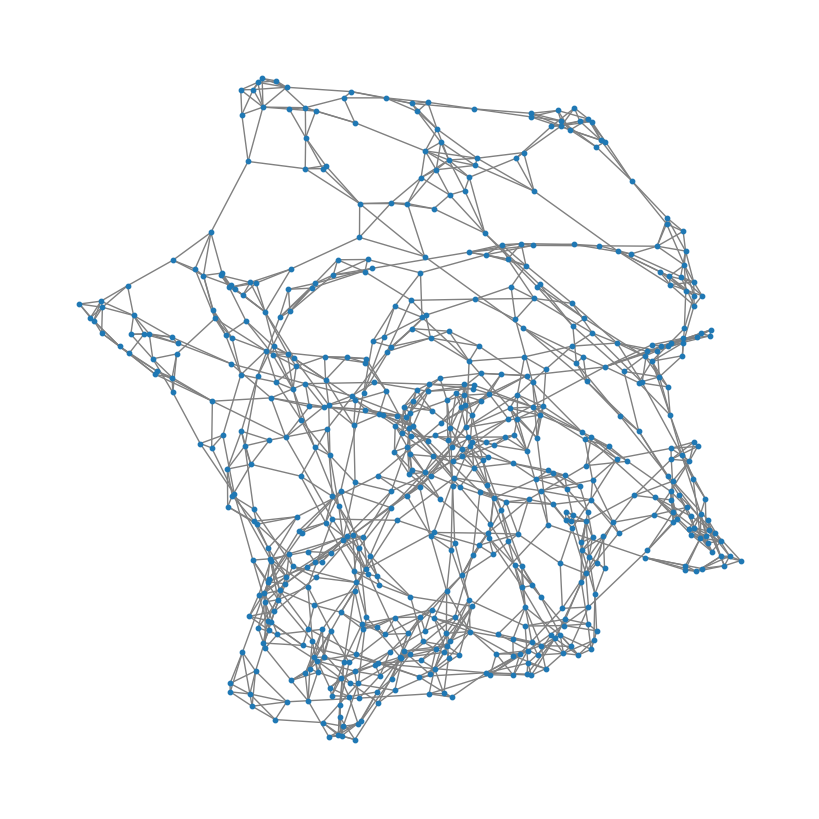

In [159]:
from torch_geometric.utils import to_networkx
import matplotlib.pyplot as plt

graph = generated_graphs[0]
nx_graph = to_networkx(graph, to_undirected=True)
plt.figure(figsize=(8, 8))
nx.draw(nx_graph, node_size=10, edge_color="gray")
plt.show()


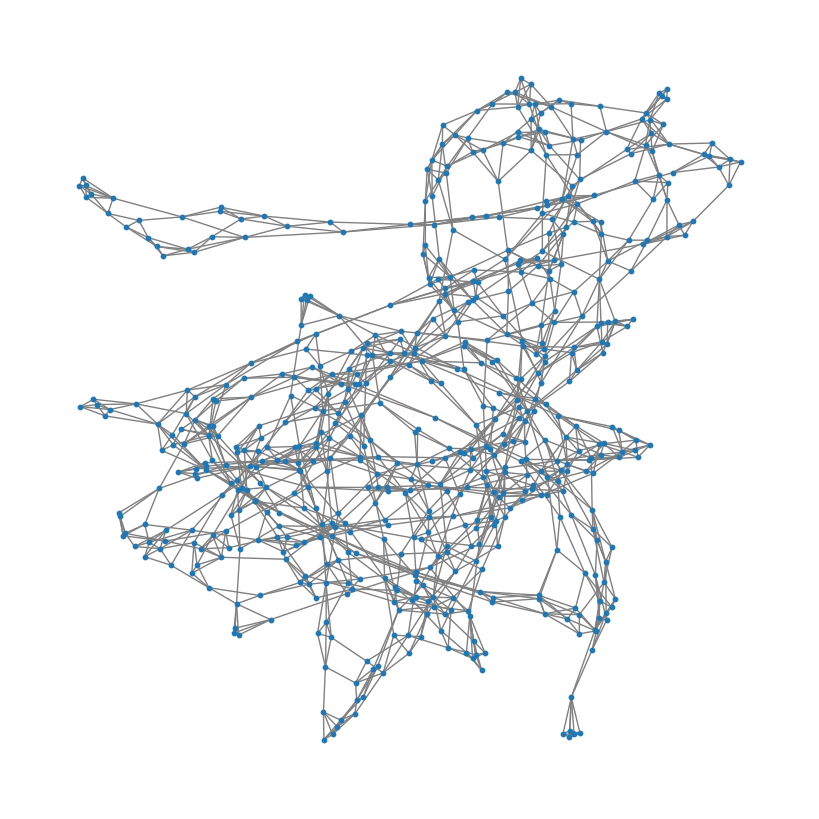

In [160]:
graph = generated_graphs[1]
nx_graph = to_networkx(graph, to_undirected=True)
plt.figure(figsize=(8, 8))
nx.draw(nx_graph, node_size=10, edge_color="gray")
plt.show()

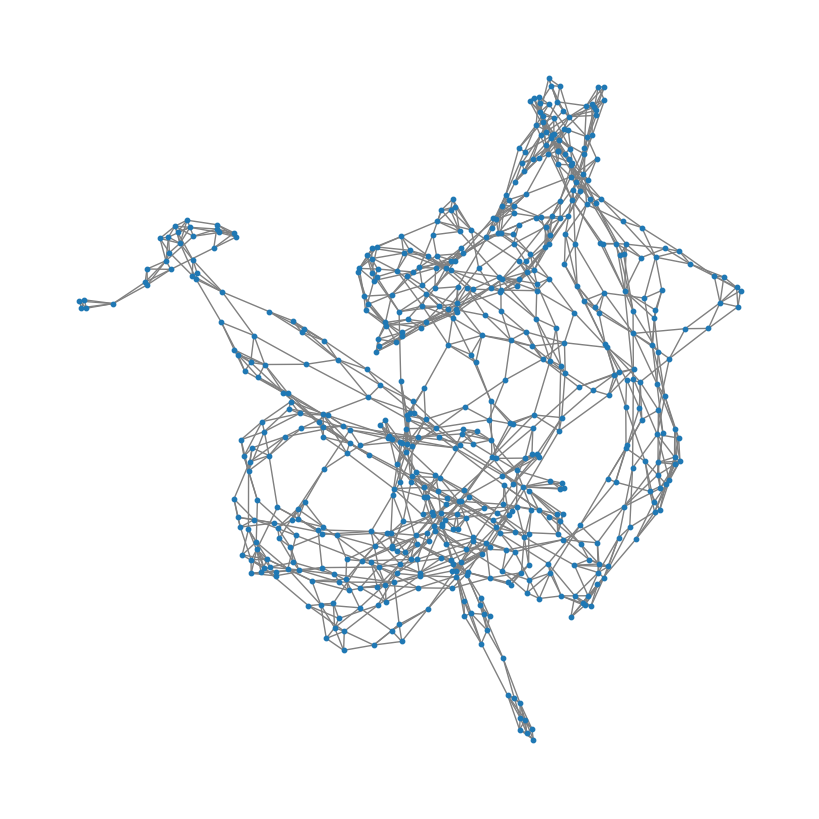

In [161]:
graph = generated_graphs[2]
nx_graph = to_networkx(graph, to_undirected=True)
plt.figure(figsize=(8, 8))
nx.draw(nx_graph, node_size=10, edge_color="gray")
plt.show()

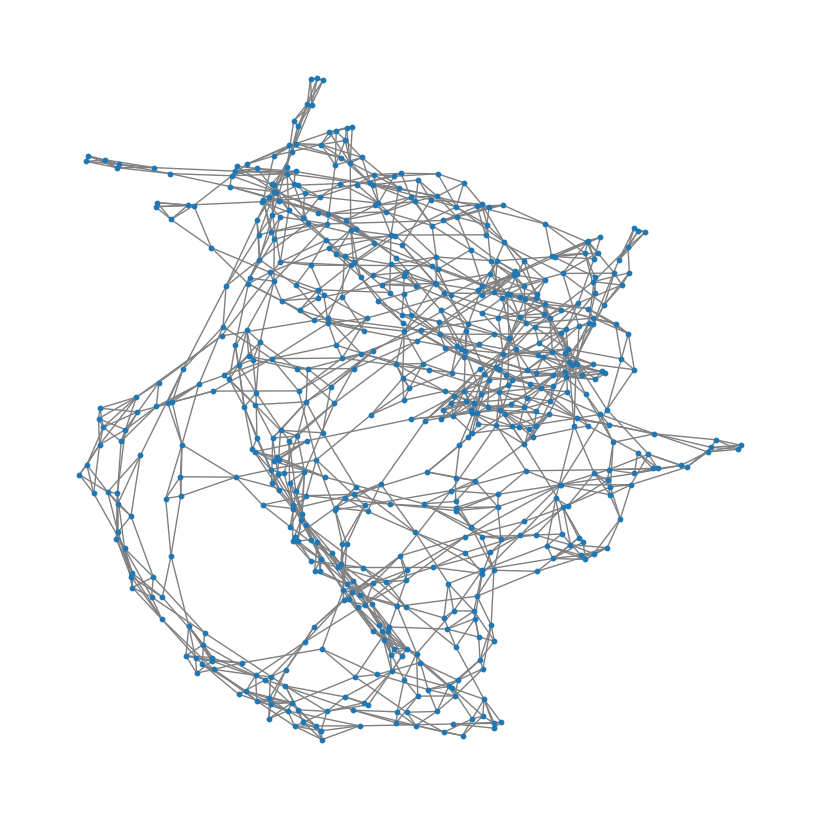

In [166]:
graph = generated_graphs[6]
nx_graph = to_networkx(graph, to_undirected=True)
plt.figure(figsize=(8, 8))
nx.draw(nx_graph, node_size=10, edge_color="gray")
plt.show()

## evaluate the generations

In [164]:
import networkx as nx
from torch_geometric.utils import to_networkx

import networkx as nx
from torch_geometric.utils import to_networkx

def calculate_graph_metrics(graph):
    # Convert PyG graph to NetworkX format
    nx_graph = to_networkx(graph, to_undirected=True)

    # Compute metrics
    num_nodes = nx_graph.number_of_nodes()
    num_edges = nx_graph.number_of_edges()
    avg_degree = sum(dict(nx_graph.degree()).values()) / num_nodes
    edge_density = nx.density(nx_graph)
    clustering_coeff = nx.average_clustering(nx_graph)
    graph_diameter = nx.diameter(nx_graph) if nx.is_connected(nx_graph) else float('inf')
    avg_path_length = nx.average_shortest_path_length(nx_graph) if nx.is_connected(nx_graph) else float('inf')

    return {
        "num_nodes": num_nodes,
        "num_edges": num_edges,
        "avg_degree": avg_degree,
        "edge_density": edge_density,
        "clustering_coeff": clustering_coeff,
        "graph_diameter": graph_diameter,
        "avg_path_length": avg_path_length
    }

# Apply this to each generated graph
for i, protein_graph in enumerate(generated_graphs, 1):
    metrics = calculate_graph_metrics(protein_graph)
    print(f"Metrics for Generated Protein {i}:")
    for key, value in metrics.items():
        print(f"  {key}: {value}")



Metrics for Generated Protein 1:
  num_nodes: 600
  num_edges: 1552
  avg_degree: 5.173333333333333
  edge_density: 0.008636616583194213
  clustering_coeff: 0.44951190476190506
  graph_diameter: 26
  avg_path_length: 11.050617696160266
Metrics for Generated Protein 2:
  num_nodes: 600
  num_edges: 1557
  avg_degree: 5.19
  edge_density: 0.008664440734557596
  clustering_coeff: 0.4441904761904764
  graph_diameter: 31
  avg_path_length: 11.428018920422927
Metrics for Generated Protein 3:
  num_nodes: 600
  num_edges: 1588
  avg_degree: 5.293333333333333
  edge_density: 0.008836950473010573
  clustering_coeff: 0.45329172679172736
  graph_diameter: 54
  avg_path_length: 16.087762938230384
Metrics for Generated Protein 4:
  num_nodes: 600
  num_edges: 1587
  avg_degree: 5.29
  edge_density: 0.008831385642737897
  clustering_coeff: 0.4434391534391538
  graph_diameter: 41
  avg_path_length: 13.2940734557596
Metrics for Generated Protein 5:
  num_nodes: 600
  num_edges: 1578
  avg_degree: 5.26